# Model Prediction Experiment 1 

In [142]:
# first, test generative model on one dimensional graphs
import sys
import pandas as pd
import numpy as np
import json
import seaborn as sns
import matplotlib.pyplot as plt
from analysis_util import *
import statsmodels.api as sm
from utils import *


In [137]:
def generateseq(groupcond,seql = 600):
    seq = []
    if groupcond == 'c2':
        while len(seq) < seql:
            seq = seq + np.random.choice([[1,2],[3],[4]])
        return seq[0:seql]
    if groupcond == 'c3':
        while len(seq) < seql:
            seq = seq + np.random.choice([[1,2,3],[4]])
        return seq[0:seql]
    if groupcond == 'ind':
        while len(seq) < seql:
            seq = seq + [np.random.choice([1,2,3,4])]
        return seq[0:seql]

In [130]:
# store learned data like list of tuples 
model_data = {}
this_w = 0.2
n_sample = 120 # 20 samples for each condition
for groupcond in ['c2','c3','ind']:
    model_chunks = []
    for sample in range(0,n_sample):
        this_sequence = generateseq(groupcond)
        M,T,bagofchunk,rt,correctness,cp,reacted_press  = learn_sequence(this_sequence, Print = False, L_threshold = 0, w = this_w)
        model_chunks.append((M, bagofchunk))
    model_data[groupcond] = model_chunks

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.993243  0.000000  0.000000
[2]  0.333333  0.000000  0.333333  0.333333
[3]  0.315436  0.000000  0.302013  0.382550
[4]  0.333333  0.000000  0.346154  0.320513
this_M              P
[1]  0.246667
[2]  0.245000
[3]  0.248333
[4]  0.260000
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993243  0.000000  0.000000
[2]  0.333333  0.000000  0.333333  0.333333
[3]  0.315436  0.000000  0.302013  0.382550
[4]  0.333333  0.000000  0.346154  0.320513
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.086022
[4]     0.298387
[1, 2]  0.311828
[3, 4]  0.303763
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.281250  0.312500  0.406250
[4]     0.000000  0.306306  0.351351  0.342342
[1, 2]  0.000000  0.344828  0.336207  0.310345
[3, 4]  0.283186  0.247788  0.247788  0.221239
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.255000
[2]  0.255000
[3]  0.211667
[4]  0.278333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.326797  0.0  0.261438  0.405229
[3]  0.385827  0.0  0.307087  0.307087
[4]  0.323353  0.0  0.281437  0.395210
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.111717
[3]     0.253406
[1, 2]  0.305177
[4, 4]  0.329700
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.365854  0.268293  0.365854
[3]     0.000000  0.290323  0.365591  0.344086
[1, 2]  0.000000  0.223214  0.348214  0.419643
[4, 4]  0.338843  0.206612  0.231405  0.223140
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[2]     0.111717
[3]     0.253406
[1, 2]  0.305177
[4, 4]  0.329700
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.365854  0.268293  0.365854
[3]     0.000000  0.290323  0.365591  0.344086
[1, 2]  0.000000  0.223214  0.348214  0.419643
[4, 4]  0.338843  0.206612  0.231405  0.223140
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.273333
[2]  0.273333
[3]  0.238333
[4]  0.215000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.341463  0.0  0.384146  0.274390
[3]  0.363636  0.0  0.307692  0.328671
[4]  0.426357  0.0  0.279070  0.286822
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.115819
[3]        0.268362
[4]        0.268362
[1, 2, 3]  0.347458
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.365854  0.268293   0.365854
[3]        0.000000  0.389474  0.315789   0.294737
[4]        0.000000  0.305263  0.273684   0.410526
[1, 2, 3]  0.333333  0.113821  0.227642   0.325203
correctness:  [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.266667
[2]  0.266667
[3]  0.236667
[4]  0.230000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.300000  0.0  0.350000  0.350000
[3]  0.394366  0.0  0.345070  0.260563
[4]  0.405797  0.0  0.268116  0.318841
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.072555
[3]        0.315457
[1, 2]     0.331230
[4, 1, 2]  0.280757
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.347826  0.304348   0.347826
[3]        0.000000  0.400000  0.370000   0.230000
[1, 2]     0.000000  0.323810  0.323810   0.352381
[4, 1, 2]  0.258427  0.202247  0.303371   0.224719
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.238333
[2]  0.238333
[3]  0.256667
[4]  0.266667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.300699  0.0  0.321678  0.377622
[3]  0.311688  0.0  0.376623  0.305195
[4]  0.318750  0.0  0.312500  0.368750
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.108179
[3]     0.308707
[1, 2]  0.269129
[4, 4]  0.313984
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.365854  0.219512  0.414634
[3]     0.000000  0.376068  0.324786  0.290598
[1, 2]  0.000000  0.303922  0.333333  0.362745
[4, 4]  0.344538  0.226891  0.168067  0.260504
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.225000
[2]  0.225000
[3]  0.283333
[4]  0.266667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.288889  0.0  0.377778  0.333333
[3]  0.288235  0.0  0.358824  0.352941
[4]  0.287500  0.0  0.362500  0.343750
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

          [2]       [4]    [1, 2]    [3, 3]
[2]     0.000  0.405405  0.216216  0.378378
[4]     0.000  0.367521  0.273504  0.350427
[1, 2]  0.000  0.306122  0.316327  0.377551
[3, 3]  0.296  0.232000  0.208000  0.264000
this_M                 P
[2]     0.098143
[4]     0.310345
[1, 2]  0.259947
[3, 3]  0.331565
this_T            [2]       [4]    [1, 2]    [3, 3]
[2]     0.000  0.405405  0.216216  0.378378
[4]     0.000  0.367521  0.273504  0.350427
[1, 2]  0.000  0.306122  0.316327  0.377551
[3, 3]  0.296  0.232000  0.208000  0.264000
correctness:  [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 

this_M                 P
[2]     0.098143
[4]     0.310345
[1, 2]  0.259947
[3, 3]  0.331565
this_T            [2]       [4]    [1, 2]    [3, 3]
[2]     0.000  0.405405  0.216216  0.378378
[4]     0.000  0.367521  0.273504  0.350427
[1, 2]  0.000  0.306122  0.316327  0.377551
[3, 3]  0.296  0.232000  0.208000  0.264000
correctness:  [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


          P
[1]  0.255
[2]  0.255
[3]  0.225
[4]  0.265
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.281046  0.0  0.333333  0.379085
[3]  0.362963  0.0  0.288889  0.348148
[4]  0.377358  0.0  0.283019  0.339623
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.302013
[4]     0.355705
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.288889  0.348148  0.362963
[4]     0.0  0.283019  0.339623  0.377358
[1, 2]  0.0  0.333333  0.379085  0.281046
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.302013
[4]     0.355705
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.288889  0.348148  0.362963
[4]     0.0  0.283019  0.339623  0.377358
[1, 2]  0.0  0.333333  0.379085  0.281046
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.336264
[4]     0.345055
[1, 2]  0.318681
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.274510  0.424837  0.300654
[4]     0.0  0.382166  0.286624  0.324841
[1, 2]  0.0  0.351724  0.317241  0.331034
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.094340
[4]     0.288410
[1, 2]  0.296496
[3, 4]  0.320755
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.314286  0.314286  0.371429
[4]     0.000000  0.271028  0.327103  0.392523
[1, 2]  0.000000  0.318182  0.336364  0.345455
[3, 4]  0.294118  0.260504  0.226891  0.218487
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


 [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [4, 3, 4, 4, 3, 4, 5, 5, 5, 4, 5, 3, 4, 5, 5, 5, 5, 4, 3, 4, 5, 4, 4, 5, 2, 4, 5, 4, 2, 6, 5, 5, 4, 2, 4, 4, 6, 5, 5, 2, 5, 2, 4, 4, 2, 5, 4, 3, 4, 5, 5, 3, 5, 5, 5, 5, 5, 4, 2, 5, 3, 4, 3, 4, 4, 2, 5, 5, 5, 3, 5, 5, 3, 5, 3, 5, 2, 5, 2, 5, 3, 5, 3, 5, 2, 4, 4, 3, 5, 3, 4, 2, 5, 2, 4, 2, 4, 4, 2, 5, 4, 5, 4, 2, 5, 5, 5, 5, 5, 5, 4, 3, 5, 2, 4, 3, 5, 3, 5, 2, 5, 4, 2, 4, 5, 4, 2, 5, 5, 4, 2, 5, 2, 4, 4, 2, 5, 2, 4, 4, 3, 5, 5, 5, 5, 3, 5, 2, 5, 5, 5, 5, 5, 5, 2, 5, 4, 3, 4, 5, 4, 3, 5, 4, 2, 4, 3, 5, 5, 5, 5, 3, 5, 6, 5, 3, 4, 5, 5, 5, 3, 5, 5, 5, 3, 5, 4, 4, 3, 4, 5, 5, 4, 3, 4, 2, 5, 2, 5, 4, 3, 5, 5, 4, 2, 5, 5, 5, 4, 5, 4, 3, 5, 5, 4, 3, 4, 6, 5, 4, 5, 2, 5, 5, 5, 5, 5, 3, 4, 4, 2, 4, 4, 2, 6, 4, 2, 5, 5, 5, 5, 4, 5, 4, 3, 5, 2, 5, 5, 6, 5, 5, 5, 3, 5, 4, 5, 5, 4, 3, 4, 5, 5, 5, 5, 5, 5, 5, 2, 4, 5, 4, 2, 5, 5, 5, 4, 2, 5, 4, 2, 4, 4, 2, 4, 5, 4, 2, 6, 4, 3, 5, 4, 5, 2, 5, 3, 4, 2, 5, 4, 3, 5, 3, 5, 2, 5, 4, 2, 5, 2, 5, 4, 3, 5, 5, 4, 3, 5, 4, 5, 5, 5, 4, 3, 5, 5, 4, 2, 4, 5, 5

this_M                    P
[2]        0.106017
[3]        0.263610
[4]        0.269341
[1, 2, 4]  0.361032
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.189189  0.324324   0.486486
[3]        0.000000  0.369565  0.271739   0.358696
[4]        0.000000  0.255319  0.276596   0.468085
[1, 2, 4]  0.293651  0.214286  0.246032   0.238095
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.241667
[2]  0.240000
[3]  0.261667
[4]  0.256667
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993103  0.000000  0.000000
[2]  0.326389  0.000000  0.291667  0.381944
[3]  0.286624  0.000000  0.356688  0.356688
[4]  0.337662  0.000000  0.383117  0.279221
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [6, 3, 5, 5, 5, 3, 5, 5, 3, 5, 5, 5, 2, 6, 3, 4, 4, 4, 4, 2, 5, 4, 4, 5, 5, 5, 5, 3, 5, 2, 6, 4, 5, 5, 5, 5, 5, 5, 5, 2, 5, 4, 3, 6, 6, 5, 5, 5, 5, 2, 5, 5, 5, 5, 6, 5, 4, 4, 4, 4, 4, 4, 4, 4, 2, 5, 5, 5, 5, 5, 2, 5, 2, 5, 2, 5, 4, 4, 6, 2, 4, 4, 5, 5, 3, 5, 3, 5, 3, 4, 2, 5, 5, 3, 5, 5, 5, 5, 3, 5, 3, 5, 5, 4, 4, 5, 4, 4, 5, 5, 5, 2, 5, 4, 5, 5, 2, 5, 2, 4, 4, 4, 5, 3, 5, 4, 2, 7, 2, 5, 5, 3, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 2, 4, 4, 5, 5, 6, 3, 4, 5, 5, 5, 5, 6, 2, 5, 4, 4, 6, 5, 5, 5, 5, 4, 5, 2, 5, 3, 4, 3, 5, 5, 3, 5, 2, 5, 4, 3, 6, 2, 5, 3, 5, 3, 6, 3, 5, 5, 2, 4, 3, 5, 2, 5, 5, 5, 5, 5, 5, 4, 5, 2, 5, 2, 5, 3, 5, 5, 5, 5, 2, 4, 2, 5, 5, 5, 5, 3, 5, 5, 4, 3, 5, 5, 5, 5, 5, 5, 3, 5, 2, 5, 4, 3, 6, 2, 5, 4, 2, 5, 5, 5, 5, 5, 5, 3, 5, 2, 4, 5, 2, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3, 5, 5, 3, 4, 4, 5, 3, 5, 5, 4, 4, 3, 5, 2, 5, 5, 5, 5, 5, 4, 4, 4, 6, 6, 5, 5, 3, 5, 4, 3, 6, 5, 5, 2, 5, 3, 5, 2, 5, 5, 2, 5, 5, 5, 5, 3, 5, 5, 4, 4, 4, 6, 5, 2, 5, 5, 6, 2, 5, 2, 5, 4, 5

reacted press  [1, 2, 4, 3, 4, 3, 3, 1, 2, 3, 3, 4, 3, 1, 2, 4, 3, 2, 1, 2, 3, 4, 3, 2, 3, 3, 1, 2, 4, 3, 3, 3, 4, 3, 2, 4, 3, 2, 4, 3, 3, 4, 3, 4, 3, 4, 3, 2, 1, 2, 4, 3, 4, 3, 3, 3, 3, 4, 3, 2, 4, 3, 2, 4, 3, 3, 4, 3, 2, 1, 2, 1, 2, 1, 2, 3, 4, 3, 1, 2, 4, 3, 2, 1, 2, 4, 3, 1, 2, 4, 3, 3, 4, 3, 3, 3, 3, 1, 2, 4, 3, 3, 3, 4, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 3, 1, 2, 1, 2, 4, 3, 2, 1, 2, 3, 4, 3, 1, 2, 3, 1, 2, 4, 3, 3, 3, 4, 3, 4, 3, 2, 1, 2, 4, 3, 4, 3, 1, 2, 3, 4, 3, 4, 3, 1, 2, 3, 4, 3, 3, 3, 3, 3, 3, 3, 1, 2, 1, 2, 4, 3, 3, 1, 2, 1, 2, 3, 4, 3, 1, 2, 1, 2, 4, 3, 1, 2, 3, 1, 2, 1, 2, 1, 2, 4, 3, 2, 3, 4, 3, 2, 1, 2, 1, 2, 1, 2, 4, 3, 3, 1, 2, 1, 2, 3, 3, 3, 1, 2, 3, 3, 4, 3, 3, 4, 3, 3, 3, 4, 3, 4, 3, 3, 4, 3, 4, 3, 3, 4, 3, 4, 3, 2, 3, 3, 1, 2, 1, 2, 3, 1, 2, 4, 3, 2, 4, 3, 3, 3, 3, 3, 1, 2, 3, 4, 3, 2, 4, 3, 3, 1, 2, 4, 3, 4, 3, 4, 3, 2, 1, 2, 1, 2, 4, 3, 2, 4, 3, 2, 4, 3, 4, 3, 2, 4, 3, 3, 4, 3, 3, 3, 1, 2, 1, 2, 1, 2, 3, 1, 2, 4, 3, 2, 1, 2, 3, 3, 4, 3, 2, 3, 1, 2, 4, 3, 1, 2, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.084656
[4]     0.328042
[1, 2]  0.272487
[3, 4]  0.314815
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.375000  0.312500  0.312500
[4]     0.000000  0.338710  0.322581  0.330645
[1, 2]  0.000000  0.349515  0.262136  0.388350
[3, 4]  0.268908  0.285714  0.210084  0.235294
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 5, 5, 2, 4, 4, 5, 3, 5, 3, 4, 4, 2, 5, 5, 6, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 3, 4, 4, 5, 3, 5, 3, 4, 2, 5, 5, 5, 5, 5, 2, 4, 4, 5, 4, 5, 5, 5, 5, 5, 5, 4, 5, 5, 5, 5, 2, 5, 5, 3, 5, 4, 2, 5, 3, 5, 5, 3, 4, 4, 5, 4, 3, 4, 4, 5, 3, 5, 5, 5, 5, 2, 5, 3, 5, 5, 4, 2, 4, 4, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 2, 5, 4, 2, 5, 5, 5, 2, 4, 4, 6, 2, 5, 2, 5, 2, 5, 5, 6, 3, 5, 5, 3, 4, 4, 5, 5, 2, 4, 3, 5, 5, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 6, 5, 3, 5, 5, 5, 3, 5, 2, 5, 2, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 6, 2, 6, 3, 5, 2, 4, 2, 5, 5, 6, 6, 5, 5, 3, 5, 5, 2, 5, 3, 5, 3, 5, 2, 5, 3, 5, 5, 3, 6, 6, 6, 3, 5, 2, 5, 3, 5, 5, 5, 4, 3, 6, 4, 4, 4, 6, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 2, 4, 4, 5, 4, 5, 2, 5, 2, 4, 4, 5, 5, 3, 5, 5, 2, 5, 4, 2, 5, 3, 4, 3, 6, 3, 5, 2, 5, 2, 4, 4, 5, 5, 5, 5, 4, 3, 5, 5, 6, 3, 5, 5, 5, 5, 6, 2, 5, 5, 5, 2, 4, 2, 5, 5, 5, 4, 2, 4, 2, 5, 5, 4, 5, 4, 2, 5, 3, 6, 2, 5, 4, 5, 5, 5, 4, 4, 5, 4, 3, 5, 2, 5, 5, 4, 4, 5, 5, 3, 4, 5, 3, 4, 5, 2, 4, 4

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


         [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.403846  0.307692  0.282051
[4]     0.0  0.337662  0.337662  0.324675
[1, 2]  0.0  0.275862  0.372414  0.351724
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.366071
[4]     0.294643
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.310976  0.359756  0.329268
[4]     0.0  0.393939  0.265152  0.333333
[1, 2]  0.0  0.401316  0.243421  0.355263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.310976  0.359756  0.329268
[4]     0.0  0.393939  0.265152  0.333333
[1, 2]  0.0  0.401316  0.243421  0.355263
this_M                 P
[2]     0.000000
[3]     0.366071
[4]     0.294643
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.310976  0.359756  0.329268
[4]     0.0  0.393939  0.265152  0.333333
[1, 2]  0.0  0.401316  0.243421  0.355263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [5, 5, 5, 2, 6, 5, 2, 4, 5, 5, 2, 4, 3, 5, 3, 6, 4, 4, 5, 2, 5, 4, 5, 4, 5, 5, 5, 5, 3, 5, 2, 4, 5, 5, 2, 4, 5, 5, 4, 5, 4, 4, 5, 5, 6, 6, 4, 4, 2, 4, 3, 5, 5, 3, 4, 5, 2, 4, 5, 2, 5, 4, 4, 2, 5, 5, 5, 3, 4, 3, 6, 5, 4, 4, 2, 4, 3, 5, 2, 5, 4, 5, 3, 4, 3, 5, 6, 5, 4, 5, 5, 2, 5, 3, 4, 5, 4, 5, 4, 2, 5, 5, 3, 4, 4, 4, 5, 2, 5, 4, 5, 4, 5, 2, 6, 6, 5, 2, 5, 5, 3, 4, 4, 5, 2, 5, 2, 4, 6, 5, 3, 4, 5, 5, 2, 4, 5, 5, 5, 4, 5, 5, 2, 4, 5, 3, 4, 5, 5, 2, 5, 5, 5, 5, 2, 4, 4, 4, 2, 5, 3, 4, 4, 5, 4, 4, 5, 5, 3, 4, 3, 6, 4, 5, 5, 5, 5, 4, 5, 4, 2, 4, 5, 2, 4, 5, 5, 5, 3, 4, 3, 4, 5, 2, 5, 5, 3, 5, 2, 5, 3, 5, 2, 5, 2, 5, 3, 5, 3, 5, 3, 5, 2, 5, 3, 5, 3, 4, 4, 5, 4, 3, 5, 3, 5, 5, 5, 5, 5, 4, 5, 5, 5, 2, 4, 2, 4, 4, 5, 5, 3, 4, 4, 5, 5, 3, 5, 3, 5, 3, 4, 5, 5, 3, 4, 5, 5, 4, 5, 3, 4, 5, 3, 4, 4, 5, 3, 4, 4, 5, 4, 3, 5, 5, 2, 5, 2, 5, 6, 4, 5, 5, 4, 2, 5, 3, 4, 4, 5, 3, 5, 3, 4, 4, 5, 5, 5, 4, 3, 4, 5, 5, 4, 4, 2, 4, 2, 6, 4, 5, 3, 4, 3, 5, 3, 4, 5, 5, 4, 5, 5, 5, 5, 3, 4, 5, 3, 4, 5, 2, 5, 3

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                   P
[2]        0.078378
[3]        0.308108
[4]        0.302703
[1, 2, 3]  0.310811
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.379310  0.310345   0.310345
[3]        0.000000  0.263158  0.359649   0.368421
[4]        0.000000  0.294643  0.366071   0.339286
[1, 2, 3]  0.252174  0.347826  0.173913   0.226087
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 

rt,  [5, 5, 4, 2, 3, 4, 4, 4, 5, 5, 4, 5, 5, 5, 5, 5, 4, 4, 5, 5, 4, 5, 3, 3, 6, 5, 4, 4, 2, 2, 6, 5, 3, 3, 5, 4, 4, 3, 3, 5, 5, 3, 3, 5, 5, 2, 2, 6, 5, 4, 5, 3, 3, 5, 4, 4, 2, 3, 6, 5, 4, 2, 2, 5, 5, 5, 2, 2, 4, 5, 3, 2, 6, 5, 5, 5, 5, 3, 3, 6, 2, 3, 5, 4, 4, 2, 2, 5, 5, 3, 2, 6, 2, 3, 5, 3, 3, 5, 5, 5, 5, 4, 3, 3, 7, 4, 5, 5, 5, 3, 2, 5, 4, 5, 5, 4, 5, 4, 5, 5, 5, 5, 5, 5, 2, 2, 6, 2, 2, 5, 4, 5, 4, 2, 3, 4, 5, 5, 5, 4, 2, 2, 5, 2, 2, 6, 5, 4, 2, 2, 5, 5, 5, 4, 3, 2, 6, 3, 3, 5, 5, 4, 3, 3, 6, 3, 2, 6, 2, 2, 6, 4, 5, 3, 3, 6, 5, 2, 3, 6, 3, 2, 6, 2, 2, 5, 3, 3, 4, 4, 5, 2, 2, 6, 4, 5, 3, 3, 5, 5, 3, 3, 5, 2, 2, 5, 5, 3, 3, 5, 6, 5, 5, 3, 2, 6, 3, 3, 5, 2, 2, 6, 5, 5, 3, 3, 5, 4, 4, 4, 4, 5, 2, 2, 6, 5, 2, 3, 4, 5, 5, 3, 2, 5, 5, 4, 3, 3, 5, 5, 5, 4, 5, 3, 3, 6, 5, 5, 5, 3, 3, 6, 5, 4, 2, 2, 4, 5, 3, 3, 5, 4, 5, 4, 2, 2, 5, 5, 5, 3, 2, 5, 3, 3, 6, 4, 4, 3, 3, 6, 4, 4, 5, 3, 3, 6, 5, 5, 3, 2, 6, 2, 2, 6, 5, 5, 4, 5, 5, 4, 3, 3, 4, 4, 3, 3, 5, 4, 3, 3, 5, 5, 5, 5, 3, 3, 5, 5, 3, 3, 4, 4

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.238333
[2]  0.238333
[3]  0.285000
[4]  0.238333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.328671  0.0  0.405594  0.258741
[3]  0.298246  0.0  0.391813  0.309942
[4]  0.314685  0.0  0.321678  0.363636
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.374179
[4]     0.312910
[1, 2]  0.312910
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.391813  0.309942  0.298246
[4]     0.0  0.321678  0.363636  0.314685
[1, 2]  0.0  0.405594  0.258741  0.328671
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.270000
[2]  0.268333
[3]  0.195000
[4]  0.266667
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993827  0.000000  0.000000
[2]  0.347826  0.000000  0.322981  0.329193
[3]  0.324786  0.000000  0.230769  0.444444
[4]  0.418750  0.000000  0.237500  0.343750
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

[1, 2]  0.0  0.320988  0.327160  0.345679
this_M                 P
[2]     0.000000
[3]     0.266515
[4]     0.364465
[1, 2]  0.369021
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.230769  0.444444  0.324786
[4]     0.0  0.237500  0.343750  0.418750
[1, 2]  0.0  0.320988  0.327160  0.345679
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.106667
[3]     0.290667
[1, 2]  0.274667
[4, 4]  0.328000
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.225000  0.525000  0.250000
[3]     0.000000  0.376147  0.220183  0.403670
[1, 2]  0.000000  0.359223  0.330097  0.300971
[4, 4]  0.325203  0.178862  0.186992  0.308943
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.106667
[3]     0.290667
[1, 2]  0.274667
[4, 4]  0.328000
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.225000  0.525000  0.250000
[3]     0.000000  0.376147  0.220183  0.403670
[1, 2]  0.000000  0.359223  0.330097  0.300971
[4, 4]  0.325203  0.178862  0.186992  0.308943
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.359551
[4]     0.292135
[1, 2]  0.348315
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.387500  0.287500  0.325000
[4]     0.0  0.338462  0.292308  0.361538
[1, 2]  0.0  0.348387  0.296774  0.354839
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.108992
[4]     0.256131
[1, 2]  0.313351
[3, 3]  0.321526
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.300000  0.250000  0.450000
[4]     0.000000  0.297872  0.340426  0.351064
[1, 2]  0.000000  0.295652  0.391304  0.313043
[3, 3]  0.338983  0.169492  0.228814  0.262712
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.110236
[3]     0.314961
[1, 2]  0.265092
[4, 4]  0.309711
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.261905  0.333333  0.404762
[3]     0.000000  0.375000  0.300000  0.316667
[1, 2]  0.000000  0.356436  0.316832  0.326733
[4, 4]  0.355932  0.237288  0.161017  0.245763
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.250000
[2]  0.250000
[3]  0.258333
[4]  0.241667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.306667  0.0  0.340000  0.346667
[3]  0.329032  0.0  0.374194  0.296774
[4]  0.358621  0.0  0.317241  0.324138
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.091398
[4]     0.295699
[1, 2]  0.311828
[3, 3]  0.301075
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.294118  0.294118  0.411765
[4]     0.000000  0.309091  0.363636  0.327273
[1, 2]  0.000000  0.362069  0.310345  0.318966
[3, 3]  0.303571  0.214286  0.258929  0.223214
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0

this_M                 P
[2]     0.091398
[4]     0.295699
[1, 2]  0.311828
[3, 3]  0.301075
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.294118  0.294118  0.411765
[4]     0.000000  0.309091  0.363636  0.327273
[1, 2]  0.000000  0.362069  0.310345  0.318966
[3, 3]  0.303571  0.214286  0.258929  0.223214
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.305618
[4]     0.343820
[1, 2]  0.350562
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.316176  0.375000  0.308824
[4]     0.0  0.287582  0.346405  0.366013
[1, 2]  0.0  0.307692  0.314103  0.371795
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                       P
[2]           0.065359
[3]           0.274510
[4]           0.336601
[1, 2, 1, 2]  0.323529
this_T                    [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.00000  0.200000  0.550000      0.250000
[3]           0.00000  0.309524  0.392857      0.297619
[4]           0.00000  0.281553  0.378641      0.339806
[1, 2, 1, 2]  0.20202  0.242424  0.202020      0.343434
correctness:  [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.263333
[2]  0.261667
[3]  0.216667
[4]  0.258333
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993671  0.000000  0.000000
[2]  0.331210  0.000000  0.305732  0.363057
[3]  0.307692  0.000000  0.300000  0.392308
[4]  0.419355  0.000000  0.277419  0.303226
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.084691
[3]        0.276873
[1, 2]     0.319218
[4, 1, 2]  0.319218
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.346154  0.346154   0.307692
[3]        0.000000  0.329412  0.352941   0.317647
[1, 2]     0.000000  0.316327  0.295918   0.377551
[4, 1, 2]  0.265306  0.173469  0.295918   0.265306
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.081967
[4]     0.278689
[1, 2]  0.330601
[3, 4]  0.308743
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.300000  0.333333  0.366667
[4]     0.000000  0.362745  0.313725  0.313725
[1, 2]  0.000000  0.280992  0.363636  0.355372
[3, 4]  0.265487  0.194690  0.309735  0.230088
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                   P
[2]        0.069536
[4]        0.288079
[1, 2]     0.291391
[3, 1, 2]  0.350993
this_T                  [2]       [4]    [1, 2]  [3, 1, 2]
[2]        0.000000  0.380952  0.142857   0.476190
[4]        0.000000  0.321839  0.264368   0.413793
[1, 2]     0.000000  0.318182  0.318182   0.363636
[3, 1, 2]  0.198113  0.216981  0.311321   0.264151
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.374194
[4]     0.335484
[1, 2]  0.290323
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.390805  0.321839  0.287356
[4]     0.0  0.326923  0.326923  0.339744
[1, 2]  0.0  0.400000  0.362963  0.237037
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.374194
[4]     0.335484
[1, 2]  0.290323
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.390805  0.321839  0.287356
[4]     0.0  0.326923  0.326923  0.339744
[1, 2]  0.0  0.400000  0.362963  0.237037
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.236667
[2]  0.235000
[3]  0.275000
[4]  0.253333
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.992958  0.000000  0.000000
[2]  0.340426  0.000000  0.326241  0.333333
[3]  0.303030  0.000000  0.375758  0.321212
[4]  0.289474  0.000000  0.375000  0.335526
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.324385
[4]     0.333333
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.282759  0.386207  0.331034
[4]     0.0  0.369128  0.295302  0.335570
[1, 2]  0.0  0.320261  0.320261  0.352941
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.097035
[4]     0.285714
[1, 2]  0.315364
[3, 4]  0.301887
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.361111  0.305556  0.305556
[4]     0.000000  0.301887  0.283019  0.415094
[1, 2]  0.000000  0.307692  0.367521  0.324786
[3, 4]  0.321429  0.223214  0.285714  0.169643
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.246667
[2]  0.245000
[3]  0.250000
[4]  0.258333
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993243  0.000000  0.000000
[2]  0.353741  0.000000  0.292517  0.353741
[3]  0.346667  0.000000  0.380000  0.273333
[4]  0.283871  0.000000  0.322581  0.393548
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.380000  0.273333  0.346667
[4]     0.0  0.322581  0.393548  0.283871
[1, 2]  0.0  0.290541  0.351351  0.351351
this_M                 P
[2]     0.000000
[3]     0.331126
[4]     0.342163
[1, 2]  0.326711
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.380000  0.273333  0.346667
[4]     0.0  0.322581  0.393548  0.283871
[1, 2]  0.0  0.290541  0.351351  0.351351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.331126
[4]     0.342163
[1, 2]  0.326711
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.380000  0.273333  0.346667
[4]     0.0  0.322581  0.393548  0.283871
[1, 2]  0.0  0.290541  0.351351  0.351351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.248333
[2]  0.248333
[3]  0.261667
[4]  0.241667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.362416  0.0  0.342282  0.288591
[3]  0.312102  0.0  0.337580  0.350318
[4]  0.310345  0.0  0.365517  0.324138
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.260000
[2]  0.258333
[3]  0.236667
[4]  0.245000
this_T            [1]      [2]       [3]       [4]
[1]  0.000000  0.99359  0.000000  0.000000
[2]  0.341935  0.00000  0.303226  0.354839
[3]  0.345070  0.00000  0.345070  0.309859
[4]  0.360544  0.00000  0.312925  0.326531
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.099448
[3]        0.284530
[4]        0.284530
[1, 2, 4]  0.331492
this_T             [2]       [3]       [4]  [1, 2, 4]
[2]        0.0  0.222222  0.305556   0.472222
[3]        0.0  0.359223  0.330097   0.310680
[4]        0.0  0.320388  0.300971   0.378641
[1, 2, 4]  0.3  0.208333  0.225000   0.258333
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.268333
[2]  0.268333
[3]  0.220000
[4]  0.243333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.403727  0.0  0.260870  0.335404
[3]  0.340909  0.0  0.325758  0.333333
[4]  0.342466  0.0  0.321918  0.328767
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                       P
[2]           0.075342
[3]           0.263699
[4]           0.308219
[1, 2, 1, 2]  0.352740
this_T                     [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.000000  0.181818  0.272727      0.545455
[3]           0.000000  0.311688  0.324675      0.363636
[4]           0.000000  0.322222  0.344444      0.333333
[1, 2, 1, 2]  0.213592  0.194175  0.271845      0.310680
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.240000
[2]  0.240000
[3]  0.258333
[4]  0.261667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.333333  0.0  0.361111  0.305556
[3]  0.290323  0.0  0.374194  0.329032
[4]  0.324841  0.0  0.280255  0.394904
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [5, 4, 5, 2, 5, 5, 5, 4, 5, 5, 2, 5, 4, 3, 5, 2, 5, 2, 5, 3, 5, 4, 5, 5, 3, 5, 2, 5, 3, 4, 3, 5, 5, 3, 5, 5, 5, 5, 3, 5, 2, 5, 5, 3, 4, 3, 5, 5, 5, 4, 4, 4, 5, 5, 3, 5, 2, 5, 5, 5, 3, 6, 2, 5, 5, 5, 5, 3, 5, 2, 5, 3, 5, 2, 4, 2, 5, 2, 5, 5, 5, 4, 4, 4, 5, 2, 5, 5, 5, 5, 4, 4, 2, 5, 4, 5, 3, 6, 3, 5, 3, 6, 2, 5, 5, 5, 5, 5, 5, 5, 4, 4, 5, 5, 6, 2, 5, 5, 5, 4, 5, 4, 5, 5, 6, 6, 5, 5, 5, 5, 3, 5, 5, 3, 5, 5, 2, 5, 5, 2, 6, 3, 5, 3, 5, 3, 5, 5, 5, 5, 4, 5, 5, 2, 4, 3, 5, 3, 5, 5, 5, 3, 5, 2, 5, 4, 5, 2, 5, 5, 5, 5, 5, 4, 5, 2, 5, 2, 4, 5, 5, 2, 5, 2, 5, 5, 4, 5, 2, 6, 3, 4, 2, 4, 2, 4, 2, 5, 5, 5, 4, 5, 2, 5, 5, 2, 5, 4, 2, 5, 5, 5, 5, 2, 5, 5, 3, 5, 4, 4, 4, 6, 6, 5, 4, 5, 3, 5, 5, 5, 5, 5, 5, 6, 5, 5, 3, 5, 5, 3, 5, 5, 3, 6, 2, 4, 2, 5, 2, 5, 5, 5, 2, 5, 5, 3, 6, 6, 5, 4, 5, 5, 5, 4, 5, 3, 5, 2, 5, 5, 3, 5, 4, 5, 2, 5, 3, 6, 6, 5, 5, 5, 5, 4, 5, 2, 5, 2, 5, 5, 3, 4, 2, 5, 3, 6, 6, 5, 5, 5, 6, 2, 6, 3, 6, 2, 6, 3, 6, 2, 5, 4, 5, 3, 4, 4, 5, 4, 5, 5, 5, 5, 6, 2, 5, 2, 5, 5, 5, 4, 4, 4

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                    P
[2]        0.086817
[3]        0.315113
[1, 2]     0.266881
[4, 1, 2]  0.331190
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.333333  0.111111   0.555556
[3]        0.000000  0.336735  0.306122   0.346939
[1, 2]     0.000000  0.301205  0.397590   0.301205
[4, 1, 2]  0.262136  0.300971  0.165049   0.271845
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.246667
[2]  0.246667
[3]  0.256667
[4]  0.250000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.310811  0.0  0.364865  0.317568
[3]  0.318182  0.0  0.357143  0.324675
[4]  0.346667  0.0  0.300000  0.353333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [5, 2, 5, 5, 2, 5, 2, 5, 5, 3, 5, 5, 4, 4, 3, 4, 5, 5, 5, 2, 4, 4, 5, 2, 5, 3, 5, 2, 5, 5, 5, 2, 5, 4, 5, 5, 5, 4, 4, 5, 3, 4, 4, 6, 2, 4, 4, 4, 5, 2, 5, 3, 4, 4, 6, 2, 6, 5, 2, 5, 5, 3, 5, 5, 5, 4, 2, 6, 3, 5, 3, 6, 3, 5, 4, 5, 5, 5, 2, 5, 3, 4, 4, 5, 5, 3, 5, 3, 6, 3, 6, 5, 2, 5, 2, 5, 4, 3, 5, 2, 5, 5, 5, 5, 5, 2, 5, 2, 4, 4, 5, 5, 5, 3, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 2, 4, 4, 6, 5, 3, 4, 4, 5, 4, 3, 5, 5, 5, 5, 2, 4, 4, 5, 5, 3, 5, 3, 5, 3, 5, 2, 6, 5, 2, 5, 3, 5, 5, 5, 5, 5, 3, 6, 4, 4, 2, 5, 4, 5, 4, 4, 2, 5, 2, 4, 4, 5, 4, 4, 5, 5, 4, 5, 5, 2, 5, 5, 5, 4, 4, 4, 4, 5, 3, 4, 4, 6, 5, 5, 5, 5, 5, 5, 2, 5, 2, 5, 2, 6, 2, 5, 3, 5, 2, 6, 2, 6, 6, 6, 5, 5, 6, 4, 5, 5, 6, 2, 4, 4, 5, 5, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3, 5, 5, 4, 5, 3, 5, 5, 3, 5, 5, 3, 5, 4, 3, 5, 2, 5, 3, 4, 4, 6, 5, 3, 5, 5, 5, 2, 5, 4, 5, 5, 2, 4, 2, 5, 2, 5, 2, 4, 2, 5, 2, 4, 3, 6, 5, 5, 6, 4, 4, 2, 4, 4, 5, 2, 5, 5, 2, 5, 4, 3, 5, 2, 5, 5, 5, 5, 5, 4, 4, 4, 3, 6, 3, 5, 2, 6, 6, 5, 5, 5, 2

this_M                 P
[2]     0.104000
[4]     0.296000
[1, 2]  0.290667
[3, 3]  0.309333
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.333333  0.307692  0.358974
[4]     0.000000  0.369369  0.324324  0.306306
[1, 2]  0.000000  0.311927  0.311927  0.366972
[3, 3]  0.336207  0.198276  0.224138  0.241379
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[4, 1, 2, 4, 2, 3, 4, 3, 3, 3, 3, 4, 3, 3, 1, 2, 4, 4, 3, 1, 2, 4, 2, 4, 3, 1, 2, 4, 2, 1, 2, 4, 2, 4, 4, 4, 3, 4, 1, 2, 4, 3, 3, 1, 2, 4, 4, 1, 2, 4, 2, 3, 1, 2, 4, 4, 3, 4, 3, 1, 2, 4, 3, 4, 4, 3, 3, 1, 2, 4, 1, 2, 4, 1, 2, 4, 2, 1, 2, 4, 4, 3, 1, 2, 4, 4, 4, 4, 3, 3, 1, 2, 4, 1, 2, 4, 3, 3, 1, 2, 4, 2, 3, 3, 4, 4, 1, 2, 4, 2, 1, 2, 4, 3, 3, 4, 1, 2, 4, 3, 1, 2, 4, 2, 1, 2, 4, 1, 2, 4, 4, 4, 1, 2, 4, 2, 1, 2, 4, 3, 1, 2, 4, 2, 1, 2, 4, 3, 3, 4, 3, 4, 3, 3, 4, 4, 4, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 4, 4, 1, 2, 4, 2, 4, 4, 4, 3, 1, 2, 4, 2, 3, 3, 1, 2, 4, 3, 1, 2, 4, 3, 1, 2, 4, 1, 2, 4, 2, 1, 2, 4, 1, 2, 4, 1, 2, 4, 3, 4, 1, 2, 4, 3, 3, 1, 2, 4, 2, 4, 4, 1, 2, 4, 4, 3, 1, 2, 4, 3, 1, 2, 4, 3, 4, 4, 4, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 4, 4, 4, 3, 1, 2, 4, 1, 2, 4, 3, 3, 1, 2, 4, 4, 4, 3, 1, 2, 4, 3, 3, 3, 3, 3, 1, 2, 4, 3, 3, 3, 3, 4, 4, 4, 1, 2, 4, 1, 2, 4, 4, 4, 1, 2, 4, 4, 1, 2, 4, 2, 4, 3, 3, 1, 2, 4, 2, 3, 1, 2, 4, 4, 1, 2, 4, 2, 4, 3, 1, 2, 4, 4, 1, 2, 4, 1, 2, 4, 3, 4, 1, 2, 4, 3, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 4, 4, 5, 5, 5, 5, 5, 3, 4, 4, 5, 5, 4, 5, 3, 5, 5, 4, 5, 5, 5, 5, 5, 5, 3, 5, 2, 4, 5, 2, 4, 5, 4, 4, 4, 5, 4, 3, 5, 4, 4, 3, 5, 5, 4, 2, 5, 3, 4, 4, 2, 4, 5, 5, 5, 4, 5, 2, 5, 4, 4, 5, 5, 3, 4, 4, 4, 5, 5, 5, 5, 3, 5, 5, 2, 5, 5, 5, 4, 4, 3, 4, 5, 4, 5, 2, 4, 5, 2, 4, 4, 3, 5, 4, 3, 5, 5, 5, 6, 2, 5, 4, 4, 4, 5, 5, 5, 5, 5, 5, 4, 5, 5, 2, 4, 5, 3, 5, 3, 4, 5, 4, 5, 3, 4, 5, 4, 2, 5, 5, 5, 5, 5, 5, 2, 5, 5, 3, 4, 5, 3, 5, 5, 2, 5, 4, 5, 4, 3, 4, 5, 4, 5, 3, 5, 5, 5, 5, 2, 6, 2, 4, 5, 2, 5, 2, 5, 4, 4, 5, 4, 5, 2, 5, 2, 5, 4, 5, 3, 5, 3, 5, 3, 4, 5, 3, 5, 3, 4, 5, 5, 5, 2, 4, 5, 3, 4, 5, 5, 5, 2, 5, 4, 3, 5, 5, 5, 4, 4, 5, 5, 4, 5, 3, 4, 5, 3, 4, 4, 3, 4, 4, 4, 5, 5, 2, 4, 5, 5, 5, 3, 5, 5, 2, 4, 5, 3, 5, 2, 5, 2, 4, 5, 3, 4, 5, 3, 4, 4, 5, 3, 4, 5, 4, 2, 4, 5, 5, 2, 6, 2, 4, 5, 3, 5, 3, 4, 5, 2, 4, 5, 4, 4, 5, 3, 6, 3, 5, 2, 6, 3, 5, 5, 2, 5, 3, 4, 4, 5, 5, 2, 4, 5, 2, 5, 5, 5, 2, 4, 5, 2, 6, 3, 5, 5, 5, 4, 4, 5, 5, 5, 5, 5, 3, 4, 5, 3, 4, 5, 5, 2, 

this_M                 P
[2]     0.126316
[4]     0.294737
[1, 2]  0.236842
[3, 4]  0.342105
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.187500  0.333333  0.479167
[4]     0.000000  0.348214  0.312500  0.330357
[1, 2]  0.000000  0.388889  0.211111  0.400000
[3, 4]  0.369231  0.223077  0.153846  0.253846
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.245000
[2]  0.245000
[3]  0.248333
[4]  0.261667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.278912  0.0  0.367347  0.346939
[3]  0.328859  0.0  0.308725  0.362416
[4]  0.356688  0.0  0.312102  0.331210
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.328918
[4]     0.346578
[1, 2]  0.324503
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.308725  0.362416  0.328859
[4]     0.0  0.312102  0.331210  0.356688
[1, 2]  0.0  0.367347  0.346939  0.278912
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.328918
[4]     0.346578
[1, 2]  0.324503
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.308725  0.362416  0.328859
[4]     0.0  0.312102  0.331210  0.356688
[1, 2]  0.0  0.367347  0.346939  0.278912
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.317073
[4]     0.352550
[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.356643  0.314685  0.328671
[4]     0.0  0.295597  0.389937  0.314465
[1, 2]  0.0  0.302013  0.348993  0.342282
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.317073
[4]     0.352550
[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.356643  0.314685  0.328671
[4]     0.0  0.295597  0.389937  0.314465
[1, 2]  0.0  0.302013  0.348993  0.342282
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.253333
[2]  0.253333
[3]  0.246667
[4]  0.246667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.309211  0.0  0.328947  0.361842
[3]  0.371622  0.0  0.324324  0.304054
[4]  0.337838  0.0  0.331081  0.324324
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.330357
[4]     0.330357
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.324324  0.304054  0.371622
[4]     0.0  0.331081  0.324324  0.337838
[1, 2]  0.0  0.328947  0.361842  0.309211
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.253333
[2]  0.253333
[3]  0.221667
[4]  0.271667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.282895  0.0  0.355263  0.361842
[3]  0.360902  0.0  0.255639  0.383459
[4]  0.374233  0.0  0.276074  0.343558
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.073090
[3]        0.279070
[1, 2]     0.295681
[4, 1, 2]  0.352159
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.227273  0.272727   0.500000
[3]        0.000000  0.250000  0.345238   0.404762
[1, 2]     0.000000  0.393258  0.269663   0.337079
[4, 1, 2]  0.207547  0.216981  0.283019   0.283019
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.323661
[4]     0.337054
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.317241  0.358621  0.317241
[4]     0.0  0.370861  0.284768  0.344371
[1, 2]  0.0  0.276316  0.368421  0.355263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.323661
[4]     0.337054
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.317241  0.358621  0.317241
[4]     0.0  0.370861  0.284768  0.344371
[1, 2]  0.0  0.276316  0.368421  0.355263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.331858
[4]     0.338496
[1, 2]  0.329646
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.300000  0.326667  0.373333
[4]     0.0  0.405229  0.333333  0.261438
[1, 2]  0.0  0.288591  0.355705  0.348993
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.079670
[3]     0.271978
[1, 2]  0.326923
[4, 3]  0.321429
this_T               [2]       [3]    [1, 2]    [4, 3]
[2]     0.000000  0.310345  0.344828  0.344828
[3]     0.000000  0.343434  0.353535  0.303030
[1, 2]  0.000000  0.285714  0.352941  0.361345
[4, 3]  0.247863  0.188034  0.264957  0.290598
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.390929
[4]     0.313175
[1, 2]  0.295896
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.386740  0.309392  0.303867
[4]     0.0  0.331034  0.337931  0.324138
[1, 2]  0.0  0.459854  0.291971  0.248175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.089189
[4]     0.289189
[1, 2]  0.281081
[3, 3]  0.340541
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.333333  0.242424  0.424242
[4]     0.000000  0.364486  0.280374  0.345794
[1, 2]  0.000000  0.278846  0.250000  0.471154
[3, 3]  0.261905  0.222222  0.309524  0.206349
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.236667
[2]  0.236667
[3]  0.283333
[4]  0.243333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.288732  0.0  0.387324  0.323944
[3]  0.288235  0.0  0.364706  0.347059
[4]  0.356164  0.0  0.356164  0.280822
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.107817
[4]     0.274933
[1, 2]  0.274933
[3, 3]  0.342318
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.350000  0.325000  0.325000
[4]     0.000000  0.245098  0.392157  0.362745
[1, 2]  0.000000  0.313725  0.274510  0.411765
[3, 3]  0.314961  0.244094  0.165354  0.267717
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.250000
[2]  0.250000
[3]  0.231667
[4]  0.268333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.300000  0.0  0.280000  0.413333
[3]  0.345324  0.0  0.366906  0.287770
[4]  0.354037  0.0  0.279503  0.366460
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.096515
[3]        0.289544
[4]        0.308311
[1, 2, 4]  0.305630
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.305556  0.444444   0.250000
[3]        0.000000  0.361111  0.287037   0.351852
[4]        0.000000  0.286957  0.373913   0.339130
[1, 2, 4]  0.315789  0.210526  0.219298   0.245614
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.096515
[3]        0.289544
[4]        0.308311
[1, 2, 4]  0.305630
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.305556  0.444444   0.250000
[3]        0.000000  0.361111  0.287037   0.351852
[4]        0.000000  0.286957  0.373913   0.339130
[1, 2, 4]  0.315789  0.210526  0.219298   0.245614
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.288333
[2]  0.288333
[3]  0.195000
[4]  0.228333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.439306  0.0  0.225434  0.335260
[3]  0.324786  0.0  0.333333  0.341880
[4]  0.430657  0.0  0.277372  0.284672
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.274005
[4]     0.320843
[1, 2]  0.405152
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.333333  0.341880  0.324786
[4]     0.0  0.277372  0.284672  0.430657
[1, 2]  0.0  0.225434  0.335260  0.439306
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.322072
[4]     0.326577
[1, 2]  0.351351
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.349650  0.300699  0.349650
[4]     0.0  0.331034  0.337931  0.324138
[1, 2]  0.0  0.288462  0.333333  0.378205
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


          P
[1]  0.255
[2]  0.255
[3]  0.250
[4]  0.240
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.359477  0.0  0.333333  0.300654
[3]  0.326667  0.0  0.353333  0.320000
[4]  0.340278  0.0  0.319444  0.340278
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.335570
[4]     0.322148
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.353333  0.320000  0.326667
[4]     0.0  0.319444  0.340278  0.340278
[1, 2]  0.0  0.333333  0.300654  0.359477
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 2, 5, 5, 5, 5, 4, 4, 2, 5, 2, 5, 4, 2, 5, 4, 5, 5, 5, 3, 5, 5, 4, 3, 5, 5, 5, 3, 5, 2, 5, 3, 5, 3, 5, 5, 5, 5, 2, 5, 3, 4, 3, 5, 5, 5, 5, 4, 2, 4, 3, 5, 5, 5, 4, 3, 5, 3, 5, 5, 4, 3, 5, 5, 5, 3, 5, 4, 5, 3, 5, 3, 5, 2, 5, 5, 5, 2, 4, 3, 5, 4, 5, 5, 2, 5, 4, 5, 5, 4, 2, 5, 5, 3, 5, 5, 5, 5, 2, 5, 4, 2, 5, 5, 5, 5, 5, 5, 2, 5, 5, 2, 4, 2, 4, 4, 3, 5, 5, 3, 4, 5, 5, 5, 3, 5, 5, 5, 5, 2, 4, 4, 3, 4, 3, 5, 5, 2, 5, 3, 5, 5, 4, 5, 4, 3, 5, 5, 2, 4, 4, 2, 5, 3, 5, 5, 5, 4, 3, 5, 5, 5, 3, 5, 4, 3, 5, 5, 5, 5, 3, 5, 2, 5, 2, 5, 4, 3, 5, 5, 5, 2, 5, 2, 5, 5, 2, 5, 2, 5, 2, 4, 2, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 2, 5, 3, 4, 3, 4, 2, 5, 5, 5, 5, 5, 5, 4, 3, 5, 4, 2, 5, 4, 4, 2, 4, 3, 5, 4, 4, 5, 5, 2, 4, 3, 4, 5, 4, 4, 2, 5, 5, 4, 4, 2, 5, 3, 5, 4, 5, 5, 5, 4, 4, 4, 5, 5, 4, 2, 5, 4, 5, 5, 4, 5, 4, 3, 4, 5, 3, 6, 4, 5, 5, 5, 5, 2, 4, 3, 5, 4, 2, 5, 5, 4, 2, 5, 4, 5, 5, 4, 3, 5, 5, 5, 3, 5, 5, 4, 2, 5, 2, 5, 5, 5, 2, 5, 2, 5, 5, 5, 5, 3, 5, 5, 2, 5, 2, 5, 5, 3, 5, 4, 2, 5, 5, 5, 4, 2, 5, 5, 4, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.276667
[2]  0.276667
[3]  0.213333
[4]  0.233333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.355422  0.0  0.289157  0.349398
[3]  0.421875  0.0  0.257812  0.320312
[4]  0.378571  0.0  0.335714  0.285714
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.294931
[4]     0.322581
[1, 2]  0.382488
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.257812  0.320312  0.421875
[4]     0.0  0.335714  0.285714  0.378571
[1, 2]  0.0  0.289157  0.349398  0.355422
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.236667
[2]  0.236667
[3]  0.265000
[4]  0.261667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.323944  0.0  0.352113  0.323944
[3]  0.339623  0.0  0.314465  0.345912
[4]  0.267516  0.0  0.375796  0.350318
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [4, 7, 5, 2, 5, 2, 5, 5, 4, 3, 5, 5, 4, 4, 5, 3, 5, 5, 5, 6, 3, 5, 2, 4, 4, 4, 5, 5, 2, 4, 3, 5, 4, 3, 5, 5, 4, 4, 5, 3, 5, 4, 2, 4, 3, 5, 5, 4, 2, 5, 5, 6, 5, 5, 6, 4, 4, 4, 5, 4, 5, 5, 5, 6, 3, 4, 3, 4, 2, 5, 5, 5, 4, 4, 4, 6, 5, 2, 5, 5, 2, 5, 5, 3, 4, 4, 6, 6, 5, 3, 5, 5, 3, 4, 2, 5, 5, 2, 6, 6, 5, 5, 5, 5, 4, 4, 3, 5, 2, 5, 2, 5, 4, 2, 5, 3, 5, 3, 5, 5, 4, 3, 5, 3, 5, 5, 5, 5, 2, 6, 5, 5, 5, 5, 3, 5, 5, 2, 5, 3, 5, 3, 5, 5, 2, 4, 5, 5, 2, 6, 2, 5, 2, 5, 5, 5, 5, 5, 5, 2, 5, 4, 3, 5, 4, 2, 4, 3, 4, 3, 5, 5, 6, 4, 4, 5, 5, 2, 5, 2, 5, 5, 3, 5, 5, 6, 4, 4, 3, 5, 5, 3, 5, 5, 3, 5, 5, 5, 5, 6, 3, 5, 5, 6, 6, 2, 5, 2, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3, 6, 2, 5, 3, 5, 2, 5, 5, 5, 4, 4, 5, 5, 5, 5, 3, 5, 5, 5, 4, 3, 5, 4, 2, 5, 2, 5, 5, 4, 3, 5, 5, 3, 4, 2, 5, 5, 6, 3, 5, 2, 4, 3, 4, 3, 5, 5, 5, 4, 3, 5, 5, 5, 5, 4, 4, 5, 4, 4, 6, 4, 5, 5, 5, 2, 5, 5, 4, 4, 5, 4, 3, 4, 4, 2, 5, 5, 5, 2, 5, 5, 5, 4, 5, 4, 2, 5, 5, 4, 3, 5, 5, 6, 6, 5, 4, 5, 3, 5, 5, 5, 5, 5, 4, 4, 2, 5, 4, 3, 5, 5, 6

this_M                 P
[2]     0.083333
[3]     0.301075
[1, 2]  0.298387
[4, 3]  0.317204
this_T               [2]       [3]    [1, 2]    [4, 3]
[2]     0.000000  0.451613  0.193548  0.354839
[3]     0.000000  0.258929  0.366071  0.375000
[1, 2]  0.000000  0.324324  0.360360  0.315315
[4, 3]  0.262712  0.279661  0.203390  0.245763
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1

rt,  [5, 7, 6, 2, 5, 3, 5, 5, 5, 2, 5, 5, 5, 5, 6, 2, 5, 5, 5, 6, 2, 5, 3, 5, 5, 5, 6, 4, 3, 5, 3, 5, 5, 2, 6, 5, 5, 5, 6, 3, 5, 4, 3, 5, 3, 5, 5, 5, 3, 6, 6, 5, 5, 5, 5, 4, 5, 5, 5, 4, 5, 5, 5, 5, 2, 5, 2, 5, 3, 5, 5, 5, 4, 5, 5, 5, 5, 3, 6, 5, 2, 5, 4, 2, 5, 5, 5, 5, 5, 2, 5, 5, 2, 5, 2, 5, 5, 2, 6, 6, 5, 5, 5, 5, 4, 5, 2, 5, 3, 5, 3, 5, 4, 2, 4, 2, 5, 3, 5, 5, 5, 2, 5, 2, 5, 5, 5, 5, 3, 5, 5, 6, 6, 4, 3, 5, 5, 3, 6, 3, 5, 2, 5, 5, 3, 5, 5, 5, 3, 6, 3, 5, 2, 5, 5, 5, 5, 5, 5, 2, 5, 4, 3, 5, 4, 3, 4, 2, 5, 3, 5, 5, 5, 4, 4, 5, 5, 3, 6, 2, 5, 4, 3, 5, 5, 6, 4, 4, 2, 5, 4, 2, 5, 4, 2, 6, 6, 5, 5, 6, 2, 5, 5, 5, 6, 2, 4, 3, 5, 5, 5, 5, 5, 3, 6, 6, 5, 5, 4, 2, 6, 2, 4, 3, 5, 2, 5, 5, 5, 4, 4, 5, 5, 5, 6, 2, 5, 5, 5, 5, 3, 5, 4, 2, 5, 2, 4, 5, 4, 2, 5, 5, 2, 4, 2, 5, 5, 5, 3, 4, 3, 4, 2, 4, 2, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 4, 4, 5, 5, 4, 4, 6, 2, 5, 5, 4, 4, 5, 4, 3, 5, 5, 3, 5, 5, 5, 3, 5, 5, 5, 4, 5, 5, 2, 5, 5, 4, 3, 5, 5, 5, 5, 5, 4, 4, 3, 5, 5, 4, 4, 5, 4, 5, 2, 5, 5, 3, 5, 5, 6

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.240000
[2]  0.240000
[3]  0.273333
[4]  0.246667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.347222  0.0  0.333333  0.312500
[3]  0.286585  0.0  0.396341  0.317073
[4]  0.317568  0.0  0.337838  0.344595
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.099462
[4]     0.287634
[1, 2]  0.287634
[3, 3]  0.325269
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.297297  0.351351  0.351351
[4]     0.000000  0.308411  0.317757  0.373832
[1, 2]  0.000000  0.317757  0.345794  0.327103
[3, 3]  0.305785  0.239669  0.190083  0.264463
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                    P
[2]        0.065574
[4]        0.308197
[1, 2]     0.285246
[3, 1, 2]  0.340984
this_T                  [2]       [4]    [1, 2]  [3, 1, 2]
[2]        0.000000  0.450000  0.350000   0.200000
[4]        0.000000  0.372340  0.287234   0.340426
[1, 2]     0.000000  0.298851  0.298851   0.402299
[3, 1, 2]  0.192308  0.230769  0.259615   0.307692
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                       P
[2]           0.078616
[3]           0.345912
[4]           0.279874
[1, 2, 1, 2]  0.295597
this_T                     [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.000000  0.440000  0.280000      0.280000
[3]           0.000000  0.390909  0.309091      0.300000
[4]           0.000000  0.314607  0.280899      0.404494
[1, 2, 1, 2]  0.265957  0.287234  0.244681      0.191489
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])



this_M              P
[1]  0.235000
[2]  0.235000
[3]  0.251667
[4]  0.278333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.312057  0.0  0.333333  0.347518
[3]  0.291391  0.0  0.350993  0.357616
[4]  0.317365  0.0  0.305389  0.377246
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.101604
[3]     0.294118
[1, 2]  0.275401
[4, 4]  0.328877
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.368421  0.315789  0.315789
[3]     0.000000  0.372727  0.263636  0.363636
[1, 2]  0.000000  0.320388  0.310680  0.359223
[4, 4]  0.308943  0.178862  0.243902  0.268293
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


rt,  [5, 3, 2, 5, 2, 5, 4, 3, 4, 5, 4, 2, 5, 5, 3, 4, 3, 3, 5, 5, 4, 3, 4, 3, 3, 5, 5, 5, 2, 3, 6, 2, 4, 4, 4, 6, 5, 5, 3, 4, 4, 4, 5, 4, 3, 5, 4, 4, 4, 6, 4, 3, 5, 3, 5, 2, 5, 2, 5, 5, 5, 6, 5, 2, 2, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3, 5, 3, 5, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 2, 5, 3, 5, 5, 5, 5, 4, 2, 5, 4, 2, 5, 3, 5, 5, 4, 3, 4, 4, 4, 5, 5, 5, 5, 3, 5, 4, 3, 3, 5, 4, 2, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 2, 5, 4, 3, 5, 3, 5, 5, 4, 4, 4, 6, 4, 5, 2, 2, 5, 5, 5, 6, 4, 3, 2, 5, 5, 5, 6, 5, 5, 5, 5, 4, 4, 4, 5, 5, 4, 3, 2, 5, 5, 2, 4, 4, 4, 5, 2, 5, 2, 5, 2, 5, 5, 5, 3, 2, 5, 5, 5, 3, 5, 5, 5, 5, 4, 3, 5, 4, 5, 5, 5, 5, 2, 4, 4, 4, 5, 3, 5, 3, 4, 4, 4, 5, 2, 4, 3, 3, 5, 2, 5, 2, 2, 5, 4, 2, 5, 2, 4, 5, 5, 5, 5, 5, 5, 6, 4, 3, 5, 2, 4, 4, 4, 6, 5, 4, 2, 5, 5, 5, 6, 5, 5, 2, 3, 5, 5, 5, 6, 5, 3, 5, 3, 5, 5, 2, 2, 5, 5, 5, 5, 5, 5, 5, 3, 4, 3, 2, 5, 3, 3, 5, 5, 4, 3, 6, 3, 5, 2, 5, 5, 4, 3, 3, 5, 5, 3, 2, 6, 6, 6, 5, 4, 4, 4, 5, 2, 2, 5, 2, 4, 5, 3, 3, 5, 3, 3, 5, 3, 4, 4, 4, 5, 5, 5, 5, 5, 4, 3

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.310962
[4]     0.346756
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.273381  0.338129  0.381295
[4]     0.0  0.367742  0.316129  0.316129
[1, 2]  0.0  0.287582  0.379085  0.333333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.104839
[3]        0.282258
[4]        0.306452
[1, 2, 4]  0.306452
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.256410  0.435897   0.307692
[3]        0.000000  0.295238  0.323810   0.371429
[4]        0.000000  0.368421  0.333333   0.298246
[1, 2, 4]  0.342105  0.192982  0.210526   0.254386
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.256667
[2]  0.255000
[3]  0.235000
[4]  0.253333
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993506  0.000000  0.000000
[2]  0.379085  0.000000  0.300654  0.320261
[3]  0.354610  0.000000  0.312057  0.333333
[4]  0.302632  0.000000  0.335526  0.361842
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.315436
[4]     0.340045
[1, 2]  0.344519
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.312057  0.333333  0.354610
[4]     0.0  0.335526  0.361842  0.302632
[1, 2]  0.0  0.298701  0.318182  0.376623
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.337748
[4]     0.337748
[1, 2]  0.324503
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.352941  0.287582  0.359477
[4]     0.0  0.300654  0.470588  0.228758
[1, 2]  0.0  0.360544  0.244898  0.387755
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.337748
[4]     0.337748
[1, 2]  0.324503
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.352941  0.287582  0.359477
[4]     0.0  0.300654  0.470588  0.228758
[1, 2]  0.0  0.360544  0.244898  0.387755
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.348018
[4]     0.330396
[1, 2]  0.321586
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.360759  0.310127  0.329114
[4]     0.0  0.326667  0.333333  0.340000
[1, 2]  0.0  0.349315  0.349315  0.294521
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.108466
[4]     0.304233
[1, 2]  0.277778
[3, 3]  0.309524
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.341463  0.390244  0.268293
[4]     0.000000  0.321739  0.347826  0.330435
[1, 2]  0.000000  0.352381  0.257143  0.380952
[3, 3]  0.350427  0.230769  0.188034  0.230769
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.349345
[4]     0.340611
[1, 2]  0.310044
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.300000  0.368750  0.331250
[4]     0.0  0.352564  0.339744  0.301282
[1, 2]  0.0  0.401408  0.309859  0.288732
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [5, 2, 4, 4, 4, 5, 5, 2, 5, 2, 5, 5, 5, 3, 5, 2, 5, 3, 5, 3, 4, 4, 5, 2, 5, 2, 5, 5, 5, 5, 2, 5, 4, 3, 5, 5, 4, 3, 6, 4, 2, 5, 3, 4, 4, 6, 4, 4, 6, 6, 5, 5, 5, 5, 4, 4, 5, 5, 5, 3, 4, 4, 5, 5, 2, 5, 4, 2, 5, 3, 4, 4, 5, 3, 5, 4, 2, 5, 4, 2, 5, 2, 4, 4, 5, 3, 5, 4, 4, 5, 4, 4, 4, 5, 5, 2, 4, 2, 6, 5, 3, 4, 3, 5, 4, 4, 6, 6, 6, 6, 6, 2, 6, 2, 4, 2, 6, 3, 6, 2, 6, 3, 5, 2, 5, 5, 5, 2, 5, 5, 2, 6, 4, 4, 5, 4, 4, 5, 4, 4, 5, 2, 4, 3, 6, 5, 2, 5, 5, 5, 5, 5, 5, 6, 6, 5, 4, 3, 5, 5, 5, 5, 3, 4, 4, 6, 6, 5, 4, 4, 6, 6, 6, 4, 4, 5, 5, 5, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 4, 4, 5, 4, 3, 5, 5, 4, 2, 5, 5, 5, 2, 5, 3, 5, 2, 6, 3, 5, 5, 5, 5, 3, 5, 2, 5, 5, 5, 5, 5, 5, 5, 3, 5, 4, 4, 5, 5, 4, 5, 3, 5, 3, 5, 2, 5, 2, 5, 5, 2, 5, 4, 3, 5, 3, 4, 4, 5, 2, 5, 5, 5, 5, 5, 3, 5, 3, 4, 4, 4, 4, 4, 3, 5, 5, 4, 5, 3, 5, 5, 5, 3, 4, 2, 6, 3, 4, 4, 6, 5, 3, 5, 5, 5, 5, 2, 5, 3, 4, 4, 6, 6, 4, 5, 4, 3, 6, 2, 6, 4, 4, 5, 5, 2, 5, 2, 5, 5, 2, 4, 4, 5, 3, 4, 4, 5, 4, 4, 6, 4, 5, 3, 4, 5, 2, 5, 5, 5, 4, 5, 3, 5, 5

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.276667
[2]  0.276667
[3]  0.201667
[4]  0.245000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.361446  0.0  0.277108  0.361446
[3]  0.355372  0.0  0.280992  0.355372
[4]  0.428571  0.0  0.272109  0.299320
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.063758
[3]        0.255034
[1, 2]     0.348993
[4, 1, 2]  0.332215
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.210526  0.421053   0.368421
[3]        0.000000  0.276316  0.355263   0.355263
[1, 2]     0.000000  0.269231  0.375000   0.355769
[4, 1, 2]  0.191919  0.222222  0.303030   0.282828
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1,

this_M                    P
[2]        0.063758
[3]        0.255034
[1, 2]     0.348993
[4, 1, 2]  0.332215
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.210526  0.421053   0.368421
[3]        0.000000  0.276316  0.355263   0.355263
[1, 2]     0.000000  0.269231  0.375000   0.355769
[4, 1, 2]  0.191919  0.222222  0.303030   0.282828
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.258333
[2]  0.256667
[3]  0.253333
[4]  0.231667
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993548  0.000000  0.000000
[2]  0.337662  0.000000  0.370130  0.292208
[3]  0.328947  0.000000  0.309211  0.361842
[4]  0.374101  0.000000  0.345324  0.280576
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.340807
[4]     0.311659
[1, 2]  0.347534
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.309211  0.361842  0.328947
[4]     0.0  0.345324  0.280576  0.374101
[1, 2]  0.0  0.367742  0.290323  0.335484
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.101093
[3]        0.286885
[4]        0.289617
[1, 2, 3]  0.322404
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.270270  0.324324   0.405405
[3]        0.000000  0.285714  0.371429   0.342857
[4]        0.000000  0.330189  0.301887   0.367925
[1, 2, 3]  0.313559  0.254237  0.194915   0.228814
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.241667
[2]  0.241667
[3]  0.243333
[4]  0.273333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.282759  0.0  0.248276  0.462069
[3]  0.335616  0.0  0.335616  0.328767
[4]  0.335366  0.0  0.365854  0.298780
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.320879
[4]     0.360440
[1, 2]  0.318681
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.335616  0.328767  0.335616
[4]     0.0  0.365854  0.298780  0.335366
[1, 2]  0.0  0.248276  0.462069  0.282759
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.320879
[4]     0.360440
[1, 2]  0.318681
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.335616  0.328767  0.335616
[4]     0.0  0.365854  0.298780  0.335366
[1, 2]  0.0  0.248276  0.462069  0.282759
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M          P
[1]  0.23
[2]  0.23
[3]  0.30
[4]  0.24
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.318841  0.0  0.376812  0.297101
[3]  0.227778  0.0  0.383333  0.388889
[4]  0.368056  0.0  0.402778  0.229167
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.389610
[4]     0.311688
[1, 2]  0.298701
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.383333  0.388889  0.227778
[4]     0.0  0.402778  0.229167  0.368056
[1, 2]  0.0  0.376812  0.297101  0.318841
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 5, 4, 5, 2, 4, 4, 5, 5, 3, 5, 5, 2, 5, 2, 4, 4, 5, 5, 2, 4, 4, 4, 5, 3, 6, 2, 5, 3, 4, 5, 4, 5, 4, 2, 4, 5, 5, 5, 5, 5, 5, 5, 4, 5, 3, 4, 4, 5, 4, 5, 5, 5, 5, 5, 3, 4, 5, 2, 5, 4, 5, 5, 2, 4, 4, 5, 4, 4, 5, 2, 4, 5, 3, 4, 5, 5, 2, 4, 4, 5, 2, 5, 5, 2, 6, 3, 5, 3, 5, 5, 5, 2, 4, 5, 5, 3, 4, 4, 3, 5, 4, 5, 5, 3, 5, 2, 5, 5, 5, 3, 4, 5, 5, 5, 2, 5, 5, 5, 5, 4, 5, 5, 3, 4, 5, 5, 5, 3, 5, 4, 5, 5, 5, 5, 4, 4, 5, 5, 4, 5, 2, 5, 5, 3, 5, 3, 4, 4, 5, 5, 5, 5, 5, 5, 2, 4, 4, 5, 5, 5, 5, 4, 2, 5, 2, 5, 3, 4, 5, 3, 5, 2, 4, 4, 4, 5, 4, 5, 5, 5, 5, 5, 2, 4, 5, 2, 5, 5, 2, 5, 5, 5, 5, 5, 5, 3, 4, 5, 5, 4, 5, 5, 4, 5, 5, 2, 4, 4, 5, 2, 4, 5, 5, 3, 5, 3, 4, 5, 3, 5, 5, 3, 5, 5, 5, 5, 4, 5, 2, 6, 2, 4, 5, 2, 5, 2, 5, 3, 5, 5, 5, 2, 4, 4, 5, 2, 5, 5, 5, 4, 5, 5, 5, 5, 3, 4, 5, 2, 4, 5, 5, 5, 3, 5, 5, 5, 2, 5, 2, 4, 5, 3, 5, 3, 5, 3, 5, 5, 2, 5, 3, 5, 5, 5, 5, 4, 5, 5, 2, 5, 5, 4, 5, 3, 5, 2, 4, 5, 5, 4, 4, 5, 5, 5, 5, 3, 5, 5, 4, 2, 4, 5, 5, 4, 3, 5, 2, 4, 5, 2, 4, 5, 3, 4, 5, 2, 4, 5, 5, 5, 5, 3, 

this_M                 P
[2]     0.000000
[3]     0.331897
[4]     0.372845
[1, 2]  0.295259
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.318182  0.363636  0.318182
[4]     0.0  0.341040  0.346821  0.312139
[1, 2]  0.0  0.328467  0.416058  0.248175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


rt,  [5, 5, 4, 5, 3, 5, 4, 5, 2, 5, 2, 5, 3, 4, 5, 2, 5, 5, 4, 5, 5, 5, 3, 5, 2, 5, 3, 4, 5, 2, 5, 5, 3, 6, 5, 5, 5, 3, 5, 6, 5, 4, 4, 5, 5, 5, 3, 5, 3, 5, 5, 5, 3, 4, 5, 3, 4, 5, 4, 5, 5, 5, 2, 4, 5, 2, 5, 5, 4, 5, 4, 5, 5, 2, 5, 5, 2, 4, 5, 4, 4, 3, 5, 3, 5, 4, 5, 5, 2, 5, 3, 5, 3, 4, 2, 5, 5, 3, 5, 5, 5, 5, 4, 5, 3, 5, 2, 5, 5, 2, 5, 2, 5, 3, 5, 2, 5, 2, 5, 2, 5, 5, 3, 5, 5, 4, 5, 4, 5, 5, 3, 5, 3, 5, 3, 5, 5, 5, 5, 5, 4, 6, 3, 5, 5, 3, 5, 2, 5, 5, 3, 5, 3, 5, 4, 5, 4, 5, 5, 3, 5, 4, 3, 5, 4, 3, 5, 5, 5, 4, 5, 5, 5, 5, 2, 5, 4, 5, 4, 2, 5, 5, 2, 5, 3, 5, 2, 5, 5, 5, 3, 4, 2, 5, 5, 4, 5, 5, 5, 3, 4, 5, 5, 3, 5, 5, 5, 5, 5, 4, 4, 2, 5, 3, 4, 3, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 4, 5, 4, 5, 5, 3, 5, 2, 5, 3, 5, 5, 5, 2, 4, 2, 5, 4, 3, 4, 5, 5, 4, 5, 3, 5, 3, 5, 5, 4, 5, 5, 5, 3, 5, 5, 5, 5, 5, 2, 5, 5, 5, 5, 2, 5, 5, 5, 3, 5, 5, 5, 3, 5, 5, 5, 2, 4, 5, 2, 5, 5, 3, 5, 5, 5, 4, 5, 5, 4, 4, 5, 3, 5, 5, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 6, 5, 3, 5, 3, 5, 4, 5, 5, 3, 5, 4, 5, 5, 2, 5, 4, 5

this_M                 P
[2]     0.091398
[4]     0.295699
[1, 2]  0.303763
[3, 3]  0.309140
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.352941  0.205882  0.441176
[4]     0.000000  0.327273  0.327273  0.336364
[1, 2]  0.000000  0.318584  0.371681  0.309735
[3, 3]  0.295652  0.226087  0.243478  0.234783
correctness:  [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.091398
[4]     0.295699
[1, 2]  0.303763
[3, 3]  0.309140
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.352941  0.205882  0.441176
[4]     0.000000  0.327273  0.327273  0.336364
[1, 2]  0.000000  0.318584  0.371681  0.309735
[3, 3]  0.295652  0.226087  0.243478  0.234783
correctness:  [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.319820
[4]     0.328829
[1, 2]  0.351351
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.330986  0.295775  0.366197
[4]     0.0  0.321918  0.363014  0.315068
[1, 2]  0.0  0.307692  0.326923  0.365385
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.099730
[4]     0.283019
[1, 2]  0.307278
[3, 3]  0.309973
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.378378  0.216216  0.405405
[4]     0.000000  0.266667  0.333333  0.390476
[1, 2]  0.000000  0.359649  0.333333  0.307018
[3, 3]  0.321739  0.182609  0.286957  0.208696
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M          P
[1]  0.24
[2]  0.24
[3]  0.27
[4]  0.25
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.340278  0.0  0.319444  0.340278
[3]  0.308642  0.0  0.425926  0.265432
[4]  0.300000  0.0  0.313333  0.380000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.272727  0.424242  0.303030
[4]     0.000000  0.376068  0.299145  0.324786
[1, 2]  0.000000  0.360360  0.315315  0.324324
[3, 3]  0.289474  0.201754  0.236842  0.263158
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 3, 5, 2, 5, 5, 4, 5, 5, 4, 3, 5, 2, 5, 4, 3, 6, 5, 5, 5, 2, 4, 5, 3, 5, 4, 3, 5, 3, 5, 2, 5, 5, 5, 4, 5, 5, 4, 5, 5, 4, 2, 5, 5, 5, 4, 5, 4, 3, 4, 5, 3, 4, 5, 6, 5, 4, 3, 5, 4, 3, 4, 5, 5, 3, 5, 5, 2, 4, 4, 5, 5, 5, 5, 4, 2, 5, 3, 4, 5, 3, 4, 5, 2, 4, 4, 5, 2, 6, 5, 5, 5, 5, 5, 5, 2, 5, 5, 5, 4, 2, 4, 2, 4, 4, 4, 5, 2, 5, 5, 4, 5, 4, 5, 5, 3, 5, 5, 5, 2, 4, 5, 2, 4, 4, 4, 2, 4, 5, 3, 5, 2, 5, 4, 2, 4, 5, 5, 4, 3, 5, 3, 5, 2, 4, 4, 5, 5, 3, 5, 3, 5, 5, 5, 5, 2, 4, 4, 4, 3, 4, 5, 5, 4, 5, 4, 3, 4, 4, 5, 4, 3, 5, 2, 5, 2, 4, 5, 2, 4, 4, 5, 3, 5, 4, 3, 5, 5, 4, 5, 3, 4, 5, 5, 3, 4, 4, 5, 5, 5, 4, 3, 5, 5, 2, 4, 5, 2, 4, 5, 2, 4, 5, 5, 4, 3, 5, 5, 4, 5, 4, 2, 4, 5, 3, 5, 3, 4, 5, 5, 2, 4, 5, 2, 4, 2, 4, 5, 4, 6, 3, 4, 5, 4, 3, 5, 3, 5, 3, 5, 5, 5, 2, 5, 2, 4, 5, 5, 3, 5, 5, 5, 5, 4, 4, 4, 5, 5, 5, 5, 5, 4, 2, 5, 5, 4, 3, 5, 3, 4, 5, 5, 4, 3, 5, 3, 5, 4, 3, 5, 5, 4, 4, 2, 4, 5, 4, 4, 2, 4, 4, 5, 2, 5, 5, 5, 5, 2, 5, 4, 2, 4, 2, 5, 2, 4, 5, 5, 5, 5, 3, 5, 3, 4, 2, 5, 5, 5, 4, 2, 4, 5, 5, 

this_M                 P
[2]     0.000000
[3]     0.351893
[4]     0.311804
[1, 2]  0.336303
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.341772  0.367089  0.284810
[4]     0.0  0.292857  0.292857  0.414286
[1, 2]  0.0  0.417219  0.271523  0.311258
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.351893
[4]     0.311804
[1, 2]  0.336303
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.341772  0.367089  0.284810
[4]     0.0  0.292857  0.292857  0.414286
[1, 2]  0.0  0.417219  0.271523  0.311258
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.236667
[2]  0.236667
[3]  0.255000
[4]  0.271667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.295775  0.0  0.302817  0.401408
[3]  0.307190  0.0  0.346405  0.346405
[4]  0.319018  0.0  0.349693  0.325153
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.334061
[4]     0.355895
[1, 2]  0.310044
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.346405  0.346405  0.307190
[4]     0.0  0.349693  0.325153  0.319018
[1, 2]  0.0  0.302817  0.401408  0.295775
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


 [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 2, 5, 4, 4, 5, 4, 5, 4, 5, 3, 4, 3, 5, 2, 5, 5, 5, 4, 2, 4, 4, 5, 3, 4, 2, 4, 3, 5, 4, 5, 5, 3, 5, 5, 5, 5, 5, 5, 3, 4, 2, 5, 5, 3, 5, 5, 3, 5, 4, 5, 5, 5, 5, 5, 4, 4, 5, 3, 4, 5, 2, 5, 3, 4, 5, 3, 5, 5, 5, 4, 5, 3, 5, 3, 4, 2, 4, 4, 4, 5, 2, 5, 3, 5, 5, 5, 6, 5, 2, 4, 5, 5, 4, 3, 4, 2, 5, 5, 3, 4, 2, 6, 5, 2, 4, 3, 5, 4, 5, 3, 5, 4, 2, 4, 3, 5, 5, 4, 5, 4, 5, 5, 3, 4, 3, 6, 5, 5, 2, 5, 5, 4, 4, 3, 4, 2, 5, 2, 4, 5, 5, 4, 5, 5, 2, 5, 5, 3, 5, 5, 5, 3, 5, 3, 4, 2, 5, 3, 5, 4, 5, 5, 3, 5, 5, 4, 5, 5, 5, 5, 4, 5, 5, 3, 5, 5, 2, 5, 5, 5, 4, 5, 2, 5, 2, 4, 3, 4, 5, 4, 5, 2, 4, 2, 5, 5, 5, 4, 5, 5, 5, 2, 4, 5, 4, 5, 2, 5, 3, 4, 2, 5, 5, 5, 4, 5, 4, 5, 5, 5, 5, 2, 5, 2, 4, 5, 5, 5, 3, 5, 5, 3, 4, 4, 5, 5, 2, 4, 2, 5, 5, 5, 3, 4, 2, 6, 5, 4, 4, 5, 5, 5, 2, 5, 5, 2, 4, 5, 2, 5, 4, 4, 5, 5, 2, 4, 4, 5, 5, 3, 4, 2, 5, 2, 5, 5, 5, 4, 4, 5, 5, 5, 3, 4, 5, 2, 5, 4, 2, 5, 4, 5, 5, 3, 5, 5, 2, 5, 5, 5, 5, 3, 5, 5, 5, 2, 6, 5, 5, 2, 4, 3, 5, 6, 2, 5, 5, 5, 5, 3, 5, 3, 4, 2, 5, 4, 2, 5, 4, 5, 4, 5, 

this_T                [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.0  0.473684  0.210526      0.315789
[3]           0.0  0.323529  0.362745      0.303922
[4]           0.0  0.313131  0.333333      0.353535
[1, 2, 1, 2]  0.2  0.305263  0.263158      0.231579
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 2, 4, 3, 5, 5, 5, 3, 5, 5, 4, 5, 3, 5, 4, 2, 5, 3, 5, 4, 4, 2, 5, 2, 5, 6, 5, 4, 3, 5, 2, 4, 3, 4, 2, 5, 5, 5, 5, 5, 5, 5, 3, 5, 4, 4, 4, 4, 5, 3, 4, 5, 5, 2, 6, 5, 5, 3, 5, 5, 2, 4, 5, 3, 5, 5, 5, 5, 4, 3, 5, 5, 2, 5, 5, 5, 5, 5, 4, 2, 4, 2, 4, 3, 4, 3, 4, 3, 5, 2, 4, 2, 4, 2, 5, 5, 3, 5, 5, 3, 4, 3, 4, 3, 5, 3, 5, 3, 5, 5, 2, 5, 5, 3, 5, 5, 5, 5, 5, 2, 4, 2, 5, 5, 4, 4, 5, 5, 5, 3, 5, 5, 4, 3, 5, 4, 3, 5, 5, 2, 5, 4, 2, 5, 5, 2, 5, 5, 4, 5, 5, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 5, 5, 5, 5, 4, 5, 5, 3, 4, 3, 5, 5, 5, 5, 4, 3, 5, 5, 2, 4, 3, 5, 2, 5, 5, 2, 5, 4, 2, 5, 5, 5, 3, 5, 5, 3, 4, 3, 5, 5, 4, 5, 5, 5, 4, 5, 4, 4, 5, 3, 5, 5, 5, 5, 5, 3, 4, 2, 4, 3, 5, 5, 3, 4, 2, 5, 5, 5, 3, 5, 3, 4, 5, 3, 4, 5, 4, 3, 4, 2, 5, 3, 4, 5, 4, 5, 5, 5, 4, 5, 4, 5, 5, 5, 5, 4, 5, 5, 5, 5, 4, 4, 2, 5, 5, 5, 5, 5, 5, 4, 3, 4, 3, 4, 2, 5, 5, 2, 5, 3, 4, 3, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 2, 5, 5, 5, 4, 2, 4, 3, 5, 4, 5, 3, 5, 4, 5, 4, 4, 2, 5, 2, 5, 4, 4, 5, 2, 5, 5, 3, 4, 3, 4, 3, 5, 5, 2, 5, 

this_M                       P
[2]           0.081967
[3]           0.285246
[4]           0.308197
[1, 2, 1, 2]  0.324590
this_T                     [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.000000  0.160000  0.360000      0.480000
[3]           0.000000  0.321839  0.333333      0.344828
[4]           0.000000  0.340426  0.361702      0.297872
[1, 2, 1, 2]  0.252525  0.232323  0.222222      0.282828
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.248333
[2]  0.246667
[3]  0.223333
[4]  0.281667
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993289  0.000000  0.000000
[2]  0.371622  0.000000  0.270270  0.358108
[3]  0.298507  0.000000  0.283582  0.417910
[4]  0.319527  0.000000  0.325444  0.355030
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_T            [2]       [3]    [1, 2]    [4, 4]
[2]     0.000  0.312500  0.395833  0.291667
[3]     0.000  0.305263  0.305263  0.389474
[1, 2]  0.000  0.247525  0.356436  0.386139
[4, 4]  0.375  0.195312  0.132812  0.296875
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1

this_M                 P
[2]     0.129032
[3]     0.255376
[1, 2]  0.271505
[4, 4]  0.344086
this_T            [2]       [3]    [1, 2]    [4, 4]
[2]     0.000  0.312500  0.395833  0.291667
[3]     0.000  0.305263  0.305263  0.389474
[1, 2]  0.000  0.247525  0.356436  0.386139
[4, 4]  0.375  0.195312  0.132812  0.296875
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.251667
[2]  0.251667
[3]  0.251667
[4]  0.245000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.364238  0.0  0.344371  0.284768
[3]  0.311258  0.0  0.337748  0.350993
[4]  0.333333  0.0  0.326531  0.340136
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])



this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.328671  0.0  0.377622  0.293706
[3]  0.279221  0.0  0.363636  0.357143
[4]  0.331250  0.0  0.275000  0.387500
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.336980
[4]     0.350109
[1, 2]  0.312910
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.363636  0.357143  0.279221
[4]     0.0  0.275000  0.387500  0.331250
[1, 2]  0.0  0.377622  0.293706  0.328671
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.236667
[2]  0.236667
[3]  0.293333
[4]  0.233333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.302817  0.0  0.373239  0.316901
[3]  0.295455  0.0  0.403409  0.301136
[4]  0.335714  0.0  0.364286  0.300000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.107817
[4]     0.274933
[1, 2]  0.274933
[3, 3]  0.342318
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.325000  0.250000  0.425000
[4]     0.000000  0.264706  0.343137  0.392157
[1, 2]  0.000000  0.313725  0.323529  0.352941
[3, 3]  0.314961  0.236220  0.188976  0.259843
correctness:  [1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


           [1]       [2]       [3]       [4]
[1]  0.000000  0.993151  0.000000  0.000000
[2]  0.351724  0.000000  0.358621  0.289655
[3]  0.337838  0.000000  0.290541  0.371622
[4]  0.279503  0.000000  0.329193  0.391304
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[3, 1, 2, 1, 2, 4, 1, 2, 1, 2, 3, 4, 4, 3, 3, 3, 1, 2, 3, 4, 4, 4, 3, 4, 1, 2, 1, 2, 1, 2, 4, 1, 2, 1, 2, 4, 1, 2, 3, 3, 4, 4, 3, 3, 1, 2, 4, 1, 2, 3, 1, 2, 3, 4, 4, 3, 3, 3, 1, 2, 4, 3, 4, 3, 4, 3, 1, 2, 4, 4, 3, 3, 4, 3, 4, 3, 1, 2, 3, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 3, 4, 4, 4, 1, 2, 4, 4, 4, 4, 4, 3, 4, 3, 1, 2, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 3, 1, 2, 3, 3, 3, 3, 3, 1, 2, 4, 3, 3, 3, 1, 2, 1, 2, 3, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 3, 1, 2, 4, 3, 3, 1, 2, 4, 3, 4, 3, 3, 4, 3, 3, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 3, 4, 3, 3, 3, 3, 4, 4, 1, 2, 4, 4, 3, 3, 1, 2, 1, 2, 1, 2, 3, 3, 4, 1, 2, 4, 1, 2, 4, 3, 3, 4, 4, 1, 2, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 4, 4, 3, 4, 4, 3, 3, 3, 1, 2, 4, 4, 1, 2, 1, 2, 4, 3, 4, 3, 3, 1, 2, 4, 4, 1, 2, 1, 2, 4, 4, 4, 1, 2, 3, 3, 3, 3, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 1, 2, 1, 2, 3, 1, 2, 4, 1, 2, 3, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 1, 2, 3, 3, 1, 2, 3, 3, 3, 1, 2, 1, 2, 4, 1, 2, 3, 4, 4, 1, 2, 3, 3, 1, 2, 1, 

this_M                 P
[2]     0.096257
[4]     0.299465
[1, 2]  0.286096
[3, 3]  0.318182
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.333333  0.250000  0.416667
[4]     0.000000  0.330357  0.321429  0.348214
[1, 2]  0.000000  0.336449  0.336449  0.317757
[3, 3]  0.302521  0.226891  0.218487  0.252101
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.248333
[2]  0.248333
[3]  0.246667
[4]  0.256667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.241611  0.0  0.429530  0.328859
[3]  0.364865  0.0  0.270270  0.364865
[4]  0.376623  0.0  0.285714  0.331169
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

correctness:  [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 2, 4, 5, 5, 5, 5, 5, 4, 2, 5, 5, 4, 5, 2, 5, 5, 3, 5, 2, 5, 5, 5, 4, 3, 5, 5, 4, 5, 4, 3, 5, 3, 5, 5, 5, 5, 2, 5, 4, 5, 5, 4, 3, 5, 3, 4, 5, 3, 5, 2, 5, 5, 5, 5, 5, 4, 4, 5, 2, 5, 2, 4, 5, 3, 5, 2, 5, 2, 4, 4, 5, 5, 5, 4, 5, 2, 5, 4, 4, 3, 4, 5, 5, 4, 4, 3, 5, 3, 5, 2, 5, 4, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 3, 4, 4, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 2, 5, 5, 5, 3, 5, 5, 5, 3, 4, 5, 5, 5, 4, 3, 5, 5, 5, 5, 4, 2, 5, 3, 5, 4, 3, 5, 3, 4, 5, 5, 5, 5, 5, 3, 4, 5, 5, 2, 5, 2, 4, 5, 2, 5, 2, 4, 5, 5, 4, 4, 4, 5, 5, 4, 3, 5, 4, 3, 5, 3, 5, 3, 4, 5, 3, 5, 4, 4, 5, 5, 5, 5, 5, 5, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 6, 3, 4, 5, 5, 4, 5, 5, 2, 5, 4, 3, 5, 3, 4, 5, 5, 5, 5, 4, 5, 5, 5, 2, 5, 2, 5, 2, 5, 5, 5, 4, 4, 4, 5, 3, 4, 4, 5, 5, 5, 5, 4, 2, 5, 5, 4, 5, 4, 4, 5, 2, 5, 2, 5, 5, 5, 5, 5, 4, 3, 5, 5, 5, 5, 3, 5, 3, 5, 2, 5, 3, 5, 3, 5, 3, 5, 5, 5, 5, 3, 5, 5, 3, 5, 5, 3, 5, 4, 3, 4, 5, 4, 2, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 3, 5, 4, 2, 5, 5, 2, 5, 3, 5, 5, 5, 5, 5, 5, 3, 5, 5, 3, 4, 2, 5, 5, 3, 5, 5, 2, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.260000
[2]  0.258333
[3]  0.251667
[4]  0.230000
this_T            [1]      [2]       [3]       [4]
[1]  0.000000  0.99359  0.000000  0.000000
[2]  0.387097  0.00000  0.335484  0.277419
[3]  0.331126  0.00000  0.357616  0.311258
[4]  0.333333  0.00000  0.326087  0.340580
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

[1, 2, 1, 2]  0.306709
this_T                     [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.000000  0.227273  0.545455      0.227273
[3]           0.000000  0.393939  0.313131      0.292929
[4]           0.000000  0.322917  0.312500      0.364583
[1, 2, 1, 2]  0.229167  0.250000  0.229167      0.281250
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 

reacted press  [4, 4, 1, 2, 1, 2, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 4, 4, 1, 2, 1, 2, 2, 4, 1, 2, 1, 2, 3, 3, 4, 1, 2, 1, 2, 4, 4, 4, 1, 2, 1, 2, 3, 1, 2, 1, 2, 3, 3, 4, 4, 3, 3, 3, 3, 4, 3, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 4, 3, 1, 2, 1, 2, 3, 3, 4, 4, 3, 1, 2, 1, 2, 3, 3, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 3, 4, 4, 1, 2, 1, 2, 3, 3, 1, 2, 1, 2, 4, 3, 3, 4, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 3, 1, 2, 1, 2, 2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 3, 1, 2, 1, 2, 4, 3, 3, 3, 3, 1, 2, 1, 2, 3, 3, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 1, 2, 4, 3, 4, 1, 2, 1, 2, 3, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 2, 4, 1, 2, 1, 2, 3, 3, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 3, 1, 2, 1, 2, 3, 4, 3, 3, 3, 1, 2, 1, 2, 2, 3, 4, 4, 3, 1, 2, 1, 2, 2, 4, 4, 1, 2, 1, 2, 1, 2, 1, 2, 3, 3, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 3, 3, 1, 2, 1, 2, 1, 2, 1, 2, 2, 4, 4, 4, 4, 3, 3, 3, 3, 3, 4, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.288288
[4]     0.358108
[1, 2]  0.353604
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.328125  0.312500  0.359375
[4]     0.0  0.327044  0.333333  0.339623
[1, 2]  0.0  0.216561  0.420382  0.356688
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.117021
[3]        0.284574
[4]        0.297872
[1, 2, 4]  0.300532
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.295455  0.431818   0.272727
[3]        0.000000  0.364486  0.317757   0.317757
[4]        0.000000  0.357143  0.330357   0.312500
[1, 2, 4]  0.389381  0.132743  0.194690   0.274336
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.255000
[2]  0.253333
[3]  0.230000
[4]  0.261667
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993464  0.000000  0.000000
[2]  0.335526  0.000000  0.328947  0.335526
[3]  0.340580  0.000000  0.304348  0.355072
[4]  0.343949  0.000000  0.292994  0.363057
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.119681
[3]     0.281915
[1, 2]  0.287234
[4, 4]  0.311170
this_T               [2]       [3]    [1, 2]    [4, 4]
[2]     0.000000  0.422222  0.288889  0.288889
[3]     0.000000  0.311321  0.330189  0.358491
[1, 2]  0.000000  0.287037  0.351852  0.351852
[4, 4]  0.384615  0.196581  0.179487  0.239316
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M           P
[1]  0.255
[2]  0.255
[3]  0.270
[4]  0.220
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.346405  0.0  0.372549  0.281046
[3]  0.351852  0.0  0.358025  0.290123
[4]  0.318182  0.0  0.356061  0.318182
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

[1, 2]  0.0  0.372549  0.281046  0.346405
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.362416
[4]     0.295302
[1, 2]  0.342282
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.358025  0.290123  0.351852
[4]     0.0  0.356061  0.318182  0.318182
[1, 2]  0.0  0.372549  0.281046  0.346405
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.351410
[4]     0.347072
[1, 2]  0.301518
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.320988  0.370370  0.308642
[4]     0.0  0.368750  0.312500  0.312500
[1, 2]  0.0  0.366906  0.352518  0.280576
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.296128
[4]     0.337130
[1, 2]  0.366743
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.315385  0.292308  0.384615
[4]     0.0  0.290541  0.391892  0.317568
[1, 2]  0.0  0.279503  0.322981  0.397516
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                       P
[2]           0.067114
[3]           0.295302
[4]           0.298658
[1, 2, 1, 2]  0.338926
this_T                    [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.00000  0.350000  0.350000      0.300000
[3]           0.00000  0.329545  0.284091      0.386364
[4]           0.00000  0.292135  0.393258      0.314607
[1, 2, 1, 2]  0.19802  0.247525  0.217822      0.326733
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.251667
[2]  0.251667
[3]  0.246667
[4]  0.250000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.344371  0.0  0.304636  0.350993
[3]  0.337838  0.0  0.304054  0.351351
[4]  0.326667  0.0  0.373333  0.300000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_T               [2]       [3]    [1, 2]    [4, 3]
[2]     0.000000  0.342857  0.314286  0.342857
[3]     0.000000  0.323810  0.352381  0.314286
[1, 2]  0.000000  0.293103  0.353448  0.353448
[4, 3]  0.307018  0.210526  0.236842  0.245614
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


 [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.118598
[4]     0.261456
[1, 2]  0.293801
[3, 3]  0.326146
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.250000  0.363636  0.386364
[4]     0.000000  0.350515  0.350515  0.298969
[1, 2]  0.000000  0.311927  0.321101  0.357798
[3, 3]  0.363636  0.148760  0.198347  0.289256
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.275000
[2]  0.275000
[3]  0.218333
[4]  0.231667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.406061  0.0  0.309091  0.284848
[3]  0.404580  0.0  0.274809  0.320611
[4]  0.316547  0.0  0.316547  0.359712
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                   P
[2]        0.106849
[3]        0.279452
[4]        0.290411
[1, 2, 3]  0.323288
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.307692  0.333333   0.358974
[3]        0.000000  0.274510  0.323529   0.401961
[4]        0.000000  0.311321  0.320755   0.367925
[1, 2, 3]  0.330508  0.245763  0.220339   0.194915
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.106849
[3]        0.279452
[4]        0.290411
[1, 2, 3]  0.323288
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.307692  0.333333   0.358974
[3]        0.000000  0.274510  0.323529   0.401961
[4]        0.000000  0.311321  0.320755   0.367925
[1, 2, 3]  0.330508  0.245763  0.220339   0.194915
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.251667
[2]  0.251667
[3]  0.226667
[4]  0.270000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.370861  0.0  0.284768  0.344371
[3]  0.264706  0.0  0.330882  0.397059
[4]  0.364198  0.0  0.296296  0.339506
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.325167
[4]     0.338530
[1, 2]  0.336303
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.301370  0.321918  0.369863
[4]     0.0  0.302632  0.335526  0.361842
[1, 2]  0.0  0.364238  0.357616  0.278146
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.092896
[3]        0.286885
[4]        0.300546
[1, 2, 3]  0.319672
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.411765  0.352941   0.235294
[3]        0.000000  0.266667  0.361905   0.361905
[4]        0.000000  0.281818  0.327273   0.390909
[1, 2, 3]  0.290598  0.264957  0.205128   0.239316
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.260000
[2]  0.258333
[3]  0.251667
[4]  0.230000
this_T            [1]      [2]       [3]       [4]
[1]  0.000000  0.99359  0.000000  0.000000
[2]  0.303226  0.00000  0.374194  0.322581
[3]  0.390728  0.00000  0.324503  0.284768
[4]  0.355072  0.00000  0.318841  0.326087
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.099678
[4]        0.292605
[1, 2]     0.282958
[3, 1, 2]  0.324759
this_T                  [2]       [4]    [1, 2]  [3, 1, 2]
[2]        0.000000  0.483871  0.225806   0.290323
[4]        0.000000  0.329670  0.318681   0.351648
[1, 2]     0.000000  0.272727  0.295455   0.420455
[3, 1, 2]  0.306931  0.217822  0.247525   0.227723
correctness:  [1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.246667
[2]  0.246667
[3]  0.226667
[4]  0.280000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.351351  0.0  0.290541  0.358108
[3]  0.286765  0.0  0.323529  0.389706
[4]  0.333333  0.0  0.291667  0.369048
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.323529  0.389706  0.286765
[4]     0.0  0.291667  0.369048  0.333333
[1, 2]  0.0  0.290541  0.358108  0.351351
this_M                 P
[2]     0.000000
[3]     0.300885
[4]     0.371681
[1, 2]  0.327434
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.323529  0.389706  0.286765
[4]     0.0  0.291667  0.369048  0.333333
[1, 2]  0.0  0.290541  0.358108  0.351351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.268333
[2]  0.268333
[3]  0.241667
[4]  0.221667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.428571  0.0  0.285714  0.279503
[3]  0.372414  0.0  0.317241  0.310345
[4]  0.285714  0.0  0.390977  0.323308
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.330296
[4]     0.302961
[1, 2]  0.366743
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.317241  0.310345  0.372414
[4]     0.0  0.390977  0.323308  0.285714
[1, 2]  0.0  0.285714  0.279503  0.428571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [5, 3, 4, 4, 5, 5, 4, 4, 6, 3, 4, 4, 5, 4, 2, 5, 2, 5, 3, 4, 3, 5, 4, 2, 5, 2, 5, 2, 4, 5, 5, 5, 5, 2, 5, 5, 3, 6, 3, 4, 5, 2, 5, 2, 5, 4, 4, 5, 3, 5, 5, 5, 4, 4, 4, 4, 5, 3, 4, 3, 5, 2, 5, 5, 5, 5, 3, 2, 6, 2, 5, 5, 5, 2, 5, 2, 5, 3, 5, 2, 5, 5, 5, 4, 4, 4, 5, 4, 4, 4, 5, 2, 5, 3, 5, 5, 2, 6, 2, 5, 5, 5, 4, 3, 5, 3, 6, 6, 5, 5, 2, 4, 4, 5, 4, 3, 6, 2, 5, 2, 4, 4, 4, 7, 5, 3, 4, 5, 2, 5, 5, 6, 5, 3, 5, 3, 5, 3, 6, 5, 5, 5, 5, 4, 4, 3, 5, 3, 5, 5, 4, 4, 4, 6, 2, 4, 5, 2, 5, 5, 2, 6, 6, 6, 5, 4, 2, 5, 3, 5, 2, 6, 2, 5, 5, 3, 4, 5, 5, 2, 5, 3, 5, 5, 4, 4, 4, 5, 5, 5, 2, 5, 2, 5, 2, 5, 3, 5, 5, 5, 2, 4, 3, 5, 5, 4, 3, 5, 5, 5, 5, 5, 5, 4, 5, 3, 4, 5, 3, 5, 2, 6, 2, 5, 3, 4, 3, 5, 2, 5, 5, 6, 5, 2, 5, 5, 5, 5, 5, 5, 5, 6, 5, 2, 5, 5, 5, 4, 4, 5, 5, 5, 6, 3, 5, 4, 4, 5, 5, 3, 6, 4, 4, 4, 4, 4, 5, 4, 3, 6, 3, 5, 3, 5, 5, 5, 2, 4, 4, 3, 5, 5, 5, 5, 5, 5, 5, 3, 6, 3, 5, 5, 5, 4, 4, 2, 5, 5, 3, 5, 2, 5, 2, 5, 5, 5, 5, 3, 5, 5, 6, 6, 5, 6, 4, 4, 6, 6, 5, 5, 2, 5, 5, 3, 5, 5, 5, 5, 3, 5, 5, 5

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.335556
[4]     0.331111
[1, 2]  0.333333
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.311258  0.370861  0.317881
[4]     0.0  0.295302  0.315436  0.382550
[1, 2]  0.0  0.400000  0.306667  0.293333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.090164
[3]        0.275956
[4]        0.314208
[1, 2, 3]  0.319672
this_T                  [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.303030  0.363636   0.333333
[3]        0.000000  0.306931  0.366337   0.326733
[4]        0.000000  0.295652  0.347826   0.347826
[1, 2, 3]  0.282051  0.222222  0.222222   0.273504
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.253333
[2]  0.253333
[3]  0.270000
[4]  0.223333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.328947  0.0  0.322368  0.348684
[3]  0.345679  0.0  0.376543  0.271605
[4]  0.343284  0.0  0.380597  0.276119
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.120321
[4]     0.272727
[1, 2]  0.286096
[3, 3]  0.320856
this_T            [2]       [4]    [1, 2]    [3, 3]
[2]     0.000  0.355556  0.266667  0.377778
[4]     0.000  0.254902  0.323529  0.421569
[1, 2]  0.000  0.345794  0.355140  0.299065
[3, 3]  0.375  0.191667  0.200000  0.225000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 4, 3, 5, 5, 4, 2, 5, 2, 4, 5, 3, 5, 5, 5, 5, 5, 5, 2, 4, 5, 3, 5, 3, 5, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 3, 5, 5, 3, 4, 5, 5, 5, 4, 5, 5, 5, 5, 5, 4, 2, 5, 4, 5, 5, 4, 2, 4, 5, 3, 4, 4, 5, 5, 5, 5, 5, 2, 4, 5, 2, 4, 5, 5, 5, 5, 5, 3, 6, 2, 5, 4, 2, 5, 5, 3, 6, 2, 4, 4, 3, 5, 5, 5, 5, 5, 4, 3, 5, 5, 5, 5, 4, 5, 5, 5, 5, 5, 3, 5, 2, 5, 3, 5, 2, 5, 5, 5, 5, 2, 4, 5, 5, 5, 3, 5, 5, 5, 5, 5, 4, 2, 5, 5, 4, 4, 5, 5, 5, 2, 5, 4, 4, 2, 5, 5, 5, 5, 4, 5, 5, 5, 5, 4, 3, 4, 4, 3, 5, 4, 2, 5, 3, 5, 2, 4, 5, 5, 5, 5, 5, 4, 3, 5, 4, 3, 5, 2, 5, 3, 5, 3, 5, 2, 4, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3, 5, 5, 2, 4, 5, 5, 5, 3, 5, 3, 5, 2, 5, 5, 3, 5, 2, 5, 2, 5, 5, 5, 5, 2, 4, 4, 5, 5, 4, 5, 5, 3, 5, 3, 5, 5, 5, 5, 3, 5, 5, 4, 4, 5, 5, 5, 3, 5, 5, 2, 5, 4, 2, 4, 4, 5, 5, 4, 2, 5, 5, 5, 4, 5, 3, 4, 4, 3, 4, 5, 5, 2, 5, 4, 5, 5, 5, 2, 5, 2, 5, 4, 5, 4, 3, 5, 3, 5, 4, 5, 3, 4, 2, 5, 2, 5, 4, 3, 5, 2, 4, 5, 4, 5, 3, 5, 5, 5, 2, 4, 5, 5, 4, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 5, 5, 5, 3, 5, 4, 5, 5, 2, 5, 5, 2, 5, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.337029
[4]     0.330377
[1, 2]  0.332594
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.335526  0.302632  0.361842
[4]     0.0  0.322148  0.328859  0.348993
[1, 2]  0.0  0.353333  0.353333  0.286667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                 [2]       [3]       [4]  [1, 2, 3]
[2]        0.000000  0.500000  0.275000   0.225000
[3]        0.000000  0.358491  0.273585   0.367925
[4]        0.000000  0.292453  0.367925   0.330189
[1, 2, 3]  0.344828  0.146552  0.224138   0.284483
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 

this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.294521  0.301370  0.404110
[4]     0.0  0.380282  0.345070  0.274648
[1, 2]  0.0  0.307692  0.314103  0.371795
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.276667
[2]  0.275000
[3]  0.223333
[4]  0.225000
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993976  0.000000  0.000000
[2]  0.363636  0.000000  0.333333  0.303030
[3]  0.343284  0.000000  0.320896  0.335821
[4]  0.444444  0.000000  0.259259  0.296296
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[2]           0.089109
[3]           0.303630
[4]           0.277228
[1, 2, 1, 2]  0.330033
this_T                 [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.00  0.296296  0.333333      0.370370
[3]           0.00  0.347826  0.271739      0.380435
[4]           0.00  0.285714  0.285714      0.428571
[1, 2, 1, 2]  0.27  0.270000  0.260000      0.190000
correctness:  [1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[2]           0.089109
[3]           0.303630
[4]           0.277228
[1, 2, 1, 2]  0.330033
this_T                 [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.00  0.296296  0.333333      0.370370
[3]           0.00  0.347826  0.271739      0.380435
[4]           0.00  0.285714  0.285714      0.428571
[1, 2, 1, 2]  0.27  0.270000  0.260000      0.190000
correctness:  [1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.332599
[4]     0.345815
[1, 2]  0.321586
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.344371  0.344371  0.311258
[4]     0.0  0.331210  0.369427  0.299363
[1, 2]  0.0  0.315068  0.321918  0.356164
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.260000
[2]  0.260000
[3]  0.261667
[4]  0.218333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.352564  0.0  0.333333  0.314103
[3]  0.324841  0.0  0.375796  0.299363
[4]  0.374046  0.0  0.351145  0.267176
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


[5, 3, 5, 5, 5, 3, 5, 5, 5, 3, 4, 5, 5, 4, 2, 5, 2, 5, 5, 5, 5, 5, 4, 5, 5, 3, 5, 3, 5, 3, 5, 5, 2, 5, 3, 5, 2, 5, 4, 5, 4, 2, 5, 3, 5, 4, 5, 3, 5, 5, 5, 2, 5, 2, 5, 4, 5, 4, 5, 5, 5, 5, 4, 5, 3, 4, 5, 5, 2, 5, 4, 2, 5, 3, 5, 5, 2, 5, 5, 4, 5, 5, 5, 2, 5, 4, 5, 2, 4, 5, 2, 5, 2, 5, 4, 5, 5, 5, 5, 5, 5, 2, 5, 5, 5, 4, 5, 5, 2, 5, 5, 2, 5, 3, 4, 5, 3, 5, 3, 4, 4, 5, 5, 3, 5, 4, 5, 2, 4, 2, 5, 5, 2, 5, 5, 2, 5, 5, 4, 4, 5, 5, 2, 5, 2, 5, 5, 5, 5, 5, 5, 5, 2, 4, 4, 5, 4, 3, 5, 5, 5, 2, 4, 5, 2, 5, 3, 5, 4, 2, 5, 4, 5, 5, 4, 3, 5, 4, 5, 2, 5, 3, 5, 4, 4, 5, 3, 5, 5, 5, 3, 5, 3, 5, 4, 4, 3, 5, 5, 5, 3, 4, 5, 2, 5, 4, 3, 5, 2, 4, 4, 4, 2, 5, 3, 5, 5, 4, 3, 4, 5, 2, 5, 3, 4, 5, 2, 5, 3, 5, 5, 2, 6, 5, 5, 5, 5, 5, 3, 5, 3, 5, 3, 4, 5, 4, 5, 5, 5, 2, 4, 5, 3, 4, 5, 4, 5, 6, 3, 5, 2, 4, 5, 2, 5, 4, 2, 5, 5, 3, 5, 5, 5, 4, 5, 5, 5, 3, 5, 5, 5, 5, 4, 2, 5, 3, 5, 3, 5, 4, 2, 5, 5, 5, 5, 4, 5, 5, 5, 4, 5, 5, 3, 5, 5, 5, 5, 3, 5, 3, 4, 5, 2, 5, 5, 5, 2, 5, 4, 2, 5, 3, 5, 4, 2, 5, 3, 4, 5, 2, 5, 4, 5, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.354767
[4]     0.314856
[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.343750  0.281250  0.375000
[4]     0.0  0.345070  0.316901  0.338028
[1, 2]  0.0  0.369128  0.348993  0.275168
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [5, 5, 6, 5, 4, 3, 3, 4, 4, 4, 6, 4, 4, 4, 6, 4, 5, 2, 5, 2, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 4, 5, 5, 5, 6, 2, 6, 2, 5, 3, 5, 5, 2, 2, 5, 4, 3, 5, 3, 4, 2, 2, 5, 5, 5, 5, 5, 5, 5, 2, 2, 5, 5, 2, 5, 5, 4, 5, 2, 3, 5, 5, 5, 5, 5, 5, 5, 3, 5, 2, 3, 5, 5, 5, 5, 5, 2, 2, 5, 2, 3, 6, 5, 5, 3, 5, 3, 5, 3, 4, 5, 2, 5, 5, 5, 5, 3, 2, 6, 4, 5, 2, 5, 4, 3, 5, 5, 5, 5, 2, 5, 2, 5, 5, 5, 5, 6, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 3, 2, 5, 3, 2, 5, 4, 2, 4, 4, 4, 5, 5, 3, 3, 6, 2, 5, 5, 5, 5, 5, 5, 5, 5, 2, 5, 5, 5, 6, 5, 2, 5, 4, 2, 4, 2, 2, 6, 3, 5, 2, 4, 4, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 2, 3, 5, 4, 3, 5, 5, 5, 5, 3, 3, 6, 3, 5, 2, 5, 2, 4, 4, 4, 5, 5, 5, 5, 4, 4, 5, 2, 5, 2, 5, 5, 5, 5, 5, 5, 2, 5, 3, 4, 2, 2, 6, 5, 4, 5, 4, 3, 4, 4, 4, 6, 5, 5, 5, 5, 6, 3, 5, 5, 2, 5, 2, 4, 4, 5, 2, 5, 2, 5, 2, 2, 5, 5, 5, 5, 4, 2, 5, 5, 2, 3, 5, 5, 5, 2, 5, 5, 5, 6, 5, 3, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 2, 3, 6, 5, 4, 3, 4, 4, 4, 5, 5, 5, 5, 6, 2, 5, 3, 3, 5, 2, 5, 5, 5, 6, 5, 2, 5, 2, 4, 4

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.095238
[3]     0.317460
[1, 2]  0.272487
[4, 3]  0.314815
this_T               [2]       [3]    [1, 2]    [4, 3]
[2]     0.000000  0.388889  0.277778  0.333333
[3]     0.000000  0.350000  0.275000  0.366667
[1, 2]  0.000000  0.310680  0.359223  0.330097
[4, 3]  0.302521  0.268908  0.184874  0.243697
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


                P
[2]     0.000000
[3]     0.311659
[4]     0.340807
[1, 2]  0.347534
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.258993  0.374101  0.366906
[4]     0.0  0.289474  0.348684  0.361842
[1, 2]  0.0  0.380645  0.296774  0.316129
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.307190  0.313725  0.372549
[4]     0.0  0.382550  0.302013  0.315436
[1, 2]  0.0  0.328859  0.369128  0.302013
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])
<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.268333
[2]  0.268333
[3]  0.220000
[4]  0.243333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.354037  0.0  0.254658  0.391304
[3]  0.356061  0.0  0.363636  0.272727
[4]  0.383562  0.0  0.294521  0.321918
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.300683
[4]     0.332574
[1, 2]  0.366743
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.363636  0.272727  0.356061
[4]     0.0  0.294521  0.321918  0.383562
[1, 2]  0.0  0.254658  0.391304  0.354037
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.246667
[2]  0.246667
[3]  0.266667
[4]  0.240000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.283784  0.0  0.385135  0.331081
[3]  0.375000  0.0  0.343750  0.275000
[4]  0.312500  0.0  0.333333  0.354167
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.059016
[4]        0.311475
[1, 2]     0.288525
[3, 1, 2]  0.340984
this_T                  [2]       [4]    [1, 2]  [3, 1, 2]
[2]        0.000000  0.277778  0.277778   0.444444
[4]        0.000000  0.368421  0.305263   0.326316
[1, 2]     0.000000  0.227273  0.295455   0.477273
[3, 1, 2]  0.173077  0.336538  0.259615   0.221154
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1,

this_M                    P
[2]        0.059016
[4]        0.311475
[1, 2]     0.288525
[3, 1, 2]  0.340984
this_T                  [2]       [4]    [1, 2]  [3, 1, 2]
[2]        0.000000  0.277778  0.277778   0.444444
[4]        0.000000  0.368421  0.305263   0.326316
[1, 2]     0.000000  0.227273  0.295455   0.477273
[3, 1, 2]  0.173077  0.336538  0.259615   0.221154
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


             P
[1]  0.248333
[2]  0.248333
[3]  0.258333
[4]  0.245000
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.348993  0.0  0.328859  0.315436
[3]  0.341935  0.0  0.354839  0.303226
[4]  0.299320  0.0  0.346939  0.353741
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.343681
[4]     0.325942
[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.354839  0.303226  0.341935
[4]     0.0  0.346939  0.353741  0.299320
[1, 2]  0.0  0.328859  0.315436  0.348993
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.000000
[3]     0.316964
[4]     0.343750
[1, 2]  0.339286
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.338028  0.330986  0.323944
[4]     0.0  0.311688  0.350649  0.337662
[1, 2]  0.0  0.296053  0.348684  0.355263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                       P
[2]           0.068627
[3]           0.274510
[4]           0.336601
[1, 2, 1, 2]  0.320261
this_T                     [2]       [3]       [4]  [1, 2, 1, 2]
[2]           0.000000  0.238095  0.428571      0.333333
[3]           0.000000  0.297619  0.285714      0.404762
[4]           0.000000  0.291262  0.398058      0.310680
[1, 2, 1, 2]  0.214286  0.234694  0.295918      0.255102
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


              [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.406250  0.281250  0.281250
[4]     0.000000  0.380597  0.298507  0.320896
[1, 2]  0.000000  0.390476  0.333333  0.276190
[3, 3]  0.285714  0.258929  0.178571  0.276786
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.083551
[4]     0.349869
[1, 2]  0.274151
[3, 3]  0.292428
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.406250  0.281250  0.281250
[4]     0.000000  0.380597  0.298507  0.320896
[1, 2]  0.000000  0.390476  0.333333  0.276190
[3, 3]  0.285714  0.258929  0.178571  0.276786
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M                 P
[2]     0.079787
[4]     0.324468
[1, 2]  0.303191
[3, 4]  0.292553
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.266667  0.366667  0.366667
[4]     0.000000  0.327869  0.327869  0.344262
[1, 2]  0.000000  0.350877  0.333333  0.307018
[3, 4]  0.272727  0.309091  0.218182  0.200000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 5, 5, 5, 4, 2, 5, 5, 2, 5, 2, 5, 5, 6, 4, 3, 4, 5, 5, 5, 5, 5, 4, 3, 5, 5, 5, 4, 2, 5, 5, 5, 5, 3, 5, 4, 5, 3, 5, 5, 5, 4, 2, 5, 5, 6, 3, 5, 3, 6, 2, 5, 3, 5, 5, 5, 6, 6, 5, 6, 4, 3, 5, 2, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 3, 5, 5, 5, 5, 2, 5, 5, 5, 5, 5, 6, 6, 5, 3, 5, 3, 6, 3, 5, 2, 5, 2, 5, 4, 3, 5, 2, 6, 6, 6, 3, 6, 3, 5, 5, 5, 5, 5, 5, 2, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 4, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 4, 3, 6, 2, 5, 4, 5, 3, 4, 4, 4, 5, 5, 5, 2, 4, 4, 4, 6, 5, 5, 5, 4, 2, 5, 2, 5, 2, 4, 2, 5, 2, 6, 3, 4, 5, 2, 5, 5, 3, 5, 5, 5, 5, 6, 3, 4, 3, 5, 5, 5, 5, 2, 5, 2, 4, 3, 4, 2, 5, 5, 5, 5, 5, 2, 5, 2, 4, 3, 5, 5, 5, 4, 2, 5, 2, 5, 5, 5, 3, 6, 6, 5, 3, 4, 2, 5, 5, 5, 5, 4, 3, 5, 3, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 6, 2, 5, 5, 3, 5, 3, 5, 5, 5, 4, 4, 6, 6, 6, 3, 5, 2, 5, 2, 5, 5, 5, 5, 5, 3, 4, 3, 5, 3, 5, 2, 5, 2, 5, 5, 3, 5, 5, 3, 4, 5, 3, 5, 5, 5, 6, 5, 5, 5, 6, 2, 5, 2, 4, 5, 2, 5, 3, 4, 5, 3, 5, 5, 5, 5, 3, 5, 5, 5, 3

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.246667
[2]  0.245000
[3]  0.240000
[4]  0.268333
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.993243  0.000000  0.000000
[2]  0.319728  0.000000  0.299320  0.380952
[3]  0.354167  0.000000  0.298611  0.347222
[4]  0.310559  0.000000  0.347826  0.341615
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.101562
[3]        0.304688
[4]        0.309896
[1, 2, 4]  0.283854
this_T                  [2]       [3]       [4]  [1, 2, 4]
[2]        0.000000  0.435897  0.358974   0.205128
[3]        0.000000  0.307692  0.367521   0.324786
[4]        0.000000  0.361345  0.344538   0.294118
[1, 2, 4]  0.357798  0.183486  0.192661   0.256881
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2],[3],[4]])


this_M              P
[1]  0.243333
[2]  0.243333
[3]  0.265000
[4]  0.248333
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.335616  0.0  0.260274  0.404110
[3]  0.314465  0.0  0.389937  0.289308
[4]  0.308725  0.0  0.395973  0.295302
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.103175
[4]     0.306878
[1, 2]  0.283069
[3, 3]  0.306878
this_T               [2]       [4]    [1, 2]    [3, 3]
[2]     0.000000  0.410256  0.358974  0.230769
[4]     0.000000  0.293103  0.318966  0.387931
[1, 2]  0.000000  0.401869  0.327103  0.271028
[3, 3]  0.336207  0.198276  0.172414  0.284483
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.256667
[2]  0.256667
[3]  0.256667
[4]  0.230000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.519481  0.0  0.0  0.480519
[4]  0.528986  0.0  0.0  0.463768
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                             P
[3]                 0.104972
[4]                 0.403315
[2, 3]              0.033149
[1, 2, 3, 1, 2, 3]  0.458564
this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.578947  0.000000            0.421053
[4]                 0.000000  0.452055  0.000000            0.547945
[2, 3]              0.000000  0.333333  0.000000            0.666667
[1, 2, 3, 1, 2, 3]  0.228916  0.325301  0.072289            0.361446
correctness:  [1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


['[2]', '[3]', '[4]', '[1, 2]']
        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.443709  0.556291
[4]     0.0  0.000000  0.541096  0.458904
[1, 2]  0.0  0.993421  0.000000  0.000000
this_M                 P
[2]     0.000000
[3]     0.336303
[4]     0.325167
[1, 2]  0.338530
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.443709  0.556291
[4]     0.0  0.000000  0.541096  0.458904
[1, 2]  0.0  0.993421  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.336303
[4]     0.325167
[1, 2]  0.338530
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.443709  0.556291
[4]     0.0  0.000000  0.541096  0.458904
[1, 2]  0.0  0.993421  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.336303
[4]     0.325167
[1, 2]  0.338530
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.443709  0.556291
[4]     0.0  0.000000  0.541096  0.458904
[1, 2]  0.0  0.993421  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.256667
[2]  0.256667
[3]  0.255000
[4]  0.231667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993506  0.000000
[3]  0.496732  0.0  0.000000  0.503268
[4]  0.553957  0.0  0.000000  0.446043
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [3, 2, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 4, 2, 2, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 4, 4, 3, 3, 4, 5, 4, 3, 2, 4, 3, 3, 4, 2, 3, 4, 2, 2, 4, 3, 2, 4, 3, 3, 4, 4, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 3, 3, 4, 3, 3, 2, 4, 5, 4, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 2, 3, 4, 2, 3, 4, 4, 4, 3, 2, 4, 2, 2, 3, 4, 3, 3, 4, 2, 2, 4, 4, 4, 3, 2, 4, 2, 3, 4, 4, 4, 4, 4, 4, 4, 5, 4, 4, 3, 3, 4, 3, 3, 4, 3, 3, 4, 3, 2, 2, 4, 2, 2, 4, 3, 2, 4, 3, 2, 3, 4, 2, 2, 4, 4, 3, 2, 4, 4, 4, 3, 2, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 2, 3, 4, 3, 2, 4, 4, 4, 4, 3, 2, 4, 3, 3, 2, 4, 2, 3, 4, 4, 3, 3, 4, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 3, 3, 2, 4, 4, 4, 3, 2, 4, 2, 3, 4, 4, 3, 3, 4, 3, 2, 3, 4, 3, 3, 4, 2, 2, 4, 3, 2, 4, 4, 3, 2, 4, 4, 4, 4, 2, 2, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 4, 4, 2, 3, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 2, 2, 4, 4, 3, 2, 4, 4, 3, 2, 4, 4, 2, 3, 4, 4, 3, 3, 4, 4, 3, 2, 4, 2, 3, 4, 4, 3, 3, 2, 4, 4, 2, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 4, 4, 3, 2, 4, 2, 2, 4

this_M                       P
[2]           0.181518
[3]           0.178218
[4]           0.313531
[1, 2, 3, 4]  0.326733
this_T                     [2]       [3]       [4]  [1, 2, 3, 4]
[2]           0.000000  0.981818  0.000000      0.000000
[3]           0.000000  0.000000  0.611111      0.388889
[4]           0.000000  0.000000  0.473684      0.526316
[1, 2, 3, 4]  0.555556  0.000000  0.171717      0.272727
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.352144
[4]     0.293454
[1, 2]  0.354402
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.429487  0.570513
[4]     0.0  0.000000  0.476923  0.523077
[1, 2]  0.0  0.993631  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[2]', '[3]', '[4]', '[1, 2]']
        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.429487  0.570513
[4]     0.0  0.000000  0.476923  0.523077
[1, 2]  0.0  0.993631  0.000000  0.000000
this_M                 P
[2]     0.000000
[3]     0.352144
[4]     0.293454
[1, 2]  0.354402
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.429487  0.570513
[4]     0.0  0.000000  0.476923  0.523077
[1, 2]  0.0  0.993631  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.354402
[3]     0.000000
[4]     0.291196
[2, 3]  0.354402
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.589147  0.0  0.410853     0.0
[2, 3]  0.509554  0.0  0.484076     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.434783  0.000000            0.565217
[4]                 0.000000  0.351852  0.000000            0.648148
[2, 3]              0.000000  0.428571  0.000000            0.571429
[1, 2, 3, 1, 2, 3]  0.277108  0.228916  0.168675            0.313253
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                    [3]    [2, 3]  [1, 2, 3]  [4, 1, 2, 3]
[3]           0.000000  0.000000   0.500000      0.500000
[2, 3]        0.000000  0.000000   0.454545      0.545455
[1, 2, 3]     0.000000  0.000000   0.391304      0.608696
[4, 1, 2, 3]  0.202247  0.123596   0.314607      0.348315
correctness:  [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[4, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 1, 2, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])
<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.356659
[3]     0.000000
[4]     0.288939
[2, 3]  0.354402
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993671
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.546875  0.0  0.453125  0.000000
[2, 3]  0.554140  0.0  0.445860  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.346067
[4]     0.305618
[1, 2]  0.348315
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.487013  0.512987
[4]     0.0  0.000000  0.441176  0.558824
[1, 2]  0.0  0.993548  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.336303
[3]     0.000000
[4]     0.327394
[2, 3]  0.336303
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.489796  0.0  0.503401     0.0
[2, 3]  0.523179  0.0  0.476821     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.342282
[3]     0.000000
[4]     0.315436
[2, 3]  0.342282
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.539007  0.0  0.453901     0.0
[2, 3]  0.503268  0.0  0.496732     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.362812
[3]     0.000000
[4]     0.276644
[2, 3]  0.360544
this_T               [1]  [3]       [4]   [2, 3]
[1]     0.000000  0.0  0.000000  0.99375
[3]     0.000000  0.0  0.000000  0.00000
[4]     0.573770  0.0  0.426230  0.00000
[2, 3]  0.559748  0.0  0.440252  0.00000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])
<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 2, 4, 3, 2, 4, 4, 3, 2, 4, 2, 3, 4, 4, 2, 2, 4, 4, 3, 2, 4, 3, 3, 4, 2, 2, 4, 2, 2, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 4, 4, 3, 3, 4, 4, 2, 2, 4, 4, 3, 3, 4, 2, 3, 4, 2, 2, 4, 4, 4, 4, 2, 3, 4, 3, 2, 4, 3, 2, 4, 4, 2, 3, 4, 4, 3, 3, 4, 2, 2, 4, 4, 3, 3, 4, 3, 3, 4, 2, 3, 4, 4, 4, 2, 3, 4, 4, 4, 3, 3, 2, 4, 3, 3, 4, 4, 4, 2, 3, 4, 4, 4, 4, 2, 2, 4, 4, 4, 3, 3, 4, 4, 3, 2, 4, 2, 2, 4, 4, 3, 3, 4, 4, 4, 4, 2, 2, 4, 4, 4, 3, 2, 4, 4, 2, 2, 4, 4, 3, 2, 4, 4, 4, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 3, 2, 2, 4, 4, 3, 3, 4, 3, 3, 4, 2, 3, 4, 2, 3, 4, 3, 3, 3, 4, 3, 2, 4, 4, 2, 2, 4, 4, 2, 2, 4, 4, 4, 3, 2, 4, 5, 4, 3, 2, 4, 4, 4, 4, 2, 2, 4, 4, 4, 2, 2, 4, 2, 2, 4, 4, 2, 2, 4, 4, 2, 2, 3, 2, 3, 4, 2, 2, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 4, 4, 3, 3, 4, 3, 3, 4, 3, 2, 4, 4, 4, 4, 4, 5, 4, 4, 4, 4, 3, 3, 4, 2, 2, 4, 4, 4, 4, 4, 3, 2, 4, 4, 3, 2, 4, 2, 3, 4, 2, 2, 4, 4, 4, 4, 2, 3, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 2, 4, 2, 3, 4, 2, 2, 4, 4, 

reacted press  [1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[4]        0.465517
[2, 3]     0.000000
[1, 2, 3]  0.534483
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.496296     0.0   0.503704
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.432258     0.0   0.561290
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.476190  0.000000            0.523810
[4]                 0.000000  0.526316  0.000000            0.473684
[2, 3]              0.000000  0.250000  0.000000            0.750000
[1, 2, 3, 1, 2, 3]  0.253012  0.289157  0.048193            0.397590
correctness:  [1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])



this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.442857     0.0   0.557143
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.500000     0.0   0.493506
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.137324
[3]        0.133803
[1, 2, 3]  0.383803
[4, 4]     0.345070
this_T                  [2]       [3]  [1, 2, 3]    [4, 4]
[2]        0.000000  0.974359   0.000000  0.000000
[3]        0.000000  0.000000   0.447368  0.552632
[1, 2, 3]  0.000000  0.000000   0.559633  0.440367
[4, 4]     0.397959  0.000000   0.306122  0.295918
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.253333
[2]  0.253333
[3]  0.251667
[4]  0.241667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993421  0.000000
[3]  0.490066  0.0  0.000000  0.509934
[4]  0.531034  0.0  0.000000  0.468966
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.488215
[1, 2, 3]  0.511785
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.468966   0.531034
[1, 2, 3]  0.0  0.0  0.506579   0.486842
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[2]           0.167235
[3]           0.167235
[4]           0.313993
[1, 2, 3, 4]  0.351536
this_T                     [2]  [3]       [4]  [1, 2, 3, 4]
[2]           0.000000  1.0  0.000000      0.000000
[3]           0.000000  0.0  0.489796      0.510204
[4]           0.000000  0.0  0.478261      0.521739
[1, 2, 3, 4]  0.475728  0.0  0.233010      0.281553
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.346067
[4]     0.305618
[1, 2]  0.348315
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.467532  0.532468
[4]     0.0  0.000000  0.470588  0.529412
[1, 2]  0.0  0.993548  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.467354
[1, 2, 3]  0.532646
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.470588   0.529412
[1, 2, 3]  0.0  0.0  0.464516   0.529032
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.256667
[2]  0.256667
[3]  0.256667
[4]  0.230000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.519481  0.0  0.0  0.474026
[4]  0.536232  0.0  0.0  0.463768
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                             P
[3]                 0.117647
[4]                 0.411765
[2, 3]              0.032086
[1, 2, 3, 1, 2, 3]  0.438503
this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.454545  0.000000            0.545455
[4]                 0.000000  0.480519  0.000000            0.519481
[2, 3]              0.000000  0.333333  0.000000            0.666667
[1, 2, 3, 1, 2, 3]  0.268293  0.329268  0.073171            0.317073
correctness:  [1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


        [2]      [3]       [4]    [1, 2]
[2]     0.0  0.00000  0.000000  0.000000
[3]     0.0  0.00000  0.427673  0.572327
[4]     0.0  0.00000  0.429752  0.570248
[1, 2]  0.0  0.99375  0.000000  0.000000
this_M                 P
[2]     0.000000
[3]     0.361364
[4]     0.275000
[1, 2]  0.363636
this_T          [2]      [3]       [4]    [1, 2]
[2]     0.0  0.00000  0.000000  0.000000
[3]     0.0  0.00000  0.427673  0.572327
[4]     0.0  0.00000  0.429752  0.570248
[1, 2]  0.0  0.99375  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]  [3]       [4]
[1]  0.000000  0.993333  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.503356  0.000000  0.0  0.496644
[4]  0.493421  0.000000  0.0  0.506579
this_M              P
[1]  0.250000
[2]  0.248333
[3]  0.248333
[4]  0.253333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993333  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.503356  0.000000  0.0  0.496644
[4]  0.493421  0.000000  0.0  0.506579
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[2, 3]     0.206349
[1, 2, 3]  0.388889
[4, 4]     0.404762
this_T             [3]    [2, 3]  [1, 2, 3]    [4, 4]
[3]        0.0  0.000000   0.000000  0.000000
[2, 3]     0.0  0.000000   0.480769  0.519231
[1, 2, 3]  0.0  0.000000   0.510204  0.479592
[4, 4]     0.0  0.509804   0.225490  0.264706
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])
<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


rt,  [4, 4, 3, 2, 4, 3, 3, 4, 3, 2, 4, 3, 3, 4, 4, 4, 5, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 3, 4, 2, 3, 4, 3, 3, 4, 2, 2, 4, 3, 2, 4, 2, 2, 4, 4, 4, 2, 2, 4, 4, 4, 3, 2, 4, 4, 4, 4, 3, 3, 4, 3, 3, 3, 2, 3, 4, 3, 2, 3, 3, 2, 4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 2, 4, 2, 3, 4, 4, 2, 2, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 2, 3, 4, 4, 4, 4, 4, 3, 3, 4, 2, 2, 4, 4, 2, 2, 4, 2, 3, 4, 2, 3, 4, 4, 2, 2, 5, 4, 4, 3, 2, 4, 4, 4, 4, 4, 3, 3, 4, 4, 2, 2, 3, 2, 3, 4, 4, 3, 3, 4, 3, 2, 4, 4, 2, 3, 4, 4, 4, 3, 2, 4, 3, 2, 4, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 3, 2, 4, 2, 3, 3, 2, 2, 4, 2, 3, 4, 3, 2, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 4, 4, 4, 2, 3, 4, 2, 2, 4, 4, 4, 2, 3, 4, 3, 2, 4, 3, 2, 4, 4, 4, 2, 2, 4, 4, 3, 3, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 3, 4, 3, 3, 4, 4, 2, 2, 4, 4, 4, 4, 3, 2, 4, 2, 2, 3, 3, 2, 4, 4, 3, 3, 4, 3, 2, 4, 4, 3, 2, 3, 3, 2, 4, 4, 4, 3, 3, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 3, 3, 4, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 3, 2, 4, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 2, 4, 4, 4, 4, 3, 3, 3, 2, 3, 4, 3, 3, 4, 5, 4

this_M                    P
[3]        0.000000
[4]        0.519608
[2, 3]     0.000000
[1, 2, 3]  0.480392
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.503145     0.0   0.490566
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.530612     0.0   0.469388
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.265000
[2]  0.263333
[3]  0.263333
[4]  0.208333
this_T           [1]       [2]  [3]      [4]
[1]  0.00000  0.993711  0.0  0.00000
[2]  0.00000  0.000000  1.0  0.00000
[3]  0.56962  0.000000  0.0  0.43038
[4]  0.54400  0.000000  0.0  0.45600
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.357466
[4]     0.282805
[1, 2]  0.359729
this_T          [2]       [3]      [4]   [1, 2]
[2]     0.0  0.000000  0.00000  0.00000
[3]     0.0  0.000000  0.43038  0.56962
[4]     0.0  0.000000  0.45600  0.54400
[1, 2]  0.0  0.993711  0.00000  0.00000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.256667
[2]  0.255000
[3]  0.255000
[4]  0.233333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993506  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.542484  0.000000  0.0  0.457516
[4]  0.507143  0.000000  0.0  0.492857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

           [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.492857     0.0   0.507143
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.454545     0.0   0.538961
this_M                   P
[3]        0.00000
[4]        0.47619
[2, 3]     0.00000
[1, 2, 3]  0.52381
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.492857     0.0   0.507143
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.454545     0.0   0.538961
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M           P
[1]  0.245
[2]  0.245
[3]  0.245
[4]  0.265
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.503401  0.0  0.0  0.496599
[4]  0.452830  0.0  0.0  0.540881
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.324503
[3]     0.000000
[4]     0.350993
[2, 3]  0.324503
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.452830  0.0  0.540881     0.0
[2, 3]  0.503401  0.0  0.496599     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[2]     0.000000
[3]     0.345291
[4]     0.307175
[1, 2]  0.347534
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.480519  0.519481
[4]     0.0  0.000000  0.459854  0.540146
[1, 2]  0.0  0.993548  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.469178
[1, 2, 3]  0.530822
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.459854   0.540146
[1, 2, 3]  0.0  0.0  0.477419   0.516129
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.260000
[2]  0.258333
[3]  0.258333
[4]  0.223333
this_T            [1]      [2]  [3]       [4]
[1]  0.000000  0.99359  0.0  0.000000
[2]  0.000000  0.00000  1.0  0.000000
[3]  0.522581  0.00000  0.0  0.477419
[4]  0.552239  0.00000  0.0  0.447761
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.360000  0.000000            0.640000
[4]                 0.000000  0.441176  0.000000            0.558824
[2, 3]              0.000000  0.285714  0.000000            0.714286
[1, 2, 3, 1, 2, 3]  0.301205  0.325301  0.084337            0.277108
correctness:  [1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.342282
[3]     0.000000
[4]     0.315436
[2, 3]  0.342282
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.539007  0.0  0.453901     0.0
[2, 3]  0.503268  0.0  0.496732     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.245000
[2]  0.245000
[3]  0.243333
[4]  0.266667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993197  0.000000
[3]  0.486301  0.0  0.000000  0.513699
[4]  0.468750  0.0  0.000000  0.531250
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.175896
[3]        0.172638
[1, 2, 3]  0.302932
[4, 4]     0.348534
this_T                  [2]       [3]  [1, 2, 3]    [4, 4]
[2]        0.000000  0.981481   0.000000  0.000000
[3]        0.000000  0.000000   0.471698  0.528302
[1, 2, 3]  0.000000  0.000000   0.494624  0.505376
[4, 4]     0.504673  0.000000   0.196262  0.299065
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.320879
[3]     0.000000
[4]     0.360440
[2, 3]  0.318681
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993151
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.439024  0.0  0.560976  0.000000
[2, 3]  0.503448  0.0  0.496552  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.320879
[3]     0.000000
[4]     0.360440
[2, 3]  0.318681
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993151
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.439024  0.0  0.560976  0.000000
[2, 3]  0.503448  0.0  0.496552  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[5, 2, 3, 4, 2, 2, 4, 4, 3, 3, 4, 2, 2, 4, 4, 4, 4, 4, 4, 3, 2, 4, 3, 2, 4, 2, 3, 4, 4, 3, 3, 4, 4, 3, 3, 4, 2, 3, 4, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 3, 4, 2, 3, 3, 3, 3, 4, 2, 3, 4, 3, 3, 4, 2, 3, 4, 4, 3, 3, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 4, 4, 3, 3, 4, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 3, 3, 4, 4, 2, 2, 4, 2, 3, 4, 2, 3, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 4, 4, 2, 2, 4, 2, 2, 4, 4, 3, 3, 4, 4, 4, 4, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 4, 4, 2, 3, 4, 2, 2, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 4, 3, 2, 4, 3, 3, 4, 3, 2, 4, 4, 4, 3, 3, 4, 3, 3, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 3, 3, 4, 4, 2, 3, 4, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 2, 3, 4, 3, 3, 4, 3, 3, 4, 3, 2, 4, 4, 3, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 4, 4, 2, 2, 4, 3, 2, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 3, 2, 4, 4, 2, 3, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 4, 4, 3, 2, 4, 4, 3, 2, 4, 4, 3, 3, 4, 2, 3, 4, 4, 4, 4, 4, 4, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 2, 3, 4, 4, 4, 2, 3, 4, 

reacted press  [1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 1, 2, 3, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


           [1]       [2]  [3]       [4]
[1]  0.000000  0.993377  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.493333  0.000000  0.0  0.506667
[4]  0.516779  0.000000  0.0  0.483221
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

[4, 1, 2, 3]  0.234568  0.098765   0.320988      0.345679
this_M                       P
[3]           0.100529
[2, 3]        0.042328
[1, 2, 3]     0.428571
[4, 1, 2, 3]  0.428571
this_T                     [3]    [2, 3]  [1, 2, 3]  [4, 1, 2, 3]
[3]           0.000000  0.000000   0.631579      0.368421
[2, 3]        0.000000  0.000000   0.750000      0.250000
[1, 2, 3]     0.000000  0.000000   0.456790      0.530864
[4, 1, 2, 3]  0.234568  0.098765   0.320988      0.345679
correctness:  [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[2]     0.000000
[3]     0.343049
[4]     0.311659
[1, 2]  0.345291
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.457516  0.542484
[4]     0.0  0.000000  0.496403  0.503597
[1, 2]  0.0  0.993506  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.251667
[2]  0.250000
[3]  0.250000
[4]  0.248333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993377  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.500000  0.000000  0.0  0.500000
[4]  0.510067  0.000000  0.0  0.489933
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[4]        0.496667
[2, 3]     0.000000
[1, 2, 3]  0.503333
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.489933     0.0   0.510067
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.496689     0.0   0.496689
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


['[1]', '[2]', '[3]', '[4]']
          [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.450704  0.0  0.0  0.542254
[4]  0.448276  0.0  0.0  0.551724
this_M              P
[1]  0.236667
[2]  0.236667
[3]  0.236667
[4]  0.290000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.450704  0.0  0.0  0.542254
[4]  0.448276  0.0  0.0  0.551724
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[3]        0.000000
[4]        0.550633
[2, 3]     0.000000
[1, 2, 3]  0.449367
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.551724     0.0   0.448276
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.542254     0.0   0.450704
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.327434
[3]     0.000000
[4]     0.345133
[2, 3]  0.327434
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.474359  0.0  0.525641     0.0
[2, 3]  0.500000  0.0  0.493243     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[4]        0.486486
[2, 3]     0.000000
[1, 2, 3]  0.513514
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.506944     0.0   0.493056
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.460526     0.0   0.532895
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[3]        0.000000
[4]        0.486486
[2, 3]     0.000000
[1, 2, 3]  0.513514
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.506944     0.0   0.493056
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.460526     0.0   0.532895
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.348315
[3]     0.000000
[4]     0.303371
[2, 3]  0.348315
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.518519  0.0  0.474074     0.0
[2, 3]  0.541935  0.0  0.458065     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.348315
[3]     0.000000
[4]     0.303371
[2, 3]  0.348315
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.518519  0.0  0.474074     0.0
[2, 3]  0.541935  0.0  0.458065     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.246667
[2]  0.246667
[3]  0.245000
[4]  0.261667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993243  0.000000
[3]  0.530612  0.0  0.000000  0.469388
[4]  0.439490  0.0  0.000000  0.560510
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.514754
[1, 2, 3]  0.485246
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.560510   0.439490
[1, 2, 3]  0.0  0.0  0.466216   0.527027
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.153061
[3]        0.153061
[1, 2, 3]  0.350340
[4, 4]     0.343537
this_T                  [2]  [3]  [1, 2, 3]    [4, 4]
[2]        0.000000  1.0   0.000000  0.000000
[3]        0.000000  0.0   0.511111  0.488889
[1, 2, 3]  0.000000  0.0   0.533981  0.456311
[4, 4]     0.445545  0.0   0.237624  0.316832
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


         P
[1]  0.26
[2]  0.26
[3]  0.26
[4]  0.22
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.621795  0.0  0.0  0.378205
[4]  0.446970  0.0  0.0  0.545455
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[4]        0.458333
[2, 3]     0.000000
[1, 2, 3]  0.541667
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.545455     0.0   0.446970
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.378205     0.0   0.621795
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[4]        0.443662
[2, 3]     0.000000
[1, 2, 3]  0.556338
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.484127     0.0   0.515873
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.411392     0.0   0.582278
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.484127     0.0   0.515873
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.411392     0.0   0.582278
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 

this_M                             P
[2]                 0.042328
[3]                 0.158730
[4]                 0.359788
[1, 2, 3, 1, 2, 3]  0.439153
this_T                           [2]      [3]       [4]  [1, 2, 3, 1, 2, 3]
[2]                 0.000000  1.00000  0.000000            0.000000
[3]                 0.000000  0.00000  0.366667            0.633333
[4]                 0.000000  0.00000  0.455882            0.544118
[1, 2, 3, 1, 2, 3]  0.096386  0.26506  0.313253            0.313253
correctness:  [1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.328160
[4]     0.341463
[1, 2]  0.330377
this_T          [2]       [3]      [4]   [1, 2]
[2]     0.0  0.000000  0.00000  0.00000
[3]     0.0  0.000000  0.52027  0.47973
[4]     0.0  0.000000  0.50000  0.50000
[1, 2]  0.0  0.993289  0.00000  0.00000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.328160
[4]     0.341463
[1, 2]  0.330377
this_T          [2]       [3]      [4]   [1, 2]
[2]     0.0  0.000000  0.00000  0.00000
[3]     0.0  0.000000  0.52027  0.47973
[4]     0.0  0.000000  0.50000  0.50000
[1, 2]  0.0  0.993289  0.00000  0.00000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.327434
[3]     0.000000
[4]     0.345133
[2, 3]  0.327434
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.467949  0.0  0.525641     0.0
[2, 3]  0.500000  0.0  0.500000     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[4]        0.513158
[2, 3]     0.000000
[1, 2, 3]  0.486842
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.525641     0.0   0.467949
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.500000     0.0   0.500000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


           [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.516556  0.0  0.0  0.476821
[4]  0.496599  0.0  0.0  0.503401
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[3]', '[4]', '[2, 3]']
             [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.496599  0.0  0.503401     0.0
[2, 3]  0.516556  0.0  0.476821     0.0
this_M                 P
[1]     0.336303
[3]     0.000000
[4]     0.327394
[2, 3]  0.336303
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.496599  0.0  0.503401     0.0
[2, 3]  0.516556  0.0  0.476821     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.243333
[2]  0.243333
[3]  0.243333
[4]  0.270000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.438356  0.0  0.0  0.554795
[4]  0.506173  0.0  0.0  0.493827
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.243333
[2]  0.243333
[3]  0.243333
[4]  0.270000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.458904  0.0  0.0  0.534247
[4]  0.487654  0.0  0.0  0.512346
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


              [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.545455  0.0  0.454545     0.0
[2, 3]  0.538462  0.0  0.455128     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                             P
[3]                 0.118280
[4]                 0.403226
[2, 3]              0.037634
[1, 2, 3, 1, 2, 3]  0.440860
this_T                           [3]       [4]    [2, 3]  [1, 2, 3, 1, 2, 3]
[3]                 0.000000  0.454545  0.000000            0.545455
[4]                 0.000000  0.466667  0.000000            0.533333
[2, 3]              0.000000  0.571429  0.000000            0.428571
[1, 2, 3, 1, 2, 3]  0.268293  0.304878  0.085366            0.329268
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.256667
[2]  0.256667
[3]  0.256667
[4]  0.230000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.538961  0.0  0.0  0.461039
[4]  0.514493  0.0  0.0  0.478261
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[6, 2, 2, 5, 2, 2, 4, 4, 4, 3, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 3, 2, 4, 4, 3, 2, 4, 4, 4, 2, 3, 4, 2, 3, 4, 3, 2, 4, 4, 4, 4, 4, 3, 2, 4, 4, 4, 4, 2, 2, 4, 2, 2, 4, 2, 3, 4, 3, 2, 4, 3, 3, 4, 4, 2, 2, 3, 4, 2, 3, 4, 3, 3, 4, 4, 3, 3, 4, 4, 4, 4, 3, 3, 4, 4, 3, 3, 4, 4, 4, 4, 4, 3, 2, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 2, 3, 4, 4, 4, 4, 4, 2, 3, 4, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 3, 2, 4, 2, 3, 4, 3, 3, 4, 4, 3, 3, 4, 3, 2, 4, 3, 3, 4, 3, 3, 4, 2, 2, 4, 3, 2, 4, 3, 3, 4, 3, 3, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 2, 3, 3, 4, 3, 2, 5, 3, 3, 4, 3, 3, 3, 4, 4, 4, 3, 2, 2, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 4, 4, 3, 2, 4, 2, 3, 4, 4, 4, 2, 3, 4, 3, 2, 4, 4, 4, 3, 2, 2, 4, 4, 4, 3, 3, 4, 4, 4, 2, 3, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 4, 4, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 4, 2, 2, 4, 2, 3, 4, 4, 3, 3, 3, 4, 4, 3, 2, 4, 2, 2, 4, 3, 3, 4, 4, 3, 3, 4, 2, 2, 4, 4, 2, 3, 4, 2, 3, 4, 3, 3, 4, 3, 3, 4, 4, 2, 3, 4, 2, 3, 4, 4, 4, 4, 3, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                    P
[3]        0.000000
[4]        0.538462
[2, 3]     0.000000
[1, 2, 3]  0.461538
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.500000     0.0   0.494048
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.583333     0.0   0.416667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


rt,  [5, 4, 4, 4, 3, 3, 4, 4, 4, 2, 2, 3, 4, 4, 4, 4, 3, 2, 4, 3, 2, 4, 4, 2, 3, 4, 3, 2, 4, 4, 3, 3, 3, 4, 4, 4, 4, 2, 3, 5, 2, 2, 4, 4, 4, 4, 2, 2, 4, 2, 3, 4, 3, 3, 2, 3, 4, 2, 2, 3, 4, 3, 2, 4, 3, 3, 3, 4, 2, 2, 4, 2, 2, 3, 4, 3, 2, 3, 4, 2, 2, 4, 4, 3, 2, 3, 4, 4, 4, 3, 2, 3, 4, 4, 3, 2, 4, 4, 2, 3, 4, 3, 3, 4, 4, 3, 2, 3, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 5, 2, 2, 3, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 4, 2, 2, 4, 2, 2, 4, 4, 4, 4, 3, 2, 5, 3, 3, 4, 2, 3, 4, 2, 2, 4, 4, 4, 3, 2, 4, 3, 3, 4, 3, 2, 4, 4, 4, 2, 2, 5, 2, 2, 4, 4, 4, 4, 3, 3, 4, 4, 3, 2, 4, 4, 4, 2, 3, 5, 3, 2, 3, 4, 4, 3, 2, 4, 3, 2, 4, 4, 4, 4, 2, 3, 3, 4, 2, 2, 4, 3, 3, 3, 4, 2, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 2, 3, 4, 3, 3, 4, 3, 2, 4, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 3, 2, 4, 2, 3, 4, 2, 3, 4, 4, 3, 2, 4, 4, 2, 2, 5, 2, 2, 4, 4, 3, 3, 4, 4, 4, 4, 2, 2, 4, 4, 2, 3, 4, 4, 2, 2, 4, 4, 2, 2, 4, 2, 2, 3, 4, 3, 2, 3, 4, 3, 2, 4, 4, 3, 3, 4, 4, 4, 3, 2, 4, 3, 3, 4, 2, 3, 4, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 4, 3, 3, 4

this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.524691  0.0  0.469136     0.0
[2, 3]  0.417808  0.0  0.582192     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.353604
[3]     0.000000
[4]     0.295045
[2, 3]  0.351351
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993631
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.549618  0.0  0.450382  0.000000
[2, 3]  0.538462  0.0  0.461538  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.253333
[2]  0.253333
[3]  0.251667
[4]  0.241667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993421  0.000000
[3]  0.562914  0.0  0.000000  0.437086
[4]  0.462069  0.0  0.000000  0.537931
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.488215
[1, 2, 3]  0.511785
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.537931   0.462069
[1, 2, 3]  0.0  0.0  0.434211   0.559211
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.327434
[3]     0.000000
[4]     0.345133
[2, 3]  0.327434
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.525641  0.0  0.474359     0.0
[2, 3]  0.439189  0.0  0.554054     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.351351
[3]     0.000000
[4]     0.297297
[2, 3]  0.351351
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.515152  0.0  0.477273     0.0
[2, 3]  0.564103  0.0  0.435897     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[4]        0.458333
[2, 3]     0.000000
[1, 2, 3]  0.541667
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.477273     0.0   0.515152
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.435897     0.0   0.564103
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])
<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.231667
[2]  0.231667
[3]  0.231667
[4]  0.305000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.417266  0.0  0.0  0.575540
[4]  0.442623  0.0  0.0  0.557377
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.301518
[3]     0.000000
[4]     0.396963
[2, 3]  0.301518
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.442623  0.0  0.557377     0.0
[2, 3]  0.417266  0.0  0.575540     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.260000
[2]  0.258333
[3]  0.258333
[4]  0.223333
this_T            [1]      [2]  [3]       [4]
[1]  0.000000  0.99359  0.0  0.000000
[2]  0.000000  0.00000  1.0  0.000000
[3]  0.529032  0.00000  0.0  0.470968
[4]  0.544776  0.00000  0.0  0.455224
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[3]        0.000000
[4]        0.462069
[2, 3]     0.000000
[1, 2, 3]  0.537931
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.455224     0.0   0.544776
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.467949     0.0   0.525641
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


         P
[1]  0.25
[2]  0.25
[3]  0.25
[4]  0.25
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.486667  0.0  0.0  0.513333
[4]  0.513333  0.0  0.0  0.480000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                       P
[3]           0.000000
[4]           0.414062
[2, 3]        0.207031
[1, 2, 3, 4]  0.378906
this_T                [3]       [4]    [2, 3]  [1, 2, 3, 4]
[3]           0.0  0.000000  0.000000      0.000000
[4]           0.0  0.462264  0.000000      0.528302
[2, 3]        0.0  0.622642  0.000000      0.377358
[1, 2, 3, 4]  0.0  0.237113  0.546392      0.216495
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 

this_M                 P
[1]     0.318681
[3]     0.000000
[4]     0.362637
[2, 3]  0.318681
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.460606  0.0  0.533333     0.0
[2, 3]  0.468966  0.0  0.531034     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.318681
[3]     0.000000
[4]     0.362637
[2, 3]  0.318681
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.460606  0.0  0.533333     0.0
[2, 3]  0.468966  0.0  0.531034     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.336303
[3]     0.000000
[4]     0.327394
[2, 3]  0.336303
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.510204  0.0  0.489796     0.0
[2, 3]  0.503311  0.0  0.490066     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


['[1]', '[2]', '[3]', '[4]']
          [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.510204  0.0  0.0  0.489796
[4]  0.452830  0.0  0.0  0.540881
this_M           P
[1]  0.245
[2]  0.245
[3]  0.245
[4]  0.265
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.510204  0.0  0.0  0.489796
[4]  0.452830  0.0  0.0  0.540881
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.248333
[2]  0.248333
[3]  0.248333
[4]  0.255000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.483221  0.0  0.0  0.510067
[4]  0.496732  0.0  0.0  0.503268
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T             [3]    [2, 3]  [1, 2, 3]    [4, 4]
[3]        0.0  0.000000   0.000000  0.000000
[2, 3]     0.0  0.000000   0.526316  0.473684
[1, 2, 3]  0.0  0.000000   0.456522  0.532609
[4, 4]     0.0  0.542857   0.180952  0.276190
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[2, 3]     0.224409
[1, 2, 3]  0.362205
[4, 4]     0.413386
this_T             [3]    [2, 3]  [1, 2, 3]    [4, 4]
[3]        0.0  0.000000   0.000000  0.000000
[2, 3]     0.0  0.000000   0.526316  0.473684
[1, 2, 3]  0.0  0.000000   0.456522  0.532609
[4, 4]     0.0  0.542857   0.180952  0.276190
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.330377
[3]     0.000000
[4]     0.339246
[2, 3]  0.330377
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.483660  0.0  0.516340     0.0
[2, 3]  0.496644  0.0  0.496644     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.350562
[3]     0.000000
[4]     0.301124
[2, 3]  0.348315
this_T               [1]  [3]       [4]   [2, 3]
[1]     0.000000  0.0  0.000000  0.99359
[3]     0.000000  0.0  0.000000  0.00000
[4]     0.529851  0.0  0.470149  0.00000
[2, 3]  0.548387  0.0  0.451613  0.00000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[3]', '[4]', '[2, 3]', '[1, 2, 3]']
           [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.470149     0.0   0.529851
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.448718     0.0   0.544872
this_M                    P
[3]        0.000000
[4]        0.462069
[2, 3]     0.000000
[1, 2, 3]  0.537931
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.470149     0.0   0.529851
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.448718     0.0   0.544872
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.342282
[3]     0.000000
[4]     0.315436
[2, 3]  0.342282
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.503546  0.0  0.496454     0.0
[2, 3]  0.529412  0.0  0.464052     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.246667
[2]  0.245000
[3]  0.245000
[4]  0.263333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993243  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.496599  0.000000  0.0  0.503401
[4]  0.474684  0.000000  0.0  0.525316
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

reacted press  [4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 3, 4, 4, 4, 4, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 2, 3, 1, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 2, 3, 4, 4, 4, 4, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 2, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.330377
[3]     0.000000
[4]     0.339246
[2, 3]  0.330377
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.509804  0.0  0.483660     0.0
[2, 3]  0.469799  0.0  0.530201     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.253333
[2]  0.253333
[3]  0.251667
[4]  0.241667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993421  0.000000
[3]  0.516556  0.0  0.000000  0.483444
[4]  0.510345  0.0  0.000000  0.489655
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

reacted press  [4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.336303
[4]     0.325167
[1, 2]  0.338530
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.456954  0.543046
[4]     0.0  0.000000  0.520548  0.479452
[1, 2]  0.0  0.993421  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M              P
[1]  0.261667
[2]  0.261667
[3]  0.260000
[4]  0.216667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993631  0.000000
[3]  0.512821  0.0  0.000000  0.487179
[4]  0.584615  0.0  0.000000  0.415385
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.452962
[1, 2, 3]  0.547038
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.415385   0.584615
[1, 2, 3]  0.0  0.0  0.484076   0.509554
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])
<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M          P
[1]  0.25
[2]  0.25
[3]  0.25
[4]  0.25
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.473333  0.0  0.0  0.526667
[4]  0.520000  0.0  0.0  0.473333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M          P
[1]  0.25
[2]  0.25
[3]  0.25
[4]  0.25
this_T            [1]  [2]  [3]   [4]
[1]  0.000000  1.0  0.0  0.00
[2]  0.000000  0.0  1.0  0.00
[3]  0.513333  0.0  0.0  0.48
[4]  0.480000  0.0  0.0  0.52
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 

        [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.472973  0.527027
[4]     0.0  0.000000  0.538961  0.461039
[1, 2]  0.0  0.993289  0.000000  0.000000
this_M                 P
[2]     0.000000
[3]     0.328160
[4]     0.341463
[1, 2]  0.330377
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.472973  0.527027
[4]     0.0  0.000000  0.538961  0.461039
[1, 2]  0.0  0.993289  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.241667
[2]  0.241667
[3]  0.240000
[4]  0.276667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993103  0.000000
[3]  0.451389  0.0  0.000000  0.548611
[4]  0.475904  0.0  0.000000  0.524096
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.533762
[1, 2, 3]  0.466238
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.524096   0.475904
[1, 2, 3]  0.0  0.0  0.544828   0.448276
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.312910
[3]     0.000000
[4]     0.374179
[2, 3]  0.312910
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.473684  0.0  0.526316     0.0
[2, 3]  0.433566  0.0  0.559441     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


 [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[1]     0.326711
[3]     0.000000
[4]     0.348786
[2, 3]  0.324503
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993243
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.449367  0.0  0.550633  0.000000
[2, 3]  0.517007  0.0  0.482993  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.352144
[4]     0.293454
[1, 2]  0.354402
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.448718  0.551282
[4]     0.0  0.000000  0.453846  0.546154
[1, 2]  0.0  0.993631  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.246667
[2]  0.245000
[3]  0.245000
[4]  0.263333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993243  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.462585  0.000000  0.0  0.537415
[4]  0.506329  0.000000  0.0  0.493671
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.326711
[3]     0.000000
[4]     0.348786
[2, 3]  0.324503
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993243
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.506329  0.0  0.493671  0.000000
[2, 3]  0.462585  0.0  0.537415  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.533333  0.0  0.466667     0.0
[2, 3]  0.460000  0.0  0.533333     0.0
this_M                 P
[1]     0.333333
[3]     0.000000
[4]     0.333333
[2, 3]  0.333333
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.533333  0.0  0.466667     0.0
[2, 3]  0.460000  0.0  0.533333     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.333333
[3]     0.000000
[4]     0.333333
[2, 3]  0.333333
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.533333  0.0  0.466667     0.0
[2, 3]  0.460000  0.0  0.533333     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                    P
[2]        0.000000
[3]        0.000000
[4]        0.452962
[1, 2, 3]  0.547038
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.446154   0.553846
[1, 2, 3]  0.0  0.0  0.452229   0.541401
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.253333
[2]  0.251667
[3]  0.251667
[4]  0.243333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993421  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.562914  0.000000  0.0  0.437086
[4]  0.458904  0.000000  0.0  0.541096
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[2]        0.000000
[3]        0.000000
[4]        0.489933
[1, 2, 3]  0.510067
this_T             [2]  [3]       [4]  [1, 2, 3]
[2]        0.0  0.0  0.000000   0.000000
[3]        0.0  0.0  0.000000   0.000000
[4]        0.0  0.0  0.541096   0.458904
[1, 2, 3]  0.0  0.0  0.434211   0.559211
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.348315
[3]     0.000000
[4]     0.303371
[2, 3]  0.348315
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.577778  0.0  0.414815     0.0
[2, 3]  0.496774  0.0  0.503226     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

[1, 2, 3]  0.0  0.503226     0.0   0.496774
this_M                    P
[3]        0.000000
[4]        0.465517
[2, 3]     0.000000
[1, 2, 3]  0.534483
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.414815     0.0   0.577778
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.503226     0.0   0.496774
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

reacted press  [4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.333333
[3]     0.000000
[4]     0.333333
[2, 3]  0.333333
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.520000  0.0  0.473333     0.0
[2, 3]  0.473333  0.0  0.526667     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.241667
[2]  0.241667
[3]  0.241667
[4]  0.275000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.475862  0.0  0.0  0.524138
[4]  0.454545  0.0  0.0  0.539394
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


              [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.454545  0.0  0.539394     0.0
[2, 3]  0.475862  0.0  0.524138     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.158249
[3]        0.158249
[1, 2, 3]  0.340067
[4, 4]     0.343434
this_T                  [2]  [3]  [1, 2, 3]    [4, 4]
[2]        0.000000  1.0   0.000000  0.000000
[3]        0.000000  0.0   0.425532  0.574468
[1, 2, 3]  0.000000  0.0   0.514851  0.475248
[4, 4]     0.460784  0.0   0.284314  0.254902
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[4]        0.550633
[2, 3]     0.000000
[1, 2, 3]  0.449367
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.551724     0.0   0.448276
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.549296     0.0   0.443662
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[3]        0.000000
[2, 3]     0.189723
[1, 2, 3]  0.371542
[4, 4]     0.438735
this_T             [3]    [2, 3]  [1, 2, 3]    [4, 4]
[3]        0.0  0.000000   0.000000  0.000000
[2, 3]     0.0  0.000000   0.395833  0.604167
[1, 2, 3]  0.0  0.000000   0.468085  0.521277
[4, 4]     0.0  0.432432   0.270270  0.297297
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[5, 3, 3, 4, 4, 3, 2, 4, 2, 2, 4, 3, 2, 2, 4, 3, 3, 4, 4, 3, 2, 3, 4, 2, 3, 4, 2, 2, 4, 3, 3, 4, 3, 3, 3, 4, 4, 2, 3, 3, 4, 4, 2, 3, 3, 4, 2, 2, 4, 4, 2, 2, 4, 3, 3, 4, 4, 2, 3, 4, 4, 3, 2, 4, 3, 2, 4, 4, 4, 4, 4, 4, 2, 3, 4, 2, 3, 4, 4, 4, 3, 3, 4, 3, 3, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 4, 4, 2, 3, 3, 4, 3, 3, 4, 4, 2, 2, 3, 4, 3, 2, 4, 4, 4, 2, 2, 4, 4, 2, 2, 4, 4, 4, 3, 3, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 3, 3, 4, 4, 3, 3, 4, 3, 2, 4, 2, 2, 4, 4, 3, 2, 4, 4, 4, 4, 4, 4, 4, 2, 2, 4, 4, 2, 2, 4, 3, 3, 4, 4, 3, 2, 4, 3, 3, 4, 2, 2, 4, 2, 3, 4, 3, 3, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 4, 4, 4, 3, 2, 4, 4, 4, 4, 3, 2, 4, 4, 3, 2, 4, 2, 2, 4, 4, 3, 3, 4, 2, 3, 4, 4, 4, 4, 4, 4, 3, 2, 3, 4, 2, 2, 4, 2, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 3, 3, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 3, 2, 4, 3, 2, 4, 3, 2, 4, 2, 3, 4, 4, 4, 3, 2, 4, 2, 3, 4, 4, 4, 2, 2, 4, 2, 3, 3, 4, 4, 4, 2, 3, 4, 2, 2, 4, 3, 3, 4, 3, 2, 4, 4, 3, 3, 3, 4, 4, 3, 2, 4, 4, 4, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 3, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


          P
[1]  0.255
[2]  0.255
[3]  0.255
[4]  0.235
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.496732  0.0  0.0  0.503268
[4]  0.546099  0.0  0.0  0.446809
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[3]           0.000000
[4]           0.375510
[2, 3]        0.212245
[1, 2, 3, 4]  0.412245
this_T                [3]       [4]    [2, 3]  [1, 2, 3, 4]
[3]           0.0  0.000000  0.000000      0.000000
[4]           0.0  0.456522  0.000000      0.532609
[2, 3]        0.0  0.538462  0.000000      0.461538
[1, 2, 3, 4]  0.0  0.207921  0.514851      0.277228
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[4, 4, 3, 2, 4, 3, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 2, 2, 4, 4, 4, 2, 3, 4, 2, 2, 4, 3, 2, 3, 2, 2, 4, 2, 3, 4, 3, 3, 3, 2, 3, 3, 3, 3, 4, 4, 3, 3, 3, 2, 3, 4, 4, 4, 4, 3, 2, 4, 3, 4, 4, 2, 2, 4, 4, 3, 2, 4, 3, 4, 4, 4, 3, 3, 4, 2, 2, 4, 2, 2, 3, 3, 2, 4, 4, 4, 3, 2, 4, 3, 2, 4, 2, 2, 4, 4, 3, 2, 4, 3, 4, 2, 3, 4, 4, 2, 2, 4, 4, 3, 2, 4, 2, 2, 3, 3, 2, 4, 3, 2, 4, 4, 2, 3, 3, 2, 2, 3, 2, 3, 4, 4, 2, 2, 4, 4, 3, 4, 2, 3, 4, 4, 4, 3, 3, 4, 4, 3, 2, 4, 2, 2, 4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 2, 2, 4, 4, 4, 4, 2, 2, 4, 3, 2, 4, 4, 4, 2, 2, 4, 2, 3, 4, 3, 3, 4, 4, 3, 3, 4, 3, 3, 4, 2, 2, 3, 3, 2, 3, 2, 3, 4, 4, 4, 3, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 2, 2, 4, 4, 4, 4, 3, 3, 4, 4, 3, 3, 5, 4, 2, 2, 4, 4, 4, 2, 2, 4, 4, 3, 3, 3, 3, 2, 4, 2, 2, 3, 2, 3, 3, 3, 3, 5, 4, 4, 4, 4, 4, 4, 3, 2, 4, 2, 2, 4, 2, 3, 4, 3, 4, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 4, 4, 4, 3, 4, 2, 2, 4, 3, 2, 4, 2, 3, 4, 3, 2, 3, 3, 3, 5, 4, 4, 2, 2, 4, 4, 4, 3, 3, 3, 2, 2, 4, 3, 2, 4, 4, 4, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.250000
[2]  0.248333
[3]  0.248333
[4]  0.253333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993333  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.510067  0.000000  0.0  0.489933
[4]  0.486842  0.000000  0.0  0.513158
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.236667
[2]  0.236667
[3]  0.236667
[4]  0.290000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.450704  0.0  0.0  0.549296
[4]  0.448276  0.0  0.0  0.545977
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.310044
[3]     0.000000
[4]     0.379913
[2, 3]  0.310044
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.448276  0.0  0.545977     0.0
[2, 3]  0.450704  0.0  0.549296     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])



this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.992908  0.000000
[3]  0.371429  0.0  0.000000  0.628571
[4]  0.494382  0.0  0.000000  0.505618
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.000000
[3]     0.305011
[4]     0.387800
[1, 2]  0.307190
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.628571  0.371429
[4]     0.0  0.000000  0.505618  0.494382
[1, 2]  0.0  0.992908  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.248333
[2]  0.248333
[3]  0.248333
[4]  0.255000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.476510  0.0  0.0  0.516779
[4]  0.503268  0.0  0.0  0.496732
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[3]        0.000000
[4]        0.506623
[2, 3]     0.000000
[1, 2, 3]  0.493377
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.496732     0.0   0.503268
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.516779     0.0   0.476510
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


          P
[1]  0.255
[2]  0.255
[3]  0.255
[4]  0.235
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.535948  0.0  0.0  0.464052
[4]  0.503546  0.0  0.0  0.489362
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[3]        0.000000
[4]        0.479592
[2, 3]     0.000000
[1, 2, 3]  0.520408
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.489362     0.0   0.503546
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.464052     0.0   0.535948
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.248333
[2]  0.246667
[3]  0.246667
[4]  0.258333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993289  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.554054  0.000000  0.0  0.445946
[4]  0.425806  0.000000  0.0  0.574194
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

rt,  [5, 2, 2, 4, 3, 4, 3, 4, 3, 4, 2, 2, 4, 3, 3, 4, 5, 3, 3, 4, 3, 3, 4, 4, 4, 3, 4, 3, 4, 4, 4, 3, 3, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 4, 4, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 2, 2, 3, 2, 2, 4, 2, 2, 4, 3, 3, 4, 4, 3, 2, 4, 3, 3, 4, 4, 4, 2, 2, 4, 4, 2, 3, 3, 2, 3, 5, 4, 3, 4, 3, 2, 4, 4, 3, 2, 4, 4, 3, 3, 4, 4, 4, 4, 4, 2, 3, 4, 4, 2, 3, 4, 3, 2, 4, 4, 4, 4, 4, 3, 2, 4, 2, 2, 3, 2, 2, 4, 3, 3, 4, 3, 3, 4, 3, 4, 4, 3, 2, 4, 4, 2, 2, 4, 3, 2, 4, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 4, 4, 3, 3, 4, 4, 2, 3, 3, 3, 2, 4, 3, 3, 4, 4, 4, 4, 4, 2, 3, 3, 3, 2, 3, 2, 3, 4, 3, 2, 4, 4, 3, 2, 4, 3, 3, 4, 4, 4, 4, 3, 2, 4, 4, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 4, 3, 3, 3, 2, 3, 4, 2, 2, 3, 2, 3, 5, 4, 4, 3, 4, 3, 3, 4, 4, 3, 3, 4, 4, 4, 4, 3, 4, 2, 3, 4, 2, 3, 4, 3, 2, 4, 4, 4, 4, 3, 4, 4, 4, 2, 3, 4, 2, 3, 3, 2, 3, 4, 2, 3, 4, 4, 3, 2, 4, 3, 4, 2, 2, 3, 3, 2, 3, 2, 3, 4, 4, 3, 4, 5, 3, 2, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 2, 2, 4, 3, 2, 4, 2, 3, 5, 4, 4, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 4

reacted press  [1, 2, 3, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 4, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[2]     0.000000
[3]     0.325221
[4]     0.347345
[1, 2]  0.327434
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.462585  0.537415
[4]     0.0  0.000000  0.566879  0.433121
[1, 2]  0.0  0.993243  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.236667
[2]  0.236667
[3]  0.236667
[4]  0.290000
this_T            [1]  [2]  [3]      [4]
[1]  0.000000  1.0  0.0  0.00000
[2]  0.000000  0.0  1.0  0.00000
[3]  0.436620  0.0  0.0  0.56338
[4]  0.454023  0.0  0.0  0.54023
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.310044
[3]     0.000000
[4]     0.379913
[2, 3]  0.310044
this_T               [1]  [3]      [4]  [2, 3]
[1]     0.000000  0.0  0.00000     1.0
[3]     0.000000  0.0  0.00000     0.0
[4]     0.454023  0.0  0.54023     0.0
[2, 3]  0.436620  0.0  0.56338     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.243333
[2]  0.243333
[3]  0.241667
[4]  0.271667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993151  0.000000
[3]  0.462069  0.0  0.000000  0.537931
[4]  0.484663  0.0  0.000000  0.515337
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                    P
[2]        0.157718
[3]        0.157718
[1, 2, 3]  0.332215
[4, 4]     0.352349
this_T                  [2]  [3]  [1, 2, 3]    [4, 4]
[2]        0.000000  1.0   0.000000  0.000000
[3]        0.000000  0.0   0.489362  0.510638
[1, 2, 3]  0.000000  0.0   0.444444  0.545455
[4, 4]     0.447619  0.0   0.304762  0.247619
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[5, 4, 4, 2, 3, 4, 2, 3, 4, 3, 2, 4, 3, 2, 4, 4, 2, 2, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 3, 2, 3, 4, 2, 2, 4, 2, 2, 4, 3, 4, 4, 4, 4, 2, 3, 4, 2, 3, 4, 3, 2, 4, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 2, 3, 3, 4, 2, 3, 4, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 3, 2, 4, 2, 3, 4, 4, 4, 4, 4, 4, 2, 3, 4, 2, 2, 4, 3, 2, 4, 4, 4, 3, 3, 4, 4, 4, 4, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 4, 4, 3, 2, 4, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 2, 3, 4, 4, 3, 3, 4, 4, 4, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 3, 2, 4, 3, 2, 4, 2, 2, 4, 4, 4, 3, 3, 4, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 3, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 4, 2, 2, 4, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 2, 2, 4, 3, 2, 3, 4, 4, 3, 2, 4, 4, 2, 3, 4, 2, 2, 4, 4, 3, 4, 2, 2, 3, 4, 4, 2, 2, 4, 4, 4, 2, 2, 4, 4, 4, 2, 3, 4, 3, 2, 4, 4, 4, 4, 3, 2, 4, 4, 4, 3, 2, 4, 4, 4, 4, 2, 2, 4, 4, 4, 4, 4, 2, 3, 4, 3, 2, 4, 3, 2, 4, 4, 4, 4, 4, 2, 3, 4, 3, 2, 4, 3, 3, 4, 4, 3, 3, 4, 2, 2, 4, 3, 2, 4, 4, 4, 2, 2, 3, 4, 4, 4, 2, 2, 4, 3, 2, 4, 3, 3, 4, 2, 3, 4, 2, 2, 4, 4, 3, 3, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.321586
[3]     0.000000
[4]     0.356828
[2, 3]  0.321586
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.462963  0.0  0.537037     0.0
[2, 3]  0.479452  0.0  0.513699     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [4, 2, 2, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 4, 2, 3, 4, 4, 4, 2, 3, 4, 4, 3, 3, 4, 2, 3, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 2, 4, 3, 3, 4, 3, 3, 4, 4, 4, 4, 4, 3, 3, 4, 4, 5, 3, 3, 4, 3, 2, 4, 2, 3, 4, 3, 3, 4, 2, 2, 4, 3, 2, 4, 2, 2, 4, 2, 2, 4, 2, 2, 4, 4, 4, 3, 2, 4, 3, 2, 4, 3, 3, 4, 4, 3, 4, 3, 3, 4, 2, 3, 4, 4, 3, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 3, 4, 4, 4, 3, 2, 4, 3, 2, 4, 3, 3, 4, 4, 2, 2, 4, 3, 3, 4, 4, 4, 2, 2, 4, 3, 3, 3, 4, 3, 3, 4, 4, 3, 3, 4, 4, 4, 2, 2, 4, 3, 3, 5, 3, 2, 4, 5, 2, 2, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 4, 3, 3, 4, 2, 3, 4, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 3, 3, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 4, 3, 4, 2, 3, 4, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 2, 3, 4, 2, 2, 4, 4, 3, 2, 4, 4, 4, 3, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 4, 3, 2, 4, 2, 3, 4, 3, 4, 4, 4, 3, 2, 4, 3, 3, 4, 2, 2, 3, 4, 4, 3, 2, 4, 3, 3, 4, 4, 4, 4, 3, 2, 4, 3, 2, 4, 2, 2, 4, 4, 2, 3, 4, 2, 2, 4, 4, 3, 3, 4, 2, 2, 4, 4, 3, 3, 4, 4, 3, 3, 4, 3

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             P
[1]  0.243333
[2]  0.243333
[3]  0.241667
[4]  0.271667
this_T            [1]  [2]       [3]       [4]
[1]  0.000000  1.0  0.000000  0.000000
[2]  0.000000  0.0  0.993151  0.000000
[3]  0.537931  0.0  0.000000  0.462069
[4]  0.411043  0.0  0.000000  0.588957
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.251667
[2]  0.251667
[3]  0.251667
[4]  0.245000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.483444  0.0  0.0  0.509934
[4]  0.523810  0.0  0.0  0.476190
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[3]        0.000000
[4]        0.493289
[2, 3]     0.000000
[1, 2, 3]  0.506711
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.476190     0.0   0.523810
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.509934     0.0   0.483444
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                    P
[3]        0.000000
[4]        0.535256
[2, 3]     0.000000
[1, 2, 3]  0.464744
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.538922     0.0   0.461078
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.531034     0.0   0.462069
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                   P
[3]        0.000000
[4]        0.496667
[2, 3]     0.000000
[1, 2, 3]  0.503333
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.456376     0.0   0.543624
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.529801     0.0   0.463576
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                       P
[3]           0.121053
[2, 3]        0.036842
[1, 2, 3]     0.394737
[4, 1, 2, 3]  0.447368
this_T                     [3]    [2, 3]  [1, 2, 3]  [4, 1, 2, 3]
[3]           0.000000  0.000000   0.565217      0.434783
[2, 3]        0.000000  0.000000   0.428571      0.571429
[1, 2, 3]     0.000000  0.000000   0.346667      0.640000
[4, 1, 2, 3]  0.270588  0.082353   0.388235      0.258824
correctness:  [1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


                P
[1]     0.315789
[3]     0.000000
[4]     0.368421
[2, 3]  0.315789
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.452381  0.0  0.541667     0.0
[2, 3]  0.465278  0.0  0.534722     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                    P
[3]        0.000000
[4]        0.538462
[2, 3]     0.000000
[1, 2, 3]  0.461538
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.541667     0.0   0.452381
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.534722     0.0   0.465278
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.321586
[3]     0.000000
[4]     0.356828
[2, 3]  0.321586
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.469136  0.0  0.524691     0.0
[2, 3]  0.479452  0.0  0.520548     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.321586
[3]     0.000000
[4]     0.356828
[2, 3]  0.321586
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.469136  0.0  0.524691     0.0
[2, 3]  0.479452  0.0  0.520548     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


rt,  [6, 2, 2, 3, 3, 4, 2, 3, 4, 4, 3, 3, 3, 3, 4, 4, 3, 3, 4, 4, 4, 4, 4, 2, 2, 3, 4, 4, 4, 4, 4, 3, 3, 4, 3, 2, 4, 3, 2, 4, 3, 4, 3, 4, 2, 3, 4, 3, 3, 3, 4, 3, 4, 4, 4, 2, 2, 4, 3, 3, 5, 2, 3, 4, 4, 4, 3, 4, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 3, 3, 4, 4, 4, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 4, 3, 4, 4, 2, 3, 5, 2, 3, 4, 5, 3, 2, 4, 2, 3, 4, 3, 3, 4, 4, 4, 4, 2, 2, 3, 4, 4, 4, 3, 2, 4, 2, 3, 4, 3, 3, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 2, 4, 4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 4, 2, 2, 4, 3, 4, 4, 3, 2, 4, 3, 2, 4, 2, 3, 3, 4, 4, 4, 3, 3, 4, 4, 2, 2, 4, 3, 2, 4, 4, 3, 2, 3, 5, 2, 2, 4, 3, 2, 4, 4, 4, 3, 3, 4, 4, 3, 4, 4, 4, 3, 3, 4, 3, 2, 4, 4, 4, 4, 3, 3, 4, 3, 2, 3, 3, 4, 2, 2, 4, 4, 4, 5, 2, 2, 5, 2, 2, 4, 4, 4, 4, 4, 2, 2, 4, 4, 4, 4, 4, 3, 2, 4, 4, 3, 2, 4, 2, 2, 4, 4, 4, 5, 3, 2, 4, 3, 2, 4, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 4, 4, 3, 2, 5, 3, 2, 4, 4, 2, 3, 4, 3, 3, 4, 2, 2, 4, 4, 3, 3, 4, 2, 3, 4, 2, 2, 4, 4, 4, 2, 2, 4, 4, 3, 3, 4, 4, 2, 2, 4, 4, 2, 2, 4, 3, 3, 4

this_M                    P
[3]        0.000000
[4]        0.559375
[2, 3]     0.000000
[1, 2, 3]  0.440625
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.564246     0.0   0.435754
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.553191     0.0   0.439716
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

[1, 2, 3]  0.440625
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.564246     0.0   0.435754
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.553191     0.0   0.439716
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


[5, 4, 2, 3, 4, 4, 2, 3, 4, 2, 2, 3, 4, 4, 2, 2, 4, 2, 3, 4, 2, 2, 4, 2, 3, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 2, 3, 4, 3, 3, 2, 4, 3, 2, 3, 4, 2, 3, 4, 4, 4, 4, 2, 3, 4, 4, 4, 4, 3, 2, 4, 4, 4, 5, 3, 2, 4, 4, 3, 2, 4, 2, 2, 4, 2, 3, 3, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 4, 4, 3, 3, 4, 4, 4, 4, 4, 2, 3, 4, 2, 3, 4, 4, 3, 3, 4, 4, 4, 3, 2, 3, 4, 4, 2, 2, 4, 3, 3, 4, 4, 3, 3, 4, 3, 3, 4, 3, 2, 4, 2, 3, 4, 2, 3, 4, 4, 2, 2, 5, 2, 3, 4, 4, 4, 4, 4, 3, 3, 4, 4, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 4, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 4, 4, 3, 3, 4, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 2, 4, 2, 2, 4, 3, 3, 4, 4, 4, 4, 2, 2, 4, 4, 4, 4, 3, 2, 4, 2, 2, 3, 4, 4, 4, 2, 3, 3, 4, 4, 4, 4, 4, 4, 2, 2, 4, 4, 3, 2, 4, 3, 2, 4, 4, 4, 4, 3, 2, 4, 4, 3, 4, 2, 3, 3, 4, 4, 4, 3, 3, 3, 4, 4, 4, 3, 3, 4, 3, 2, 4, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 2, 2, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 2, 2, 4, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 3, 2, 4, 3, 3, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 2, 2, 4, 3, 2, 4, 3, 3, 4, 4, 

this_M                 P
[2]     0.000000
[3]     0.316484
[4]     0.364835
[1, 2]  0.318681
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.555556  0.444444
[4]     0.0  0.000000  0.512048  0.487952
[1, 2]  0.0  0.993103  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.000000
[3]     0.316484
[4]     0.364835
[1, 2]  0.318681
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.555556  0.444444
[4]     0.0  0.000000  0.512048  0.487952
[1, 2]  0.0  0.993103  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


              P
[3]        0.0
[4]        0.5
[2, 3]     0.0
[1, 2, 3]  0.5
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0       0.00
[4]        0.0  0.520000     0.0       0.48
[2, 3]     0.0  0.000000     0.0       0.00
[1, 2, 3]  0.0  0.473333     0.0       0.52
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


             [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.520000  0.0  0.473333     0.0
[2, 3]  0.473333  0.0  0.526667     0.0
this_M                 P
[1]     0.333333
[3]     0.000000
[4]     0.333333
[2, 3]  0.333333
this_T               [1]  [3]       [4]  [2, 3]
[1]     0.000000  0.0  0.000000     1.0
[3]     0.000000  0.0  0.000000     0.0
[4]     0.520000  0.0  0.473333     0.0
[2, 3]  0.473333  0.0  0.526667     0.0
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[3]           0.000000
[4]           0.380165
[2, 3]        0.190083
[1, 2, 3, 4]  0.429752
this_T                [3]       [4]    [2, 3]  [1, 2, 3, 4]
[3]           0.0  0.000000  0.000000      0.000000
[4]           0.0  0.467391  0.000000      0.532609
[2, 3]        0.0  0.456522  0.000000      0.543478
[1, 2, 3, 4]  0.0  0.269231  0.442308      0.278846
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M           P
[1]  0.245
[2]  0.245
[3]  0.245
[4]  0.265
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.442177  0.0  0.0  0.551020
[4]  0.515723  0.0  0.0  0.484277
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [4, 4, 3, 2, 4, 3, 3, 4, 4, 2, 2, 4, 3, 3, 4, 2, 2, 4, 4, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 4, 3, 2, 4, 4, 4, 2, 3, 3, 4, 2, 2, 4, 4, 4, 2, 2, 4, 3, 2, 4, 3, 2, 2, 4, 2, 2, 4, 3, 3, 3, 4, 2, 2, 4, 2, 2, 4, 4, 2, 2, 4, 3, 3, 4, 2, 3, 4, 4, 3, 3, 4, 4, 2, 3, 4, 3, 2, 4, 2, 2, 4, 3, 3, 4, 4, 3, 2, 4, 4, 4, 2, 3, 4, 2, 2, 4, 4, 2, 2, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 3, 2, 4, 4, 2, 3, 4, 3, 2, 4, 2, 3, 4, 3, 2, 3, 4, 3, 2, 4, 4, 2, 2, 4, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 3, 3, 4, 3, 2, 4, 4, 2, 2, 4, 4, 2, 3, 4, 4, 2, 3, 3, 4, 2, 2, 4, 3, 2, 4, 3, 4, 2, 2, 4, 4, 4, 2, 2, 4, 4, 4, 2, 3, 4, 4, 4, 2, 2, 4, 3, 3, 4, 4, 4, 2, 3, 4, 2, 2, 3, 4, 4, 4, 2, 3, 4, 4, 4, 3, 2, 4, 4, 3, 3, 4, 3, 3, 3, 4, 3, 3, 4, 2, 3, 4, 3, 3, 4, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 3, 3, 5, 3, 2, 4, 4, 4, 2, 2, 4, 4, 4, 4, 2, 2, 4, 3, 2, 4, 4, 4, 4, 2, 3, 4, 3, 3, 4, 2, 2, 4, 4, 4, 3, 3, 4, 2, 2, 4, 3, 3, 4, 4, 2, 3, 4, 4, 3, 2, 4, 4, 4, 2, 2, 4, 3, 3, 4, 3, 3, 3, 4, 4, 4, 4, 2, 3, 4, 4, 3, 3, 4, 4

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                 P
[2]     0.000000
[3]     0.343049
[4]     0.311659
[1, 2]  0.345291
this_T          [2]       [3]       [4]    [1, 2]
[2]     0.0  0.000000  0.000000  0.000000
[3]     0.0  0.000000  0.496732  0.503268
[4]     0.0  0.000000  0.453237  0.546763
[1, 2]  0.0  0.993506  0.000000  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M                    P
[3]        0.000000
[4]        0.513158
[2, 3]     0.000000
[1, 2, 3]  0.486842
this_T             [3]       [4]  [2, 3]  [1, 2, 3]
[3]        0.0  0.000000     0.0   0.000000
[4]        0.0  0.532051     0.0   0.461538
[2, 3]     0.0  0.000000     0.0   0.000000
[1, 2, 3]  0.0  0.486486     0.0   0.513514
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


this_M              P
[1]  0.238333
[2]  0.238333
[3]  0.238333
[4]  0.285000
this_T            [1]  [2]  [3]       [4]
[1]  0.000000  1.0  0.0  0.000000
[2]  0.000000  0.0  1.0  0.000000
[3]  0.489510  0.0  0.0  0.510490
[4]  0.426901  0.0  0.0  0.567251
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

<ipython-input-22-6f64bdd37006>:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  seq = seq + np.random.choice([[1,2,3],[4]])


['[1]', '[2]', '[3]', '[4]']
          [1]       [2]  [3]       [4]
[1]  0.000000  0.993151  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.420690  0.000000  0.0  0.579310
[4]  0.512195  0.000000  0.0  0.487805
this_M              P
[1]  0.243333
[2]  0.241667
[3]  0.241667
[4]  0.273333
this_T            [1]       [2]  [3]       [4]
[1]  0.000000  0.993151  0.0  0.000000
[2]  0.000000  0.000000  1.0  0.000000
[3]  0.420690  0.000000  0.0  0.579310
[4]  0.512195  0.000000  0.0  0.487805
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.320879
[3]     0.000000
[4]     0.360440
[2, 3]  0.318681
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993151
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.512195  0.0  0.487805  0.000000
[2, 3]  0.420690  0.0  0.579310  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.320879
[3]     0.000000
[4]     0.360440
[2, 3]  0.318681
this_T               [1]  [3]       [4]    [2, 3]
[1]     0.000000  0.0  0.000000  0.993151
[3]     0.000000  0.0  0.000000  0.000000
[4]     0.512195  0.0  0.487805  0.000000
[2, 3]  0.420690  0.0  0.579310  0.000000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.236786
[2]     0.238901
[3]     0.255814
[4, 1]  0.268499
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.339286  0.205357  0.196429  0.258929
[2]     0.212389  0.247788  0.256637  0.274336
[3]     0.190083  0.289256  0.231405  0.289256
[4, 1]  0.212598  0.204724  0.330709  0.251969
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1

this_M                 P
[1]     0.236786
[2]     0.238901
[3]     0.255814
[4, 1]  0.268499
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.339286  0.205357  0.196429  0.258929
[2]     0.212389  0.247788  0.256637  0.274336
[3]     0.190083  0.289256  0.231405  0.289256
[4, 1]  0.212598  0.204724  0.330709  0.251969
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1

this_M                 P
[1]     0.248447
[3]     0.291925
[4]     0.217391
[2, 2]  0.242236
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.266667  0.325000  0.208333  0.200000
[3]     0.241135  0.262411  0.219858  0.276596
[4]     0.228571  0.352381  0.200000  0.219048
[2, 2]  0.256410  0.239316  0.239316  0.256410
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1

this_M              P
[1]  0.276667
[2]  0.233333
[3]  0.248333
[4]  0.241667
this_T            [1]       [2]       [3]       [4]
[1]  0.265060  0.204819  0.301205  0.228916
[2]  0.292857  0.250000  0.200000  0.257143
[3]  0.228188  0.248322  0.288591  0.228188
[4]  0.324138  0.227586  0.193103  0.255172
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.238901
[3]     0.245243
[4]     0.247357
[1, 3]  0.268499
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.256637  0.212389  0.265487  0.265487
[3]     0.267241  0.293103  0.215517  0.215517
[4]     0.239316  0.188034  0.230769  0.341880
[1, 3]  0.188976  0.283465  0.275591  0.251969
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.238901
[3]     0.245243
[4]     0.247357
[1, 3]  0.268499
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.256637  0.212389  0.265487  0.265487
[3]     0.267241  0.293103  0.215517  0.215517
[4]     0.239316  0.188034  0.230769  0.341880
[1, 3]  0.188976  0.283465  0.275591  0.251969
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.272165
[3]     0.237113
[4]     0.253608
[1, 3]  0.237113
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.272727  0.265152  0.204545  0.250000
[3]     0.234783  0.260870  0.286957  0.217391
[4]     0.292683  0.170732  0.268293  0.268293
[1, 3]  0.278261  0.252174  0.260870  0.208696
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.235000
[2]  0.250000
[3]  0.248333
[4]  0.266667
this_T            [1]       [2]       [3]       [4]
[1]  0.241135  0.219858  0.283688  0.248227
[2]  0.280000  0.246667  0.240000  0.233333
[3]  0.248322  0.221477  0.255034  0.275168
[4]  0.175000  0.300000  0.218750  0.306250
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.245283
[2]     0.236897
[3]     0.259958
[4, 4]  0.257862
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.264957  0.213675  0.282051  0.230769
[2]     0.283186  0.256637  0.256637  0.203540
[3]     0.241935  0.217742  0.250000  0.290323
[4, 4]  0.195122  0.252033  0.252033  0.300813
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.219149
[3]     0.240426
[4]     0.263830
[2, 4]  0.276596
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.213592  0.233010  0.233010  0.320388
[3]     0.212389  0.203540  0.265487  0.318584
[4]     0.258065  0.266129  0.241935  0.225806
[2, 4]  0.192308  0.253846  0.300000  0.253846
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.219149
[3]     0.240426
[4]     0.263830
[2, 4]  0.276596
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.213592  0.233010  0.233010  0.320388
[3]     0.212389  0.203540  0.265487  0.318584
[4]     0.258065  0.266129  0.241935  0.225806
[2, 4]  0.192308  0.253846  0.300000  0.253846
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.239407
[2]     0.254237
[3]     0.235169
[4, 2]  0.271186
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.194690  0.283186  0.292035  0.221239
[2]     0.316667  0.208333  0.216667  0.258333
[3]     0.207207  0.279279  0.198198  0.315315
[4, 2]  0.234375  0.242188  0.234375  0.289062
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.239407
[2]     0.254237
[3]     0.235169
[4, 2]  0.271186
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.194690  0.283186  0.292035  0.221239
[2]     0.316667  0.208333  0.216667  0.258333
[3]     0.207207  0.279279  0.198198  0.315315
[4, 2]  0.234375  0.242188  0.234375  0.289062
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.239407
[2]     0.254237
[3]     0.235169
[4, 2]  0.271186
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.194690  0.283186  0.292035  0.221239
[2]     0.316667  0.208333  0.216667  0.258333
[3]     0.207207  0.279279  0.198198  0.315315
[4, 2]  0.234375  0.242188  0.234375  0.289062
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.247379
[3]     0.236897
[4]     0.257862
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.237288  0.296610  0.271186  0.194915
[3]     0.203540  0.238938  0.283186  0.265487
[4]     0.284553  0.203252  0.211382  0.300813
[2, 2]  0.260163  0.211382  0.260163  0.268293
correctness:  [1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M              P
[1]  0.268333
[2]  0.240000
[3]  0.243333
[4]  0.248333
this_T            [1]       [2]       [3]       [4]
[1]  0.242236  0.223602  0.273292  0.260870
[2]  0.277778  0.291667  0.222222  0.208333
[3]  0.267123  0.219178  0.226027  0.287671
[4]  0.288591  0.221477  0.248322  0.234899
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 5, 5, 5, 3, 6, 5, 5, 5, 6, 6, 5, 6, 6, 6, 5, 6, 5, 5, 3, 6, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 2, 5, 5, 3, 5, 5, 2, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 2, 6, 5, 5, 5, 6, 5, 5, 6, 5, 2, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 3, 5, 5, 6, 6, 6, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 3, 5, 5, 6, 5, 5, 6, 5, 5, 6, 5, 5, 6, 5, 5, 2, 6, 5, 6, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 2, 5, 6, 5, 6, 6, 5, 5, 3, 5, 6, 5, 5, 5, 2, 5, 5, 6, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 2, 5, 2, 5, 6, 6, 5, 6, 2, 5, 5, 2, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 3, 5, 5, 6, 5, 5, 6, 6

this_M                 P
[1]     0.230769
[3]     0.239316
[4]     0.245726
[2, 2]  0.284188
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.194444  0.277778  0.240741  0.287037
[3]     0.267857  0.196429  0.232143  0.303571
[4]     0.217391  0.304348  0.243478  0.234783
[2, 2]  0.240602  0.187970  0.263158  0.300752
correctness:  [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.238333
[2]  0.226667
[3]  0.255000
[4]  0.280000
this_T            [1]       [2]       [3]       [4]
[1]  0.195804  0.188811  0.314685  0.300699
[2]  0.198529  0.220588  0.279412  0.301471
[3]  0.287582  0.228758  0.235294  0.241830
[4]  0.261905  0.261905  0.202381  0.273810
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.234542
[2]     0.219616
[3]     0.266525
[4, 4]  0.279318
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.218182  0.200000  0.327273  0.254545
[2]     0.223301  0.242718  0.252427  0.281553
[3]     0.272000  0.224000  0.248000  0.248000
[4, 4]  0.221374  0.213740  0.244275  0.320611
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.234542
[2]     0.219616
[3]     0.266525
[4, 4]  0.279318
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.218182  0.200000  0.327273  0.254545
[2]     0.223301  0.242718  0.252427  0.281553
[3]     0.272000  0.224000  0.248000  0.248000
[4, 4]  0.221374  0.213740  0.244275  0.320611
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.290123
[3]     0.234568
[4]     0.240741
[1, 3]  0.234568
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.269504  0.219858  0.212766  0.297872
[3]     0.245614  0.280702  0.228070  0.236842
[4]     0.239316  0.230769  0.273504  0.256410
[1, 3]  0.412281  0.201754  0.254386  0.131579
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_T            [1]       [2]       [3]       [4]
[1]  0.248366  0.274510  0.261438  0.215686
[2]  0.255474  0.211679  0.284672  0.240876
[3]  0.271523  0.198675  0.198675  0.331126
[4]  0.245283  0.220126  0.264151  0.270440
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T               [1]       [2]       [4]    [3, 4]
[1]     0.237288  0.279661  0.211864  0.271186
[2]     0.256637  0.194690  0.238938  0.300885
[4]     0.256410  0.222222  0.264957  0.256410
[3, 4]  0.246032  0.246032  0.269841  0.238095
correctness:  [1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.239754
[2]     0.274590
[4]     0.256148
[3, 1]  0.229508
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.273504  0.239316  0.299145  0.188034
[2]     0.231343  0.253731  0.246269  0.268657
[4]     0.224000  0.288000  0.232000  0.248000
[3, 1]  0.232143  0.321429  0.241071  0.205357
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[1]     0.239754
[2]     0.274590
[4]     0.256148
[3, 1]  0.229508
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.273504  0.239316  0.299145  0.188034
[2]     0.231343  0.253731  0.246269  0.268657
[4]     0.224000  0.288000  0.232000  0.248000
[3, 1]  0.232143  0.321429  0.241071  0.205357
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[2]     0.280255
[3]     0.231423
[4]     0.214437
[1, 1]  0.273885
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.272727  0.189394  0.272727  0.265152
[3]     0.201835  0.302752  0.183486  0.311927
[4]     0.257426  0.237624  0.237624  0.267327
[1, 1]  0.372093  0.209302  0.155039  0.255814
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0

this_M                 P
[2]     0.280255
[3]     0.231423
[4]     0.214437
[1, 1]  0.273885
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.272727  0.189394  0.272727  0.265152
[3]     0.201835  0.302752  0.183486  0.311927
[4]     0.257426  0.237624  0.237624  0.267327
[1, 1]  0.372093  0.209302  0.155039  0.255814
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0

this_M                 P
[1]     0.237792
[2]     0.269639
[4]     0.218684
[3, 2]  0.273885
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.285714  0.258929  0.223214  0.232143
[2]     0.212598  0.291339  0.196850  0.299213
[4]     0.203883  0.213592  0.262136  0.310680
[3, 2]  0.248062  0.294574  0.201550  0.255814
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 5, 6, 5, 5, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 6, 5, 6, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 7, 5, 6, 6, 6, 5, 6, 6, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 7, 5, 5, 6, 5, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 6, 5, 7, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 5, 7, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 6, 6, 5, 6, 6, 6, 6, 5, 4, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 5, 6, 5, 5, 6, 6, 5, 5, 6, 5, 5, 5, 5, 7, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 7, 5, 5, 4, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 4, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 6, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5

rt,  [6, 6, 5, 5, 6, 5, 5, 3, 6, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 6, 5, 6, 2, 5, 6, 5, 5, 5, 6, 6, 6, 6, 7, 5, 5, 4, 6, 6, 6, 5, 2, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 3, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 6, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 3, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 2, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 6, 6, 5, 6, 5, 5, 6, 5, 2, 5, 5, 5, 5, 5, 6, 6, 5, 6, 5, 6, 5, 5, 6, 3, 5, 5, 3, 6, 5, 5, 6, 5, 5, 5, 5, 6, 6, 6, 5, 3, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 2, 6, 5, 5, 5, 5, 2, 5, 6, 2, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 3, 5, 5, 3, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 6, 5, 3, 5, 5, 5, 6, 5, 6, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 2, 6, 5, 5, 5, 5, 5, 7, 5, 5, 5, 5, 5, 6, 5, 6, 5, 6, 5, 6, 6, 5, 5, 5, 5, 6, 3, 6, 2, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5

rt,  [6, 5, 6, 5, 5, 6, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 5, 4, 5, 5, 6, 5, 5, 2, 6, 5, 5, 6, 5, 5, 6, 6, 5, 5, 6, 5, 5, 5, 5, 4, 6, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 6, 6, 6, 6, 6, 5, 5, 6, 6, 5, 6, 5, 2, 5, 5, 5, 6, 5, 6, 3, 6, 3, 4, 5, 6, 6, 6, 2, 6, 6, 6, 5, 5, 5, 5, 5, 2, 5, 6, 6, 5, 5, 4, 5, 5, 6, 5, 5, 5, 2, 5, 3, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 6, 6, 6, 5, 5, 6, 6, 6, 6, 5, 6, 5, 5, 5, 6, 6, 6, 4, 6, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 5, 5, 5, 3, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 4, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 2, 4, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 2, 6, 5, 5, 5, 6, 5, 6, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 6, 2, 5, 5, 6, 6, 5, 7, 5, 6, 6, 6, 6, 6, 5, 5, 2, 4, 6, 3, 5, 6, 6, 6, 6, 6, 6, 5, 3, 6, 2, 5, 5, 5, 2, 5, 5, 6, 3, 6, 5, 5, 5, 5, 4, 5, 5, 5, 5, 5, 5, 6, 5, 2, 5, 5, 5, 5, 5, 5, 4, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 4, 6, 5, 5, 5, 5, 5, 2, 6, 6, 5, 5, 6, 5, 5, 6, 6, 6, 5, 5, 4, 6, 5, 5, 6, 5, 6, 5, 5

this_M                 P
[1]     0.239085
[3]     0.278586
[4]     0.232848
[2, 1]  0.249480
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.252174  0.243478  0.226087  0.278261
[3]     0.283582  0.246269  0.268657  0.201493
[4]     0.196429  0.267857  0.232143  0.303571
[2, 1]  0.216667  0.350000  0.200000  0.225000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [3, 1, 4, 3, 1, 4, 1, 4, 4, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 2, 1, 3, 4, 4, 3, 4, 2, 1, 3, 3, 1, 3, 4, 2, 1, 4, 2, 1, 4, 3, 1, 3, 1, 4, 4, 4, 2, 1, 2, 1, 3, 2, 1, 3, 3, 3, 1, 1, 3, 4, 1, 3, 2, 1, 2, 1, 1, 2, 1, 1, 3, 4, 1, 2, 1, 3, 1, 4, 1, 3, 2, 1, 2, 1, 3, 4, 3, 3, 2, 1, 2, 1, 4, 2, 1, 3, 4, 2, 1, 1, 4, 1, 2, 1, 3, 4, 3, 3, 4, 4, 2, 1, 2, 1, 1, 1, 1, 4, 3, 1, 1, 1, 3, 2, 1, 2, 1, 3, 4, 4, 1, 1, 1, 4, 4, 2, 1, 3, 3, 2, 1, 3, 2, 1, 1, 4, 3, 1, 3, 4, 2, 1, 1, 4, 1, 1, 2, 1, 3, 3, 1, 2, 1, 3, 4, 1, 3, 4, 3, 1, 2, 1, 3, 1, 3, 3, 4, 2, 1, 2, 1, 4, 4, 3, 4, 4, 2, 1, 3, 3, 1, 4, 3, 4, 3, 4, 1, 3, 4, 4, 2, 1, 3, 2, 1, 4, 2, 1, 1, 1, 1, 1, 1, 4, 1, 3, 2, 1, 3, 1, 3, 1, 2, 1, 1, 1, 1, 4, 2, 1, 2, 1, 2, 1, 4, 1, 3, 3, 4, 1, 3, 3, 4, 1, 1, 3, 4, 2, 1, 3, 2, 1, 3, 3, 2, 1, 4, 4, 4, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 4, 3, 4, 2, 1, 3, 1, 2, 1, 1, 2, 1, 4, 2, 1, 3, 4, 2, 1, 2, 1, 3, 3, 1, 3, 2, 1, 3, 1, 1, 2, 1, 3, 1, 2, 1, 2, 1, 2, 1, 4, 4, 3, 4, 1, 2, 1, 2, 1, 1, 2, 1, 3, 4, 3, 3, 1, 

rt,  [5, 2, 6, 5, 5, 5, 6, 2, 5, 5, 5, 5, 5, 6, 6, 6, 4, 4, 5, 5, 5, 7, 5, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 2, 5, 5, 6, 5, 6, 6, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 6, 5, 6, 5, 2, 5, 5, 5, 5, 5, 4, 4, 4, 4, 5, 5, 6, 5, 6, 5, 3, 6, 5, 5, 4, 5, 5, 6, 5, 2, 6, 5, 5, 5, 3, 5, 2, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 2, 6, 5, 5, 5, 2, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 2, 5, 5, 6, 6, 4, 5, 5, 3, 5, 6, 5, 6, 5, 5, 2, 6, 5, 5, 5, 2, 6, 5, 5, 5, 5, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 5, 2, 5, 5, 5, 5, 5, 2, 5, 5, 5, 5, 6, 6, 7, 5, 4, 4, 5, 2, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 5, 2, 5, 3, 6, 5, 5, 5, 5, 2, 5, 5, 2, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 6, 5, 5, 6, 6, 6, 5, 5, 5, 5, 2, 6, 6, 5, 2, 5, 5, 5, 6, 5, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 6, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 5

this_M                 P
[1]     0.276730
[2]     0.224319
[4]     0.241090
[3, 3]  0.257862
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.310606  0.250000  0.189394  0.250000
[2]     0.233645  0.205607  0.280374  0.280374
[4]     0.286957  0.260870  0.234783  0.217391
[3, 3]  0.268293  0.178862  0.268293  0.276423
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.276730
[2]     0.224319
[4]     0.241090
[3, 3]  0.257862
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.310606  0.250000  0.189394  0.250000
[2]     0.233645  0.205607  0.280374  0.280374
[4]     0.286957  0.260870  0.234783  0.217391
[3, 3]  0.268293  0.178862  0.268293  0.276423
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

rt,  [5, 5, 6, 5, 5, 6, 5, 6, 6, 5, 5, 6, 6, 6, 5, 5, 5, 6, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 6, 5, 5, 6, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 4, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 6, 5, 6, 5, 5, 6, 5, 6, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 5, 6, 6, 6, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 4, 6, 5, 5, 5, 6, 6, 5, 6, 5, 6, 5, 5, 5, 6, 6, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 6, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 6, 5, 5, 6, 6, 5, 6, 5, 5, 6, 5, 5, 6, 5, 6, 6

this_M                 P
[1]     0.248954
[2]     0.242678
[3]     0.253138
[4, 1]  0.255230
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.285714  0.226891  0.226891  0.260504
[2]     0.241379  0.258621  0.241379  0.258621
[3]     0.206612  0.239669  0.256198  0.289256
[4, 1]  0.262295  0.245902  0.278689  0.213115
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T               [2]       [3]       [4]    [1, 2]
[2]     0.209091  0.272727  0.227273  0.290909
[3]     0.220339  0.220339  0.245763  0.313559
[4]     0.227273  0.227273  0.254545  0.290909
[1, 2]  0.274809  0.274809  0.213740  0.229008
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[2]     0.234542
[3]     0.251599
[4]     0.234542
[1, 2]  0.279318
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.209091  0.272727  0.227273  0.290909
[3]     0.220339  0.220339  0.245763  0.313559
[4]     0.227273  0.227273  0.254545  0.290909
[1, 2]  0.274809  0.274809  0.213740  0.229008
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.258333
[2]     0.239583
[3]     0.250000
[4, 4]  0.252083
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.233871  0.250000  0.217742  0.298387
[2]     0.252174  0.226087  0.252174  0.269565
[3]     0.275000  0.258333  0.275000  0.191667
[4, 4]  0.272727  0.223140  0.247934  0.247934
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.258333
[2]     0.239583
[3]     0.250000
[4, 4]  0.252083
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.233871  0.250000  0.217742  0.298387
[2]     0.252174  0.226087  0.252174  0.269565
[3]     0.275000  0.258333  0.275000  0.191667
[4, 4]  0.272727  0.223140  0.247934  0.247934
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.224576
[3]     0.258475
[4]     0.243644
[1, 2]  0.273305
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.254717  0.245283  0.254717  0.245283
[3]     0.213115  0.254098  0.237705  0.295082
[4]     0.217391  0.260870  0.252174  0.269565
[1, 2]  0.217054  0.271318  0.232558  0.271318
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.224576
[3]     0.258475
[4]     0.243644
[1, 2]  0.273305
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.254717  0.245283  0.254717  0.245283
[3]     0.213115  0.254098  0.237705  0.295082
[4]     0.217391  0.260870  0.252174  0.269565
[1, 2]  0.217054  0.271318  0.232558  0.271318
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.231250
[2]     0.252083
[3]     0.266667
[4, 4]  0.250000
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.207207  0.306306  0.234234  0.252252
[2]     0.280992  0.223140  0.256198  0.239669
[3]     0.218750  0.242188  0.289062  0.242188
[4, 4]  0.216667  0.241667  0.283333  0.258333
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.231250
[2]     0.252083
[3]     0.266667
[4, 4]  0.250000
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.207207  0.306306  0.234234  0.252252
[2]     0.280992  0.223140  0.256198  0.239669
[3]     0.218750  0.242188  0.289062  0.242188
[4, 4]  0.216667  0.241667  0.283333  0.258333
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1

this_T               [1]       [2]       [4]    [3, 1]
[1]     0.318841  0.253623  0.224638  0.202899
[2]     0.321429  0.187500  0.294643  0.196429
[4]     0.282258  0.209677  0.233871  0.274194
[3, 1]  0.203540  0.256637  0.274336  0.256637
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.283368
[2]     0.229979
[4]     0.254620
[3, 1]  0.232033
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.318841  0.253623  0.224638  0.202899
[2]     0.321429  0.187500  0.294643  0.196429
[4]     0.282258  0.209677  0.233871  0.274194
[3, 1]  0.203540  0.256637  0.274336  0.256637
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.220557
[3]     0.263383
[4]     0.231263
[1, 2]  0.284797
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.184466  0.262136  0.262136  0.291262
[3]     0.186992  0.252033  0.268293  0.292683
[4]     0.240741  0.194444  0.212963  0.342593
[1, 2]  0.263158  0.330827  0.180451  0.225564
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.248333
[2]  0.298333
[3]  0.213333
[4]  0.240000
this_T            [1]       [2]       [3]       [4]
[1]  0.248322  0.281879  0.201342  0.268456
[2]  0.212291  0.284916  0.223464  0.273743
[3]  0.257812  0.289062  0.218750  0.234375
[4]  0.284722  0.340278  0.208333  0.166667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.269397
[3]     0.213362
[4]     0.221983
[2, 2]  0.295259
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.232000  0.216000  0.272000  0.280000
[3]     0.272727  0.232323  0.252525  0.242424
[4]     0.300971  0.223301  0.145631  0.330097
[2, 2]  0.277372  0.189781  0.204380  0.321168
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M              P
[1]  0.240000
[2]  0.260000
[3]  0.246667
[4]  0.253333
this_T            [1]       [2]       [3]       [4]
[1]  0.229167  0.305556  0.222222  0.243056
[2]  0.269231  0.250000  0.205128  0.275641
[3]  0.202703  0.229730  0.256757  0.304054
[4]  0.256579  0.256579  0.296053  0.190789
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.237792
[2]     0.254777
[3]     0.233546
[4, 3]  0.273885
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.205357  0.348214  0.187500  0.258929
[2]     0.283333  0.258333  0.200000  0.258333
[3]     0.172727  0.236364  0.272727  0.309091
[4, 3]  0.279070  0.186047  0.263566  0.271318
correctness:  [1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.237792
[2]     0.254777
[3]     0.233546
[4, 3]  0.273885
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.205357  0.348214  0.187500  0.258929
[2]     0.283333  0.258333  0.200000  0.258333
[3]     0.172727  0.236364  0.272727  0.309091
[4, 3]  0.279070  0.186047  0.263566  0.271318
correctness:  [1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.242616
[2]     0.240506
[3]     0.251055
[4, 4]  0.265823
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.191304  0.252174  0.226087  0.330435
[2]     0.263158  0.280702  0.184211  0.271930
[3]     0.235294  0.226891  0.277311  0.252101
[4, 4]  0.269841  0.206349  0.309524  0.214286
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.242616
[2]     0.240506
[3]     0.251055
[4, 4]  0.265823
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.191304  0.252174  0.226087  0.330435
[2]     0.263158  0.280702  0.184211  0.271930
[3]     0.235294  0.226891  0.277311  0.252101
[4, 4]  0.269841  0.206349  0.309524  0.214286
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.232704
[3]     0.249476
[4]     0.259958
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.243243  0.234234  0.252252  0.261261
[3]     0.226891  0.210084  0.319328  0.243697
[4]     0.209677  0.266129  0.274194  0.250000
[2, 2]  0.243902  0.284553  0.195122  0.276423
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.232704
[3]     0.249476
[4]     0.259958
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.243243  0.234234  0.252252  0.261261
[3]     0.226891  0.210084  0.319328  0.243697
[4]     0.209677  0.266129  0.274194  0.250000
[2, 2]  0.243902  0.284553  0.195122  0.276423
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.232704
[3]     0.249476
[4]     0.259958
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.243243  0.234234  0.252252  0.261261
[3]     0.226891  0.210084  0.319328  0.243697
[4]     0.209677  0.266129  0.274194  0.250000
[2, 2]  0.243902  0.284553  0.195122  0.276423
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.262260
[2]     0.221748
[4]     0.234542
[3, 3]  0.281450
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.268293  0.203252  0.243902  0.284553
[2]     0.230769  0.192308  0.230769  0.346154
[4]     0.218182  0.236364  0.227273  0.318182
[3, 3]  0.318182  0.250000  0.227273  0.196970
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.262260
[2]     0.221748
[4]     0.234542
[3, 3]  0.281450
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.268293  0.203252  0.243902  0.284553
[2]     0.230769  0.192308  0.230769  0.346154
[4]     0.218182  0.236364  0.227273  0.318182
[3, 3]  0.318182  0.250000  0.227273  0.196970
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.260593
[2]     0.226695
[3]     0.241525
[4, 1]  0.271186
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.260163  0.268293  0.252033  0.219512
[2]     0.336449  0.205607  0.177570  0.271028
[3]     0.219298  0.245614  0.219298  0.315789
[4, 1]  0.234375  0.187500  0.296875  0.281250
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1

this_M                 P
[1]     0.260593
[2]     0.226695
[3]     0.241525
[4, 1]  0.271186
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.260163  0.268293  0.252033  0.219512
[2]     0.336449  0.205607  0.177570  0.271028
[3]     0.219298  0.245614  0.219298  0.315789
[4, 1]  0.234375  0.187500  0.296875  0.281250
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1

this_M              P
[1]  0.243333
[2]  0.260000
[3]  0.235000
[4]  0.261667
this_T            [1]       [2]       [3]       [4]
[1]  0.226027  0.219178  0.246575  0.308219
[2]  0.282051  0.275641  0.211538  0.230769
[3]  0.212766  0.283688  0.276596  0.226950
[4]  0.248408  0.261146  0.203822  0.280255
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

[1, 4]  0.247401
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.257812  0.210938  0.250000  0.281250
[3]     0.278261  0.278261  0.226087  0.217391
[4]     0.252101  0.226891  0.260504  0.252101
[1, 4]  0.277311  0.235294  0.252101  0.235294
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.238494
[2]     0.246862
[4]     0.259414
[3, 3]  0.255230
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.210526  0.254386  0.289474  0.245614
[2]     0.237288  0.245763  0.245763  0.271186
[4]     0.282258  0.209677  0.250000  0.258065
[3, 3]  0.221311  0.278689  0.254098  0.237705
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238494
[2]     0.246862
[4]     0.259414
[3, 3]  0.255230
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.210526  0.254386  0.289474  0.245614
[2]     0.237288  0.245763  0.245763  0.271186
[4]     0.282258  0.209677  0.250000  0.258065
[3, 3]  0.221311  0.278689  0.254098  0.237705
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238494
[2]     0.246862
[4]     0.259414
[3, 3]  0.255230
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.210526  0.254386  0.289474  0.245614
[2]     0.237288  0.245763  0.245763  0.271186
[4]     0.282258  0.209677  0.250000  0.258065
[3, 3]  0.221311  0.278689  0.254098  0.237705
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.225532
[2]     0.238298
[3]     0.257447
[4, 2]  0.278723
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.254717  0.235849  0.273585  0.235849
[2]     0.241071  0.250000  0.285714  0.223214
[3]     0.214876  0.223140  0.256198  0.305785
[4, 2]  0.190840  0.244275  0.221374  0.335878
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.225532
[2]     0.238298
[3]     0.257447
[4, 2]  0.278723
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.254717  0.235849  0.273585  0.235849
[2]     0.241071  0.250000  0.285714  0.223214
[3]     0.214876  0.223140  0.256198  0.305785
[4, 2]  0.190840  0.244275  0.221374  0.335878
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1

this_M              P
[1]  0.271667
[2]  0.253333
[3]  0.233333
[4]  0.241667
this_T            [1]       [2]       [3]       [4]
[1]  0.239264  0.245399  0.282209  0.233129
[2]  0.230263  0.302632  0.197368  0.263158
[3]  0.335714  0.185714  0.264286  0.214286
[4]  0.289655  0.275862  0.186207  0.248276
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.255102
[2]     0.265306
[4]     0.255102
[3, 1]  0.224490
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.224000  0.264000  0.240000  0.272000
[2]     0.223077  0.315385  0.269231  0.192308
[4]     0.288000  0.256000  0.248000  0.208000
[3, 1]  0.290909  0.218182  0.254545  0.227273
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.255102
[2]     0.265306
[4]     0.255102
[3, 1]  0.224490
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.224000  0.264000  0.240000  0.272000
[2]     0.223077  0.315385  0.269231  0.192308
[4]     0.288000  0.256000  0.248000  0.208000
[3, 1]  0.290909  0.218182  0.254545  0.227273
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.206751
[3]     0.257384
[4]     0.270042
[1, 1]  0.265823
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.214286  0.234694  0.285714  0.265306
[3]     0.188525  0.270492  0.327869  0.204918
[4]     0.179688  0.304688  0.234375  0.281250
[1, 1]  0.246032  0.214286  0.230159  0.309524
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[2]     0.206751
[3]     0.257384
[4]     0.270042
[1, 1]  0.265823
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.214286  0.234694  0.285714  0.265306
[3]     0.188525  0.270492  0.327869  0.204918
[4]     0.179688  0.304688  0.234375  0.281250
[1, 1]  0.246032  0.214286  0.230159  0.309524
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[2]     0.206751
[3]     0.257384
[4]     0.270042
[1, 1]  0.265823
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.214286  0.234694  0.285714  0.265306
[3]     0.188525  0.270492  0.327869  0.204918
[4]     0.179688  0.304688  0.234375  0.281250
[1, 1]  0.246032  0.214286  0.230159  0.309524
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.270386
[3]     0.221030
[4]     0.221030
[2, 4]  0.287554
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.222222  0.230159  0.238095  0.309524
[3]     0.359223  0.184466  0.174757  0.271845
[4]     0.223301  0.223301  0.233010  0.320388
[2, 4]  0.283582  0.231343  0.231343  0.253731
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.270386
[3]     0.221030
[4]     0.221030
[2, 4]  0.287554
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.222222  0.230159  0.238095  0.309524
[3]     0.359223  0.184466  0.174757  0.271845
[4]     0.223301  0.223301  0.233010  0.320388
[2, 4]  0.283582  0.231343  0.231343  0.253731
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.270386
[3]     0.221030
[4]     0.221030
[2, 4]  0.287554
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.222222  0.230159  0.238095  0.309524
[3]     0.359223  0.184466  0.174757  0.271845
[4]     0.223301  0.223301  0.233010  0.320388
[2, 4]  0.283582  0.231343  0.231343  0.253731
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.243750
[2]     0.247917
[4]     0.256250
[3, 2]  0.252083
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.264957  0.264957  0.222222  0.247863
[2]     0.176471  0.252101  0.243697  0.327731
[4]     0.284553  0.211382  0.308943  0.195122
[3, 2]  0.247934  0.264463  0.247934  0.231405
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.243750
[2]     0.247917
[4]     0.256250
[3, 2]  0.252083
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.264957  0.264957  0.222222  0.247863
[2]     0.176471  0.252101  0.243697  0.327731
[4]     0.284553  0.211382  0.308943  0.195122
[3, 2]  0.247934  0.264463  0.247934  0.231405
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

this_T               [1]       [2]       [4]    [3, 3]
[1]     0.225806  0.233871  0.250000  0.290323
[2]     0.275229  0.174312  0.229358  0.321101
[4]     0.275229  0.284404  0.183486  0.247706
[3, 3]  0.279070  0.232558  0.255814  0.232558
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.263270
[2]     0.231423
[4]     0.231423
[3, 3]  0.273885
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.225806  0.233871  0.250000  0.290323
[2]     0.275229  0.174312  0.229358  0.321101
[4]     0.275229  0.284404  0.183486  0.247706
[3, 3]  0.279070  0.232558  0.255814  0.232558
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1

this_M                 P
[1]     0.263270
[2]     0.231423
[4]     0.231423
[3, 3]  0.273885
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.225806  0.233871  0.250000  0.290323
[2]     0.275229  0.174312  0.229358  0.321101
[4]     0.275229  0.284404  0.183486  0.247706
[3, 3]  0.279070  0.232558  0.255814  0.232558
correctness:  [1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1

this_M                 P
[1]     0.267490
[2]     0.244856
[3]     0.253086
[4, 2]  0.234568
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.276923  0.261538  0.261538  0.200000
[2]     0.302521  0.218487  0.218487  0.260504
[3]     0.252033  0.276423  0.235772  0.235772
[4, 2]  0.236842  0.219298  0.298246  0.236842
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.232558
[2]     0.268499
[3]     0.230444
[4, 3]  0.268499
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.227273  0.236364  0.272727  0.263636
[2]     0.212598  0.251969  0.212598  0.322835
[3]     0.275229  0.266055  0.201835  0.256881
[4, 3]  0.220472  0.307087  0.236220  0.228346
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.232558
[2]     0.268499
[3]     0.230444
[4, 3]  0.268499
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.227273  0.236364  0.272727  0.263636
[2]     0.212598  0.251969  0.212598  0.322835
[3]     0.275229  0.266055  0.201835  0.256881
[4, 3]  0.220472  0.307087  0.236220  0.228346
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

[4, 4]  0.264957  0.264957  0.205128  0.264957
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1,

correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.258065
[2]     0.212903
[4]     0.238710
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.283333  0.200000  0.250000  0.266667
[2]     0.232323  0.212121  0.202020  0.343434
[4]     0.243243  0.252252  0.225225  0.279279
[3, 4]  0.259259  0.192593  0.266667  0.281481
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

             [1]       [2]       [4]    [3, 4]
[1]     0.283333  0.200000  0.250000  0.266667
[2]     0.232323  0.212121  0.202020  0.343434
[4]     0.243243  0.252252  0.225225  0.279279
[3, 4]  0.259259  0.192593  0.266667  0.281481
this_M                 P
[1]     0.258065
[2]     0.212903
[4]     0.238710
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.283333  0.200000  0.250000  0.266667
[2]     0.232323  0.212121  0.202020  0.343434
[4]     0.243243  0.252252  0.225225  0.279279
[3, 4]  0.259259  0.192593  0.266667  0.281481
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

this_M                 P
[2]     0.259101
[3]     0.224839
[4]     0.231263
[1, 4]  0.284797
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.247934  0.206612  0.239669  0.305785
[3]     0.247619  0.200000  0.209524  0.342857
[4]     0.277778  0.250000  0.231481  0.231481
[1, 4]  0.263158  0.233083  0.240602  0.263158
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.259101
[3]     0.224839
[4]     0.231263
[1, 4]  0.284797
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.247934  0.206612  0.239669  0.305785
[3]     0.247619  0.200000  0.209524  0.342857
[4]     0.277778  0.250000  0.231481  0.231481
[1, 4]  0.263158  0.233083  0.240602  0.263158
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238994
[2]     0.255765
[3]     0.247379
[4, 4]  0.257862
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.201754  0.280702  0.280702  0.228070
[2]     0.245902  0.278689  0.229508  0.245902
[3]     0.262712  0.279661  0.194915  0.262712
[4, 4]  0.243902  0.178862  0.284553  0.292683
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

[4, 4]  0.257862
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.201754  0.280702  0.280702  0.228070
[2]     0.245902  0.278689  0.229508  0.245902
[3]     0.262712  0.279661  0.194915  0.262712
[4, 4]  0.243902  0.178862  0.284553  0.292683
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0,

this_M                 P
[1]     0.238994
[2]     0.255765
[3]     0.247379
[4, 4]  0.257862
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.201754  0.280702  0.280702  0.228070
[2]     0.245902  0.278689  0.229508  0.245902
[3]     0.262712  0.279661  0.194915  0.262712
[4, 4]  0.243902  0.178862  0.284553  0.292683
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[1]     0.273109
[2]     0.281513
[3]     0.184874
[4, 4]  0.260504
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.269231  0.261538  0.184615  0.284615
[2]     0.276119  0.276119  0.208955  0.231343
[3]     0.284091  0.215909  0.215909  0.284091
[4, 4]  0.258065  0.354839  0.137097  0.250000
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.273109
[2]     0.281513
[3]     0.184874
[4, 4]  0.260504
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.269231  0.261538  0.184615  0.284615
[2]     0.276119  0.276119  0.208955  0.231343
[3]     0.284091  0.215909  0.215909  0.284091
[4, 4]  0.258065  0.354839  0.137097  0.250000
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.240000
[2]  0.238333
[3]  0.250000
[4]  0.271667
this_T            [1]       [2]       [3]       [4]
[1]  0.187500  0.236111  0.263889  0.305556
[2]  0.223776  0.258741  0.230769  0.286713
[3]  0.260000  0.246667  0.246667  0.246667
[4]  0.276074  0.214724  0.257669  0.251534
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

             [1]       [2]       [3]    [4, 1]
[1]     0.207547  0.198113  0.292453  0.292453
[2]     0.234783  0.252174  0.226087  0.286957
[3]     0.234783  0.243478  0.260870  0.260870
[4, 1]  0.219697  0.280303  0.212121  0.287879
this_M                 P
[1]     0.226496
[2]     0.245726
[3]     0.245726
[4, 1]  0.282051
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.207547  0.198113  0.292453  0.292453
[2]     0.234783  0.252174  0.226087  0.286957
[3]     0.234783  0.243478  0.260870  0.260870
[4, 1]  0.219697  0.280303  0.212121  0.287879
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.245868
[2]     0.252066
[3]     0.262397
[4, 1]  0.239669
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.268908  0.294118  0.218487  0.218487
[2]     0.262295  0.196721  0.286885  0.245902
[3]     0.212598  0.244094  0.307087  0.236220
[4, 1]  0.241379  0.275862  0.232759  0.250000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.245868
[2]     0.252066
[3]     0.262397
[4, 1]  0.239669
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.268908  0.294118  0.218487  0.218487
[2]     0.262295  0.196721  0.286885  0.245902
[3]     0.212598  0.244094  0.307087  0.236220
[4, 1]  0.241379  0.275862  0.232759  0.250000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238901
[2]     0.251586
[4]     0.241015
[3, 2]  0.268499
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.247788  0.238938  0.238938  0.274336
[2]     0.193277  0.277311  0.268908  0.260504
[4]     0.245614  0.271930  0.219298  0.263158
[3, 2]  0.267717  0.212598  0.236220  0.275591
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238901
[2]     0.251586
[4]     0.241015
[3, 2]  0.268499
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.247788  0.238938  0.238938  0.274336
[2]     0.193277  0.277311  0.268908  0.260504
[4]     0.245614  0.271930  0.219298  0.263158
[3, 2]  0.267717  0.212598  0.236220  0.275591
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.261146
[2]     0.263270
[4]     0.201699
[3, 2]  0.273885
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.252033  0.333333  0.170732  0.235772
[2]     0.241935  0.233871  0.250000  0.274194
[4]     0.326316  0.231579  0.200000  0.242105
[3, 2]  0.240310  0.240310  0.186047  0.333333
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.261146
[2]     0.263270
[4]     0.201699
[3, 2]  0.273885
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.252033  0.333333  0.170732  0.235772
[2]     0.241935  0.233871  0.250000  0.274194
[4]     0.326316  0.231579  0.200000  0.242105
[3, 2]  0.240310  0.240310  0.186047  0.333333
correctness:  [1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.268333
[2]  0.228333
[3]  0.280000
[4]  0.223333
this_T            [1]       [2]       [3]       [4]
[1]  0.254658  0.204969  0.291925  0.248447
[2]  0.299270  0.233577  0.328467  0.138686
[3]  0.244048  0.267857  0.208333  0.279762
[4]  0.283582  0.194030  0.305970  0.208955
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.269565
[2]     0.221739
[4]     0.204348
[3, 4]  0.304348
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.241935  0.185484  0.258065  0.314516
[2]     0.294118  0.225490  0.147059  0.333333
[4]     0.287234  0.223404  0.202128  0.276596
[3, 4]  0.264286  0.242857  0.200000  0.292857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.269565
[2]     0.221739
[4]     0.204348
[3, 4]  0.304348
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.241935  0.185484  0.258065  0.314516
[2]     0.294118  0.225490  0.147059  0.333333
[4]     0.287234  0.223404  0.202128  0.276596
[3, 4]  0.264286  0.242857  0.200000  0.292857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.233906
[3]     0.240343
[4]     0.238197
[1, 1]  0.287554
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.238532  0.256881  0.211009  0.293578
[3]     0.294643  0.241071  0.223214  0.241071
[4]     0.171171  0.270270  0.252252  0.306306
[1, 1]  0.231343  0.201493  0.253731  0.305970
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.233906
[3]     0.240343
[4]     0.238197
[1, 1]  0.287554
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.238532  0.256881  0.211009  0.293578
[3]     0.294643  0.241071  0.223214  0.241071
[4]     0.171171  0.270270  0.252252  0.306306
[1, 1]  0.231343  0.201493  0.253731  0.305970
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M              P
[1]  0.261667
[2]  0.255000
[3]  0.236667
[4]  0.246667
this_T            [1]       [2]       [3]       [4]
[1]  0.229299  0.235669  0.229299  0.305732
[2]  0.287582  0.209150  0.254902  0.241830
[3]  0.253521  0.309859  0.211268  0.225352
[4]  0.277027  0.270270  0.243243  0.209459
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.259574
[3]     0.231915
[4]     0.231915
[1, 4]  0.276596
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.213115  0.237705  0.262295  0.278689
[3]     0.311927  0.165138  0.256881  0.266055
[4]     0.256881  0.275229  0.238532  0.229358
[1, 4]  0.261538  0.238462  0.176923  0.323077
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.259574
[3]     0.231915
[4]     0.231915
[1, 4]  0.276596
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.213115  0.237705  0.262295  0.278689
[3]     0.311927  0.165138  0.256881  0.266055
[4]     0.256881  0.275229  0.238532  0.229358
[1, 4]  0.261538  0.238462  0.176923  0.323077
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.247357
[2]     0.228330
[3]     0.255814
[4, 3]  0.268499
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.264957  0.264957  0.196581  0.273504
[2]     0.324074  0.194444  0.212963  0.268519
[3]     0.231405  0.223140  0.247934  0.289256
[4, 3]  0.173228  0.228346  0.354331  0.244094
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.247357
[2]     0.228330
[3]     0.255814
[4, 3]  0.268499
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.264957  0.264957  0.196581  0.273504
[2]     0.324074  0.194444  0.212963  0.268519
[3]     0.231405  0.223140  0.247934  0.289256
[4, 3]  0.173228  0.228346  0.354331  0.244094
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[2]     0.211087
[3]     0.255864
[4]     0.253731
[1, 1]  0.279318
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.181818  0.272727  0.292929  0.252525
[3]     0.241667  0.225000  0.216667  0.316667
[4]     0.151261  0.294118  0.260504  0.294118
[1, 1]  0.259542  0.236641  0.244275  0.251908
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.211087
[3]     0.255864
[4]     0.253731
[1, 1]  0.279318
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.181818  0.272727  0.292929  0.252525
[3]     0.241667  0.225000  0.216667  0.316667
[4]     0.151261  0.294118  0.260504  0.294118
[1, 1]  0.259542  0.236641  0.244275  0.251908
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.238589
[2]     0.263485
[3]     0.253112
[4, 2]  0.244813
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.208696  0.278261  0.234783  0.278261
[2]     0.267717  0.228346  0.251969  0.251969
[3]     0.180328  0.262295  0.286885  0.270492
[4, 2]  0.288136  0.288136  0.237288  0.177966
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.238298
[2]     0.246809
[3]     0.238298
[4, 4]  0.276596
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.250000  0.250000  0.241071  0.250000
[2]     0.232759  0.301724  0.206897  0.258621
[3]     0.214286  0.178571  0.267857  0.339286
[4, 4]  0.253846  0.253846  0.238462  0.253846
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.215481
[2]     0.265690
[4]     0.263598
[3, 3]  0.255230
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.242718  0.262136  0.271845  0.223301
[2]     0.212598  0.259843  0.267717  0.259843
[4]     0.230159  0.246032  0.269841  0.253968
[3, 3]  0.172131  0.295082  0.245902  0.278689
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.215481
[2]     0.265690
[4]     0.263598
[3, 3]  0.255230
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.242718  0.262136  0.271845  0.223301
[2]     0.212598  0.259843  0.267717  0.259843
[4]     0.230159  0.246032  0.269841  0.253968
[3, 3]  0.172131  0.295082  0.245902  0.278689
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M              P
[1]  0.271667
[2]  0.211667
[3]  0.261667
[4]  0.255000
this_T            [1]       [2]       [3]       [4]
[1]  0.269939  0.190184  0.239264  0.300613
[2]  0.236220  0.267717  0.299213  0.196850
[3]  0.235669  0.222930  0.273885  0.267516
[4]  0.339869  0.176471  0.235294  0.241830
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.252101
[2]     0.214286
[3]     0.271008
[4, 1]  0.262605
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.316667  0.158333  0.216667  0.308333
[2]     0.235294  0.235294  0.303922  0.225490
[3]     0.248062  0.224806  0.263566  0.263566
[4, 1]  0.208000  0.240000  0.296000  0.248000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0

this_M                 P
[1]     0.252101
[2]     0.214286
[3]     0.271008
[4, 1]  0.262605
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.316667  0.158333  0.216667  0.308333
[2]     0.235294  0.235294  0.303922  0.225490
[3]     0.248062  0.224806  0.263566  0.263566
[4, 1]  0.208000  0.240000  0.296000  0.248000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0

this_M                 P
[1]     0.246285
[2]     0.222930
[3]     0.256900
[4, 4]  0.273885
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.250000  0.224138  0.198276  0.327586
[2]     0.304762  0.171429  0.323810  0.200000
[3]     0.223140  0.247934  0.280992  0.239669
[4, 4]  0.217054  0.240310  0.232558  0.310078
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1

correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.259414
[2]     0.261506
[3]     0.223849
[4, 3]  0.255230
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.258065  0.274194  0.209677  0.258065
[2]     0.272000  0.248000  0.256000  0.224000
[3]     0.261682  0.261682  0.177570  0.289720
[4, 3]  0.245902  0.254098  0.245902  0.254098
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_T               [1]       [2]       [3]    [4, 3]
[1]     0.258065  0.274194  0.209677  0.258065
[2]     0.272000  0.248000  0.256000  0.224000
[3]     0.261682  0.261682  0.177570  0.289720
[4, 3]  0.245902  0.254098  0.245902  0.254098
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0

this_M                 P
[2]     0.243590
[3]     0.243590
[4]     0.230769
[1, 1]  0.282051
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.228070  0.236842  0.271930  0.263158
[3]     0.289474  0.201754  0.236842  0.263158
[4]     0.240741  0.324074  0.148148  0.287037
[1, 1]  0.212121  0.219697  0.257576  0.310606
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[2]     0.243590
[3]     0.243590
[4]     0.230769
[1, 1]  0.282051
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.228070  0.236842  0.271930  0.263158
[3]     0.289474  0.201754  0.236842  0.263158
[4]     0.240741  0.324074  0.148148  0.287037
[1, 1]  0.212121  0.219697  0.257576  0.310606
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

rt,  [5, 5, 5, 2, 5, 5, 6, 5, 5, 5, 5, 6, 4, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 6, 2, 5, 7, 5, 5, 6, 3, 5, 5, 5, 3, 6, 5, 5, 6, 5, 5, 6, 6, 6, 6, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 5, 2, 5, 6, 6, 5, 5, 5, 5, 5, 2, 5, 5, 5, 4, 5, 5, 4, 4, 5, 5, 6, 5, 2, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 7, 5, 4, 5, 5, 3, 6, 6, 5, 6, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 6, 5, 5, 5, 6, 6, 5, 5, 6, 6, 6, 5, 5, 5, 4, 6, 5, 6, 6, 6, 5, 5, 5, 5, 2, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 6, 6, 5, 5, 5, 2, 5, 5, 5, 6, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 2, 5, 2, 6, 6, 5, 5, 5, 5, 5, 6, 4, 5, 5, 2, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 2, 5, 6, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 3, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 2, 6, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 6, 2, 5, 6, 6, 6, 5, 5, 5, 6, 6, 3, 5, 5, 5, 6, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 3, 5, 5, 6, 2, 5, 5, 5, 5, 6

[2, 3]  0.259958
this_T               [1]       [3]       [4]    [2, 3]
[1]     0.314516  0.241935  0.233871  0.209677
[3]     0.192982  0.254386  0.254386  0.298246
[4]     0.286957  0.234783  0.182609  0.295652
[2, 3]  0.241935  0.217742  0.290323  0.241935
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1,

this_M                 P
[1]     0.244259
[2]     0.263048
[4]     0.240084
[3, 3]  0.252610
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.256410  0.264957  0.213675  0.256410
[2]     0.230159  0.269841  0.230159  0.269841
[4]     0.208696  0.260870  0.269565  0.260870
[3, 3]  0.272727  0.256198  0.247934  0.223140
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.244259
[2]     0.263048
[4]     0.240084
[3, 3]  0.252610
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.256410  0.264957  0.213675  0.256410
[2]     0.230159  0.269841  0.230159  0.269841
[4]     0.208696  0.260870  0.269565  0.260870
[3, 3]  0.272727  0.256198  0.247934  0.223140
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.254202
[2]     0.214286
[3]     0.271008
[4, 4]  0.260504
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.305785  0.165289  0.280992  0.247934
[2]     0.186275  0.264706  0.245098  0.294118
[3]     0.263566  0.224806  0.240310  0.271318
[4, 4]  0.241935  0.209677  0.314516  0.233871
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0

this_M                 P
[1]     0.254202
[2]     0.214286
[3]     0.271008
[4, 4]  0.260504
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.305785  0.165289  0.280992  0.247934
[2]     0.186275  0.264706  0.245098  0.294118
[3]     0.263566  0.224806  0.240310  0.271318
[4, 4]  0.241935  0.209677  0.314516  0.233871
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0

this_T               [1]       [2]       [3]    [4, 2]
[1]     0.214286  0.267857  0.276786  0.241071
[2]     0.268293  0.276423  0.235772  0.219512
[3]     0.212598  0.251969  0.275591  0.259843
[4, 2]  0.235294  0.226891  0.260504  0.268908
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.232848
[2]     0.255717
[3]     0.264033
[4, 2]  0.247401
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.214286  0.267857  0.276786  0.241071
[2]     0.268293  0.276423  0.235772  0.219512
[3]     0.212598  0.251969  0.275591  0.259843
[4, 2]  0.235294  0.226891  0.260504  0.268908
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1

[1, 1]  0.247401
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.269565  0.243478  0.252174  0.234783
[3]     0.221239  0.247788  0.309735  0.221239
[4]     0.231343  0.216418  0.261194  0.283582
[1, 1]  0.235294  0.235294  0.285714  0.243697
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0,

this_M                 P
[1]     0.216561
[2]     0.256900
[4]     0.250531
[3, 2]  0.276008
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.215686  0.274510  0.225490  0.284314
[2]     0.231405  0.231405  0.280992  0.256198
[4]     0.203390  0.211864  0.288136  0.296610
[3, 2]  0.215385  0.300000  0.207692  0.269231
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M              P
[1]  0.260000
[2]  0.273333
[3]  0.251667
[4]  0.215000
this_T            [1]       [2]       [3]       [4]
[1]  0.262821  0.230769  0.256410  0.243590
[2]  0.262195  0.341463  0.225610  0.170732
[3]  0.238411  0.278146  0.284768  0.198675
[4]  0.279070  0.232558  0.240310  0.248062
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.261506
[3]     0.248954
[4]     0.234310
[2, 2]  0.255230
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.280000  0.256000  0.240000  0.216000
[3]     0.243697  0.285714  0.168067  0.302521
[4]     0.294643  0.232143  0.250000  0.223214
[2, 2]  0.229508  0.221311  0.270492  0.278689
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

rt,  [5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 4, 5, 5, 7, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 4, 5, 6, 5, 5, 5, 7, 5, 5, 5, 5, 5, 5, 7, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 7, 5, 5, 6, 6, 5, 6, 5, 5, 6, 5, 5, 6, 5, 6, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 4, 5, 6, 5, 4, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 6, 5, 5, 6, 5, 6, 5, 5, 5, 6, 6, 6, 6, 6, 5, 5, 5, 5, 4, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 6, 5, 5, 4, 6, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 4, 6, 6, 6, 5, 5, 6, 5, 5, 6, 6, 5, 6, 5, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 7, 5, 4, 5, 4, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 6, 6, 5, 5, 5, 5, 5, 5, 6, 6, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 6, 5, 5, 5, 4, 5, 5, 6, 5, 5, 5, 5, 5

correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.243750
[2]     0.258333
[4]     0.247917
[3, 3]  0.250000
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.230769  0.239316  0.299145  0.230769
[2]     0.266129  0.233871  0.241935  0.250000
[4]     0.252101  0.302521  0.210084  0.235294
[3, 3]  0.225000  0.258333  0.233333  0.283333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.243750
[2]     0.258333
[4]     0.247917
[3, 3]  0.250000
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.230769  0.239316  0.299145  0.230769
[2]     0.266129  0.233871  0.241935  0.250000
[4]     0.252101  0.302521  0.210084  0.235294
[3, 3]  0.225000  0.258333  0.233333  0.283333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.248918
[3]     0.248918
[4]     0.203463
[1, 1]  0.298701
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.278261  0.165217  0.208696  0.347826
[3]     0.226087  0.269565  0.234783  0.260870
[4]     0.180851  0.308511  0.212766  0.297872
[1, 1]  0.289855  0.260870  0.166667  0.282609
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.248918
[3]     0.248918
[4]     0.203463
[1, 1]  0.298701
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.278261  0.165217  0.208696  0.347826
[3]     0.226087  0.269565  0.234783  0.260870
[4]     0.180851  0.308511  0.212766  0.297872
[1, 1]  0.289855  0.260870  0.166667  0.282609
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.248434
[3]     0.246347
[4]     0.252610
[2, 1]  0.252610
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.226891  0.302521  0.193277  0.268908
[3]     0.262712  0.245763  0.262712  0.228814
[4]     0.239669  0.247934  0.247934  0.264463
[2, 1]  0.264463  0.181818  0.305785  0.247934
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.248434
[3]     0.246347
[4]     0.252610
[2, 1]  0.252610
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.226891  0.302521  0.193277  0.268908
[3]     0.262712  0.245763  0.262712  0.228814
[4]     0.239669  0.247934  0.247934  0.264463
[2, 1]  0.264463  0.181818  0.305785  0.247934
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.231092
[2]     0.273109
[4]     0.233193
[3, 2]  0.262605
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.263636  0.281818  0.254545  0.200000
[2]     0.184615  0.253846  0.238462  0.323077
[4]     0.279279  0.252252  0.189189  0.279279
[3, 2]  0.208000  0.296000  0.248000  0.240000
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T               [1]       [2]       [4]    [3, 2]
[1]     0.263636  0.281818  0.254545  0.200000
[2]     0.184615  0.253846  0.238462  0.323077
[4]     0.279279  0.252252  0.189189  0.279279
[3, 2]  0.208000  0.296000  0.248000  0.240000
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_M              P
[1]  0.276667
[2]  0.268333
[3]  0.235000
[4]  0.220000
this_T            [1]       [2]       [3]       [4]
[1]  0.277108  0.265060  0.216867  0.234940
[2]  0.298137  0.242236  0.260870  0.198758
[3]  0.262411  0.297872  0.212766  0.226950
[4]  0.265152  0.265152  0.250000  0.219697
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.278723
[3]     0.225532
[4]     0.219149
[2, 1]  0.276596
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.274809  0.206107  0.251908  0.259542
[3]     0.245283  0.198113  0.245283  0.311321
[4]     0.262136  0.252427  0.233010  0.252427
[2, 1]  0.323077  0.246154  0.153846  0.276923
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.278723
[3]     0.225532
[4]     0.219149
[2, 1]  0.276596
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.274809  0.206107  0.251908  0.259542
[3]     0.245283  0.198113  0.245283  0.311321
[4]     0.262136  0.252427  0.233010  0.252427
[2, 1]  0.323077  0.246154  0.153846  0.276923
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.244726
[2]     0.242616
[3]     0.244726
[4, 2]  0.267932
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.241379  0.241379  0.241379  0.275862
[2]     0.182609  0.286957  0.269565  0.260870
[3]     0.267241  0.232759  0.206897  0.293103
[4, 2]  0.275591  0.212598  0.259843  0.244094
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.244726
[2]     0.242616
[3]     0.244726
[4, 2]  0.267932
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.241379  0.241379  0.241379  0.275862
[2]     0.182609  0.286957  0.269565  0.260870
[3]     0.267241  0.232759  0.206897  0.293103
[4, 2]  0.275591  0.212598  0.259843  0.244094
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[2]     0.210066
[3]     0.231947
[4]     0.245077
[1, 1]  0.312910
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.250000  0.177083  0.270833  0.291667
[3]     0.245283  0.216981  0.216981  0.320755
[4]     0.178571  0.303571  0.258929  0.258929
[1, 1]  0.181818  0.223776  0.237762  0.356643
correctness:  [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.210066
[3]     0.231947
[4]     0.245077
[1, 1]  0.312910
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.250000  0.177083  0.270833  0.291667
[3]     0.245283  0.216981  0.216981  0.320755
[4]     0.178571  0.303571  0.258929  0.258929
[1, 1]  0.181818  0.223776  0.237762  0.356643
correctness:  [1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.238901
[2]     0.247357
[4]     0.245243
[3, 4]  0.268499
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.203540  0.256637  0.300885  0.238938
[2]     0.273504  0.188034  0.282051  0.256410
[4]     0.241379  0.250000  0.250000  0.258621
[3, 4]  0.236220  0.283465  0.157480  0.314961
correctness:  [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238901
[2]     0.247357
[4]     0.245243
[3, 4]  0.268499
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.203540  0.256637  0.300885  0.238938
[2]     0.273504  0.188034  0.282051  0.256410
[4]     0.241379  0.250000  0.250000  0.258621
[3, 4]  0.236220  0.283465  0.157480  0.314961
correctness:  [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.238333
[2]  0.246667
[3]  0.265000
[4]  0.250000
this_T            [1]       [2]       [3]       [4]
[1]  0.293706  0.181818  0.230769  0.293706
[2]  0.229730  0.270270  0.277027  0.222973
[3]  0.207547  0.220126  0.301887  0.264151
[4]  0.226667  0.313333  0.240000  0.220000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.244770
[2]     0.257322
[4]     0.240586
[3, 3]  0.257322
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.282051  0.213675  0.290598  0.213675
[2]     0.203252  0.300813  0.219512  0.276423
[4]     0.234783  0.339130  0.208696  0.217391
[3, 3]  0.260163  0.178862  0.243902  0.308943
correctness:  [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1

rt,  [5, 7, 6, 5, 5, 2, 5, 5, 5, 4, 5, 5, 5, 6, 6, 5, 5, 6, 5, 6, 2, 6, 5, 5, 5, 6, 6, 5, 6, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 6, 4, 5, 5, 5, 6, 6, 5, 6, 6, 5, 2, 5, 5, 5, 4, 5, 2, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 6, 6, 5, 6, 6, 6, 5, 2, 7, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 4, 5, 5, 5, 6, 5, 5, 5, 6, 7, 7, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 5, 6, 5, 6, 6, 6, 5, 5, 5, 5, 4, 5, 3, 5, 5, 5, 5, 5, 6, 6, 3, 5, 6, 6, 6, 6, 5, 5, 5, 5, 5, 2, 4, 2, 6, 5, 5, 6, 6, 6, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 6, 5, 6, 6, 6, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 5, 4, 5, 6, 6, 5, 5, 5, 5, 5, 6, 6, 5, 3, 5, 4, 5, 5, 5, 5, 6, 6, 5, 5, 6, 6, 3, 6, 5, 5, 4, 6, 5, 6, 6, 3, 5, 5, 5, 5, 5, 2, 6, 5, 5, 6, 2, 5, 5, 5, 6, 6, 5, 6, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 6, 6, 6, 5, 3, 5, 6, 6, 5, 5, 6, 4, 5, 5, 5, 6, 6, 6, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 5, 5, 5, 5, 7, 5, 5, 5, 5, 3, 7, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 5, 2, 5, 2, 5, 5, 6, 6, 6, 5, 4, 6, 5, 6, 6, 6, 6, 6, 5, 5, 5

this_M                 P
[1]     0.257384
[3]     0.217300
[4]     0.257384
[2, 1]  0.267932
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.286885  0.196721  0.295082  0.221311
[3]     0.233010  0.242718  0.242718  0.281553
[4]     0.270492  0.204918  0.245902  0.278689
[2, 1]  0.236220  0.228346  0.236220  0.291339
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.257384
[3]     0.217300
[4]     0.257384
[2, 1]  0.267932
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.286885  0.196721  0.295082  0.221311
[3]     0.233010  0.242718  0.242718  0.281553
[4]     0.270492  0.204918  0.245902  0.278689
[2, 1]  0.236220  0.228346  0.236220  0.291339
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.257384
[3]     0.217300
[4]     0.257384
[2, 1]  0.267932
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.286885  0.196721  0.295082  0.221311
[3]     0.233010  0.242718  0.242718  0.281553
[4]     0.270492  0.204918  0.245902  0.278689
[2, 1]  0.236220  0.228346  0.236220  0.291339
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.245798
[2]     0.243697
[4]     0.250000
[3, 4]  0.260504
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.179487  0.239316  0.299145  0.273504
[2]     0.250000  0.318966  0.189655  0.241379
[4]     0.260504  0.134454  0.302521  0.302521
[3, 4]  0.290323  0.274194  0.209677  0.225806
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [2, 3, 4, 3, 4, 2, 2, 4, 3, 4, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 3, 4, 3, 4, 2, 2, 4, 3, 4, 1, 1, 3, 4, 2, 1, 4, 2, 4, 1, 4, 4, 4, 2, 1, 4, 1, 2, 1, 2, 4, 1, 3, 4, 2, 2, 4, 2, 2, 3, 4, 1, 1, 4, 4, 4, 1, 1, 4, 1, 4, 4, 4, 1, 2, 1, 3, 4, 2, 3, 4, 2, 1, 3, 4, 3, 4, 4, 4, 3, 4, 3, 4, 4, 1, 1, 3, 4, 1, 4, 3, 4, 2, 1, 4, 4, 4, 3, 4, 1, 1, 4, 3, 4, 1, 2, 1, 4, 4, 3, 4, 2, 4, 4, 2, 2, 2, 2, 1, 2, 2, 3, 4, 2, 2, 2, 2, 2, 2, 1, 4, 1, 4, 4, 3, 4, 1, 3, 4, 3, 4, 2, 3, 4, 3, 4, 2, 1, 1, 2, 3, 4, 2, 4, 3, 4, 3, 4, 3, 4, 2, 3, 4, 1, 3, 4, 4, 3, 4, 3, 4, 2, 2, 3, 4, 4, 3, 4, 4, 3, 4, 3, 4, 2, 3, 4, 1, 3, 4, 4, 4, 1, 4, 4, 3, 4, 2, 1, 4, 1, 1, 4, 3, 4, 1, 4, 3, 4, 1, 3, 4, 1, 3, 4, 4, 2, 2, 4, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 3, 4, 1, 1, 4, 1, 3, 4, 2, 1, 2, 2, 2, 4, 2, 1, 1, 1, 2, 2, 1, 1, 1, 4, 4, 1, 1, 3, 4, 1, 3, 4, 4, 3, 4, 3, 4, 3, 4, 2, 1, 4, 4, 3, 4, 4, 1, 3, 4, 3, 4, 1, 4, 1, 2, 3, 4, 1, 3, 4, 4, 1, 3, 4, 4, 3, 4, 2, 3, 4, 3, 4, 4, 

this_M                 P
[2]     0.243011
[3]     0.260215
[4]     0.206452
[1, 1]  0.290323
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.221239  0.274336  0.203540  0.300885
[3]     0.239669  0.231405  0.214876  0.314050
[4]     0.250000  0.291667  0.166667  0.291667
[1, 1]  0.259259  0.251852  0.229630  0.251852
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.243011
[3]     0.260215
[4]     0.206452
[1, 1]  0.290323
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.221239  0.274336  0.203540  0.300885
[3]     0.239669  0.231405  0.214876  0.314050
[4]     0.250000  0.291667  0.166667  0.291667
[1, 1]  0.259259  0.251852  0.229630  0.251852
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                P
[1]     0.24375
[2]     0.25000
[3]     0.25625
[4, 2]  0.25000
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.213675  0.196581  0.290598  0.299145
[2]     0.266667  0.241667  0.241667  0.241667
[3]     0.243902  0.235772  0.268293  0.252033
[4, 2]  0.250000  0.316667  0.225000  0.208333
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 

this_T               [1]       [2]       [3]    [4, 2]
[1]     0.213675  0.196581  0.290598  0.299145
[2]     0.266667  0.241667  0.241667  0.241667
[3]     0.243902  0.235772  0.268293  0.252033
[4, 2]  0.250000  0.316667  0.225000  0.208333
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

[4, 2]  0.260504
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.244444  0.237037  0.244444  0.266667
[2]     0.287037  0.231481  0.231481  0.250000
[3]     0.284404  0.201835  0.229358  0.284404
[4, 2]  0.322581  0.233871  0.209677  0.233871
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.283613
[2]     0.226891
[3]     0.228992
[4, 2]  0.260504
this_T               [1]       [2]       [3]    [4, 2]
[1]     0.244444  0.237037  0.244444  0.266667
[2]     0.287037  0.231481  0.231481  0.250000
[3]     0.284404  0.201835  0.229358  0.284404
[4, 2]  0.322581  0.233871  0.209677  0.233871
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 2, 1, 4, 2, 3, 2, 3, 2, 3, 1, 4, 2, 1, 3, 3, 3, 2, 1, 2, 3, 2, 1, 1, 4, 2, 1, 2, 1, 2, 4, 2, 4, 2, 3, 4, 2, 1, 4, 2, 2, 3, 1, 2, 2, 3, 2, 4, 2, 4, 2, 3, 1, 2, 4, 2, 3, 2, 4, 2, 4, 2, 2, 1, 1, 1, 4, 2, 2, 4, 2, 1, 2, 3, 2, 1, 2, 1, 4, 2, 2, 2, 1, 1, 3, 3, 4, 2, 4, 2, 3, 4, 2, 3, 3, 4, 2, 2, 1, 3, 4, 2, 3, 4, 2, 1, 4, 2, 2, 2, 2, 3, 1, 1, 1, 1, 4, 2, 3, 4, 2, 2, 2, 1, 2, 3, 2, 3, 4, 2, 1, 4, 2, 4, 2, 2, 2, 1, 1, 1, 4, 2, 2, 1, 1, 2, 2, 4, 2, 4, 2, 1, 3, 1, 2, 2, 4, 2, 1, 3, 3, 3, 1, 1, 3, 4, 2, 4, 2, 1, 3, 2, 2, 3, 2, 1, 4, 2, 1, 2, 1, 2, 4, 2, 1, 3, 4, 2, 3, 2, 4, 2, 4, 2, 1, 3, 4, 2, 1, 4, 2, 3, 1, 3, 3, 2, 3, 4, 2, 2, 4, 2, 1, 2, 2, 2, 1, 2, 2, 4, 2, 1, 3, 3, 1, 1, 1, 1, 3, 1, 3, 4, 2, 3, 2, 4, 2, 1, 1, 2, 1, 4, 2, 3, 1, 2, 4, 2, 3, 4, 2, 3, 4, 2, 2, 4, 2, 1, 2, 3, 4, 2, 1, 4, 2, 1, 3, 3, 1, 3, 2, 4, 2, 4, 2, 3, 1, 1, 1, 3, 2, 2, 1, 1, 4, 2, 4, 2, 4, 2, 1, 1, 1, 4, 2, 3, 2, 1, 3, 4, 2, 4, 2, 2, 4, 2, 1, 1, 4, 2, 2, 1, 2, 2, 2, 1, 4, 2, 2, 1, 2, 1, 2, 1, 2, 3, 3, 2, 

[2, 4]  0.247401
this_T               [1]       [3]       [4]    [2, 4]
[1]     0.233333  0.191667  0.291667  0.283333
[3]     0.236842  0.228070  0.280702  0.254386
[4]     0.250000  0.250000  0.250000  0.250000
[2, 4]  0.277311  0.268908  0.243697  0.201681
correctness:  [1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1,

this_M              P
[1]  0.278333
[2]  0.265000
[3]  0.228333
[4]  0.228333
this_T            [1]       [2]       [3]       [4]
[1]  0.281437  0.299401  0.215569  0.203593
[2]  0.213836  0.270440  0.283019  0.226415
[3]  0.335766  0.211679  0.189781  0.262774
[4]  0.291971  0.270073  0.211679  0.226277
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.259023
[3]     0.229299
[4]     0.237792
[1, 2]  0.273885
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.245902  0.270492  0.262295  0.221311
[3]     0.194444  0.166667  0.268519  0.370370
[4]     0.276786  0.214286  0.214286  0.294643
[1, 2]  0.310078  0.248062  0.209302  0.224806
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[2]     0.259023
[3]     0.229299
[4]     0.237792
[1, 2]  0.273885
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.245902  0.270492  0.262295  0.221311
[3]     0.194444  0.166667  0.268519  0.370370
[4]     0.276786  0.214286  0.214286  0.294643
[1, 2]  0.310078  0.248062  0.209302  0.224806
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                 P
[1]     0.219089
[2]     0.242950
[3]     0.236443
[4, 4]  0.301518
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.227723  0.217822  0.287129  0.267327
[2]     0.214286  0.312500  0.151786  0.321429
[3]     0.256881  0.247706  0.220183  0.275229
[4, 4]  0.187050  0.194245  0.280576  0.330935
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_T               [2]       [3]       [4]    [1, 2]
[2]     0.198198  0.297297  0.270270  0.234234
[3]     0.236364  0.263636  0.254545  0.245455
[4]     0.248000  0.184000  0.288000  0.272000
[1, 2]  0.251969  0.196850  0.236220  0.314961
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T               [2]       [3]       [4]    [1, 2]
[2]     0.198198  0.297297  0.270270  0.234234
[3]     0.236364  0.263636  0.254545  0.245455
[4]     0.248000  0.184000  0.288000  0.272000
[1, 2]  0.251969  0.196850  0.236220  0.314961
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[2]     0.245322
[3]     0.249480
[4]     0.257796
[1, 4]  0.247401
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.254237  0.262712  0.288136  0.194915
[3]     0.241667  0.216667  0.241667  0.300000
[4]     0.209677  0.282258  0.250000  0.250000
[1, 4]  0.268908  0.235294  0.252101  0.243697
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[2]     0.245322
[3]     0.249480
[4]     0.257796
[1, 4]  0.247401
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.254237  0.262712  0.288136  0.194915
[3]     0.241667  0.216667  0.241667  0.300000
[4]     0.209677  0.282258  0.250000  0.250000
[1, 4]  0.268908  0.235294  0.252101  0.243697
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.256303
[2]     0.237395
[3]     0.243697
[4, 4]  0.262605
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.262295  0.270492  0.221311  0.245902
[2]     0.247788  0.247788  0.283186  0.221239
[3]     0.232759  0.215517  0.241379  0.310345
[4, 4]  0.280000  0.208000  0.232000  0.272000
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M              P
[1]  0.215000
[2]  0.271667
[3]  0.280000
[4]  0.233333
this_T            [1]       [2]       [3]       [4]
[1]  0.193798  0.333333  0.255814  0.217054
[2]  0.202454  0.263804  0.306748  0.220859
[3]  0.255952  0.267857  0.250000  0.226190
[4]  0.200000  0.221429  0.307143  0.271429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.215352
[3]     0.272921
[4]     0.232409
[2, 3]  0.279318
this_T               [1]       [3]       [4]    [2, 3]
[1]     0.168317  0.277228  0.217822  0.336634
[3]     0.281250  0.257812  0.203125  0.257812
[4]     0.201835  0.330275  0.238532  0.229358
[2, 3]  0.198473  0.236641  0.267176  0.290076
correctness:  [1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[1]     0.215352
[3]     0.272921
[4]     0.232409
[2, 3]  0.279318
this_T               [1]       [3]       [4]    [2, 3]
[1]     0.168317  0.277228  0.217822  0.336634
[3]     0.281250  0.257812  0.203125  0.257812
[4]     0.201835  0.330275  0.238532  0.229358
[2, 3]  0.198473  0.236641  0.267176  0.290076
correctness:  [1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[1]     0.248421
[2]     0.261053
[4]     0.227368
[3, 1]  0.263158
this_T               [1]       [2]       [4]    [3, 1]
[1]     0.262712  0.237288  0.194915  0.296610
[2]     0.209677  0.290323  0.233871  0.266129
[4]     0.212963  0.250000  0.240741  0.296296
[3, 1]  0.304000  0.264000  0.232000  0.200000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M              P
[1]  0.268333
[2]  0.246667
[3]  0.253333
[4]  0.231667
this_T            [1]       [2]       [3]       [4]
[1]  0.273292  0.211180  0.279503  0.236025
[2]  0.304054  0.277027  0.175676  0.236486
[3]  0.230263  0.243421  0.256579  0.269737
[4]  0.258993  0.258993  0.302158  0.179856
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.263374
[3]     0.275720
[4]     0.224280
[2, 1]  0.236626
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.273438  0.289062  0.218750  0.218750
[3]     0.216418  0.261194  0.276119  0.246269
[4]     0.284404  0.302752  0.174312  0.238532
[2, 1]  0.278261  0.252174  0.217391  0.243478
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[1]     0.221277
[2]     0.253191
[3]     0.248936
[4, 3]  0.276596
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.201923  0.250000  0.240385  0.307692
[2]     0.243697  0.201681  0.268908  0.285714
[3]     0.239316  0.273504  0.239316  0.247863
[4, 3]  0.192308  0.284615  0.246154  0.269231
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.221277
[2]     0.253191
[3]     0.248936
[4, 3]  0.276596
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.201923  0.250000  0.240385  0.307692
[2]     0.243697  0.201681  0.268908  0.285714
[3]     0.239316  0.273504  0.239316  0.247863
[4, 3]  0.192308  0.284615  0.246154  0.269231
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[1]     0.233051
[2]     0.260593
[4]     0.235169
[3, 3]  0.271186
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.218182  0.190909  0.290909  0.290909
[2]     0.211382  0.300813  0.227642  0.260163
[4]     0.234234  0.306306  0.126126  0.333333
[3, 3]  0.265625  0.234375  0.289062  0.210938
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.233051
[2]     0.260593
[4]     0.235169
[3, 3]  0.271186
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.218182  0.190909  0.290909  0.290909
[2]     0.211382  0.300813  0.227642  0.260163
[4]     0.234234  0.306306  0.126126  0.333333
[3, 3]  0.265625  0.234375  0.289062  0.210938
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238994
[3]     0.241090
[4]     0.262055
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.236842  0.254386  0.245614  0.263158
[3]     0.269565  0.243478  0.252174  0.234783
[4]     0.216000  0.200000  0.280000  0.296000
[2, 2]  0.227642  0.268293  0.268293  0.235772
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.238994
[3]     0.241090
[4]     0.262055
[2, 2]  0.257862
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.236842  0.254386  0.245614  0.263158
[3]     0.269565  0.243478  0.252174  0.234783
[4]     0.216000  0.200000  0.280000  0.296000
[2, 2]  0.227642  0.268293  0.268293  0.235772
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4, 4]']
             [1]       [2]       [3]    [4, 4]
[1]     0.288000  0.224000  0.280000  0.208000
[2]     0.325397  0.301587  0.150794  0.222222
[3]     0.189655  0.310345  0.267241  0.232759
[4, 4]  0.222222  0.205128  0.264957  0.299145
this_M                 P
[1]     0.258264
[2]     0.260331
[3]     0.239669
[4, 4]  0.241736
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.288000  0.224000  0.280000  0.208000
[2]     0.325397  0.301587  0.150794  0.222222
[3]     0.189655  0.310345  0.267241  0.232759
[4, 4]  0.222222  0.205128  0.264957  0.299145
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.258264
[2]     0.260331
[3]     0.239669
[4, 4]  0.241736
this_T               [1]       [2]       [3]    [4, 4]
[1]     0.288000  0.224000  0.280000  0.208000
[2]     0.325397  0.301587  0.150794  0.222222
[3]     0.189655  0.310345  0.267241  0.232759
[4, 4]  0.222222  0.205128  0.264957  0.299145
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M              P
[1]  0.230000
[2]  0.243333
[3]  0.266667
[4]  0.260000
this_T            [1]       [2]       [3]       [4]
[1]  0.275362  0.166667  0.275362  0.275362
[2]  0.191781  0.301370  0.246575  0.260274
[3]  0.212500  0.231250  0.275000  0.281250
[4]  0.243590  0.262821  0.269231  0.224359
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.234177
[2]     0.240506
[4]     0.259494
[3, 4]  0.265823
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.243243  0.180180  0.279279  0.288288
[2]     0.210526  0.271930  0.245614  0.271930
[4]     0.211382  0.268293  0.219512  0.300813
[3, 4]  0.269841  0.230159  0.293651  0.206349
correctness:  [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.234177
[2]     0.240506
[4]     0.259494
[3, 4]  0.265823
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.243243  0.180180  0.279279  0.288288
[2]     0.210526  0.271930  0.245614  0.271930
[4]     0.211382  0.268293  0.219512  0.300813
[3, 4]  0.269841  0.230159  0.293651  0.206349
correctness:  [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.245283
[3]     0.236897
[4]     0.259958
[1, 2]  0.257862
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.230769  0.239316  0.239316  0.282051
[3]     0.309735  0.203540  0.238938  0.247788
[4]     0.233871  0.258065  0.250000  0.258065
[1, 2]  0.211382  0.243902  0.300813  0.243902
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1

this_M                 P
[2]     0.245283
[3]     0.236897
[4]     0.259958
[1, 2]  0.257862
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.230769  0.239316  0.239316  0.282051
[3]     0.309735  0.203540  0.238938  0.247788
[4]     0.233871  0.258065  0.250000  0.258065
[1, 2]  0.211382  0.243902  0.300813  0.243902
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1

this_M                 P
[2]     0.235789
[3]     0.261053
[4]     0.240000
[1, 3]  0.263158
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.241071  0.321429  0.223214  0.214286
[3]     0.258065  0.209677  0.258065  0.274194
[4]     0.271930  0.263158  0.219298  0.236842
[1, 3]  0.176000  0.256000  0.256000  0.312000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M                 P
[2]     0.235789
[3]     0.261053
[4]     0.240000
[1, 3]  0.263158
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.241071  0.321429  0.223214  0.214286
[3]     0.258065  0.209677  0.258065  0.274194
[4]     0.271930  0.263158  0.219298  0.236842
[1, 3]  0.176000  0.256000  0.256000  0.312000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1

this_M              P
[1]  0.251667
[2]  0.251667
[3]  0.210000
[4]  0.286667
this_T            [1]       [2]       [3]       [4]
[1]  0.231788  0.251656  0.178808  0.337748
[2]  0.258278  0.211921  0.231788  0.298013
[3]  0.293651  0.238095  0.222222  0.246032
[4]  0.232558  0.290698  0.209302  0.261628
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T               [2]       [3]       [4]    [1, 4]
[2]     0.233333  0.241667  0.283333  0.241667
[3]     0.235849  0.235849  0.226415  0.301887
[4]     0.277778  0.198413  0.253968  0.261905
[1, 4]  0.250000  0.217742  0.290323  0.241935
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1

this_M                 P
[1]     0.230263
[2]     0.236842
[3]     0.214912
[4, 1]  0.317982
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.238095  0.257143  0.171429  0.333333
[2]     0.222222  0.222222  0.240741  0.314815
[3]     0.214286  0.214286  0.255102  0.316327
[4, 1]  0.241379  0.241379  0.200000  0.310345
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.230263
[2]     0.236842
[3]     0.214912
[4, 1]  0.317982
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.238095  0.257143  0.171429  0.333333
[2]     0.222222  0.222222  0.240741  0.314815
[3]     0.214286  0.214286  0.255102  0.316327
[4, 1]  0.241379  0.241379  0.200000  0.310345
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.244635
[3]     0.227468
[4]     0.240343
[2, 2]  0.287554
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.315789  0.289474  0.175439  0.219298
[3]     0.169811  0.226415  0.235849  0.358491
[4]     0.223214  0.187500  0.303571  0.285714
[2, 2]  0.261194  0.208955  0.246269  0.283582
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.244635
[3]     0.227468
[4]     0.240343
[2, 2]  0.287554
this_T               [1]       [3]       [4]    [2, 2]
[1]     0.315789  0.289474  0.175439  0.219298
[3]     0.169811  0.226415  0.235849  0.358491
[4]     0.223214  0.187500  0.303571  0.285714
[2, 2]  0.261194  0.208955  0.246269  0.283582
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[1]     0.225108
[2]     0.246753
[4]     0.229437
[3, 2]  0.298701
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.278846  0.182692  0.211538  0.317308
[2]     0.228070  0.228070  0.219298  0.324561
[4]     0.141509  0.330189  0.226415  0.301887
[3, 2]  0.246377  0.246377  0.253623  0.253623
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0

this_M                 P
[2]     0.241525
[3]     0.254237
[4]     0.233051
[1, 1]  0.271186
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.271930  0.254386  0.236842  0.228070
[3]     0.208333  0.300000  0.241667  0.250000
[4]     0.200000  0.300000  0.254545  0.245455
[1, 1]  0.273438  0.171875  0.203125  0.351562
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                 P
[2]     0.241525
[3]     0.254237
[4]     0.233051
[1, 1]  0.271186
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.271930  0.254386  0.236842  0.228070
[3]     0.208333  0.300000  0.241667  0.250000
[4]     0.200000  0.300000  0.254545  0.245455
[1, 1]  0.273438  0.171875  0.203125  0.351562
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M              P
[1]  0.261667
[2]  0.245000
[3]  0.283333
[4]  0.210000
this_T            [1]       [2]       [3]       [4]
[1]  0.267516  0.267516  0.292994  0.171975
[2]  0.238095  0.326531  0.272109  0.156463
[3]  0.241176  0.182353  0.276471  0.300000
[4]  0.301587  0.206349  0.293651  0.198413
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.264516
[2]     0.258065
[4]     0.187097
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.276423  0.252033  0.186992  0.284553
[2]     0.250000  0.316667  0.158333  0.275000
[4]     0.298851  0.218391  0.183908  0.298851
[3, 4]  0.237037  0.237037  0.214815  0.303704
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M              P
[1]  0.253333
[2]  0.258333
[3]  0.251667
[4]  0.236667
this_T            [1]       [2]       [3]       [4]
[1]  0.250000  0.302632  0.210526  0.236842
[2]  0.283871  0.232258  0.277419  0.206452
[3]  0.278146  0.258278  0.231788  0.231788
[4]  0.197183  0.239437  0.281690  0.274648
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.248963
[3]     0.269710
[4]     0.236515
[1, 2]  0.244813
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.216667  0.283333  0.216667  0.283333
[3]     0.261538  0.238462  0.223077  0.276923
[4]     0.219298  0.298246  0.263158  0.210526
[1, 2]  0.296610  0.254237  0.245763  0.203390
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[2]     0.248963
[3]     0.269710
[4]     0.236515
[1, 2]  0.244813
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.216667  0.283333  0.216667  0.283333
[3]     0.261538  0.238462  0.223077  0.276923
[4]     0.219298  0.298246  0.263158  0.210526
[1, 2]  0.296610  0.254237  0.245763  0.203390
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.246285
[2]     0.214437
[4]     0.265393
[3, 3]  0.273885
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.241379  0.189655  0.241379  0.318966
[2]     0.297030  0.178218  0.247525  0.277228
[4]     0.272000  0.208000  0.272000  0.248000
[3, 3]  0.178295  0.271318  0.294574  0.255814
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.246285
[2]     0.214437
[4]     0.265393
[3, 3]  0.273885
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.241379  0.189655  0.241379  0.318966
[2]     0.297030  0.178218  0.247525  0.277228
[4]     0.272000  0.208000  0.272000  0.248000
[3, 3]  0.178295  0.271318  0.294574  0.255814
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.246285
[2]     0.214437
[4]     0.265393
[3, 3]  0.273885
this_T               [1]       [2]       [4]    [3, 3]
[1]     0.241379  0.189655  0.241379  0.318966
[2]     0.297030  0.178218  0.247525  0.277228
[4]     0.272000  0.208000  0.272000  0.248000
[3, 3]  0.178295  0.271318  0.294574  0.255814
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.254620
[2]     0.236140
[4]     0.277207
[3, 4]  0.232033
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.241935  0.258065  0.306452  0.193548
[2]     0.260870  0.200000  0.278261  0.252174
[4]     0.214815  0.288889  0.266667  0.229630
[3, 4]  0.309735  0.185841  0.247788  0.256637
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1

this_M              P
[1]  0.255000
[2]  0.238333
[3]  0.250000
[4]  0.256667
this_T            [1]       [2]       [3]       [4]
[1]  0.254902  0.215686  0.248366  0.274510
[2]  0.307692  0.237762  0.195804  0.258741
[3]  0.233333  0.240000  0.246667  0.280000
[4]  0.227273  0.259740  0.298701  0.214286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.264831
[2]     0.230932
[3]     0.233051
[4, 3]  0.271186
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.224000  0.224000  0.264000  0.280000
[2]     0.284404  0.220183  0.183486  0.311927
[3]     0.245455  0.218182  0.236364  0.300000
[4, 3]  0.304688  0.257812  0.234375  0.203125
correctness:  [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                 P
[1]     0.264831
[2]     0.230932
[3]     0.233051
[4, 3]  0.271186
this_T               [1]       [2]       [3]    [4, 3]
[1]     0.224000  0.224000  0.264000  0.280000
[2]     0.284404  0.220183  0.183486  0.311927
[3]     0.245455  0.218182  0.236364  0.300000
[4, 3]  0.304688  0.257812  0.234375  0.203125
correctness:  [1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[3]', '[4]', '[2, 3]']
             [1]       [3]       [4]    [2, 3]
[1]     0.235294  0.245098  0.205882  0.313725
[3]     0.198347  0.280992  0.247934  0.264463
[4]     0.196581  0.230769  0.247863  0.324786
[2, 3]  0.238462  0.261538  0.284615  0.215385
this_M                 P
[1]     0.217021
[3]     0.257447
[4]     0.248936
[2, 3]  0.276596
this_T               [1]       [3]       [4]    [2, 3]
[1]     0.235294  0.245098  0.205882  0.313725
[3]     0.198347  0.280992  0.247934  0.264463
[4]     0.196581  0.230769  0.247863  0.324786
[2, 3]  0.238462  0.261538  0.284615  0.215385
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[3]', '[4]', '[2, 3]']
             [1]       [3]       [4]    [2, 3]
[1]     0.235294  0.245098  0.205882  0.313725
[3]     0.198347  0.280992  0.247934  0.264463
[4]     0.196581  0.230769  0.247863  0.324786
[2, 3]  0.238462  0.261538  0.284615  0.215385
this_M                 P
[1]     0.217021
[3]     0.257447
[4]     0.248936
[2, 3]  0.276596
this_T               [1]       [3]       [4]    [2, 3]
[1]     0.235294  0.245098  0.205882  0.313725
[3]     0.198347  0.280992  0.247934  0.264463
[4]     0.196581  0.230769  0.247863  0.324786
[2, 3]  0.238462  0.261538  0.284615  0.215385
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.274262
[3]     0.219409
[4]     0.240506
[1, 2]  0.265823
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.307692  0.192308  0.230769  0.261538
[3]     0.298077  0.173077  0.240385  0.288462
[4]     0.219298  0.219298  0.298246  0.263158
[1, 2]  0.269841  0.285714  0.198413  0.246032
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[2]     0.274262
[3]     0.219409
[4]     0.240506
[1, 2]  0.265823
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.307692  0.192308  0.230769  0.261538
[3]     0.298077  0.173077  0.240385  0.288462
[4]     0.219298  0.219298  0.298246  0.263158
[1, 2]  0.269841  0.285714  0.198413  0.246032
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1

rt,  [5, 3, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 3, 5, 5, 5, 5, 5, 6, 5, 2, 6, 6, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 6, 6, 6, 6, 6, 6, 6, 5, 5, 6, 6, 6, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 4, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 5, 6, 6, 5, 5, 5, 3, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 2, 6, 6, 3, 6, 5, 5, 5, 5, 5, 5, 6, 5, 3, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 5, 3, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 6, 5, 5, 6, 6, 6, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 6, 5, 5, 2, 5, 5, 6, 5, 5, 5, 5, 5, 3, 5, 6, 5, 2, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 5, 6, 5, 3, 6, 5, 5, 5, 3, 6, 2, 5, 5, 6, 2, 5, 3, 5, 5, 6, 6, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 2, 5, 6, 6, 6, 5, 5, 5, 4, 6, 5, 2, 5, 6, 5, 5, 4, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 6, 5, 5

reacted press  [4, 3, 2, 1, 4, 3, 4, 3, 4, 3, 1, 2, 3, 3, 4, 3, 3, 3, 2, 1, 1, 4, 3, 1, 4, 3, 2, 3, 4, 3, 2, 4, 3, 2, 1, 1, 4, 3, 1, 1, 2, 4, 3, 2, 4, 3, 2, 2, 2, 4, 3, 2, 3, 3, 3, 2, 1, 3, 1, 2, 3, 1, 1, 3, 3, 3, 2, 3, 2, 2, 4, 3, 4, 3, 1, 1, 2, 3, 1, 2, 2, 2, 2, 2, 4, 3, 1, 2, 1, 1, 3, 3, 2, 2, 4, 3, 4, 3, 1, 2, 3, 4, 3, 2, 4, 3, 2, 1, 1, 2, 3, 1, 3, 4, 3, 4, 3, 1, 4, 3, 3, 4, 3, 2, 2, 3, 1, 3, 4, 3, 4, 3, 1, 3, 2, 3, 4, 3, 4, 3, 3, 3, 1, 1, 2, 4, 3, 2, 3, 1, 2, 4, 3, 1, 2, 4, 3, 1, 4, 3, 2, 2, 1, 2, 4, 3, 2, 1, 4, 3, 2, 1, 4, 3, 2, 4, 3, 1, 3, 2, 2, 4, 3, 4, 3, 3, 2, 1, 2, 1, 1, 3, 3, 2, 3, 3, 3, 2, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 3, 4, 3, 1, 2, 4, 3, 4, 3, 1, 4, 3, 3, 1, 4, 3, 3, 2, 4, 3, 1, 1, 3, 4, 3, 3, 1, 4, 3, 2, 2, 4, 3, 3, 2, 4, 3, 1, 1, 2, 4, 3, 4, 3, 4, 3, 4, 3, 4, 3, 2, 1, 4, 3, 3, 2, 1, 3, 4, 3, 3, 3, 4, 3, 4, 3, 2, 2, 3, 2, 1, 1, 1, 1, 1, 4, 3, 3, 4, 3, 2, 1, 3, 4, 3, 2, 3, 2, 3, 1, 4, 3, 2, 3, 4, 3, 2, 3, 3, 3, 3, 3, 2, 3, 4, 3, 2, 2, 2, 4, 3, 3, 3, 4, 3, 1, 4, 3, 3, 4, 

this_M                 P
[1]     0.251037
[2]     0.251037
[4]     0.253112
[3, 2]  0.244813
this_T               [1]       [2]       [4]    [3, 2]
[1]     0.231405  0.305785  0.280992  0.181818
[2]     0.223140  0.214876  0.280992  0.280992
[4]     0.270492  0.213115  0.254098  0.262295
[3, 2]  0.279661  0.262712  0.194915  0.254237
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T               [1]       [2]       [4]    [3, 2]
[1]     0.231405  0.305785  0.280992  0.181818
[2]     0.223140  0.214876  0.280992  0.280992
[4]     0.270492  0.213115  0.254098  0.262295
[3, 2]  0.279661  0.262712  0.194915  0.254237
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_M              P
[1]  0.246667
[2]  0.276667
[3]  0.243333
[4]  0.233333
this_T            [1]       [2]       [3]       [4]
[1]  0.250000  0.277027  0.270270  0.195946
[2]  0.277108  0.271084  0.216867  0.234940
[3]  0.253425  0.232877  0.273973  0.239726
[4]  0.200000  0.328571  0.207143  0.264286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

             [1]       [3]       [4]    [2, 1]
[1]     0.267857  0.267857  0.187500  0.267857
[3]     0.222222  0.290598  0.247863  0.239316
[4]     0.168224  0.214953  0.299065  0.317757
[2, 1]  0.287879  0.219697  0.189394  0.303030
this_M                 P
[1]     0.239316
[3]     0.250000
[4]     0.228632
[2, 1]  0.282051
this_T               [1]       [3]       [4]    [2, 1]
[1]     0.267857  0.267857  0.187500  0.267857
[3]     0.222222  0.290598  0.247863  0.239316
[4]     0.168224  0.214953  0.299065  0.317757
[2, 1]  0.287879  0.219697  0.189394  0.303030
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

this_M                 P
[2]     0.223656
[3]     0.238710
[4]     0.247312
[1, 4]  0.290323
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.259615  0.211538  0.221154  0.307692
[3]     0.198198  0.270270  0.270270  0.261261
[4]     0.217391  0.200000  0.295652  0.286957
[1, 4]  0.222222  0.266667  0.207407  0.296296
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[2]     0.223656
[3]     0.238710
[4]     0.247312
[1, 4]  0.290323
this_T               [2]       [3]       [4]    [1, 4]
[2]     0.259615  0.211538  0.221154  0.307692
[3]     0.198198  0.270270  0.270270  0.261261
[4]     0.217391  0.200000  0.295652  0.286957
[1, 4]  0.222222  0.266667  0.207407  0.296296
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1

this_M                 P
[2]     0.255965
[3]     0.229935
[4]     0.212581
[1, 1]  0.301518
this_T               [2]       [3]       [4]    [1, 1]
[2]     0.296610  0.186441  0.186441  0.322034
[3]     0.235849  0.235849  0.226415  0.301887
[4]     0.224490  0.255102  0.204082  0.316327
[1, 1]  0.258993  0.244604  0.223022  0.273381
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

rt,  [6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 6, 6, 5, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 5, 6, 5, 5, 6, 6, 6, 6, 5, 5, 6, 6, 6, 5, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 4, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 6, 6, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 5, 6, 5, 6, 5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 6, 6, 5, 5, 5, 6, 5, 6, 6, 5, 6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 5, 6, 5, 6, 5, 5, 5, 5, 5, 6, 5, 6, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 5, 5, 6, 5, 5, 6, 5, 6, 5, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 6, 5, 5

[1, 3]  0.237113
this_T               [2]       [3]       [4]    [1, 3]
[2]     0.250000  0.191667  0.291667  0.266667
[3]     0.250000  0.266667  0.225000  0.258333
[4]     0.215385  0.276923  0.284615  0.215385
[1, 3]  0.278261  0.252174  0.260870  0.208696
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1,

In [131]:
model_data

{'c2': [(               P
   [2]     0.000000
   [3]     0.328918
   [4]     0.344371
   [1, 2]  0.326711,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (               P
   [2]     0.000000
   [3]     0.284116
   [4]     0.373602
   [1, 2]  0.342282,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (               P
   [2]     0.000000
   [3]     0.327982
   [4]     0.295872
   [1, 2]  0.376147,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (               P
   [2]     0.000000
   [3]     0.322727
   [4]     0.313636
   [1, 2]  0.363636,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (               P
   [2]     0.000000
   [3]     0.336980
   [4]     0.350109
   [1, 2]  0.312910,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (               P
   [2]     0.000000
   [3]     0.365591
   [4]     0.344086
   [1, 2]  0.290323,
   ['[2]', '[3]', '[4]', '[1, 2]']),
  (         P
   [1]  0.255
   [2]  0.255
   [3]  0.225
   [4]  0.265,
   ['[1]', '[2]', '[3]', '[4]']),
  (               P
   [2]     0.000000
   [3]     0.336264
 

In [132]:
# measuring chunk 
d_ck = {}
d_ck['chunk'] = []
d_ck['condition'] = []
d_ck['freq'] = []

# the distribution of chukns learned by model
for condi in ['c2', 'c3', 'ind']:
    conditiondata = model_data[condi]
    for learnedM, chunklist in conditiondata:
        for chunk in chunklist:
            listck = json.loads(chunk)# chunk in the type of lists
            print(listck)
            
            for sck in ['12','23','123']:
                if sck == '12':
                    d_ck['chunk'].append('12')
                    d_ck['condition'].append(condi)
                    d_ck['freq'].append(n_occurrance_ck(listck,[1,2]))
                if sck == '23':
                    d_ck['chunk'].append('23')
                    d_ck['condition'].append(condi)
                    d_ck['freq'].append(n_occurrance_ck(listck,[2,3]))
                if sck == '123':
                    d_ck['chunk'].append('123')
                    d_ck['condition'].append(condi)
                    d_ck['freq'].append(n_occurrance_ck(listck,[1,2,3]))
                    
d_ck = pd.DataFrame(data=d_ck)
d_ck.to_csv('d_ck_exp1.csv')


[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[1]
[2]
[3]
[4]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1, 2]
[2]
[3]
[4]
[1

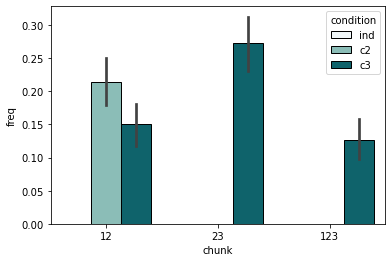

In [133]:
ax = sns.barplot(x="chunk", y="freq", hue="condition", hue_order = ["ind", "c2","c3"],palette=["#F0F8FA", "#83C5BE","#00707A"], edgecolor = ['k','k'],data=d_ck)

(array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

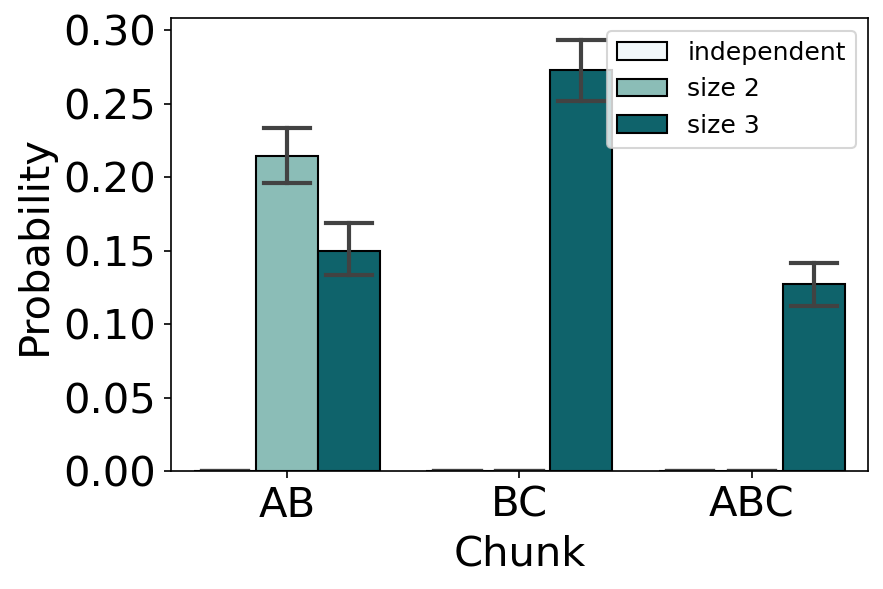

In [134]:
plt.figure(dpi=150)

ax = sns.barplot(x="chunk", y="freq", hue="condition", hue_order = ["ind", "c2","c3"],palette=["#F0F8FA", "#83C5BE","#00707A"], edgecolor = ['k','k'],errwidth = 2, capsize=0.2, ci=68, data=d_ck)
ax.set_xticklabels(['AB', 'BC', 'ABC'])
L = plt.legend(fontsize = 12)
L.get_texts()[0].set_text('independent')
L.get_texts()[1].set_text('size 2')
L.get_texts()[2].set_text('size 3')

plt.xlabel('Chunk', size = 20)
plt.ylabel('Probability', size = 20)
plt.xticks(size = 20)
plt.yticks(size = 20)


#ax.xaxis.label.set_size(20)
#ax.yaxis.label.set_size(20)



#plt.legend(['independent','size 2', 'size 3'])

# Experiment 2

In [153]:
# First, varying w, changes chunking behavior 
different_w = np.arange(0,1.2,0.2)
n_sample = 120
ref_T = pd.DataFrame(np.zeros([4,4]))
ref_M = pd.DataFrame(np.zeros([4,1]))
ref_T.columns = ref_T.index = ['[1]','[2]','[3]','[4]']
ref_M.index = ['[1]','[2]','[3]','[4]']
ref_M.columns = ['P']
bag_of_chunks = ['[1]','[2]','[3]','[4]']
partitioned_sequence = partition_seq(this_sequence,bag_of_chunks)
ref_M, ref_T = eval_M_T(ref_M,ref_T,partitioned_sequence)

kl_w = np.zeros([len(different_w),n_sample])
EUEP = np.zeros([len(different_w),n_sample])
number_of_chunks = np.zeros([len(different_w),n_sample])
average_chunk_length = np.zeros([len(different_w),n_sample])
mean_rt_w = np.zeros([len(different_w),n_sample])
accuracy_w = np.zeros([len(different_w),n_sample])


for i in range(0,n_sample):
    this_sequence, stim_set = generate_ABCD_sequences(n_sample = 200)# illusory chunks. 
    rt_w = []
    bagofchunk_w = []
    correctness_w = []
    cp_w = []
    reacted_press_w = []
    M_w = []
    T_w = []
    for w in range(0,len(different_w)):
    # question, with different c value, how does chunking behavior change?
        this_w = different_w[w]
        M,T,bagofchunk,rt,correctness,cp,reacted_press  = learn_sequence(this_sequence, Print = False, L_threshold = 0, w = this_w)
        M_w.append(M)
        T_w.append(T)
        bagofchunk_w.append(bagofchunk)
        rt_w.append(rt)
        correctness_w.append(correctness)
        cp_w.append(cp)
        reacted_press_w.append(reacted_press)

        number_of_chunks[w,i] = len(bagofchunk_w[w])
        chunks = bagofchunk_w[w]
        accuracy_w[w,i] = np.mean(correctness_w[w])
        mean_rt_w[w,i] = np.mean(rt_w[w])
        length = []
        for item in chunks:
            length.append(len(json.loads(item)))
        mean_EUEP = 0
        for chunk in chunks:
            chunk_p = M_w[w].loc[chunk]['P']
            mean_EUEP = mean_EUEP + len(json.loads(chunk))/-np.log(chunk_p + 0.0000001)

        mean_EUEP = mean_EUEP/4
        EUEP[w,i] = mean_EUEP
        
        accuracy_w[w,i] = np.mean(correctness_w[w])
        mean_rt_w[w,i] = np.mean(rt_w[w])
        length = []
        for item in chunks:
            length.append(len(json.loads(item)))
        average_chunk_length[w,i] = np.mean(length)

    # KL divergence between generated and original sequence
        this_T = T
        this_bag_of_chunks = this_T.index.tolist()
        this_M = M
        reproduced_seq = reproduce_sequence_df(this_M,this_T)
        ref_bag_of_chunks = ['[1]','[2]','[3]','[4]']
        partition_reproduced_seq = partition_seq(reproduced_seq,ref_bag_of_chunks)
        this_T_w = pd.DataFrame(np.zeros([4,4]))
        this_M_w = pd.DataFrame(np.zeros([4,1]))
        this_T_w.columns = this_T_w.index = ['[1]','[2]','[3]','[4]']
        this_M_w.index = ['[1]','[2]','[3]','[4]']
        this_M_w.columns = ['P']
        this_M_w, this_T_w = eval_M_T(ref_M.copy(),ref_T.copy(),partition_reproduced_seq)
        this_kl_w = conditional_KL(ref_M,ref_T,this_T_w)
        kl_w[w,i]= this_kl_w
        
        

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
this_M           P
[1]  0.220
[2]  0.260
[3]  0.255
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.260
[3]  0.255
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 2, 9, 7, 4, 3, 7, 4, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
this_M           P
[1]  0.220
[2]  0.260
[3]  0.255
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.260
[3]  0.255
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 7, 7, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7

this_M           P
[1]  0.220
[2]  0.260
[3]  0.255
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.886364  0.045455  0.022727
[2]  0.115385  0.096154  0.750000  0.038462
[3]  0.019608  0.058824  0.019608  0.901961
[4]  0.679245  0.075472  0.169811  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 4, 3, 8, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1

             [1]       [2]       [4]    [3, 4]
[1]     0.023256  0.883721  0.023256  0.046512
[2]     0.122449  0.102041  0.040816  0.734694
[4]     0.750000  0.125000  0.000000  0.125000
[3, 4]  0.600000  0.080000  0.100000  0.220000
this_M                 P
[1]     0.286667
[2]     0.326667
[4]     0.053333
[3, 4]  0.333333
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.023256  0.883721  0.023256  0.046512
[2]     0.122449  0.102041  0.040816  0.734694
[4]     0.750000  0.125000  0.000000  0.125000
[3, 4]  0.600000  0.080000  0.100000  0.220000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [6, 3, 2, 2, 2, 3, 3, 3, 3, 4, 6, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 4, 2, 2, 2, 2, 2, 2, 2, 6, 3, 6, 2, 5, 3, 3, 3, 3, 3, 3, 3, 3, 2, 6, 7, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 2, 2, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 4, 3, 3, 7, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 4, 3, 3, 6, 2, 3, 3, 2, 3, 3, 3, 2, 3, 6, 3, 2, 2, 3, 2, 3, 2, 6, 2, 2, 2, 2, 2, 2, 2, 5, 7, 3, 2, 3, 2, 3, 3, 3, 6, 5, 6, 3, 2, 2, 2, 3, 2, 2, 2, 6, 6, 6, 6, 6, 6, 6, 6, 4, 3, 2, 3, 3, 3, 2, 2, 3, 3, 2, 6, 3, 2, 3, 3, 3, 3, 3, 6, 3, 3, 2, 2, 2, 2, 2, 2, 2]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 

this_M                 P
[2]     0.098214
[4]     0.116071
[3, 4]  0.410714
[1, 2]  0.375000
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.272727  0.272727  0.363636  0.090909
[4]     0.230769  0.230769  0.076923  0.461538
[3, 4]  0.043478  0.086957  0.217391  0.652174
[1, 2]  0.071429  0.047619  0.738095  0.119048
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 5, 6, 6, 4, 2, 3, 3, 3, 2, 3, 2, 3, 3, 7

this_M                       P
[2]           0.097222
[4]           0.125000
[3, 4]        0.263889
[1, 2, 3, 4]  0.513889
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.285714  0.571429      0.142857
[4]           0.222222  0.222222  0.111111      0.444444
[3, 4]        0.052632  0.105263  0.105263      0.736842
[1, 2, 3, 4]  0.108108  0.054054  0.324324      0.486486
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1,

this_M                       P
[2]           0.097222
[4]           0.125000
[3, 4]        0.263889
[1, 2, 3, 4]  0.513889
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.285714  0.571429      0.142857
[4]           0.222222  0.222222  0.111111      0.444444
[3, 4]        0.052632  0.105263  0.105263      0.736842
[1, 2, 3, 4]  0.108108  0.054054  0.324324      0.486486
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.023256  0.023256
[2]  0.117647  0.098039  0.705882  0.058824
[3]  0.000000  0.020408  0.040816  0.938776
[4]  0.631579  0.087719  0.175439  0.105263
this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.023256  0.023256
[2]  0.117647  0.098039  0.705882  0.058824
[3]  0.000000  0.020408  0.040816  0.938776
[4]  0.631579  0.087719  0.175439  0.105263
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.023256  0.023256
[2]  0.117647  0.098039  0.705882  0.058824
[3]  0.000000  0.020408  0.040816  0.938776
[4]  0.631579  0.087719  0.175439  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 7, 9, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 2, 3, 3, 3, 3, 3, 3, 6, 3, 4, 3, 4, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.023256  0.023256
[2]  0.117647  0.098039  0.705882  0.058824
[3]  0.000000  0.020408  0.040816  0.938776
[4]  0.631579  0.087719  0.175439  0.105263
this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.023256  0.023256
[2]  0.117647  0.098039  0.705882  0.058824
[3]  0.000000  0.020408  0.040816  0.938776
[4]  0.631579  0.087719  0.175439  0.105263
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
this_M          P
[1]  0.23
[2]  0.29
[3]  0.24
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 

rt,  [7, 3, 7, 3, 2, 2, 4, 3, 2, 3, 5, 2, 5, 2, 2, 6, 2, 7, 3, 3, 3, 3, 6, 3, 3, 5, 3, 3, 3, 4, 3, 2, 2, 6, 3, 8, 2, 3, 3, 2, 3, 4, 3, 3, 3, 6, 6, 3, 8, 3, 3, 3, 2, 5, 3, 3, 3, 3, 2, 6, 3, 3, 3, 3, 6, 3, 3, 3, 3, 4, 3, 3, 2, 4, 3, 2, 3, 5, 3, 3, 2, 4, 3, 3, 2, 5, 6, 2, 3, 3, 3, 2, 6, 2, 2, 4, 8, 2, 3, 3, 3, 3, 5, 2, 3, 3, 2, 3, 6, 3, 2, 4, 6, 7, 3, 3, 3, 6, 6, 6, 6, 3, 3, 3, 3, 3, 6, 6, 5, 5, 5, 6, 3, 6, 3, 3, 4, 3, 3, 3, 6, 2, 3, 6, 6, 6, 5, 3, 3, 6, 3, 5, 2, 2, 6, 3, 3, 2, 2, 5, 3, 3, 3, 7, 3, 3, 3, 3, 5, 2, 4, 3, 2, 3, 4, 3, 3, 3, 4, 3, 2, 2, 5, 5, 5, 5, 3, 3, 3, 2, 2, 4, 7, 3, 2, 3, 4, 7, 2, 3]
reacted press  [2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 3, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 3, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
this_M          P
[1]  0.23
[2]  0.29
[3]  0.24
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 

rt,  [5, 3, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 8, 3, 8, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 8, 3, 9, 4, 3, 3, 3, 7, 3, 3, 3, 3, 3, 8, 3, 3, 6, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 6, 3, 3, 3, 7, 3, 3, 3, 8, 3, 3, 3, 4, 3, 3, 3, 7, 3, 3, 3, 7, 8, 3, 7, 3, 3, 6, 6, 3, 3, 3, 3, 3, 3, 7, 6, 3, 7, 3, 3, 3, 6, 3, 3, 4, 3, 6, 3, 3, 3, 3, 6, 8, 3, 9, 3, 3, 7, 3, 6, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 6, 6, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 6, 6, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 8, 3, 3]
reacted press  [2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 3, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 2, 3, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 3, 3, 4, 1, 3, 4, 2, 3, 1, 2, 3, 4, 1, 2, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
this_M          P
[1]  0.23
[2]  0.29
[3]  0.24
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
this_M          P
[1]  0.23
[2]  0.29
[3]  0.24
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.043478  0.000000
[2]  0.103448  0.068966  0.672414  0.155172
[3]  0.062500  0.062500  0.083333  0.770833
[4]  0.750000  0.145833  0.062500  0.041667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 

this_M                                     P
[1, 2]                       0.15625
[4, 1, 2]                    0.18750
[3, 4, 1, 2, 3, 4, 1, 2]     0.40625
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.25000
this_T                                 [1, 2]  [4, 1, 2]  [3, 4, 1, 2, 3, 4, 1, 2]  \
[1, 2]                       0.000000   0.000000                  0.800000   
[4, 1, 2]                    0.166667   0.333333                  0.500000   
[3, 4, 1, 2, 3, 4, 1, 2]     0.230769   0.307692                  0.230769   
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.125000   0.000000                  0.375000   

                             [2, 3, 4, 1, 2, 3, 4, 1, 2]  
[1, 2]                                          0.200000  
[4, 1, 2]                                       0.000000  
[3, 4, 1, 2, 3, 4, 1, 2]                        0.230769  
[2, 3, 4, 1, 2, 3, 4, 1, 2]                     0.375000  
correctness:  [1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[1]     0.289474
[2]     0.328947
[4]     0.065789
[3, 4]  0.315789
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.022727  0.931818  0.022727  0.022727
[2]     0.120000  0.060000  0.040000  0.760000
[4]     0.600000  0.100000  0.100000  0.200000
[3, 4]  0.645833  0.104167  0.104167  0.145833
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [8, 7, 6, 2, 3, 3, 7, 5, 2, 4, 3, 7, 3, 6, 3

rt,  [8, 8, 6, 3, 3, 3, 6, 6, 3, 3, 3, 6, 3, 7, 3, 7, 3, 3, 3, 3, 2, 3, 3, 4, 2, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 2, 3, 3, 4, 3, 3, 2, 3, 7, 2, 7, 3, 3, 7, 3, 6, 6, 7, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 6, 3, 7, 3, 2, 3, 3, 3, 3, 4, 3, 7, 3, 3, 3, 4, 3, 8, 3, 2, 7, 3, 3, 3, 2, 7, 3, 2, 4, 3, 3, 2, 3, 3, 7, 3, 3, 3, 7, 4, 8, 3, 3, 3, 3, 2, 3, 2, 6, 3, 3, 3, 3, 2, 7, 3, 3, 3, 2, 4, 3, 9, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 2, 4, 3, 3, 2, 8, 7, 7, 3, 3, 3, 3, 3, 3, 3, 7, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 3, 3, 7, 4, 3, 3, 2, 4, 3, 3, 2, 6, 3, 3, 8, 4, 2, 7, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 8]
reacted press  [4, 4, 3, 4, 1, 2, 3, 3, 4, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 

this_M           P
[1]  0.220
[2]  0.265
[3]  0.245
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.113208  0.056604  0.773585  0.037736
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.685185  0.111111  0.111111  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 6, 3, 3, 3, 7, 7, 3, 3, 3, 7, 3, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3

correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [7, 5, 6, 3, 2, 2, 2, 2, 2, 2, 6, 4, 2, 5, 2, 5, 2, 3, 3, 2, 3, 3, 3, 3, 3, 4, 2, 3, 2, 2, 2, 2, 2, 4, 2, 3, 2, 2, 3, 2, 3, 4, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 2, 2, 2, 3, 2, 4, 2, 3, 2, 2, 3, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 7, 4, 3, 2, 3, 3, 3, 3, 3, 5, 3, 6, 4, 2, 2, 2, 2, 2, 2, 3, 4, 2, 2, 3, 2, 2, 2, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 6, 5, 2, 3, 2, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.113208  0.056604  0.773585  0.037736
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.685185  0.111111  0.111111  0.092593
this_M           P
[1]  0.220
[2]  0.265
[3]  0.245
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.113208  0.056604  0.773585  0.037736
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.685185  0.111111  0.111111  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.265
[3]  0.245
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.113208  0.056604  0.773585  0.037736
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.685185  0.111111  0.111111  0.092593
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 8, 6, 3, 3, 3, 8, 6, 3, 3, 3, 7, 3, 7, 3, 7, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3

this_M                    P
[1]        0.375000
[4]        0.096154
[3, 4]     0.134615
[2, 3, 4]  0.394231
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.076923  0.000000  0.153846   0.769231
[4]        0.800000  0.000000  0.000000   0.200000
[3, 4]     0.500000  0.214286  0.071429   0.214286
[2, 3, 4]  0.512195  0.170732  0.146341   0.146341
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [7, 3, 4,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
this_M           P
[1]  0.235
[2]  0.245
[3]  0.250
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[1]        0.375000
[4]        0.096154
[3, 4]     0.134615
[2, 3, 4]  0.394231
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.076923  0.000000  0.153846   0.769231
[4]        0.800000  0.000000  0.000000   0.200000
[3, 4]     0.500000  0.214286  0.071429   0.214286
[2, 3, 4]  0.512195  0.170732  0.146341   0.146341
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [7, 2, 4,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
this_M           P
[1]  0.235
[2]  0.245
[3]  0.250
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 6, 3, 8, 3, 6, 3, 3, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 8, 3, 8, 6, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 6, 3, 3, 5, 8, 3, 3, 3, 3, 8, 3, 7, 3, 3, 3, 3, 3, 10, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 8, 3, 3, 3, 8, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 7, 7, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
this_M           P
[1]  0.235
[2]  0.245
[3]  0.250
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.765957  0.127660  0.042553
[2]  0.061224  0.102041  0.775510  0.061224
[3]  0.060000  0.000000  0.020000  0.920000
[4]  0.703704  0.148148  0.074074  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.280
[3]  0.225
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 2, 4, 3, 7, 3, 3, 4, 3, 4, 9, 4, 2, 3, 6, 3, 3, 2, 3, 3, 4, 2, 3, 3, 3, 2, 7, 3, 7, 6

this_M           P
[1]  0.215
[2]  0.280
[3]  0.225
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 3, 3, 3, 3, 3, 8, 3, 2, 3, 8, 3, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 7, 3, 6, 6

this_M           P
[1]  0.215
[2]  0.280
[3]  0.225
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 2, 3, 3, 7, 3, 3, 3, 3, 3, 7, 3, 3, 3, 7, 3, 4, 3, 4, 3, 3, 2, 3, 3, 3, 3, 8, 3, 7, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
this_M           P
[1]  0.215
[2]  0.280
[3]  0.225
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
this_M           P
[1]  0.215
[2]  0.280
[3]  0.225
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.976744  0.000000  0.023256
[2]  0.071429  0.160714  0.625000  0.142857
[3]  0.022222  0.000000  0.066667  0.888889
[4]  0.660714  0.089286  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 4, 4, 3, 4, 1, 4, 2, 2, 3, 4, 2, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 1, 2, 3, 4, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 4, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 4, 4, 3, 4, 1, 2, 3, 4]
['[2]', '[4]', '[1, 2]', '[3, 4, 1, 2]']
                   [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.125000  0.062500  0.000000      0.812500
[4]           0.090909  0.272727  0.272727      0.363636
[1, 2]        0.100000  0.100000  0.200000      0.600000
[3, 4, 1, 2]  0.307692  0.153846  0.102564      0.410256
this_M                       P
[2]           0.210526
[

rt,  [5, 3, 4, 3, 6, 4, 2, 3, 3, 3, 3, 6, 2, 4, 4, 7, 4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 7, 2, 6, 5, 2, 3, 3, 6, 5, 3, 3, 3, 4, 3, 7, 4, 2, 6, 4, 3, 3, 2, 3, 2, 7, 3, 2, 3, 2, 3, 3, 6, 4, 3, 3, 3, 6, 7, 6, 5, 3, 8, 3, 6, 5, 3, 3, 7, 5, 5, 6, 4, 2, 3, 3, 4, 3, 3, 2, 3, 3, 3, 2, 6, 4, 3, 7, 2, 3, 3, 3, 3, 4, 3, 9, 3, 3, 2, 7, 4, 3, 3, 2, 3, 2, 3, 2, 6, 4, 2, 7, 8, 2, 3, 2, 7, 8, 4, 3, 7, 2, 4, 3, 3, 3, 4, 4, 6, 4, 3, 3, 2, 3, 2, 3, 2, 3, 2, 4, 2, 3, 3, 7, 4, 2, 3, 2, 4, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 7, 3, 2, 7, 7, 4, 3, 3, 3, 3, 3, 3, 2, 4, 4, 6, 4, 3, 3, 2, 3, 2, 6, 5, 3, 3, 2, 3, 2, 6, 6, 5, 2, 3, 3, 3, 3]
reacted press  [1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 4, 4, 3, 4, 3, 4, 2, 2, 3, 4, 2, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 1, 2, 3, 4, 2, 3, 1, 2, 

correctness:  [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
rt,  [5, 2, 3, 2, 2, 2, 2, 2, 2, 2, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3, 2, 2, 2, 2, 2, 5, 3, 3, 7, 6, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 2, 2, 3, 3, 3, 3, 3, 5, 3, 3, 2, 2, 2, 3, 2, 3, 3, 5, 3, 2, 5, 3, 3, 3, 2, 2, 2, 3, 3, 3, 8, 3, 7, 2, 3, 2, 2, 3, 2, 3, 3, 5, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 6, 2

rt,  [5, 3, 3, 3, 6, 4, 3, 6, 3, 2, 3, 3, 6, 3, 3, 4, 3, 3, 3, 4, 3, 6, 7, 3, 3, 8, 6, 3, 2, 7, 6, 7, 3, 3, 8, 3, 7, 7, 3, 4, 3, 3, 2, 7, 4, 6, 4, 3, 3, 3, 4, 3, 3, 2, 7, 2, 4, 3, 3, 2, 4, 3, 3, 3, 6, 2, 6, 3, 4, 3, 3, 3, 4, 3, 8, 6, 3, 4, 3, 7, 3, 3, 2, 4, 6, 3, 6, 2, 7, 3, 3, 3, 3, 6, 3, 3, 3, 2, 7, 4, 3, 5, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 2, 3, 3, 3, 2, 6, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 2, 7, 5, 4, 3, 3, 3, 3, 3, 7, 3, 2, 4, 3, 3, 2, 3, 3, 3, 2, 4, 3, 6, 3, 2, 4, 3, 6, 5, 7, 3, 3, 6, 6, 3, 2, 3, 3, 3, 3, 3, 2, 3, 2, 4, 2, 3, 2, 4, 3, 3, 2, 6, 2, 4, 3, 3, 2, 6, 3, 2, 6, 2, 6, 3, 3, 6, 2]
reacted press  [3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 4, 1, 2, 2, 4, 2, 3, 4, 3, 4, 1, 1, 2, 3, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 2, 3, 4, 1, 4, 1, 2, 3, 4, 2, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
this_M           P
[1]  0.235
[2]  0.290
[3]  0.200
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
this_M           P
[1]  0.235
[2]  0.290
[3]  0.200
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
this_M           P
[1]  0.235
[2]  0.290
[3]  0.200
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
this_M           P
[1]  0.235
[2]  0.290
[3]  0.200
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.978723  0.021277  0.000000
[2]  0.137931  0.103448  0.603448  0.137931
[3]  0.050000  0.025000  0.000000  0.925000
[4]  0.672727  0.090909  0.054545  0.181818
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.923077  0.025641  0.025641
[2]  0.084746  0.203390  0.559322  0.152542
[3]  0.022222  0.000000  0.066667  0.911111
[4]  0.543860  0.192982  0.140351  0.105263
this_M           P
[1]  0.195
[2]  0.295
[3]  0.225
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.923077  0.025641  0.025641
[2]  0.084746  0.203390  0.559322  0.152542
[3]  0.022222  0.000000  0.066667  0.911111
[4]  0.543860  0.192982  0.140351  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [6, 3, 6, 6, 3, 6, 4, 3, 4, 6, 7, 7, 6, 6, 7, 4, 3, 4, 2, 3, 2, 5, 6, 4, 4, 7, 4, 3, 4, 2, 3, 3, 7, 4, 3, 5, 7, 4, 2, 4, 3, 4, 3, 4, 3, 4, 3, 8, 3, 4, 3, 4, 3, 4, 2, 6, 8, 3, 6, 3, 2, 4, 3, 3, 3, 5, 4, 4, 5, 6, 5, 3, 4, 3, 4, 3, 6, 4, 3, 3, 3, 4, 2, 6, 4, 2, 7, 6, 4, 3, 4, 3, 4, 2, 5, 4, 3, 8, 2, 4, 3, 6, 4, 3, 4, 3, 4, 3, 4, 3, 4, 2, 4, 3, 6, 4, 3, 4, 3, 4, 2, 4, 3, 6, 4, 2, 4, 3, 4, 3, 4, 4, 6, 6, 6, 4, 3, 3, 3, 8, 3, 6, 6, 6, 5, 2, 4, 2, 4, 3, 4, 3, 6, 6, 7, 6, 6, 6, 2, 4, 3, 6, 7, 3, 4, 2, 4, 3, 4, 2, 6, 4, 2, 7, 3, 8, 3, 3, 2, 6, 6, 6, 6, 4, 2, 4, 2, 6, 5, 4, 2, 4, 7, 2, 8, 2, 3, 3, 4, 2]
reacted press  [1, 2, 4, 3, 4, 2, 3, 4, 1, 2, 2, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 

this_M                       P
[2]           0.214286
[4]           0.214286
[1, 2]        0.154762
[3, 4, 1, 2]  0.416667
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.222222  0.277778  0.111111      0.388889
[4]           0.111111  0.111111  0.388889      0.388889
[1, 2]        0.076923  0.230769  0.076923      0.615385
[3, 4, 1, 2]  0.314286  0.228571  0.057143      0.371429
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,

rt,  [6, 3, 6, 6, 3, 5, 4, 3, 4, 6, 6, 8, 6, 8, 3, 4, 3, 4, 3, 4, 3, 6, 5, 4, 7, 3, 4, 3, 4, 3, 4, 3, 6, 4, 3, 5, 6, 4, 3, 4, 3, 4, 3, 4, 3, 4, 3, 7, 3, 4, 2, 4, 3, 3, 3, 6, 7, 3, 6, 3, 3, 4, 3, 4, 3, 6, 4, 7, 3, 6, 6, 3, 4, 3, 4, 3, 6, 4, 3, 4, 3, 4, 3, 5, 3, 3, 7, 6, 3, 3, 4, 3, 4, 3, 6, 4, 3, 6, 3, 4, 3, 6, 4, 2, 4, 3, 4, 3, 4, 3, 4, 3, 4, 3, 6, 4, 3, 4, 3, 4, 3, 4, 3, 6, 4, 3, 3, 3, 4, 3, 4, 8, 3, 7, 6, 4, 3, 4, 3, 7, 3, 6, 5, 7, 7, 3, 4, 3, 4, 3, 4, 3, 6, 6, 7, 6, 6, 6, 3, 3, 2, 6, 8, 3, 4, 3, 3, 3, 3, 3, 7, 4, 3, 8, 3, 7, 3, 4, 3, 7, 6, 6, 6, 4, 3, 4, 3, 5, 6, 4, 3, 4, 7, 3, 7, 3, 4, 3, 4, 3]
reacted press  [1, 2, 4, 3, 4, 2, 3, 4, 1, 2, 2, 4, 3, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 

rt,  [6, 3, 7, 4, 2, 2, 2, 2, 2, 2, 2, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 4, 2, 6, 6, 4, 3, 3, 3, 2, 2, 2, 2, 3, 2, 2, 5, 4, 3, 3, 3, 2, 3, 3, 3, 3, 5, 3, 3, 2, 2, 2, 3, 3, 3, 3, 5, 5, 5, 2, 3, 2, 2, 3, 3, 3, 2, 5, 2, 3, 2, 2, 2, 2, 3, 3, 3, 2, 5, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 4, 2, 2, 2, 2, 3, 3, 3, 3, 6, 4, 2, 6, 3, 3, 3, 2, 2, 2, 3, 2, 2, 5, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3, 5, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 2, 2, 2, 2, 2, 2, 3, 5, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 2, 2, 3, 3, 2, 3, 2, 2, 6, 7, 6, 4, 2, 3, 3, 3, 3, 3, 3, 3, 6, 2, 2, 2, 2, 2, 2, 2, 2]
reacted press  [1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 4, 1, 2, 2, 3, 4, 1, 2, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.923077  0.025641  0.025641
[2]  0.084746  0.203390  0.559322  0.152542
[3]  0.022222  0.000000  0.066667  0.911111
[4]  0.543860  0.192982  0.140351  0.105263
this_M           P
[1]  0.195
[2]  0.295
[3]  0.225
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.923077  0.025641  0.025641
[2]  0.084746  0.203390  0.559322  0.152542
[3]  0.022222  0.000000  0.066667  0.911111
[4]  0.543860  0.192982  0.140351  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.195
[2]  0.295
[3]  0.225
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.923077  0.025641  0.025641
[2]  0.084746  0.203390  0.559322  0.152542
[3]  0.022222  0.000000  0.066667  0.911111
[4]  0.543860  0.192982  0.140351  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 6, 7, 2, 6, 4, 3, 3, 8, 7, 7, 7, 7, 3, 4, 3, 4, 3, 3, 3, 6, 6, 4, 8, 3, 4, 3, 4, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
this_M           P
[1]  0.260
[2]  0.245
[3]  0.215
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

                [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.857143  0.142857   0.000000
[3]        0.000000  0.000000  0.083333   0.916667
[1, 2]     0.076923  0.538462  0.076923   0.307692
[4, 1, 2]  0.136364  0.522727  0.159091   0.159091
this_M                P
[2]        0.07
[3]        0.36
[1, 2]     0.13
[4, 1, 2]  0.44
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.857143  0.142857   0.000000
[3]        0.000000  0.000000  0.083333   0.916667
[1, 2]     0.076923  0.538462  0.076923   0.307692
[4, 1, 2]  0.136364  0.522727  0.159091   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1

                [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.857143  0.142857   0.000000
[3]        0.000000  0.000000  0.083333   0.916667
[1, 2]     0.076923  0.538462  0.076923   0.307692
[4, 1, 2]  0.136364  0.522727  0.159091   0.159091
this_M                P
[2]        0.07
[3]        0.36
[1, 2]     0.13
[4, 1, 2]  0.44
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.857143  0.142857   0.000000
[3]        0.000000  0.000000  0.083333   0.916667
[1, 2]     0.076923  0.538462  0.076923   0.307692
[4, 1, 2]  0.136364  0.522727  0.159091   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
this_M           P
[1]  0.260
[2]  0.245
[3]  0.215
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
this_M           P
[1]  0.260
[2]  0.245
[3]  0.215
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.076923  0.865385  0.019231  0.019231
[2]  0.040816  0.020408  0.775510  0.163265
[3]  0.069767  0.000000  0.000000  0.930233
[4]  0.750000  0.053571  0.071429  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

reacted press  [1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 4, 1, 2, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 1, 2, 4, 4, 1, 3, 4, 1, 2, 4, 1, 3, 4, 3, 4, 1, 2, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 3, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2]
['[2]', '[3]', '[1, 2]', '[4, 1, 2]']
                [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.857143  0.142857   0.000000
[3]        0.000000  0.000000  0.083333   0.916667
[1, 2]     0.076923  0.538462  0.076923   0.307692
[4, 1, 2]  0.136364  0.522727  0.159091   0.159091
this_M                P
[2]        0.07
[3]        0.36
[1, 2]     0.13
[4, 1, 2]  0.44


['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.808511  0.085106  0.063830
[2]  0.080000  0.140000  0.740000  0.040000
[3]  0.020408  0.020408  0.040816  0.897959
[4]  0.722222  0.074074  0.111111  0.092593
this_M           P
[1]  0.235
[2]  0.250
[3]  0.245
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.808511  0.085106  0.063830
[2]  0.080000  0.140000  0.740000  0.040000
[3]  0.020408  0.020408  0.040816  0.897959
[4]  0.722222  0.074074  0.111111  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 7, 7, 3, 7, 3, 3, 7, 2, 3, 3, 3, 2, 6, 2, 3, 3, 7, 6, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 3, 6, 3, 3, 3, 7, 4, 3, 7, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 9, 3, 3, 7, 5, 4, 8, 7, 2, 7, 3, 3, 3, 3, 3, 8, 7, 9, 3, 6, 3, 2, 3, 3, 3, 3, 4, 8, 4, 3, 3, 2, 3, 3, 3, 2, 7, 3, 7, 4, 3, 8, 6, 3, 2, 3, 3, 3, 2, 3, 3, 8, 7, 3, 3, 3, 7, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 2, 4, 3, 6, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 2, 3, 7, 2, 7, 7, 4, 8, 4, 3, 3, 2, 3, 3, 7, 3, 3, 2, 3, 3, 3, 2, 3, 7, 2, 3, 3, 3, 2, 6, 6]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 4, 1, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 1, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 2, 3, 

this_M           P
[1]  0.235
[2]  0.250
[3]  0.245
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.808511  0.085106  0.063830
[2]  0.080000  0.140000  0.740000  0.040000
[3]  0.020408  0.020408  0.040816  0.897959
[4]  0.722222  0.074074  0.111111  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 7, 3, 7, 3, 3, 6, 3, 3, 3, 3, 3

rt,  [4, 2, 4, 3, 3, 2, 4, 2, 3, 2, 3, 3, 3, 2, 4, 2, 3, 3, 7, 7, 6, 7, 2, 3, 3, 6, 4, 3, 3, 2, 7, 3, 3, 3, 7, 7, 3, 3, 3, 2, 6, 3, 3, 3, 2, 4, 4, 7, 3, 3, 2, 6, 3, 3, 7, 6, 3, 2, 3, 2, 3, 3, 3, 3, 4, 3, 3, 2, 6, 4, 2, 4, 3, 3, 2, 4, 3, 3, 3, 4, 2, 8, 3, 3, 7, 6, 3, 3, 3, 2, 7, 3, 3, 2, 4, 2, 7, 8, 8, 6, 6, 3, 2, 3, 3, 4, 2, 3, 3, 7, 3, 4, 2, 3, 2, 4, 3, 7, 3, 7, 4, 3, 6, 7, 3, 2, 3, 2, 4, 2, 4, 3, 7, 7, 6, 3, 3, 7, 4, 3, 4, 2, 3, 2, 3, 3, 3, 2, 3, 3, 8, 3, 2, 3, 2, 6, 3, 2, 3, 3, 3, 2, 3, 2, 4, 2, 3, 2, 6, 3, 2, 3, 3, 7, 5, 6, 4, 4, 6, 3, 4, 3, 3, 3, 6, 3, 4, 3, 3, 3, 3, 2, 3, 3, 7, 4, 2, 3, 3, 7, 7]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 4, 2, 3, 

this_M                                      P
[4]                          0.162162
[1, 2]                       0.243243
[3, 4, 1, 2, 3, 4, 1, 2]     0.405405
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.189189
this_T                                    [4]    [1, 2]  [3, 4, 1, 2, 3, 4, 1, 2]  \
[4]                          0.000000  0.333333                  0.666667   
[1, 2]                       0.111111  0.000000                  0.444444   
[3, 4, 1, 2, 3, 4, 1, 2]     0.266667  0.266667                  0.266667   
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.142857  0.285714                  0.428571   

                             [2, 3, 4, 1, 2, 3, 4, 1, 2]  
[4]                                             0.000000  
[1, 2]                                          0.444444  
[3, 4, 1, 2, 3, 4, 1, 2]                        0.133333  
[2, 3, 4, 1, 2, 3, 4, 1, 2]                     0.142857  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1,

rt,  [4, 2, 3, 3, 3, 2, 4, 3, 3, 2, 4, 2, 3, 2, 3, 2, 3, 3, 6, 6, 7, 7, 2, 3, 3, 7, 4, 3, 4, 2, 7, 2, 3, 2, 6, 6, 3, 2, 3, 3, 6, 3, 3, 3, 2, 4, 4, 7, 2, 3, 2, 7, 3, 3, 7, 6, 3, 2, 3, 2, 4, 3, 3, 2, 4, 3, 3, 3, 6, 4, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 2, 8, 3, 3, 7, 6, 4, 4, 3, 3, 7, 2, 3, 3, 3, 2, 7, 7, 7, 6, 6, 3, 2, 3, 3, 4, 2, 3, 3, 7, 2, 4, 3, 3, 2, 3, 3, 7, 3, 8, 4, 3, 6, 6, 3, 3, 3, 3, 4, 2, 3, 3, 7, 7, 6, 3, 3, 8, 4, 2, 4, 3, 3, 3, 4, 2, 3, 3, 4, 4, 8, 3, 3, 3, 3, 6, 3, 2, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 6, 3, 3, 3, 3, 7, 5, 6, 4, 4, 7, 3, 4, 2, 3, 2, 7, 2, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 2, 4, 3, 8, 8]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 4, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.022727  0.022727
[2]  0.081633  0.040816  0.836735  0.040816
[3]  0.037736  0.018868  0.056604  0.867925
[4]  0.666667  0.092593  0.148148  0.092593
this_M           P
[1]  0.220
[2]  0.245
[3]  0.265
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.022727  0.022727
[2]  0.081633  0.040816  0.836735  0.040816
[3]  0.037736  0.018868  0.056604  0.867925
[4]  0.666667  0.092593  0.148148  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.022727  0.022727
[2]  0.081633  0.040816  0.836735  0.040816
[3]  0.037736  0.018868  0.056604  0.867925
[4]  0.666667  0.092593  0.148148  0.092593
this_M           P
[1]  0.220
[2]  0.245
[3]  0.265
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.022727  0.022727
[2]  0.081633  0.040816  0.836735  0.040816
[3]  0.037736  0.018868  0.056604  0.867925
[4]  0.666667  0.092593  0.148148  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[4]           0.149254
[3, 4]        0.223881
[2, 3, 4]     0.104478
[1, 2, 3, 4]  0.522388
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.100000  0.200000   0.100000      0.600000
[3, 4]        0.000000  0.200000   0.133333      0.600000
[2, 3, 4]     0.000000  0.142857   0.285714      0.571429
[1, 2, 3, 4]  0.257143  0.257143   0.028571      0.457143
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[1]        0.365385
[4]        0.105769
[3, 4]     0.125000
[2, 3, 4]  0.403846
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.052632  0.026316  0.000000   0.921053
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.538462  0.000000  0.230769   0.153846
[2, 3, 4]  0.523810  0.214286  0.190476   0.071429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
rt,  [4, 3, 3,

rt,  [5, 3, 3, 4, 3, 3, 2, 3, 5, 3, 3, 2, 4, 2, 3, 2, 3, 3, 8, 3, 3, 3, 3, 8, 3, 9, 7, 2, 3, 3, 7, 3, 3, 3, 6, 6, 8, 3, 3, 4, 3, 3, 2, 7, 4, 3, 8, 3, 3, 6, 2, 4, 3, 3, 2, 7, 7, 4, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 7, 5, 3, 3, 6, 2, 3, 3, 6, 9, 2, 6, 3, 4, 3, 3, 3, 7, 4, 3, 9, 5, 3, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 2, 7, 4, 3, 3, 2, 4, 9, 3, 3, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 6, 2, 3, 3, 3, 2, 3, 3, 3, 3, 4, 3, 6, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 4, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 6, 6, 6, 2, 3, 3, 3, 2, 3, 3, 3, 2, 7, 2, 7, 3, 3, 7, 3, 2, 7, 3, 3, 3, 3, 7, 3, 3, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 3, 4, 1, 2, 3, 2, 3, 4, 3, 4, 1, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 3, 4, 1, 2, 3, 2, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 

this_M           P
[1]  0.220
[2]  0.245
[3]  0.265
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.022727  0.022727
[2]  0.081633  0.040816  0.836735  0.040816
[3]  0.037736  0.018868  0.056604  0.867925
[4]  0.666667  0.092593  0.148148  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 9, 6, 3, 4, 3

rt,  [6, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 6, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 4, 2, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 7, 3, 2, 3, 3, 3, 2, 2, 2, 2, 6, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 4, 2, 7, 5, 2, 2, 6, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 3, 3, 2, 2, 2, 2, 4, 3, 7, 2, 3, 2, 2, 3, 3, 2, 2, 3, 3, 3, 5, 3, 2, 4, 3, 3, 3, 2, 2, 2, 3, 3, 3, 4, 3, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 4, 2, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 6, 2, 3, 5, 3, 3, 5, 2, 3, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 

this_M           P
[1]  0.270
[2]  0.290
[3]  0.195
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.111111  0.851852  0.000000  0.018519
[2]  0.155172  0.120690  0.603448  0.120690
[3]  0.000000  0.051282  0.000000  0.948718
[4]  0.795918  0.061224  0.081633  0.061224
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 7, 3, 6, 7, 3, 4, 2, 3, 3, 4, 3, 8, 3, 8, 3, 3, 7, 6, 3, 3, 2, 3, 3, 4, 3, 7, 6

correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [5, 3, 3, 7, 3, 7, 8, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 4, 3, 8, 6, 3, 4, 3, 3, 3, 3, 3, 7, 7, 3, 7, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 7, 4, 3, 3, 3, 7, 3, 7, 8, 3, 3, 6, 3, 3, 4, 3, 3, 3, 4, 2, 3, 3, 3, 3, 3, 3, 7, 3, 6, 2, 7, 7, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 7, 4, 6, 7, 7, 3, 6, 7, 3, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 3, 3, 7

this_M                 P
[2]     0.105263
[3]     0.256579
[4]     0.315789
[1, 2]  0.322368
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.187500  0.500000  0.062500  0.250000
[3]     0.051282  0.000000  0.948718  0.000000
[4]     0.062500  0.083333  0.041667  0.812500
[1, 2]  0.163265  0.551020  0.142857  0.122449
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [5, 3, 2, 7, 3, 3, 7, 2, 4, 3, 3, 2, 3, 2, 8

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.111111  0.851852  0.000000  0.018519
[2]  0.155172  0.120690  0.603448  0.120690
[3]  0.000000  0.051282  0.000000  0.948718
[4]  0.795918  0.061224  0.081633  0.061224
this_M           P
[1]  0.270
[2]  0.290
[3]  0.195
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.111111  0.851852  0.000000  0.018519
[2]  0.155172  0.120690  0.603448  0.120690
[3]  0.000000  0.051282  0.000000  0.948718
[4]  0.795918  0.061224  0.081633  0.061224
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.111111  0.851852  0.000000  0.018519
[2]  0.155172  0.120690  0.603448  0.120690
[3]  0.000000  0.051282  0.000000  0.948718
[4]  0.795918  0.061224  0.081633  0.061224
this_M           P
[1]  0.270
[2]  0.290
[3]  0.195
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.111111  0.851852  0.000000  0.018519
[2]  0.155172  0.120690  0.603448  0.120690
[3]  0.000000  0.051282  0.000000  0.948718
[4]  0.795918  0.061224  0.081633  0.061224
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 8, 3, 6, 6, 3, 4, 3, 3, 3, 4, 3, 8, 3, 6, 3, 3, 7, 6, 3, 3, 2, 3, 3, 4, 3, 8, 6, 3, 6, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 6, 3, 7, 3, 2, 3, 3, 6, 3, 6, 8, 3, 3, 7, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 6, 3, 7, 7, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 4, 5, 7, 6, 3, 6, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 7, 3, 3, 8, 3, 3, 3, 4, 3, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
this_M           P
[1]  0.225
[2]  0.270
[3]  0.245
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
this_M           P
[1]  0.225
[2]  0.270
[3]  0.245
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
this_M           P
[1]  0.225
[2]  0.270
[3]  0.245
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 2, 7, 5, 3, 2, 5, 5, 5, 6, 3, 3, 3, 3, 4, 2, 3, 3, 5, 3, 3, 4, 2, 2, 3, 4, 4, 4, 4, 7, 3, 3, 2, 2, 3, 4, 3, 3, 3, 3, 2, 3, 2, 4, 3, 3, 3, 8, 3, 2, 3, 2, 4, 2, 2, 3, 4, 3, 2, 3, 5, 5, 5, 5, 3, 7, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 2, 5, 5, 5, 5, 2, 3, 5, 3, 2, 3, 4, 3, 2, 2, 7, 2, 3, 2, 2, 2, 4, 2, 2, 3, 4, 3, 2, 2, 7, 7, 6, 5, 3, 2, 2, 3, 4, 3, 3, 3, 5, 2, 3, 5, 5, 5, 6, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
this_M           P
[1]  0.225
[2]  0.270
[3]  0.245
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.225
[2]  0.270
[3]  0.245
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.933333  0.022222  0.044444
[2]  0.055556  0.074074  0.777778  0.074074
[3]  0.061224  0.020408  0.040816  0.877551
[4]  0.730769  0.134615  0.076923  0.057692
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 8, 2, 3, 3, 7, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3

this_T                                                         [4]    [3, 4]  \
[4]                                               0.000000  0.000000   
[3, 4]                                            0.000000  0.333333   
[2, 3, 4]                                         0.000000  0.000000   
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  0.181818  0.181818   

                                                  [2, 3, 4]  \
[4]                                                0.000000   
[3, 4]                                             0.000000   
[2, 3, 4]                                          0.333333   
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]   0.363636   

                                                  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                                                                       1.000000  
[3, 4]                                                                                    0.666667  
[2, 3, 4]   

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.812500  0.104167  0.020833
[2]  0.156863  0.078431  0.647059  0.117647
[3]  0.020833  0.041667  0.083333  0.854167
[4]  0.679245  0.113208  0.113208  0.075472
this_M           P
[1]  0.240
[2]  0.255
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.062500  0.812500  0.104167  0.020833
[2]  0.156863  0.078431  0.647059  0.117647
[3]  0.020833  0.041667  0.083333  0.854167
[4]  0.679245  0.113208  0.113208  0.075472
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

rt,  [7, 3, 2, 2, 2, 5, 3, 3, 7, 2, 4, 2, 3, 3, 5, 2, 2, 2, 6, 3, 3, 3, 3, 6, 7, 3, 6, 3, 2, 3, 3, 3, 3, 5, 3, 2, 3, 2, 5, 3, 2, 4, 3, 3, 2, 5, 3, 2, 2, 5, 3, 2, 3, 4, 4, 4, 4, 5, 8, 3, 3, 3, 6, 3, 4, 2, 2, 2, 5, 5, 5, 5, 5, 3, 3, 7, 6, 3, 3, 2, 3, 3, 4, 3, 3, 6, 3, 3, 4, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 6, 3, 4, 4, 4, 4, 5, 3, 3, 3, 2, 3, 2, 5, 3, 3, 3, 5, 2, 2, 2, 5, 3, 3, 5, 6, 3, 2, 2, 2, 5, 3, 3, 3, 3, 5, 3, 3, 3, 3, 6, 3, 3, 2, 3, 6, 3, 3, 3, 3, 5, 3, 2, 6, 6, 3, 3, 3, 3, 5, 2, 3, 3, 5, 2, 2, 2, 6, 2, 4, 3, 3, 2, 5, 3, 3, 3, 5, 5, 3, 3, 3, 3, 7, 3, 4, 4, 3, 3, 6, 3, 4, 4, 4, 4, 5, 3, 3, 7, 2, 7]
reacted press  [4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.812500  0.104167  0.020833
[2]  0.156863  0.078431  0.647059  0.117647
[3]  0.020833  0.041667  0.083333  0.854167
[4]  0.679245  0.113208  0.113208  0.075472
this_M           P
[1]  0.240
[2]  0.255
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.062500  0.812500  0.104167  0.020833
[2]  0.156863  0.078431  0.647059  0.117647
[3]  0.020833  0.041667  0.083333  0.854167
[4]  0.679245  0.113208  0.113208  0.075472
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.240
[2]  0.255
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.062500  0.812500  0.104167  0.020833
[2]  0.156863  0.078431  0.647059  0.117647
[3]  0.020833  0.041667  0.083333  0.854167
[4]  0.679245  0.113208  0.113208  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 3, 3, 4, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 6, 3, 7, 3, 7, 3, 7, 3, 3, 3

reacted press  [4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4]
['[4]', '[1, 2, 3, 4]', '[3, 4, 1, 2, 3, 4]', '[2, 3, 4, 1, 2, 3, 4]']
                            [4]  [1, 2, 3, 4]  [3, 4, 1, 2, 3, 4]  \
[4]                    0.000000      0.833333            0.166667   
[1, 2, 3, 4]           0.142857      0.357143            0.071429   
[3, 4, 1, 2, 3, 4]     0.250000      0.125000            0.125000   
[2, 3, 4, 1, 2, 3, 4]  0.076923   

this_M           P
[1]  0.235
[2]  0.245
[3]  0.215
[4]  0.305
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 3, 3, 7, 3, 3, 3, 5, 4, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 4, 3, 3, 6, 7, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
this_M           P
[1]  0.235
[2]  0.245
[3]  0.215
[4]  0.305
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

rt,  [5, 3, 3, 3, 7, 2, 4, 5, 3, 3, 4, 3, 3, 3, 5, 2, 3, 4, 3, 3, 3, 3, 3, 3, 6, 8, 3, 3, 3, 3, 3, 3, 7, 3, 3, 5, 3, 2, 4, 4, 3, 2, 3, 3, 7, 3, 4, 3, 2, 7, 3, 2, 3, 5, 2, 3, 9, 5, 5, 7, 3, 4, 3, 2, 3, 3, 3, 3, 7, 3, 3, 6, 7, 3, 3, 3, 2, 3, 3, 3, 3, 3, 7, 2, 3, 3, 2, 3, 3, 3, 3, 4, 4, 3, 3, 4, 5, 5, 7, 3, 3, 5, 3, 3, 8, 3, 3, 3, 3, 7, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 5, 2, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 5, 3, 3, 6, 6, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 9, 5, 3, 3, 5, 5, 7, 7, 7, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 8, 3, 3, 7, 3, 4, 3, 2, 3, 5, 3, 3, 4, 3, 2, 3, 3, 3, 3, 7, 7]
reacted press  [2, 3, 4, 1, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 3, 4, 1, 2, 4, 1, 2, 2, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 

this_M           P
[1]  0.235
[2]  0.245
[3]  0.215
[4]  0.305
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [6, 4, 3, 6, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 8, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
this_M           P
[1]  0.235
[2]  0.245
[3]  0.215
[4]  0.305
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
this_M           P
[1]  0.235
[2]  0.245
[3]  0.215
[4]  0.305
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.914894  0.042553  0.042553
[2]  0.040816  0.040816  0.653061  0.265306
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.704918  0.049180  0.098361  0.131148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.895833  0.083333  0.020833
[2]  0.135593  0.152542  0.610169  0.101695
[3]  0.085106  0.042553  0.063830  0.787234
[4]  0.782609  0.108696  0.065217  0.043478
this_M           P
[1]  0.240
[2]  0.295
[3]  0.235
[4]  0.230
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.895833  0.083333  0.020833
[2]  0.135593  0.152542  0.610169  0.101695
[3]  0.085106  0.042553  0.063830  0.787234
[4]  0.782609  0.108696  0.065217  0.043478
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.363636  0.454545  0.181818   0.000000
[3]        0.051282  0.076923  0.102564   0.769231
[1, 2]     0.200000  0.466667  0.133333   0.200000
[4, 1, 2]  0.050000  0.575000  0.175000   0.175000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
rt,  [5, 3, 3, 3, 6, 2, 2, 6, 3, 4, 3, 2, 3, 4, 3, 3, 2, 4, 3, 2, 2, 3, 6, 3, 7, 3, 6, 4, 3, 3, 3, 4, 3, 3, 3, 6, 6, 6, 6,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.895833  0.083333  0.020833
[2]  0.135593  0.152542  0.610169  0.101695
[3]  0.085106  0.042553  0.063830  0.787234
[4]  0.782609  0.108696  0.065217  0.043478
this_M           P
[1]  0.240
[2]  0.295
[3]  0.235
[4]  0.230
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.895833  0.083333  0.020833
[2]  0.135593  0.152542  0.610169  0.101695
[3]  0.085106  0.042553  0.063830  0.787234
[4]  0.782609  0.108696  0.065217  0.043478
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

rt,  [4, 2, 3, 3, 4, 6, 5, 6, 4, 4, 2, 3, 3, 3, 3, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 5, 5, 4, 2, 3, 2, 3, 3, 2, 2, 5, 5, 5, 6, 2, 2, 6, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 7, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 6, 6, 4, 2, 2, 3, 3, 3, 2, 3, 2, 2, 2, 6, 3, 4, 2, 3, 3, 2, 3, 3, 2, 3, 3, 3, 5, 5, 5, 4, 2, 3, 3, 3, 3, 3, 3, 4, 5, 6, 3, 4, 2, 3, 3, 3, 3, 3, 3, 6, 3, 4, 2, 2, 3, 3, 3, 3, 3, 5, 2, 2, 7, 4, 4, 4, 4, 4, 4, 4, 4, 5, 3, 2, 6, 2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 6, 2, 4, 2, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 5, 4, 2, 2, 2, 3, 2, 2, 3, 6, 3, 3, 3, 2, 2, 2, 3, 7, 7, 7, 7, 7, 7, 7, 7, 5, 4, 3, 2, 2, 2, 2, 2, 2, 5, 5, 5]
reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 

this_M                                   P
[2]                       0.239130
[1, 2]                    0.130435
[4, 1, 2]                 0.239130
[3, 4, 1, 2, 3, 4, 1, 2]  0.391304
this_T                                 [2]    [1, 2]  [4, 1, 2]  \
[2]                       0.272727  0.181818   0.090909   
[1, 2]                    0.000000  0.000000   0.500000   
[4, 1, 2]                 0.090909  0.090909   0.181818   
[3, 4, 1, 2, 3, 4, 1, 2]  0.388889  0.166667   0.277778   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.454545  
[1, 2]                                    0.500000  
[4, 1, 2]                                 0.545455  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.166667  
correctness:  [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1,

this_M           P
[1]  0.240
[2]  0.295
[3]  0.235
[4]  0.230
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.895833  0.083333  0.020833
[2]  0.135593  0.152542  0.610169  0.101695
[3]  0.085106  0.042553  0.063830  0.787234
[4]  0.782609  0.108696  0.065217  0.043478
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 8, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 7, 7, 4, 3, 3, 3, 3, 7, 3, 7, 3, 6, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
this_M           P
[1]  0.215
[2]  0.305
[3]  0.220
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.305
[3]  0.220
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 4, 3, 3, 3, 4, 3, 6, 3, 7, 8, 6, 3, 3, 6, 6, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 7

rt,  [6, 3, 3, 3, 2, 5, 3, 3, 3, 7, 6, 6, 6, 2, 7, 6, 4, 3, 4, 2, 2, 2, 4, 3, 3, 3, 4, 3, 3, 3, 5, 6, 5, 2, 4, 2, 2, 2, 4, 2, 3, 3, 4, 2, 2, 2, 6, 8, 4, 2, 2, 2, 5, 6, 3, 3, 3, 3, 5, 5, 4, 3, 6, 7, 4, 4, 6, 3, 3, 3, 3, 5, 6, 3, 3, 3, 4, 2, 2, 3, 5, 4, 3, 4, 2, 2, 2, 6, 4, 3, 2, 2, 5, 2, 2, 2, 5, 5, 6, 4, 3, 4, 2, 2, 2, 6, 2, 8, 5, 5, 5, 4, 2, 2, 2, 6, 3, 4, 3, 3, 3, 5, 4, 4, 6, 2, 4, 3, 3, 3, 4, 2, 3, 3, 4, 3, 2, 2, 4, 2, 3, 2, 5, 6, 4, 3, 3, 3, 6, 2, 4, 2, 3, 2, 5, 5, 5, 5, 5, 4, 3, 6, 3, 5, 4, 3, 3, 3, 6, 2, 4, 2, 2, 3, 5, 7, 7, 3, 2, 2, 4, 3, 3, 3, 7, 2, 5, 4, 2, 2, 2, 6, 4, 2, 2, 3, 4, 3, 3, 3]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 4, 1, 2, 3, 4, 2, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 3, 4, 2, 2, 2, 6, 6, 6, 6, 2, 8, 6, 4, 3, 4, 3, 2, 2, 4, 2, 2, 2, 4, 2, 2, 2, 5, 5, 6, 3, 4, 2, 3, 3, 5, 2, 3, 2, 4, 3, 3, 3, 6, 8, 3, 2, 2, 2, 5, 6, 4, 4, 4, 4, 5, 5, 4, 3, 6, 7, 5, 5, 6, 4, 3, 3, 3, 6, 6, 3, 2, 2, 4, 2, 3, 2, 5, 4, 2, 4, 2, 2, 2, 6, 3, 3, 3, 3, 4, 3, 2, 2, 5, 5, 5, 4, 3, 4, 2, 2, 2, 7, 2, 7, 6, 6, 6, 4, 3, 3, 3, 7, 3, 4, 3, 3, 3, 5, 4, 4, 6, 2, 4

this_M           P
[1]  0.215
[2]  0.305
[3]  0.220
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 4, 3, 4, 3, 3, 3, 6, 3, 7, 8, 7, 4, 3, 7, 7, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
this_M           P
[1]  0.215
[2]  0.305
[3]  0.220
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.147541  0.131148  0.606557  0.114754
[3]  0.022727  0.090909  0.022727  0.863636
[4]  0.634615  0.173077  0.076923  0.096154
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 3, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 2, 4, 3, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 4, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 4, 1, 2, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4]
['[2]', '[4]', '[1, 2]', '[3, 4]']
             [2]       [4]    [1, 2]    [3, 4]
[2]     0.166667  0.166667  0.166667  0.500000
[4]     0.187500  0.000000  0.625000  0.187500
[1, 2]  0.119048  0.142857  0.142857  0.595238
[3, 4]  0.170732  0.146341  0.560976  0.097561
this_M                 P
[2]     0.153846
[4]     0.136752
[1, 2]  0.358974
[3, 4]  0.350427
this_T               

this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.902439  0.024390  0.073171
[2]  0.078431  0.078431  0.764706  0.078431
[3]  0.018868  0.037736  0.037736  0.886792
[4]  0.636364  0.145455  0.200000  0.018182
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 2, 3, 3, 3, 3, 6, 3, 5, 3, 6, 3, 6, 3, 3, 7, 2, 6, 3, 3, 6, 3, 2, 6, 3, 5, 3, 6, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 7, 3, 3, 4, 3, 6, 7, 3, 2, 3, 3

this_M                P
[1]        0.33
[4]        0.08
[3, 4]     0.17
[2, 3, 4]  0.42
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.090909  0.030303   0.878788
[4]        1.000000  0.000000  0.000000   0.000000
[3, 4]     0.470588  0.058824  0.352941   0.058824
[2, 3, 4]  0.380952  0.095238  0.238095   0.285714
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
rt,  [5, 3, 2, 2, 4, 3, 3, 2, 5, 3

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
rt,  [4, 3, 3, 3, 4, 3, 3, 3, 5, 3, 5, 3, 4, 2, 4, 2, 4, 6, 3, 7, 3, 2, 5, 2, 2, 5, 2, 5, 3, 5, 3, 4, 3, 3, 3, 5, 2, 2, 5, 2, 2, 6, 2, 4, 3, 3, 3, 5, 2, 4, 3, 3, 3, 4, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 4, 3, 3, 2, 6, 2, 4, 3, 2, 3, 4, 2, 2, 2, 8, 2, 7, 2, 3, 3, 3, 5, 3, 2, 5, 3, 4, 3, 2, 2, 7, 2, 3, 2, 2, 5, 5, 5, 5, 2, 4, 7, 3, 3, 3, 2, 5, 3, 2, 7, 2, 3, 3, 2, 4, 3, 2, 2, 5, 3, 3, 3, 5

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.090909  0.030303   0.878788
[4]        1.000000  0.000000  0.000000   0.000000
[3, 4]     0.470588  0.058824  0.352941   0.058824
[2, 3, 4]  0.380952  0.095238  0.238095   0.285714
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
rt,  [5, 3, 3, 2, 4, 3, 2, 3, 5, 3, 5, 2, 5, 3, 5, 3, 4, 9, 3, 8, 3, 2, 5, 3, 2, 5, 3, 5, 2, 4, 3, 3, 3, 3, 3, 5, 3, 3, 5,

this_M                 P
[1]     0.266667
[2]     0.326667
[4]     0.066667
[3, 4]  0.340000
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.000000  0.900000  0.075000  0.025000
[2]     0.081633  0.081633  0.081633  0.755102
[4]     1.000000  0.000000  0.000000  0.000000
[3, 4]  0.490196  0.176471  0.058824  0.254902
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 2, 4, 3, 3, 3, 5, 3, 5, 3, 5, 3, 5

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.902439  0.024390  0.073171
[2]  0.078431  0.078431  0.764706  0.078431
[3]  0.018868  0.037736  0.037736  0.886792
[4]  0.636364  0.145455  0.200000  0.018182
this_M           P
[1]  0.205
[2]  0.255
[3]  0.265
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.902439  0.024390  0.073171
[2]  0.078431  0.078431  0.764706  0.078431
[3]  0.018868  0.037736  0.037736  0.886792
[4]  0.636364  0.145455  0.200000  0.018182
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.902439  0.024390  0.073171
[2]  0.078431  0.078431  0.764706  0.078431
[3]  0.018868  0.037736  0.037736  0.886792
[4]  0.636364  0.145455  0.200000  0.018182
this_M           P
[1]  0.205
[2]  0.255
[3]  0.265
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.

this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.000000  0.000000   0.000000      1.000000
[3, 4]        0.050000  0.300000   0.150000      0.450000
[2, 3, 4]     0.083333  0.333333   0.166667      0.416667
[1, 2, 3, 4]  0.100000  0.333333   0.233333      0.333333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1]
rt,  [4, 2, 3, 2, 4, 2, 3, 2, 5, 3, 5, 3, 5, 2, 5, 3, 4, 4, 4, 4, 5, 2, 6, 2, 2, 4, 3, 

this_M          P
[1]  0.24
[2]  0.25
[3]  0.22
[4]  0.29
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
rt,  [6, 7, 3, 3, 3, 3, 8, 8, 3, 3, 3, 3, 3, 3, 6, 3, 7, 6, 3, 3, 3, 3, 8, 3, 3, 2, 3, 3, 3, 3, 8, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
this_M          P
[1]  0.24
[2]  0.25
[3]  0.22
[4]  0.29
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
correctness:  [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
this_M          P
[1]  0.24
[2]  0.25
[3]  0.22
[4]  0.29
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                    P
[1]        0.074074
[2]        0.407407
[4, 1]     0.185185
[3, 4, 1]  0.333333
this_T                  [1]       [2]    [4, 1]  [3, 4, 1]
[1]        0.000000  0.750000  0.250000   0.000000
[2]        0.068182  0.068182  0.181818   0.681818
[4, 1]     0.050000  0.750000  0.100000   0.100000
[3, 4, 1]  0.111111  0.555556  0.222222   0.083333
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 8,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
this_M          P
[1]  0.24
[2]  0.25
[3]  0.22
[4]  0.29
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
correctness:  [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
this_M          P
[1]  0.24
[2]  0.25
[3]  0.22
[4]  0.29
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.854167  0.062500  0.062500
[2]  0.080000  0.060000  0.680000  0.180000
[3]  0.000000  0.045455  0.022727  0.931818
[4]  0.758621  0.068966  0.086207  0.086207
correctness:  [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M           P
[1]  0.200
[2]  0.265
[3]  0.260
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 6, 3, 3, 3, 3, 3, 7, 3, 5, 8, 7, 7, 3, 2, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
this_M           P
[1]  0.200
[2]  0.265
[3]  0.260
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 5, 2, 6, 3, 4, 3, 2, 2, 7, 3, 6, 6, 3, 7, 6, 3, 2, 2, 4, 3, 3, 3, 4, 3, 2, 2, 4, 3, 3, 3, 7, 3, 3, 3, 3, 2, 4, 3, 3, 3, 7, 7, 7, 3, 4, 2, 2, 2, 4, 5, 3, 3, 2, 3, 3, 5, 3, 2, 4, 3, 2, 2, 7, 3, 4, 3, 2, 2, 4, 3, 3, 3, 6, 3, 3, 6, 2, 4, 3, 2, 2, 6, 3, 2, 4, 2, 2, 3, 4, 3, 2, 2, 4, 3, 2, 2, 6, 6, 5, 3, 2, 4, 3, 3, 3, 6, 2, 6, 3, 2, 4, 2, 3, 2, 4, 3, 2, 2, 4, 2, 2, 2, 5, 2, 2, 5

this_M                    P
[1]        0.316327
[4]        0.102041
[3, 4]     0.122449
[2, 3, 4]  0.459184
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.000000  0.032258   0.967742
[4]        0.200000  0.200000  0.300000   0.300000
[3, 4]     0.583333  0.083333  0.166667   0.166667
[2, 3, 4]  0.488889  0.133333  0.133333   0.222222
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 5, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
this_M           P
[1]  0.200
[2]  0.265
[3]  0.260
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
this_M           P
[1]  0.200
[2]  0.265
[3]  0.260
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.200
[2]  0.265
[3]  0.260
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.050000  0.000000
[2]  0.037736  0.075472  0.773585  0.113208
[3]  0.096154  0.038462  0.019231  0.846154
[4]  0.600000  0.163636  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 6, 3, 4, 3, 3, 3, 6, 3, 6, 8, 7, 7, 4, 2, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
this_M           P
[1]  0.250
[2]  0.250
[3]  0.215
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 3, 3, 10, 3, 3, 3, 3, 3, 3, 7, 6, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 7, 6, 8, 3, 3, 3, 

this_M                       P
[2]           0.144737
[4]           0.184211
[3, 4]        0.171053
[1, 2, 3, 4]  0.500000
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.090909  0.181818  0.636364      0.090909
[4]           0.071429  0.142857  0.000000      0.785714
[3, 4]        0.230769  0.230769  0.000000      0.538462
[1, 2, 3, 4]  0.157895  0.184211  0.131579      0.500000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,

this_M                                                           P
[2]                                               0.103448
[4]                                               0.275862
[3, 4]                                            0.206897
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  0.413793
this_T                                                         [2]   [4]    [3, 4]  \
[2]                                               0.000000  0.00  0.666667   
[4]                                               0.250000  0.25  0.000000   
[3, 4]                                            0.000000  0.50  0.000000   
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  0.083333  0.25  0.250000   

                                                  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                                                                       0.333333  
[4]                                                                                       0.5000

this_M           P
[1]  0.250
[2]  0.250
[3]  0.215
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 7, 6, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
this_M           P
[1]  0.250
[2]  0.250
[3]  0.215
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.820000  0.060000  0.100000
[2]  0.180000  0.040000  0.700000  0.080000
[3]  0.023256  0.023256  0.046512  0.906977
[4]  0.701754  0.105263  0.035088  0.157895
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[2]     0.142857
[3]     0.259740
[4]     0.298701
[1, 2]  0.298701
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.772727  0.045455  0.136364
[3]     0.050000  0.025000  0.850000  0.075000
[4]     0.130435  0.086957  0.086957  0.695652
[1, 2]  0.304348  0.391304  0.152174  0.152174
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1]
rt,  [5, 3, 5, 3, 3, 2, 5, 3, 3, 7, 8, 7, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.100000  0.820000  0.060000  0.020000
[2]  0.133333  0.183333  0.583333  0.083333
[3]  0.069767  0.046512  0.023256  0.860465
[4]  0.702128  0.127660  0.085106  0.085106
this_M           P
[1]  0.250
[2]  0.300
[3]  0.215
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.100000  0.820000  0.060000  0.020000
[2]  0.133333  0.183333  0.583333  0.083333
[3]  0.069767  0.046512  0.023256  0.860465
[4]  0.702128  0.127660  0.085106  0.085106
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 2, 4, 3, 3, 2, 5, 3, 3, 7, 8, 7, 3, 3, 3, 3, 5, 6, 3, 5, 3, 3, 3, 3, 7, 3, 4, 8, 3, 5, 6, 3, 4, 3, 3, 3, 6, 3, 3, 6, 3, 2, 4, 3, 3, 3, 6, 3, 6, 2, 5, 3, 3, 2, 5, 5, 3, 3, 6, 3, 3, 5, 3, 3, 6, 3, 3, 3, 3, 4, 3, 3, 2, 5, 3, 3, 3, 3, 4, 7, 3, 4, 3, 3, 3, 7, 2, 4, 3, 3, 2, 5, 3, 3, 3, 3, 5, 3, 3, 3, 2, 4, 3, 3, 2, 6, 3, 2, 5, 3, 7, 3, 8, 3, 3, 7, 3, 3, 3, 7, 2, 4, 3, 3, 3, 5, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.100000  0.820000  0.060000  0.020000
[2]  0.133333  0.183333  0.583333  0.083333
[3]  0.069767  0.046512  0.023256  0.860465
[4]  0.702128  0.127660  0.085106  0.085106
this_M           P
[1]  0.250
[2]  0.300
[3]  0.215
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.100000  0.820000  0.060000  0.020000
[2]  0.133333  0.183333  0.583333  0.083333
[3]  0.069767  0.046512  0.023256  0.860465
[4]  0.702128  0.127660  0.085106  0.085106
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 2, 3, 2, 2, 2, 5, 3, 3, 3, 3, 4, 3, 2, 3, 3, 4, 6, 2, 8, 3, 3, 2, 2, 7, 3, 4, 4, 4, 2, 7, 2, 4, 2, 2, 2, 5, 3, 2, 6, 3, 3, 4, 2, 2, 2, 6, 3, 5, 2, 4, 3, 3, 3, 4, 8, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 5, 3, 2, 4, 2, 3, 3, 4, 3, 2, 2, 3, 6, 6, 6, 6, 5, 3, 3, 5, 2, 4, 2, 3, 3, 4, 4, 2, 3, 2, 4, 3, 3, 2, 2, 6, 2, 2, 3, 5, 3, 3, 4, 2, 2, 2, 4, 3, 2, 2, 2, 6, 3, 5, 3, 4, 3, 3, 2, 4, 3, 3, 3, 3, 5, 3, 3, 5, 3, 4, 2, 2, 2, 4, 7, 3, 2, 3, 2, 5, 8, 3, 2, 3, 2, 6, 2, 2, 2, 6, 3, 3, 3, 5, 3, 2, 5, 2, 7, 6, 3, 2, 3, 2, 2, 2, 6, 6, 6, 3, 6, 3, 3, 3, 5, 7, 3, 3, 3, 4, 7, 7, 3, 4, 3, 3, 2, 5, 3, 2, 2, 2, 6, 2]
reacted press  [1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 

rt,  [5, 3, 3, 3, 3, 3, 6, 4, 3, 7, 7, 8, 4, 3, 3, 7, 3, 6, 3, 6, 3, 3, 3, 3, 6, 3, 3, 6, 3, 5, 6, 3, 3, 3, 3, 9, 3, 4, 3, 7, 3, 3, 3, 3, 3, 7, 3, 3, 6, 3, 4, 3, 3, 3, 6, 8, 4, 9, 3, 3, 6, 3, 3, 3, 6, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 3, 4, 3, 3, 3, 6, 3, 4, 3, 3, 3, 6, 4, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 4, 3, 8, 3, 3, 4, 3, 7, 3, 7, 4, 3, 8, 3, 3, 3, 7, 3, 4, 3, 4, 3, 6, 4, 3, 7, 4, 3, 3, 5, 7, 3, 3, 3, 7, 8, 3, 6, 4, 3, 3, 3, 8, 7, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 8, 3, 3, 3, 7, 3, 7, 7, 3, 3, 4, 3, 3, 3, 3, 7, 3, 6, 3, 3, 7, 3, 3, 7, 3, 7, 3, 3, 6, 6, 3, 3, 3, 3, 3, 7, 4, 3, 7, 4, 7, 3]
reacted press  [1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 3, 4, 3, 4, 1, 1, 2, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 2, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 4, 1, 2, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 

this_M                 P
[2]     0.194915
[4]     0.110169
[1, 2]  0.364407
[3, 4]  0.330508
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.086957  0.043478  0.130435  0.695652
[4]     0.153846  0.076923  0.692308  0.076923
[1, 2]  0.279070  0.162791  0.162791  0.395349
[3, 4]  0.179487  0.102564  0.589744  0.128205
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 2, 4, 3, 4, 3, 6, 4, 3, 7, 7, 7, 6, 3, 4

reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 4, 4, 1, 4, 3, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 4, 1, 2, 3, 4, 4, 1, 2, 3, 2, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 4, 3, 4, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 1, 2, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 2, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.050000  0.875000  0.000000  0.050000
[2]     0.063830  0.085106  0.021277  0.829787
[4]     0.615385  0.076923  0.153846  0.153846
[3, 4]  0.520000  0.140000  0.200000  0.140000
this_M                 P
[1]     0.266667
[2]     0.313333
[4]     0.086667
[3, 4]  0.333333
this_T               [1]

this_M                 P
[1]     0.266667
[2]     0.313333
[4]     0.086667
[3, 4]  0.333333
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.050000  0.875000  0.000000  0.050000
[2]     0.063830  0.085106  0.021277  0.829787
[4]     0.615385  0.076923  0.153846  0.153846
[3, 4]  0.520000  0.140000  0.200000  0.140000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 2, 4, 3, 3, 2, 4, 3, 3, 3, 4, 7, 3

this_M                       P
[4]           0.253521
[3, 4]        0.112676
[2, 3, 4]     0.154930
[1, 2, 3, 4]  0.478873
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.111111  0.111111   0.166667      0.611111
[3, 4]        0.125000  0.500000   0.000000      0.375000
[2, 3, 4]     0.454545  0.000000   0.000000      0.545455
[1, 2, 3, 4]  0.294118  0.058824   0.235294      0.382353
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 2, 4, 6, 3, 3, 3, 6, 3, 4, 6, 3, 3, 3, 6, 3, 2, 4, 3, 7, 3, 2, 6, 3, 3, 6, 6, 3, 7, 7, 7, 2, 6, 2, 7, 2, 4, 3, 3, 3, 7, 3, 2, 6, 3, 3, 3, 3, 6, 3, 2, 4, 3, 3, 2, 4, 3, 3, 2, 4, 3, 3, 3, 7, 6, 3, 8, 2, 3, 3, 4, 3, 3, 2, 3, 3, 3, 3, 6, 7, 3, 2, 4, 3, 3, 2, 4, 3, 3, 2, 6, 6, 4, 7, 2, 4, 3, 3, 3, 5, 3, 3, 7, 7, 3, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 4, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.048780  0.878049  0.048780  0.000000
[2]  0.058824  0.098039  0.823529  0.019608
[3]  0.019231  0.076923  0.038462  0.865385
[4]  0.607143  0.107143  0.107143  0.178571
this_M           P
[1]  0.205
[2]  0.255
[3]  0.260
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.048780  0.878049  0.048780  0.000000
[2]  0.058824  0.098039  0.823529  0.019608
[3]  0.019231  0.076923  0.038462  0.865385
[4]  0.607143  0.107143  0.107143  0.178571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.205
[2]  0.255
[3]  0.260
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.048780  0.878049  0.048780  0.000000
[2]  0.058824  0.098039  0.823529  0.019608
[3]  0.019231  0.076923  0.038462  0.865385
[4]  0.607143  0.107143  0.107143  0.178571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 8, 3, 3, 4, 7, 3, 3, 3, 7, 3, 3, 3, 3, 6

rt,  [4, 3, 2, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 4, 4, 4, 5, 2, 3, 4, 4, 4, 4, 5, 6, 3, 2, 4, 2, 2, 2, 5, 6, 3, 3, 4, 7, 3, 4, 4, 4, 3, 4, 3, 4, 3, 5, 3, 3, 2, 5, 3, 3, 4, 4, 3, 2, 2, 5, 3, 3, 4, 3, 2, 3, 4, 3, 2, 2, 5, 3, 2, 2, 6, 6, 6, 4, 2, 2, 2, 5, 3, 3, 3, 5, 2, 2, 2, 5, 6, 3, 2, 4, 3, 2, 2, 4, 3, 3, 2, 5, 7, 3, 3, 3, 3, 5, 3, 2, 4, 3, 3, 3, 3, 5, 4, 3, 2, 3, 5, 3, 3, 3, 8, 3, 4, 3, 3, 3, 4, 3, 2, 3, 5, 3, 3, 3, 5, 4, 2, 2, 2, 5, 7, 3, 6, 3, 3, 3, 2, 8, 3, 5, 2, 2, 2, 6, 6, 6, 4, 4, 3, 3, 2, 5, 3, 2, 2, 2, 4, 2, 2, 3, 5, 7, 4, 2, 2, 2, 5, 2, 3, 4, 2, 2, 3, 5, 5, 5, 4, 3, 3, 3, 3, 4, 4, 3, 2, 3, 5, 5, 5, 5]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 3, 4, 3, 4, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

this_M                P
[1]        0.31
[4]        0.12
[3, 4]     0.14
[2, 3, 4]  0.43
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.000000  0.096774   0.903226
[4]        0.750000  0.083333  0.000000   0.166667
[3, 4]     0.571429  0.142857  0.142857   0.142857
[2, 3, 4]  0.325581  0.209302  0.209302   0.232558
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 6, 6, 6, 2, 6, 2, 2, 6, 2

this_M                P
[1]        0.31
[4]        0.12
[3, 4]     0.14
[2, 3, 4]  0.43
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.000000  0.096774   0.903226
[4]        0.750000  0.083333  0.000000   0.166667
[3, 4]     0.571429  0.142857  0.142857   0.142857
[2, 3, 4]  0.325581  0.209302  0.209302   0.232558
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 5, 6, 6, 3, 7, 3, 3, 5, 2

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.000000  0.096774   0.903226
[4]        0.750000  0.083333  0.000000   0.166667
[3, 4]     0.571429  0.142857  0.142857   0.142857
[2, 3, 4]  0.325581  0.209302  0.209302   0.232558
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 7, 8, 6, 2, 7, 3, 3, 6, 3, 2, 5, 3, 2, 5, 3, 2, 2, 5, 6, 6, 6, 5, 2, 4, 3, 2, 2, 5, 3, 3, 3, 5, 3, 7, 2, 6, 3, 2,

this_M                       P
[4]           0.173913
[3, 4]        0.159420
[2, 3, 4]     0.260870
[1, 2, 3, 4]  0.405797
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.083333  0.000000   0.166667      0.750000
[3, 4]        0.181818  0.181818   0.181818      0.454545
[2, 3, 4]     0.222222  0.333333   0.222222      0.166667
[1, 2, 3, 4]  0.178571  0.107143   0.321429      0.392857
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.904762  0.095238  0.000000
[2]  0.122807  0.122807  0.666667  0.087719
[3]  0.041667  0.041667  0.041667  0.875000
[4]  0.622642  0.169811  0.075472  0.113208
this_M           P
[1]  0.210
[2]  0.285
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.904762  0.095238  0.000000
[2]  0.122807  0.122807  0.666667  0.087719
[3]  0.041667  0.041667  0.041667  0.875000
[4]  0.622642  0.169811  0.075472  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.210
[2]  0.285
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.904762  0.095238  0.000000
[2]  0.122807  0.122807  0.666667  0.087719
[3]  0.041667  0.041667  0.041667  0.875000
[4]  0.622642  0.169811  0.075472  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 6, 3, 3, 7, 3, 3, 6, 4, 3, 3, 3, 3, 9, 3, 6, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
this_M           P
[1]  0.215
[2]  0.270
[3]  0.235
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0

this_M                       P
[2]           0.144737
[4]           0.157895
[1, 2]        0.223684
[3, 4, 1, 2]  0.473684
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.181818  0.000000  0.000000      0.818182
[4]           0.000000  0.166667  0.750000      0.083333
[1, 2]        0.058824  0.058824  0.000000      0.882353
[3, 4, 1, 2]  0.222222  0.222222  0.222222      0.305556
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
this_M           P
[1]  0.215
[2]  0.270
[3]  0.235
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
this_M           P
[1]  0.215
[2]  0.270
[3]  0.235
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.953488  0.000000  0.000000
[2]  0.055556  0.111111  0.740741  0.092593
[3]  0.000000  0.021277  0.021277  0.957447
[4]  0.696429  0.107143  0.107143  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                             P
[2]                 0.189655
[4]                 0.172414
[3, 4, 1, 2]        0.362069
[1, 2, 3, 4, 1, 2]  0.275862
this_T                           [2]       [4]  [3, 4, 1, 2]  [1, 2, 3, 4, 1, 2]
[2]                 0.181818  0.000000      0.818182            0.000000
[4]                 0.000000  0.100000      0.100000            0.800000
[3, 4, 1, 2]        0.190476  0.285714      0.285714            0.190476
[1, 2, 3, 4, 1, 2]  0.312500  0.125000      0.312500            0.250000
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 

correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 2, 3, 3, 7, 2, 7, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 7, 3, 2, 3, 2, 3, 3, 3, 3, 7, 7, 3, 6, 3, 3, 3, 3, 2, 7, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 2, 8, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 8, 3, 3, 3, 3, 2, 7, 3, 3, 6, 3, 3, 3, 3, 3, 3, 7, 4, 3, 3, 3, 7, 3, 3, 4, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 5, 3, 3, 2, 3, 3, 3, 3, 3, 2

reacted press  [4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.104167  0.791667  0.083333  0.020833
[2]  0.037736  0.075472  0.735849  0.150943
[3]  0.044444  0.066667  0.022222  0.866667
[4]  0.722222  0.129630  0.018519  0.111111
this_M           P
[1]  0.240
[2]  0.265
[3]  0.225
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.104167  0.

this_M                 P
[1]     0.098039
[2]     0.300654
[3]     0.287582
[4, 1]  0.313725
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.000000  0.800000  0.133333  0.066667
[2]     0.043478  0.086957  0.760870  0.108696
[3]     0.022727  0.068182  0.022727  0.886364
[4, 1]  0.250000  0.541667  0.125000  0.062500
correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 4, 7, 8, 8, 7, 3, 3, 5, 3, 3

this_M                 P
[1]     0.098039
[2]     0.300654
[3]     0.287582
[4, 1]  0.313725
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.000000  0.800000  0.133333  0.066667
[2]     0.043478  0.086957  0.760870  0.108696
[3]     0.022727  0.068182  0.022727  0.886364
[4, 1]  0.250000  0.541667  0.125000  0.062500
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 4, 9, 8, 8, 7, 3, 2, 5, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.104167  0.791667  0.083333  0.020833
[2]  0.037736  0.075472  0.735849  0.150943
[3]  0.044444  0.066667  0.022222  0.866667
[4]  0.722222  0.129630  0.018519  0.111111
this_M           P
[1]  0.240
[2]  0.265
[3]  0.225
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.104167  0.791667  0.083333  0.020833
[2]  0.037736  0.075472  0.735849  0.150943
[3]  0.044444  0.066667  0.022222  0.866667
[4]  0.722222  0.129630  0.018519  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1

reacted press  [2, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 2, 4, 4, 1, 2, 2, 3, 2, 3, 4, 1, 1, 2, 3, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 4, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 1, 2, 3, 4, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[1]', '[2]', '[3]', '[4, 1]']
             [1]       [2]       [3]    [4, 1]
[1]     0.000000  0.800000  0.133333  0.066667
[2]     0.043478  0.086957  0.760870  0.108696
[3]     0.022727  0.068182  0.022727  0.886364
[4, 1]  0.250000  0.541667  0.125000  0.062500
this_M                 P
[1]     0.098039
[2]     0.300654
[3]     0.287582
[4, 1]  0.313725
this_T               [1]

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.104167  0.791667  0.083333  0.020833
[2]  0.037736  0.075472  0.735849  0.150943
[3]  0.044444  0.066667  0.022222  0.866667
[4]  0.722222  0.129630  0.018519  0.111111
this_M           P
[1]  0.240
[2]  0.265
[3]  0.225
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.104167  0.791667  0.083333  0.020833
[2]  0.037736  0.075472  0.735849  0.150943
[3]  0.044444  0.066667  0.022222  0.866667
[4]  0.722222  0.129630  0.018519  0.111111
correctness:  [1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 8, 8, 7, 8, 6, 6, 8, 5, 2, 2, 3, 3, 3, 3, 3, 5, 3, 3, 2, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 3, 3, 3, 3, 6, 6, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 2, 2, 2, 2, 2, 6, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 2, 2, 2, 2, 2, 2, 5, 3, 3, 2, 2, 2, 2, 2, 5, 3, 4, 4, 4, 4, 4, 4, 4, 4, 6, 6, 3, 3, 2, 2, 2, 2, 2, 2, 2, 6, 2, 3, 6, 5, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 6, 6, 5, 3, 3, 2, 2, 2

this_M                 P
[1]     0.307692
[2]     0.320513
[4]     0.083333
[3, 4]  0.288462
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.083333  0.812500  0.062500  0.041667
[2]     0.160000  0.060000  0.080000  0.700000
[4]     0.846154  0.153846  0.000000  0.000000
[3, 4]  0.533333  0.133333  0.133333  0.177778
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 2, 6, 3, 6, 6, 6, 3, 7, 3, 4, 3

this_M                 P
[2]     0.131579
[4]     0.105263
[3, 4]  0.377193
[1, 2]  0.385965
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.000000  0.133333  0.600000  0.266667
[4]     0.083333  0.000000  0.000000  0.916667
[3, 4]  0.139535  0.139535  0.186047  0.511628
[1, 2]  0.181818  0.090909  0.590909  0.136364
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 8, 6, 3, 3, 6, 2, 6, 6, 6, 3, 3, 7, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
this_M          P
[1]  0.25
[2]  0.25
[3]  0.24
[4]  0.26
this_T            [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
this_M          P
[1]  0.25
[2]  0.25
[3]  0.24
[4]  0.26
this_T            [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4]
['[2]', '[4]', '[1, 2, 3, 4, 1, 2, 3, 4]', '[3, 4, 1, 2, 3, 4, 1, 2, 3, 4]']
                                     [2]       [4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                             0.000000  0.000000                  0.250000   
[4]                             0.000000  0.000000                  0.800000   
[1, 2, 3, 4, 1, 2, 3, 4]        0.153846  0.153846              

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
this_M          P
[1]  0.25
[2]  0.25
[3]  0.24
[4]  0.26
this_T            [1]       [2]       [3]       [4]
[1]  0.080000  0.820000  0.040000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.041667  0.000000  0.062500  0.875000
[4]  0.673077  0.115385  0.153846  0.057692
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.829787  0.063830  0.063830
[2]  0.122449  0.102041  0.673469  0.102041
[3]  0.000000  0.065217  0.043478  0.869565
[4]  0.672414  0.034483  0.137931  0.155172
this_M           P
[1]  0.235
[2]  0.245
[3]  0.230
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.829787  0.063830  0.063830
[2]  0.122449  0.102041  0.673469  0.102041
[3]  0.000000  0.065217  0.043478  0.869565
[4]  0.672414  0.034483  0.137931  0.155172
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
rt,  [6, 6, 7, 3, 3, 6, 3, 2, 4, 2, 4, 2, 7, 3, 2, 4, 3, 4, 3, 4, 2, 4, 2, 4, 2, 4, 2, 3, 3, 4, 3, 4, 2, 6, 3, 3, 4, 2, 4, 3, 4, 3, 4, 3, 5, 3, 3, 6, 3, 4, 3, 4, 4, 6, 3, 4, 2, 3, 2, 4, 3, 4, 2, 6, 3, 2, 4, 3, 3, 3, 4, 3, 5, 3, 6, 3, 3, 4, 2, 10, 3, 3, 3, 2, 4, 2, 5, 5, 6, 8, 6, 3, 7, 3, 2, 6, 8, 2, 4, 2, 6, 2, 3, 2, 4, 2, 4, 3, 4, 4, 6, 3, 3, 7, 3, 3, 6, 3, 2, 4, 2, 5, 3, 4, 2, 4, 

this_M                 P
[1]     0.299363
[2]     0.292994
[4]     0.127389
[3, 4]  0.280255
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.042553  0.829787  0.063830  0.063830
[2]     0.130435  0.108696  0.108696  0.652174
[4]     0.700000  0.050000  0.200000  0.050000
[3, 4]  0.568182  0.022727  0.159091  0.227273
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
rt,  [6, 6, 6, 3, 7, 2, 4, 3, 3, 3, 4, 3, 6, 3, 3

this_M                 P
[1]     0.299363
[2]     0.292994
[4]     0.127389
[3, 4]  0.280255
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.042553  0.829787  0.063830  0.063830
[2]     0.130435  0.108696  0.108696  0.652174
[4]     0.700000  0.050000  0.200000  0.050000
[3, 4]  0.568182  0.022727  0.159091  0.227273
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [7, 6, 6, 3, 7, 2, 4, 3, 3, 2, 4, 3, 7, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.829787  0.063830  0.063830
[2]  0.122449  0.102041  0.673469  0.102041
[3]  0.000000  0.065217  0.043478  0.869565
[4]  0.672414  0.034483  0.137931  0.155172
this_M           P
[1]  0.235
[2]  0.245
[3]  0.230
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.829787  0.063830  0.063830
[2]  0.122449  0.102041  0.673469  0.102041
[3]  0.000000  0.065217  0.043478  0.869565
[4]  0.672414  0.034483  0.137931  0.155172
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.235
[2]  0.245
[3]  0.230
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.829787  0.063830  0.063830
[2]  0.122449  0.102041  0.673469  0.102041
[3]  0.000000  0.065217  0.043478  0.869565
[4]  0.672414  0.034483  0.137931  0.155172
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1]
rt,  [5, 7, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.081633  0.877551  0.020408  0.020408
[2]  0.156863  0.039216  0.725490  0.058824
[3]  0.043478  0.065217  0.043478  0.847826
[4]  0.648148  0.055556  0.111111  0.185185
this_M           P
[1]  0.245
[2]  0.255
[3]  0.230
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.081633  0.877551  0.020408  0.020408
[2]  0.156863  0.039216  0.725490  0.058824
[3]  0.043478  0.065217  0.043478  0.847826
[4]  0.648148  0.055556  0.111111  0.185185
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 1, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 2, 3, 1, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 4, 3, 2, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]
['[2]', '[3]', '[4]', '[1, 2]']
             [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.600000  0.200000  0.200000
[3]     0.066667  0.044444  0.844444  0.044444
[4]     0.056604  0.113208  0.188679  0.641509
[1, 2]  0.086957  0.673913  0.043478  0.173913
this_M                 P
[2]     0.064935
[3]     0.292208
[4]     0.344156
[1, 2]  0.298701
this_T               [2]

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 5, 2, 3, 2, 3, 3, 5, 3, 2, 3, 6, 2, 3, 3, 2, 2, 5, 3, 3, 3, 5, 4, 2, 2, 3, 5, 3, 3, 3, 5, 7, 7, 2, 2, 2, 7, 2, 3, 3, 3, 3, 5, 4, 3, 2, 2, 5, 3, 3, 3, 6, 4, 6, 3, 3, 3, 3, 3, 5, 2, 3, 2, 2, 2, 5, 3, 3, 2, 3, 2, 6, 3, 3, 2, 2, 6, 7, 4, 4, 4, 4, 4, 6, 3, 2, 2, 2, 5, 7, 4, 3, 2, 3, 4, 3, 3, 3, 4, 3, 2, 2, 5, 3, 2, 3, 4, 2, 2, 2, 6, 3, 3, 3, 2, 2, 5, 5, 2, 8, 3, 3, 3, 2, 3, 6, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.081633  0.877551  0.020408  0.020408
[2]  0.156863  0.039216  0.725490  0.058824
[3]  0.043478  0.065217  0.043478  0.847826
[4]  0.648148  0.055556  0.111111  0.185185
this_M           P
[1]  0.245
[2]  0.255
[3]  0.230
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.081633  0.877551  0.020408  0.020408
[2]  0.156863  0.039216  0.725490  0.058824
[3]  0.043478  0.065217  0.043478  0.847826
[4]  0.648148  0.055556  0.111111  0.185185
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1

this_M                                   P
[2]                       0.137255
[4]                       0.254902
[3, 4]                    0.215686
[1, 2, 3, 4, 1, 2, 3, 4]  0.392157
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.000000  0.285714  0.428571   
[4]                       0.076923  0.153846  0.307692   
[3, 4]                    0.000000  0.363636  0.090909   
[1, 2, 3, 4, 1, 2, 3, 4]  0.300000  0.200000  0.150000   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.285714  
[4]                                       0.461538  
[3, 4]                                    0.545455  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.300000  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 5, 2, 4, 2, 2, 2, 2, 2, 3, 3, 6, 3, 3, 3, 2, 3, 3, 2, 2, 2, 6, 4, 2, 2, 3, 2, 3, 2, 2, 6, 8, 5, 2, 2, 2, 2, 2, 2, 2, 6, 3, 5, 4, 2, 3, 3, 2, 2, 2, 2, 5, 5, 6, 2, 4, 2, 2, 2, 2, 2, 2, 2, 5, 2, 3, 2, 2, 3, 2, 2, 5, 4, 3, 2, 2, 2, 2, 2, 2, 5, 3, 3, 3, 3, 3, 2, 3, 5, 6, 4, 3, 3, 3, 2, 3, 2, 2, 5, 3, 3, 2, 3, 2, 3, 3, 5, 2, 2, 2, 2, 2, 2, 2, 7, 7, 5, 5, 2, 7, 2, 4, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.942308  0.000000  0.038462
[2]  0.183333  0.133333  0.600000  0.066667
[3]  0.023256  0.023256  0.093023  0.860465
[4]  0.866667  0.044444  0.066667  0.022222
this_M           P
[1]  0.260
[2]  0.300
[3]  0.215
[4]  0.225
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.942308  0.000000  0.038462
[2]  0.183333  0.133333  0.600000  0.066667
[3]  0.023256  0.023256  0.093023  0.860465
[4]  0.866667  0.044444  0.066667  0.022222
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M                    P
[2]        0.113208
[3]        0.377358
[1, 2]     0.132075
[4, 1, 2]  0.377358
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.250000  0.500000  0.166667   0.083333
[3]        0.025000  0.100000  0.025000   0.850000
[1, 2]     0.071429  0.714286  0.214286   0.000000
[4, 1, 2]  0.175000  0.500000  0.200000   0.100000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 3,

rt,  [6, 2, 2, 4, 2, 3, 3, 5, 2, 3, 2, 5, 3, 3, 3, 3, 3, 6, 6, 6, 5, 2, 3, 2, 3, 3, 5, 2, 3, 3, 2, 2, 5, 6, 2, 6, 6, 4, 3, 2, 3, 6, 5, 4, 3, 3, 2, 5, 5, 5, 5, 5, 6, 2, 2, 5, 3, 6, 3, 3, 3, 3, 3, 6, 6, 6, 6, 3, 3, 4, 2, 3, 2, 6, 2, 2, 4, 2, 2, 3, 5, 2, 3, 3, 5, 3, 3, 3, 5, 5, 5, 5, 6, 4, 4, 4, 4, 6, 2, 3, 5, 2, 4, 2, 2, 3, 4, 3, 3, 3, 5, 4, 3, 3, 2, 4, 2, 2, 2, 4, 3, 3, 3, 4, 3, 2, 3, 4, 2, 2, 2, 5, 3, 3, 3, 3, 2, 5, 2, 3, 2, 3, 3, 6, 6, 6, 6, 3, 3, 4, 3, 2, 3, 6, 5, 6, 2, 3, 4, 4, 4, 4, 6, 2, 6, 6, 3, 6, 2, 3, 3, 2, 2, 6, 2, 6, 2, 3, 3, 2, 2, 5, 3, 4, 3, 3, 2, 4, 2, 3, 3, 6, 4, 3, 2, 2, 4, 3, 2, 2]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 1, 2, 2, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 

this_M                       P
[2]           0.173913
[1, 2]        0.217391
[4, 1, 2]     0.144928
[3, 4, 1, 2]  0.463768
this_T                     [2]    [1, 2]  [4, 1, 2]  [3, 4, 1, 2]
[2]           0.250000  0.166667   0.166667      0.416667
[1, 2]        0.133333  0.200000   0.000000      0.666667
[4, 1, 2]     0.000000  0.300000   0.200000      0.500000
[3, 4, 1, 2]  0.218750  0.218750   0.156250      0.375000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T                     [2]    [1, 2]  [4, 1, 2]  [3, 4, 1, 2]
[2]           0.250000  0.166667   0.166667      0.416667
[1, 2]        0.133333  0.200000   0.000000      0.666667
[4, 1, 2]     0.000000  0.300000   0.200000      0.500000
[3, 4, 1, 2]  0.218750  0.218750   0.156250      0.375000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 4, 2, 3, 3, 5, 3, 3, 3, 5, 3, 3, 3, 3, 3, 6, 6, 6, 5, 2, 4, 2, 2, 3, 6, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.942308  0.000000  0.038462
[2]  0.183333  0.133333  0.600000  0.066667
[3]  0.023256  0.023256  0.093023  0.860465
[4]  0.866667  0.044444  0.066667  0.022222
this_M           P
[1]  0.260
[2]  0.300
[3]  0.215
[4]  0.225
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.942308  0.000000  0.038462
[2]  0.183333  0.133333  0.600000  0.066667
[3]  0.023256  0.023256  0.093023  0.860465
[4]  0.866667  0.044444  0.066667  0.022222
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 8, 3, 7, 7, 3, 9, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 8, 3, 3, 3, 3, 3, 7, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 9, 3, 3, 3, 3, 3, 7, 8, 3, 3, 3, 3, 3, 3, 7, 3, 8, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 5, 7, 3, 3, 3, 7, 3, 3, 3, 6, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
this_M          P
[1]  0.24
[2]  0.24
[3]  0.24
[4]  0.28
this_T            [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
this_M          P
[1]  0.24
[2]  0.24
[3]  0.24
[4]  0.28
this_T            [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 

reacted press  [2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
this_M          P
[1]  0.24
[2]  0.24
[3]  0.24
[4]  0.28
this_T            [1]       [2]       [3]       [4]
[1] 

correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 6, 5, 6, 3, 6, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 5, 3, 2, 2, 2, 3, 3, 3, 4, 3, 3, 2, 2, 2, 2, 2, 5, 4, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 4, 3, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 5, 3, 2, 2, 3, 2, 2, 2, 2, 6, 3, 3, 5, 5, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 4, 2, 3, 3, 3, 3, 3, 3, 5, 3, 3, 5, 4, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 4, 2, 2, 2, 2, 2

reacted press  [2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.062500  0.854167  0.041667  0.020833
[2]  0.083333  0.020833  0.791667  0.104167
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.678571  0.071429  0.125000  0.125000
this_M          P
[1]  0.24
[2]  0.24
[3]  0.24
[4]  0.28
this_T            [1]       [2]       [3]       [4]
[1] 

this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.020408  0.020408  0.816327  0.122449
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.736842  0.070175  0.070175  0.122807
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 9, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3

             [1]       [2]       [3]    [4, 1]
[1]     0.000000  1.000000  0.000000  0.000000
[2]     0.022222  0.022222  0.822222  0.133333
[3]     0.046512  0.046512  0.046512  0.860465
[4, 1]  0.180000  0.580000  0.080000  0.140000
this_M                 P
[1]     0.080000
[2]     0.300000
[3]     0.286667
[4, 1]  0.333333
this_T               [1]       [2]       [3]    [4, 1]
[1]     0.000000  1.000000  0.000000  0.000000
[2]     0.022222  0.022222  0.822222  0.133333
[3]     0.046512  0.046512  0.046512  0.860465
[4, 1]  0.180000  0.580000  0.080000  0.140000
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.020408  0.020408  0.816327  0.122449
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.736842  0.070175  0.070175  0.122807
this_M           P
[1]  0.235
[2]  0.245
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.020408  0.020408  0.816327  0.122449
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.736842  0.070175  0.070175  0.122807
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

               [1]    [4, 1]  [3, 4, 1]  [2, 3, 4, 1]
[1]           0.00  0.000000   0.000000      1.000000
[4, 1]        0.10  0.000000   0.100000      0.700000
[3, 4, 1]     0.25  0.250000   0.000000      0.500000
[2, 3, 4, 1]  0.25  0.222222   0.194444      0.333333
this_M                       P
[1]           0.181818
[4, 1]        0.151515
[3, 4, 1]     0.121212
[2, 3, 4, 1]  0.545455
this_T                 [1]    [4, 1]  [3, 4, 1]  [2, 3, 4, 1]
[1]           0.00  0.000000   0.000000      1.000000
[4, 1]        0.10  0.000000   0.100000      0.700000
[3, 4, 1]     0.25  0.250000   0.000000      0.500000
[2, 3, 4, 1]  0.25  0.222222   0.194444      0.333333
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.020408  0.020408  0.816327  0.122449
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.736842  0.070175  0.070175  0.122807
this_M           P
[1]  0.235
[2]  0.245
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.020408  0.020408  0.816327  0.122449
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.736842  0.070175  0.070175  0.122807
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [4, 2, 9, 7, 6, 2, 3, 4, 4, 4, 4, 6, 3, 3, 5, 2, 3, 2, 3, 3, 4, 3, 2, 3, 5, 2, 2, 2, 5, 2, 3, 3, 5, 2, 2, 2, 3, 5, 3, 2, 2, 5, 3, 3, 2, 3, 3, 6, 3, 3, 2, 3, 5, 5, 5, 5, 5, 2, 2, 2, 2, 5, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 3, 2, 4, 2, 2, 2, 5, 3, 3, 3, 2, 3, 5, 2, 2, 2, 5, 2, 3, 3, 3, 5, 2, 2, 3, 3, 5, 3, 3, 3, 6, 6, 7, 2, 3, 3, 3, 5, 3, 3, 3, 3, 6, 2, 3, 3, 2, 2, 5, 3, 2, 3, 2, 5, 3, 2, 2, 5, 2, 3, 3, 3, 3, 6, 2, 2, 4, 3, 2, 2, 5, 2, 3, 2, 5, 3, 2, 2, 5, 2, 3, 3, 3, 5, 3, 3, 5, 3, 3, 3, 3, 6, 2, 2, 5, 2, 2, 3, 3, 5, 3, 7, 3, 3, 4, 4, 4, 4, 5, 3, 3, 2, 2, 2, 5, 3, 2, 3, 2, 5, 5, 5, 5, 6, 6, 6, 5, 5]
reacted press  [2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 

               [1]    [4, 1]  [3, 4, 1]  [2, 3, 4, 1]
[1]           0.00  0.000000   0.000000      1.000000
[4, 1]        0.10  0.000000   0.100000      0.700000
[3, 4, 1]     0.25  0.250000   0.000000      0.500000
[2, 3, 4, 1]  0.25  0.222222   0.194444      0.333333
this_M                       P
[1]           0.181818
[4, 1]        0.151515
[3, 4, 1]     0.121212
[2, 3, 4, 1]  0.545455
this_T                 [1]    [4, 1]  [3, 4, 1]  [2, 3, 4, 1]
[1]           0.00  0.000000   0.000000      1.000000
[4, 1]        0.10  0.000000   0.100000      0.700000
[3, 4, 1]     0.25  0.250000   0.000000      0.500000
[2, 3, 4, 1]  0.25  0.222222   0.194444      0.333333
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.076923  0.000000  0.025641   0.897436
[4]        0.666667  0.111111  0.111111   0.111111
[3, 4]     0.818182  0.000000  0.000000   0.181818
[2, 3, 4]  0.477273  0.159091  0.204545   0.136364
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 7, 3, 3, 3, 3, 3, 6, 2, 3, 3, 2, 3, 6, 3, 3, 3, 2, 3, 6, 3, 3, 6, 2, 2, 4, 3, 3, 3, 6, 3, 3, 2, 3, 4, 3, 3, 2,

this_M                       P
[4]           0.151515
[3, 4]        0.166667
[2, 3, 4]     0.151515
[1, 2, 3, 4]  0.530303
this_T                [4]  [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.1     0.2   0.100000      0.600000
[3, 4]        0.0     0.0   0.181818      0.818182
[2, 3, 4]     0.1     0.2   0.200000      0.400000
[1, 2, 3, 4]  0.2     0.2   0.142857      0.457143
correctness:  [1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.866667  0.044444  0.022222
[2]  0.060000  0.040000  0.820000  0.060000
[3]  0.039216  0.039216  0.019608  0.901961
[4]  0.685185  0.129630  0.129630  0.055556
this_M           P
[1]  0.225
[2]  0.250
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.866667  0.044444  0.022222
[2]  0.060000  0.040000  0.820000  0.060000
[3]  0.039216  0.039216  0.019608  0.901961
[4]  0.685185  0.129630  0.129630  0.055556
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4]
['[4]', '[3, 4]', '[2, 3, 4]', '[1, 2, 3, 4, 1, 2, 3, 4]']
                               [4]    [3, 4]  [2, 3, 4]  \
[4]                       0.111111  0.222222   0.111111   
[3, 4]                    0.000000  0.000000   0.250000   
[2, 3, 4]                 0.166667  0.166667   0.333333   
[1, 2, 3, 4, 1, 2, 3, 4]  0.300000  0.250000   0.050000   

                       

this_M           P
[1]  0.225
[2]  0.250
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.866667  0.044444  0.022222
[2]  0.060000  0.040000  0.820000  0.060000
[3]  0.039216  0.039216  0.019608  0.901961
[4]  0.685185  0.129630  0.129630  0.055556
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 8, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 6, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.866667  0.044444  0.022222
[2]  0.060000  0.040000  0.820000  0.060000
[3]  0.039216  0.039216  0.019608  0.901961
[4]  0.685185  0.129630  0.129630  0.055556
this_M           P
[1]  0.225
[2]  0.250
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.866667  0.044444  0.022222
[2]  0.060000  0.040000  0.820000  0.060000
[3]  0.039216  0.039216  0.019608  0.901961
[4]  0.685185  0.129630  0.129630  0.055556
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.225
[2]  0.250
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.844444  0.066667  0.044444
[2]  0.040000  0.100000  0.820000  0.040000
[3]  0.000000  0.000000  0.000000  0.979592
[4]  0.732143  0.107143  0.089286  0.071429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1]
rt,  [5, 7, 3, 2, 3, 3, 7, 3, 3, 3, 3, 3, 2, 6, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 2, 3, 3, 3, 2, 3

correctness:  [1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
rt,  [5, 5, 6, 6, 3, 3, 3, 3, 6, 2, 3, 2, 2, 8, 3, 3, 4, 3, 3, 2, 7, 2, 3, 2, 2, 4, 3, 2, 3, 4, 3, 2, 2, 4, 3, 3, 3, 6, 3, 3, 3, 3, 3, 5, 2, 3, 2, 3, 3, 3, 2, 2, 6, 2, 3, 2, 2, 3, 7, 7, 3, 3, 3, 3, 4, 3, 3, 2, 4, 8, 3, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 6, 3, 3, 3, 3, 3, 4, 3, 2, 3, 4, 6, 2, 6, 3, 3, 4, 3, 2, 3, 6, 3, 3, 3, 2, 3, 4, 3, 3, 2, 4, 3, 2, 2, 6, 2, 4, 3, 3, 2, 4, 3, 3, 2, 4

this_M           P
[1]  0.225
[2]  0.250
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.844444  0.066667  0.044444
[2]  0.040000  0.100000  0.820000  0.040000
[3]  0.000000  0.000000  0.000000  0.979592
[4]  0.732143  0.107143  0.089286  0.071429
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
rt,  [5, 6, 3, 3, 3, 3, 6, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 2, 7, 3, 3, 3, 2, 3, 3, 3, 3, 3

this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.000000  0.111111   0.000000      0.888889
[3, 4]        0.000000  0.090909   0.090909      0.727273
[2, 3, 4]     0.333333  0.166667   0.000000      0.500000
[1, 2, 3, 4]  0.184211  0.210526   0.105263      0.500000
correctness:  [1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1]
rt,  [7, 6, 7, 4, 3, 2, 2, 2, 6, 3, 3, 2, 3, 7, 2, 2, 4, 2, 2, 3, 5, 3, 2, 2, 2, 4, 3, 

['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.044444  0.844444  0.044444  0.066667
[2]     0.040000  0.100000  0.040000  0.820000
[4]     0.875000  0.125000  0.000000  0.000000
[3, 4]  0.693878  0.102041  0.081633  0.102041
this_M                 P
[1]     0.296053
[2]     0.328947
[4]     0.052632
[3, 4]  0.322368
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.044444  0.844444  0.044444  0.066667
[2]     0.040000  0.100000  0.040000  0.820000
[4]     0.875000  0.125000  0.000000  0.000000
[3, 4]  0.693878  0.102041  0.081633  0.102041
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.844444  0.066667  0.044444
[2]  0.040000  0.100000  0.820000  0.040000
[3]  0.000000  0.000000  0.000000  0.979592
[4]  0.732143  0.107143  0.089286  0.071429
this_M           P
[1]  0.225
[2]  0.250
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.844444  0.066667  0.044444
[2]  0.040000  0.100000  0.820000  0.040000
[3]  0.000000  0.000000  0.000000  0.979592
[4]  0.732143  0.107143  0.089286  0.071429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
this_M           P
[1]  0.245
[2]  0.250
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.040816  0.877551  0.061224  0.020408
[2]     0.060000  0.100000  0.100000  0.720000
[4]     0.818182  0.000000  0.090909  0.090909
[3, 4]  0.777778  0.044444  0.044444  0.133333
this_M                 P
[1]     0.316129
[2]     0.322581
[4]     0.070968
[3, 4]  0.290323
this_T               [1]

rt,  [5, 2, 8, 2, 2, 3, 2, 3, 2, 3, 3, 7, 3, 2, 3, 3, 6, 3, 2, 7, 3, 2, 4, 2, 3, 3, 3, 2, 3, 3, 3, 3, 6, 2, 3, 2, 3, 3, 3, 2, 7, 2, 2, 3, 2, 7, 2, 4, 3, 3, 3, 3, 2, 3, 3, 6, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3, 8, 3, 4, 2, 3, 3, 6, 3, 2, 6, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 7, 2, 2, 8, 3, 3, 6, 2, 3, 3, 3, 4, 2, 3, 2, 4, 3, 3, 3, 6, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 6, 2, 3, 2, 6, 3, 2, 3, 2, 8, 2, 3, 7, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 2, 8, 6, 3, 2, 8, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4, 2, 6, 3, 6, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3]
reacted press  [3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 3, 

this_M           P
[1]  0.245
[2]  0.250
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 10, 3, 3, 3, 3, 3, 2, 3, 3, 6, 3, 2, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 

this_M           P
[1]  0.245
[2]  0.250
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 8, 4, 2, 3, 3, 7, 3, 3, 7, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
this_M           P
[1]  0.245
[2]  0.250
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.877551  0.020408  0.061224
[2]  0.060000  0.100000  0.720000  0.100000
[3]  0.000000  0.000000  0.021739  0.978261
[4]  0.800000  0.036364  0.127273  0.036364
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_M                                   P
[2]                       0.133333
[4]                       0.133333
[1, 2]                    0.266667
[3, 4, 1, 2, 3, 4, 1, 2]  0.466667
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.000000  0.000000  0.000000   
[4]                       0.000000  0.000000  1.000000   
[1, 2]                    0.250000  0.166667  0.000000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.142857  0.190476  0.285714   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       1.000000  
[4]                                       0.000000  
[1, 2]                                    0.583333  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.333333  
correctness:  [1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
this_M           P
[1]  0.225
[2]  0.265
[3]  0.250
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
this_M           P
[1]  0.225
[2]  0.265
[3]  0.250
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1]
rt,  [6, 3, 3, 4, 3, 3, 2, 6, 3, 2, 3, 2, 4, 3, 3, 2, 4, 2, 3, 3, 5, 3, 3, 8, 3, 2, 3, 2, 4, 3, 2, 2, 4, 2, 3, 3, 4, 4, 4, 4, 6, 3, 3, 4, 4, 4, 4, 5, 2, 3, 3, 2, 4, 3, 2, 3, 4, 3, 3, 3, 6, 3, 5, 2, 3, 3, 2, 2, 4, 3, 3, 3, 6, 7, 7, 2, 3, 3, 3, 6, 3, 3, 4, 2, 3, 3, 6, 3, 2, 2, 2, 7, 3, 3, 2, 2, 3, 6, 2, 2, 2, 2, 4, 3, 3, 3, 6, 3, 5, 2, 7, 7, 3, 3, 3, 7, 2, 3, 3, 2, 2, 6, 2, 2, 3, 2, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
this_M           P
[1]  0.225
[2]  0.265
[3]  0.250
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                   P
[2]                       0.169811
[4]                       0.169811
[1, 2]                    0.301887
[3, 4, 1, 2, 3, 4, 1, 2]  0.358491
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.000000  0.000000  0.000000   
[4]                       0.111111  0.111111  0.666667   
[1, 2]                    0.250000  0.062500  0.250000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.210526  0.315789  0.315789   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       1.000000  
[4]                                       0.111111  
[1, 2]                                    0.437500  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.105263  
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0

this_M                       P
[2]           0.125000
[4]           0.125000
[1, 2]        0.222222
[3, 4, 1, 2]  0.527778
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.000000  0.000000      1.000000
[4]           0.111111  0.111111  0.666667      0.111111
[1, 2]        0.062500  0.062500  0.250000      0.625000
[3, 4, 1, 2]  0.184211  0.157895  0.157895      0.473684
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M           P
[1]  0.225
[2]  0.265
[3]  0.250
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.000000  0.022222
[2]  0.094340  0.094340  0.735849  0.075472
[3]  0.060000  0.020000  0.080000  0.840000
[4]  0.673077  0.096154  0.134615  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 4, 3, 7, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 9, 3, 3, 7, 3, 3, 3, 3, 3, 3

this_M                                   P
[2]                       0.169811
[4]                       0.169811
[1, 2]                    0.301887
[3, 4, 1, 2, 3, 4, 1, 2]  0.358491
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.000000  0.000000  0.000000   
[4]                       0.111111  0.111111  0.666667   
[1, 2]                    0.250000  0.062500  0.250000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.210526  0.315789  0.315789   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       1.000000  
[4]                                       0.111111  
[1, 2]                                    0.437500  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.105263  
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0

this_M                 P
[1]     0.278146
[3]     0.059603
[4]     0.331126
[2, 3]  0.331126
this_T               [1]   [3]       [4]    [2, 3]
[1]     0.000000  0.00  0.095238  0.904762
[3]     0.111111  0.00  0.888889  0.000000
[4]     0.740000  0.02  0.100000  0.140000
[2, 3]  0.080000  0.16  0.660000  0.080000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [4, 7, 6, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 

this_M                 P
[1]     0.278146
[3]     0.059603
[4]     0.331126
[2, 3]  0.331126
this_T               [1]   [3]       [4]    [2, 3]
[1]     0.000000  0.00  0.095238  0.904762
[3]     0.111111  0.00  0.888889  0.000000
[4]     0.740000  0.02  0.100000  0.140000
[2, 3]  0.080000  0.16  0.660000  0.080000
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 9, 6, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 6, 3, 3, 3, 

correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 6, 3, 3, 3, 7, 2, 3, 3, 7, 6, 6, 7, 3, 3, 4, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 8, 3, 6, 6, 8, 3, 3, 8, 2, 3, 7, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 6, 3, 3, 3, 3, 3, 3, 3, 2, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 6, 3, 3, 3, 2, 3, 7, 2, 3, 6, 2, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 6, 3, 3, 3, 2, 4, 6, 6, 4, 3, 3, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.872340  0.000000  0.127660
[2]  0.100000  0.166667  0.683333  0.033333
[3]  0.071429  0.023810  0.000000  0.904762
[4]  0.745098  0.137255  0.019608  0.098039
this_M           P
[1]  0.235
[2]  0.300
[3]  0.210
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.872340  0.000000  0.127660
[2]  0.100000  0.166667  0.683333  0.033333
[3]  0.071429  0.023810  0.000000  0.904762
[4]  0.745098  0.137255  0.019608  0.098039
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.235
[2]  0.300
[3]  0.210
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.872340  0.000000  0.127660
[2]  0.100000  0.166667  0.683333  0.033333
[3]  0.071429  0.023810  0.000000  0.904762
[4]  0.745098  0.137255  0.019608  0.098039
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 9, 4, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 7, 7, 6, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.872340  0.000000  0.127660
[2]  0.100000  0.166667  0.683333  0.033333
[3]  0.071429  0.023810  0.000000  0.904762
[4]  0.745098  0.137255  0.019608  0.098039
this_M           P
[1]  0.235
[2]  0.300
[3]  0.210
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.872340  0.000000  0.127660
[2]  0.100000  0.166667  0.683333  0.033333
[3]  0.071429  0.023810  0.000000  0.904762
[4]  0.745098  0.137255  0.019608  0.098039
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
this_M           P
[1]  0.230
[2]  0.260
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1

reacted press  [2, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 3, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 2, 2, 3, 4, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.022727  0.863636  0.022727  0.090909
[2]     0.019608  0.078431  0.156863  0.745098
[4]     0.538462  0.153846  0.076923  0.153846
[3, 4]  0.760870  0.130435  0.065217  0.043478
this_M                 P
[1]     0.285714
[2]     0.331169
[4]     0.084416
[3, 4]  0.298701
this_T               [1]

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.025000  0.025000  0.075000   0.875000
[4]        0.727273  0.090909  0.000000   0.090909
[3, 4]     0.571429  0.142857  0.000000   0.285714
[2, 3, 4]  0.600000  0.177778  0.088889   0.133333
correctness:  [1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1]
rt,  [4, 8, 6, 7, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 6, 7, 7, 7, 6, 3, 8, 3, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3,

this_M           P
[1]  0.230
[2]  0.260
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 7, 6, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7, 7, 7, 7, 3, 7, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
this_M           P
[1]  0.230
[2]  0.260
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
this_M           P
[1]  0.230
[2]  0.260
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.847826  0.108696  0.021739
[2]  0.019231  0.096154  0.730769  0.153846
[3]  0.042553  0.021277  0.021277  0.914894
[4]  0.763636  0.109091  0.054545  0.054545
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
this_M           P
[1]  0.230
[2]  0.295
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
this_M           P
[1]  0.230
[2]  0.295
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

                   [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.066667  0.066667  0.000000      0.800000
[4]           0.066667  0.066667  0.800000      0.066667
[1, 2]        0.411765  0.058824  0.058824      0.470588
[3, 4, 1, 2]  0.147059  0.352941  0.117647      0.382353
this_M                       P
[2]           0.185185
[4]           0.185185
[1, 2]        0.209877
[3, 4, 1, 2]  0.419753
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.066667  0.066667  0.000000      0.800000
[4]           0.066667  0.066667  0.800000      0.066667
[1, 2]        0.411765  0.058824  0.058824      0.470588
[3, 4, 1, 2]  0.147059  0.352941  0.117647      0.382353
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
this_M           P
[1]  0.230
[2]  0.295
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.050847  0.186441  0.644068  0.101695
[3]  0.088889  0.044444  0.000000  0.866667
[4]  0.760000  0.040000  0.120000  0.080000
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 3, 4, 1, 2, 2, 3, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 1, 2, 1, 2, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2]
['[2]', '[4]', '[1, 2]', '[3, 4, 1, 2, 3, 4, 1, 2]']
                               [2]       [4]    [1, 2]  \
[2]                       0.083333  0.000000  0.083333   
[4]                       0.000000  0.000000  1.000000   
[1, 2]                    0.416667  0.166667  0.000000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.250000  0.250000  0.200000   

                          [3, 4, 1, 2, 3

this_M                                      P
[4]                          0.162162
[1, 2]                       0.270270
[3, 4, 1, 2, 3, 4, 1, 2]     0.324324
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.243243
this_T                                    [4]    [1, 2]  [3, 4, 1, 2, 3, 4, 1, 2]  \
[4]                          0.000000  0.833333                  0.166667   
[1, 2]                       0.200000  0.100000                  0.500000   
[3, 4, 1, 2, 3, 4, 1, 2]     0.166667  0.166667                  0.333333   
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.222222  0.222222                  0.222222   

                             [2, 3, 4, 1, 2, 3, 4, 1, 2]  
[4]                                             0.000000  
[1, 2]                                          0.200000  
[3, 4, 1, 2, 3, 4, 1, 2]                        0.250000  
[2, 3, 4, 1, 2, 3, 4, 1, 2]                     0.333333  
correctness:  [1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0,

reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
this_M           P
[1]  0.195
[2]  0.270
[3]  0.255
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.0256

this_M           P
[1]  0.195
[2]  0.270
[3]  0.255
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 6, 3, 3, 7, 3, 3, 3, 3, 3, 4, 3, 7, 3, 8, 7, 3, 3, 3, 4, 3, 3, 3, 4, 7, 3, 4, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
this_M           P
[1]  0.195
[2]  0.270
[3]  0.255
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
this_M           P
[1]  0.195
[2]  0.270
[3]  0.255
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.142857  0.071429   0.214286      0.571429
[3, 4]        0.000000  0.250000   0.250000      0.500000
[2, 3, 4]     0.230769  0.153846   0.153846      0.384615
[1, 2, 3, 4]  0.290323  0.193548   0.161290      0.354839
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
rt,  [4, 2, 6, 8, 5, 9, 2, 4, 3, 3, 3, 5, 2, 2, 2, 7, 7, 7, 6, 3, 4, 2, 2, 2, 4, 4, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
this_M           P
[1]  0.195
[2]  0.270
[3]  0.255
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.025641  0.871795  0.025641  0.076923
[2]  0.074074  0.148148  0.759259  0.018519
[3]  0.019608  0.078431  0.019608  0.862745
[4]  0.571429  0.142857  0.142857  0.142857
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

rt,  [4, 2, 7, 6, 6, 6, 5, 6, 6, 3, 2, 4, 2, 2, 2, 2, 2, 2, 2, 4, 4, 3, 3, 2, 2, 2, 2, 2, 4, 4, 2, 3, 2, 3, 2, 3, 2, 5, 2, 2, 2, 2, 2, 2, 2, 4, 4, 2, 3, 3, 3, 3, 3, 3, 4, 4, 3, 3, 2, 3, 3, 3, 3, 4, 4, 2, 2, 3, 2, 3, 2, 3, 6, 2, 3, 2, 2, 2, 2, 3, 6, 3, 2, 3, 3, 3, 3, 3, 4, 5, 5, 4, 3, 2, 2, 2, 2, 2, 2, 6, 3, 3, 5, 4, 2, 3, 3, 2, 2, 3, 2, 6, 3, 4, 2, 2, 2, 2, 2, 2, 2, 4, 5, 3, 3, 4, 2, 2, 2, 2, 2, 2, 2, 4, 5, 5, 5, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 5, 6, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 5, 3, 2, 2, 2, 3, 2, 2, 7, 3, 4, 2, 4, 2, 2, 2, 2, 2, 2, 2, 6, 6, 5, 3, 6, 2, 2]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 

this_M                 P
[1]     0.277419
[2]     0.316129
[4]     0.116129
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.023256  0.906977  0.023256  0.023256
[2]     0.081633  0.081633  0.204082  0.632653
[4]     0.722222  0.055556  0.111111  0.111111
[3, 4]  0.533333  0.111111  0.111111  0.244444
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 3, 3, 3, 4, 3, 3, 3, 6, 3, 4, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.277419
[2]     0.316129
[4]     0.116129
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.023256  0.906977  0.023256  0.023256
[2]     0.081633  0.081633  0.204082  0.632653
[4]     0.722222  0.055556  0.111111  0.111111
[3, 4]  0.533333  0.111111  0.111111  0.244444
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 4, 3, 3, 3, 4, 3, 3, 3, 5, 2, 4, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 9, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 7, 3, 3, 3, 3, 4, 3, 5, 3, 6, 3, 5, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.023256
[2]  0.074074  0.092593  0.629630  0.203704
[3]  0.000000  0.108696  0.021739  0.869565
[4]  0.649123  0.087719  0.175439  0.087719
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.250
[2]  0.255
[3]  0.220
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040000  0.860000  0.080000  0.020000
[2]  0.137255  0.058824  0.686275  0.098039
[3]  0.000000  0.022727  0.000000  0.977273
[4]  0.745455  0.072727  0.090909  0.090909
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 7, 3, 3, 7, 3, 8, 3, 7, 3, 7, 7, 3, 3, 7, 3, 7, 3, 3, 8, 7, 3, 3, 3, 2, 3, 3, 3

this_M           P
[1]  0.250
[2]  0.255
[3]  0.220
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040000  0.860000  0.080000  0.020000
[2]  0.137255  0.058824  0.686275  0.098039
[3]  0.000000  0.022727  0.000000  0.977273
[4]  0.745455  0.072727  0.090909  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 7, 3, 3, 6, 3, 7, 3, 7, 3, 6, 7, 3, 3, 6, 2, 7, 3, 3, 7, 7, 3, 3, 3, 2, 3, 3, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.040000  0.860000  0.080000  0.020000
[2]  0.137255  0.058824  0.686275  0.098039
[3]  0.000000  0.022727  0.000000  0.977273
[4]  0.745455  0.072727  0.090909  0.090909
this_M           P
[1]  0.250
[2]  0.255
[3]  0.220
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.040000  0.860000  0.080000  0.020000
[2]  0.137255  0.058824  0.686275  0.098039
[3]  0.000000  0.022727  0.000000  0.977273
[4]  0.745455  0.072727  0.090909  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                      P
[2]                          0.138889
[3, 4]                       0.277778
[1, 2, 3, 4, 1, 2, 3, 4]     0.388889
[4, 1, 2, 3, 4, 1, 2, 3, 4]  0.194444
this_T                                    [2]    [3, 4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                          0.000000  0.600000                  0.200000   
[3, 4]                       0.200000  0.100000                  0.600000   
[1, 2, 3, 4, 1, 2, 3, 4]     0.071429  0.214286                  0.357143   
[4, 1, 2, 3, 4, 1, 2, 3, 4]  0.285714  0.428571                  0.285714   

                             [4, 1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                             0.000000  
[3, 4]                                          0.100000  
[1, 2, 3, 4, 1, 2, 3, 4]                        0.357143  
[4, 1, 2, 3, 4, 1, 2, 3, 4]                     0.000000  
correctness:  [1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

reacted press  [4, 1, 2, 3, 1, 2, 4, 1, 2, 2, 1, 2, 1, 2, 4, 1, 2, 4, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 1, 2, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 1, 2, 3, 4, 1, 2, 1, 2, 3]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.040000  0.860000  0.020000  0.080000
[2]     0.140000  0.060000  0.100000  0.680000
[4]     0.916667  0.000000  0.083333  0.000000
[3, 4]  0.681818  0.090909  0.090909  0.136364
this_M                 P
[1]     0.320513
[2]     0.320513
[4]     0.076923
[3, 4]  0.282051
this_T               [1]

this_T                                    [2]    [3, 4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                          0.000000  0.600000                  0.200000   
[3, 4]                       0.200000  0.100000                  0.600000   
[1, 2, 3, 4, 1, 2, 3, 4]     0.071429  0.214286                  0.357143   
[4, 1, 2, 3, 4, 1, 2, 3, 4]  0.285714  0.428571                  0.285714   

                             [4, 1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                             0.000000  
[3, 4]                                          0.100000  
[1, 2, 3, 4, 1, 2, 3, 4]                        0.357143  
[4, 1, 2, 3, 4, 1, 2, 3, 4]                     0.000000  
correctness:  [1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.955556  0.000000  0.022222
[2]  0.118644  0.152542  0.694915  0.033898
[3]  0.021277  0.063830  0.042553  0.872340
[4]  0.734694  0.061224  0.081633  0.102041
this_M           P
[1]  0.225
[2]  0.295
[3]  0.235
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.955556  0.000000  0.022222
[2]  0.118644  0.152542  0.694915  0.033898
[3]  0.021277  0.063830  0.042553  0.872340
[4]  0.734694  0.061224  0.081633  0.102041
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [6, 6, 3, 2, 3, 3, 3, 2, 6, 3, 2, 3, 3, 2, 2, 4, 3, 3, 3, 4, 3, 2, 3, 7, 3, 3, 3, 3, 6, 6, 6, 2, 4, 3, 3, 3, 6, 3, 7, 3, 2, 3, 2, 2, 2, 4, 2, 3, 3, 4, 3, 3, 3, 6, 6, 3, 2, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 2, 2, 4, 4, 4, 4, 7, 3, 6, 3, 6, 3, 7, 3, 2, 2, 2, 4, 2, 3, 2, 4, 2, 2, 2, 3, 3, 2, 3, 4, 3, 3, 2, 6, 3, 3, 2, 2, 2, 7, 3, 3, 3, 3, 5, 3, 3, 3, 2, 2, 3, 4, 2, 2, 3, 4, 2, 2, 2, 4, 3, 3, 3, 6, 3, 3, 2, 2, 3, 4, 2, 3, 3, 4, 3, 3, 3, 6, 3, 2, 3, 2, 2, 2, 6, 3, 2, 3, 2, 4, 2, 2, 3, 4, 3, 2, 2, 6, 5, 3, 3, 3, 2, 2, 3, 7, 6, 2, 3, 3, 2, 2, 4, 3, 3, 2, 6, 3, 2, 3, 2, 2, 2, 6, 2, 3, 3, 3, 3, 4, 3, 2, 2]
reacted press  [2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

rt,  [7, 5, 3, 3, 3, 3, 3, 3, 9, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 6, 4, 8, 3, 3, 3, 3, 7, 2, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 8, 3, 2, 7, 4, 3, 3, 3, 8, 3, 3, 3, 8, 3, 3, 2, 3, 3, 3, 3, 6, 5, 3, 3, 7, 3, 7, 2, 6, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 6, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 8, 7, 2, 7, 6, 6, 3, 3, 3, 2, 6, 4, 3, 3, 3, 4, 3, 3, 3, 8, 8, 3, 3, 4, 6, 3, 7, 3, 3, 3, 2, 3, 3, 7, 7, 3, 3, 2, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 2, 6, 3, 3, 3, 3, 3, 6, 3, 7, 2, 3, 3]
reacted press  [2, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 3, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 3, 4, 1, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

reacted press  [2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.955556  0.000000  0.022222
[2]  0.118644  0.152542  0.694915  0.033898
[3]  0.021277  0.063830  0.042553  0.872340
[4]  0.734694  0.061224  0.081633  0.102041
this_M           P
[1]  0.225
[2]  0.295
[3]  0.235
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022222 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.955556  0.000000  0.022222
[2]  0.118644  0.152542  0.694915  0.033898
[3]  0.021277  0.063830  0.042553  0.872340
[4]  0.734694  0.061224  0.081633  0.102041
this_M           P
[1]  0.225
[2]  0.295
[3]  0.235
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.955556  0.000000  0.022222
[2]  0.118644  0.152542  0.694915  0.033898
[3]  0.021277  0.063830  0.042553  0.872340
[4]  0.734694  0.061224  0.081633  0.102041
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                   P
[2]                       0.195652
[4]                       0.108696
[3, 4]                    0.239130
[1, 2, 3, 4, 1, 2, 3, 4]  0.456522
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.222222  0.000000  0.666667   
[4]                       0.000000  0.000000  0.000000   
[3, 4]                    0.000000  0.181818  0.181818   
[1, 2, 3, 4, 1, 2, 3, 4]  0.285714  0.142857  0.142857   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.111111  
[4]                                       1.000000  
[3, 4]                                    0.636364  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.380952  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.163636  0.090909  0.690909  0.036364
[3]  0.022222  0.022222  0.022222  0.933333
[4]  0.660377  0.150943  0.075472  0.113208
this_M           P
[1]  0.235
[2]  0.275
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.163636  0.090909  0.690909  0.036364
[3]  0.022222  0.022222  0.022222  0.933333
[4]  0.660377  0.150943  0.075472  0.113208
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 6, 7, 6, 3, 3, 8, 3, 3, 3, 3, 3, 7, 8, 3, 8, 7, 3, 2, 3, 3, 8, 7, 3, 3, 3, 9, 3, 3, 3, 3, 3, 3, 6, 3, 7, 3, 3, 6, 3, 7, 3, 3, 3, 3, 2, 6, 3, 3, 4, 3, 3, 3, 3, 3, 8, 3, 3, 7, 3, 3, 8, 3, 3, 3, 6, 3, 3, 3, 7, 3, 3, 4, 3, 6, 3, 3, 2, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 6, 7, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 8, 6, 3, 6, 3, 3, 3

correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [4, 3, 3, 2, 5, 5, 5, 3, 2, 2, 2, 5, 2, 3, 3, 3, 3, 6, 6, 5, 3, 2, 2, 2, 6, 5, 3, 2, 2, 6, 3, 3, 3, 2, 3, 3, 5, 2, 5, 3, 3, 3, 3, 5, 3, 2, 2, 4, 2, 2, 2, 6, 3, 3, 3, 3, 3, 2, 6, 3, 2, 2, 2, 5, 5, 2, 3, 3, 5, 3, 4, 2, 2, 2, 6, 3, 3, 7, 3, 3, 3, 3, 3, 5, 3, 3, 3, 6, 3, 3, 3, 3, 3, 2, 4, 2, 2, 2, 4, 4, 4, 4, 6, 6, 2, 3, 2, 2, 3, 4, 2, 3, 2, 4, 2, 3, 3, 4, 3, 3, 3, 6, 2, 7, 3, 3, 3

reacted press  [3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 4, 1, 2, 3, 4, 4, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 4, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2]
['[2]', '[4]', '[1, 2]', '[3, 4, 1, 2]']
                   [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.000000  0.200000      0.800000
[4]           0.000000  0.000000  0.714286      0.285714
[1, 2]        0.222222  0.000000  0.111111      0.666667
[3, 4, 1, 2]  0.162162  0.189189  0.243243      0.378378
this_M                       P
[2]           0.138889
[4] 

this_M           P
[1]  0.235
[2]  0.275
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.042553  0.872340  0.021277  0.063830
[2]  0.163636  0.090909  0.690909  0.036364
[3]  0.022222  0.022222  0.022222  0.933333
[4]  0.660377  0.150943  0.075472  0.113208
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 6, 8, 6, 3, 3, 7, 3, 3, 3, 3, 2, 7, 7, 3, 5, 6, 3, 2, 4, 3, 9, 8, 3, 4, 3, 7

             [1]       [2]       [4]    [3, 4]
[1]     0.043478  0.891304  0.043478  0.021739
[2]     0.166667  0.092593  0.037037  0.685185
[4]     0.583333  0.166667  0.166667  0.083333
[3, 4]  0.636364  0.136364  0.136364  0.090909
this_M                 P
[1]     0.294872
[2]     0.346154
[4]     0.076923
[3, 4]  0.282051
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.043478  0.891304  0.043478  0.021739
[2]     0.166667  0.092593  0.037037  0.685185
[4]     0.583333  0.166667  0.166667  0.083333
[3, 4]  0.636364  0.136364  0.136364  0.090909
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 2, 4, 3, 6, 6, 5, 3, 3, 8, 3, 3, 3, 3, 2, 7, 7, 3, 7, 7, 3, 3, 3, 3, 9, 8, 2, 3, 3, 10, 3, 3, 3, 3, 3, 3, 6, 3, 7, 3, 3, 7, 3, 7, 3, 3, 3, 3, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 8, 2, 3, 3, 6, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 2, 8, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 7, 7, 4, 3, 6, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 6, 7, 6, 3, 6, 3, 3, 

this_M          P
[1]  0.25
[2]  0.30
[3]  0.20
[4]  0.25
this_T            [1]       [2]   [3]       [4]
[1]  0.000000  0.940000  0.04  0.020000
[2]  0.133333  0.133333  0.55  0.183333
[3]  0.075000  0.025000  0.00  0.875000
[4]  0.780000  0.080000  0.10  0.040000
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 8, 3, 3, 3, 7, 7, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 2, 6, 3, 4, 7, 3, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3,

this_M                 P
[2]     0.086667
[3]     0.253333
[4]     0.326667
[1, 2]  0.333333
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.076923  0.461538  0.230769  0.230769
[3]     0.026316  0.000000  0.868421  0.078947
[4]     0.081633  0.081633  0.040816  0.795918
[1, 2]  0.140000  0.560000  0.200000  0.100000
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 8, 8, 4, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 2

this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.111111  0.444444  0.333333   0.111111
[3]        0.030303  0.000000  0.090909   0.848485
[1, 2]     0.062500  0.500000  0.125000   0.312500
[4, 1, 2]  0.142857  0.500000  0.190476   0.166667
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 6, 3, 4, 3, 2, 2, 4, 3, 3, 2, 4, 3, 2, 2, 4, 3, 2, 3, 6, 2, 4, 7, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 2, 3, 6, 2, 4,

this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.111111  0.444444  0.333333   0.111111
[3]        0.030303  0.000000  0.090909   0.848485
[1, 2]     0.062500  0.500000  0.125000   0.312500
[4, 1, 2]  0.142857  0.500000  0.190476   0.166667
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 5, 3, 4, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 2, 2, 6, 3, 4, 6, 2, 4, 3, 3, 2, 4, 3, 3, 3, 3, 3, 2, 3, 6, 2, 4,

this_T            [1]       [2]   [3]       [4]
[1]  0.000000  0.940000  0.04  0.020000
[2]  0.133333  0.133333  0.55  0.183333
[3]  0.075000  0.025000  0.00  0.875000
[4]  0.780000  0.080000  0.10  0.040000
correctness:  [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 8, 7, 4, 3, 3, 7, 6, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 7, 3, 4, 7, 2, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 2, 8, 3, 4, 7, 3, 6, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 6, 3, 3, 4, 3, 

reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2]
['[2]', '[1, 2]', '[4, 1, 2]', '[3, 4, 1, 2, 3, 4, 1, 2, 1, 2]']
                                  [2]  [1, 2]  [4, 1, 2]  \
[2]                             0.200  0.4000      0.200   
[1, 2]                          0.100  0.2000      0.100   
[4, 1, 2]                       0.125  0.1250      0.125   
[3, 4, 1, 2, 3, 4, 1, 2, 1, 2]  0.125  0.3125      0.250   

         

this_M                       P
[2]           0.117647
[1, 2]        0.235294
[4, 1, 2]     0.191176
[3, 4, 1, 2]  0.455882
this_T                     [2]    [1, 2]  [4, 1, 2]  [3, 4, 1, 2]
[2]           0.125000  0.375000   0.125000      0.375000
[1, 2]        0.062500  0.125000   0.250000      0.562500
[4, 1, 2]     0.153846  0.230769   0.153846      0.461538
[3, 4, 1, 2]  0.129032  0.258065   0.161290      0.419355
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]   [3]       [4]
[1]  0.000000  0.940000  0.04  0.020000
[2]  0.133333  0.133333  0.55  0.183333
[3]  0.075000  0.025000  0.00  0.875000
[4]  0.780000  0.080000  0.10  0.040000
this_M          P
[1]  0.25
[2]  0.30
[3]  0.20
[4]  0.25
this_T            [1]       [2]   [3]       [4]
[1]  0.000000  0.940000  0.04  0.020000
[2]  0.133333  0.133333  0.55  0.183333
[3]  0.075000  0.025000  0.00  0.875000
[4]  0.780000  0.080000  0.10  0.040000
correctness:  [1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.931818  0.000000  0.068182
[2]  0.056604  0.113208  0.716981  0.113208
[3]  0.043478  0.043478  0.000000  0.891304
[4]  0.684211  0.070175  0.122807  0.122807
this_M           P
[1]  0.220
[2]  0.265
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.931818  0.000000  0.068182
[2]  0.056604  0.113208  0.716981  0.113208
[3]  0.043478  0.043478  0.000000  0.891304
[4]  0.684211  0.070175  0.122807  0.122807
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 2, 3, 4]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.000000  0.928571  0.071429  0.000000
[2]     0.058824  0.117647  0.117647  0.705882
[4]     0.562500  0.187500  0.187500  0.062500
[3, 4]  0.652174  0.065217  0.086957  0.173913
this_M                 P
[1]     0.270968
[2]     0.329032
[4]     0.103226
[3, 4]  0.296774
this_T               

this_M                 P
[2]     0.106195
[4]     0.115044
[3, 4]  0.407080
[1, 2]  0.371681
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.166667  0.083333  0.666667  0.083333
[4]     0.153846  0.153846  0.076923  0.615385
[3, 4]  0.065217  0.086957  0.173913  0.652174
[1, 2]  0.119048  0.142857  0.666667  0.071429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
rt,  [4, 3, 3, 3, 3, 3, 7, 3, 3, 6, 3, 2, 3, 2, 3

rt,  [4, 3, 2, 2, 2, 2, 5, 9, 4, 6, 3, 3, 2, 3, 3, 3, 3, 3, 5, 3, 2, 2, 2, 2, 2, 2, 4, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 2, 3, 3, 3, 3, 6, 2, 6, 3, 2, 7, 7, 3, 2, 4, 4, 4, 3, 2, 3, 3, 2, 5, 2, 3, 3, 2, 3, 3, 3, 5, 2, 3, 2, 2, 3, 3, 3, 5, 3, 3, 2, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 2, 6, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 5, 6, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 4, 4, 2, 2, 2, 2, 3, 3, 3, 5, 3, 3, 2, 3, 2, 2, 2, 6, 3, 3, 3, 3, 2, 3, 2, 2, 2, 5, 3, 3, 3, 3, 2, 2, 2, 4, 7, 2, 5, 3, 3, 3, 3, 2, 2, 2, 3, 2, 3, 5, 3, 3, 3, 3, 3, 3, 3, 6, 6, 3, 3, 2, 2, 2, 2, 2, 5, 3, 3, 3, 3, 2, 2, 2, 2]
reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 

rt,  [6, 3, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 8, 3, 3, 8, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 8, 3, 3, 7, 7, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 7, 7, 8, 3, 3, 3, 3, 8, 3, 7, 3, 2, 3, 3, 6, 7, 3, 3, 6, 3, 7, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 7, 7, 3, 3, 7, 3, 3, 3, 6, 7, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 6, 2, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 2, 3, 3, 7, 7, 3, 7, 3, 6, 4, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 7, 6, 3, 3, 3, 3, 7, 3, 4, 3, 3, 3, 3, 8, 7, 3, 3, 7, 7, 3]
reacted press  [3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.931818  0.000000  0.068182
[2]  0.056604  0.113208  0.716981  0.113208
[3]  0.043478  0.043478  0.000000  0.891304
[4]  0.684211  0.070175  0.122807  0.122807
this_M           P
[1]  0.220
[2]  0.265
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.931818  0.000000  0.068182
[2]  0.056604  0.113208  0.716981  0.113208
[3]  0.043478  0.043478  0.000000  0.891304
[4]  0.684211  0.070175  0.122807  0.122807
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.181818  0.090909  0.090909   
[4]                       0.000000  0.000000  0.833333   
[1, 2]                    0.111111  0.222222  0.000000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.380952  0.142857  0.142857   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.636364  
[4]                                       0.166667  
[1, 2]                                    0.666667  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.285714  
correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.084967
[3]     0.287582
[4]     0.320261
[1, 2]  0.307190
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.769231  0.153846  0.076923
[3]     0.022727  0.068182  0.840909  0.068182
[4]     0.163265  0.040816  0.061224  0.714286
[1, 2]  0.085106  0.595745  0.148936  0.170213
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 8, 3, 4, 3, 6, 3, 3, 3, 2, 3, 3, 3, 3, 6

this_M                     P
[2]           0.1125
[4]           0.1875
[1, 2]        0.2875
[3, 4, 1, 2]  0.4125
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.111111  0.333333      0.555556
[4]           0.133333  0.133333  0.733333      0.000000
[1, 2]        0.173913  0.173913  0.130435      0.521739
[3, 4, 1, 2]  0.090909  0.242424  0.181818      0.454545
correctness:  [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.833333  0.062500  0.083333
[2]  0.134615  0.057692  0.692308  0.115385
[3]  0.063830  0.021277  0.085106  0.829787
[4]  0.698113  0.150943  0.056604  0.075472
this_M           P
[1]  0.240
[2]  0.260
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.833333  0.062500  0.083333
[2]  0.134615  0.057692  0.692308  0.115385
[3]  0.063830  0.021277  0.085106  0.829787
[4]  0.698113  0.150943  0.056604  0.075472
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M                     P
[2]           0.1125
[4]           0.1875
[1, 2]        0.2875
[3, 4, 1, 2]  0.4125
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.111111  0.333333      0.555556
[4]           0.133333  0.133333  0.733333      0.000000
[1, 2]        0.173913  0.173913  0.130435      0.521739
[3, 4, 1, 2]  0.090909  0.242424  0.181818      0.454545
correctness:  [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 

this_M                 P
[2]     0.122807
[4]     0.122807
[1, 2]  0.394737
[3, 4]  0.359649
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.214286  0.071429  0.714286
[4]     0.142857  0.142857  0.642857  0.071429
[1, 2]  0.088889  0.133333  0.177778  0.600000
[3, 4]  0.195122  0.073171  0.658537  0.048780
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 5, 6, 3, 3, 6, 3, 2, 3, 2, 4, 3, 3, 2, 7

this_M           P
[1]  0.240
[2]  0.260
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.833333  0.062500  0.083333
[2]  0.134615  0.057692  0.692308  0.115385
[3]  0.063830  0.021277  0.085106  0.829787
[4]  0.698113  0.150943  0.056604  0.075472
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 2, 8, 3, 8, 2, 3, 2, 3, 3, 3, 2, 4, 2, 3, 3, 5, 3, 6, 3, 4, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 4, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
this_M          P
[1]  0.26
[2]  0.28
[3]  0.21
[4]  0.25
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 2, 3, 3, 4, 2, 7, 3, 8, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 2, 5, 3, 6, 3, 3, 3, 3, 3, 8, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
this_M          P
[1]  0.26
[2]  0.28
[3]  0.21
[4]  0.25
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
this_M          P
[1]  0.26
[2]  0.28
[3]  0.21
[4]  0.25
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M          P
[1]  0.26
[2]  0.28
[3]  0.21
[4]  0.25
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.884615  0.019231  0.057692
[2]  0.214286  0.107143  0.625000  0.053571
[3]  0.000000  0.000000  0.023810  0.976190
[4]  0.780000  0.080000  0.080000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 2, 3, 3, 3, 3, 8, 3, 9, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 5, 3, 5, 3, 3, 3, 3, 3, 7, 3, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                   P
[2]           0.08
[4]           0.20
[1, 2]        0.24
[3, 4, 1, 2]  0.48
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.166667  0.166667      0.666667
[4]           0.000000  0.133333  0.666667      0.200000
[1, 2]        0.055556  0.111111  0.055556      0.777778
[3, 4, 1, 2]  0.138889  0.250000  0.166667      0.416667
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1

rt,  [5, 3, 3, 3, 2, 2, 2, 6, 6, 3, 2, 8, 3, 3, 3, 3, 2, 4, 4, 4, 4, 5, 3, 3, 3, 3, 3, 2, 4, 2, 2, 2, 5, 3, 2, 3, 3, 3, 3, 7, 3, 2, 3, 2, 7, 6, 2, 3, 3, 2, 3, 4, 3, 3, 3, 6, 3, 2, 2, 2, 5, 6, 3, 3, 3, 3, 2, 2, 6, 3, 3, 2, 2, 6, 2, 3, 2, 2, 3, 5, 2, 2, 2, 5, 3, 3, 3, 3, 2, 4, 3, 3, 2, 4, 3, 2, 2, 5, 3, 2, 3, 2, 2, 3, 5, 3, 3, 3, 6, 2, 3, 3, 3, 2, 5, 6, 3, 3, 3, 5, 3, 2, 3, 2, 3, 2, 5, 3, 2, 7, 6, 3, 3, 2, 4, 2, 2, 3, 4, 3, 3, 3, 5, 3, 3, 3, 2, 3, 3, 4, 2, 2, 2, 6, 6, 7, 5, 5, 5, 5, 5, 7, 3, 3, 8, 3, 2, 2, 2, 4, 2, 3, 2, 4, 3, 3, 3, 4, 2, 3, 3, 4, 3, 3, 3, 6, 2, 3, 2, 2, 2, 4, 2, 2, 2, 6, 2, 3, 2, 3, 3]
reacted press  [4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 

reacted press  [4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 3, 4, 1, 2, 4, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2]
['[2]', '[4]', '[1, 2]', '[3, 4, 1, 2, 3, 4, 1, 2]']
                               [2]       [4]    [1, 2]  \
[2]                       0.250000  0.000000  0.500000   
[4]                       0.000000  0.000000  1.000000   
[1, 2]                    0.000000  0.000000  0.000000   
[3, 4, 1, 2, 3, 4, 1, 2]  0.142857  0.190476  0.333333   

                          [3, 4, 1, 2

this_M                 P
[2]     0.096491
[4]     0.140351
[3, 4]  0.412281
[1, 2]  0.350877
this_T              [2]       [4]    [3, 4]    [1, 2]
[2]     0.00000  0.000000  0.818182  0.181818
[4]     0.12500  0.062500  0.312500  0.500000
[3, 4]  0.12766  0.170213  0.106383  0.595745
[1, 2]  0.07500  0.150000  0.700000  0.050000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [7, 4, 2, 3, 2, 6, 4, 3, 6, 4, 2, 7, 2, 3, 2, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
this_M           P
[1]  0.215
[2]  0.255
[3]  0.245
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.953488  0.023256  0.000000
[2]  0.078431  0.058824  0.745098  0.117647
[3]  0.061224  0.061224  0.020408  0.857143
[4]  0.631579  0.070175  0.157895  0.140351
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.906977  0.000000  0.023256
[2]  0.038462  0.076923  0.750000  0.115385
[3]  0.020408  0.020408  0.081633  0.877551
[4]  0.660714  0.125000  0.107143  0.107143
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 6, 3, 4, 3, 3, 3, 6, 6, 3, 7, 7, 7, 3, 6, 3, 3, 3, 3

this_M                    P
[1]        0.359223
[4]        0.126214
[3, 4]     0.067961
[2, 3, 4]  0.446602
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.081081  0.000000  0.000000   0.918919
[4]        0.769231  0.076923  0.153846   0.000000
[3, 4]     0.571429  0.000000  0.142857   0.285714
[2, 3, 4]  0.434783  0.260870  0.086957   0.195652
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.069767  0.906977  0.000000  0.023256
[2]  0.038462  0.076923  0.750000  0.115385
[3]  0.020408  0.020408  0.081633  0.877551
[4]  0.660714  0.125000  0.107143  0.107143
this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.906977  0.000000  0.023256
[2]  0.038462  0.076923  0.750000  0.115385
[3]  0.020408  0.020408  0.081633  0.877551
[4]  0.660714  0.125000  0.107143  0.107143
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

rt,  [4, 2, 3, 4, 3, 3, 3, 6, 3, 2, 6, 3, 3, 6, 3, 3, 2, 3, 5, 7, 3, 5, 5, 5, 7, 7, 6, 2, 4, 2, 3, 3, 4, 3, 2, 3, 4, 2, 2, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 8, 2, 4, 3, 3, 3, 4, 3, 3, 3, 5, 3, 3, 3, 3, 5, 3, 3, 2, 3, 5, 3, 3, 5, 6, 2, 4, 3, 2, 3, 4, 3, 2, 2, 5, 3, 3, 3, 3, 4, 3, 3, 3, 5, 3, 3, 3, 3, 4, 3, 3, 3, 5, 3, 3, 2, 3, 4, 3, 3, 2, 4, 2, 2, 2, 5, 6, 3, 6, 3, 3, 3, 5, 3, 7, 3, 3, 3, 6, 3, 3, 7, 3, 5, 5, 5, 6, 2, 2, 4, 3, 3, 2, 4, 3, 3, 3, 6, 2, 2, 4, 3, 3, 3, 6, 2, 2, 4, 2, 2, 2, 5, 3, 2, 4, 3, 2, 2, 4, 3, 3, 3, 7, 3, 4, 7, 3, 3, 3, 6, 2, 3, 5, 3, 3, 2, 3, 5, 3, 3, 2, 2, 4, 2, 3, 3, 4, 3, 3, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 1, 2, 2, 3, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.069767  0.906977  0.000000  0.023256
[2]  0.038462  0.076923  0.750000  0.115385
[3]  0.020408  0.020408  0.081633  0.877551
[4]  0.660714  0.125000  0.107143  0.107143
this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.906977  0.000000  0.023256
[2]  0.038462  0.076923  0.750000  0.115385
[3]  0.020408  0.020408  0.081633  0.877551
[4]  0.660714  0.125000  0.107143  0.107143
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_T                                 [4]    [3, 4]  [2, 3, 4]  \
[4]                       0.000000  0.100000   0.100000   
[3, 4]                    0.200000  0.000000   0.200000   
[2, 3, 4]                 0.200000  0.000000   0.300000   
[1, 2, 3, 4, 1, 2, 3, 4]  0.368421  0.210526   0.210526   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                       0.800000  
[3, 4]                                    0.600000  
[2, 3, 4]                                 0.500000  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.157895  
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.024390  0.951220  0.000000  0.024390
[2]  0.037736  0.075472  0.792453  0.075472
[3]  0.038462  0.000000  0.076923  0.884615
[4]  0.648148  0.185185  0.111111  0.055556
this_M           P
[1]  0.205
[2]  0.265
[3]  0.260
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.951220  0.000000  0.024390
[2]  0.037736  0.075472  0.792453  0.075472
[3]  0.038462  0.000000  0.076923  0.884615
[4]  0.648148  0.185185  0.111111  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 8, 6, 3, 3, 2, 3, 2, 4, 2, 7, 3, 3, 3, 6, 3, 2, 4, 3, 3, 3, 6, 7, 3, 3, 3, 3, 7, 3, 7, 7, 3, 2, 4, 3, 3, 3, 3, 2, 3, 3, 7, 7, 3, 3, 3, 3, 3, 5, 3, 3, 5, 3, 2, 4, 2, 3, 3, 4, 6, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 5, 3, 2, 6, 3, 2, 3, 3, 8, 3, 3, 4, 6, 3, 3, 3, 3, 7, 3, 4, 3, 3, 3, 7, 2, 6, 3, 2, 4, 3, 7, 4, 3, 3, 2, 4, 2, 3, 2, 4, 3, 3, 2, 4, 3, 7, 3, 7, 3, 3, 7, 3, 3, 7, 3, 3, 5, 3, 2, 4, 3, 3, 2, 4, 3, 7, 3, 2, 5, 3, 3, 5, 3, 2, 7, 3, 3, 3, 3, 4, 3, 3, 2, 7, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 8, 3, 2, 3, 3, 8, 3, 4, 2, 3, 3, 4, 2, 3, 3, 4, 3, 3, 3, 5, 3, 3, 7, 3, 3]
reacted press  [1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 2, 3, 4, 

this_M                    P
[1]        0.343434
[4]        0.101010
[3, 4]     0.070707
[2, 3, 4]  0.484848
this_T                  [1]       [4]  [3, 4]  [2, 3, 4]
[1]        0.029412  0.029412   0.000   0.941176
[4]        0.600000  0.000000   0.100   0.300000
[3, 4]     0.571429  0.142857   0.000   0.285714
[2, 3, 4]  0.458333  0.166667   0.125   0.229167
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 6, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.024390  0.951220  0.000000  0.024390
[2]  0.037736  0.075472  0.792453  0.075472
[3]  0.038462  0.000000  0.076923  0.884615
[4]  0.648148  0.185185  0.111111  0.055556
this_M           P
[1]  0.205
[2]  0.265
[3]  0.260
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.951220  0.000000  0.024390
[2]  0.037736  0.075472  0.792453  0.075472
[3]  0.038462  0.000000  0.076923  0.884615
[4]  0.648148  0.185185  0.111111  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                   [4]  [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.0000   0.100    0.30000        0.6000
[3, 4]        0.1250   0.125    0.25000        0.5000
[2, 3, 4]     0.1875   0.125    0.25000        0.4375
[1, 2, 3, 4]  0.1875   0.125    0.21875        0.4375
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 7, 6, 5, 4, 2, 2, 3, 4, 2, 2, 2, 6, 6, 6, 3, 3, 4, 2, 2, 3, 6, 6, 6, 6, 3, 2, 7, 3, 7, 5, 3, 3,

this_T                                 [4]    [3, 4]  [2, 3, 4]  \
[4]                       0.000000  0.111111   0.222222   
[3, 4]                    0.125000  0.125000   0.000000   
[2, 3, 4]                 0.285714  0.285714   0.142857   
[1, 2, 3, 4, 1, 2, 3, 4]  0.300000  0.200000   0.200000   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                       0.666667  
[3, 4]                                    0.750000  
[2, 3, 4]                                 0.285714  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.250000  
correctness:  [1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,

this_M                       P
[4]           0.151515
[3, 4]        0.121212
[2, 3, 4]     0.242424
[1, 2, 3, 4]  0.484848
this_T                   [4]  [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.0000   0.100    0.30000        0.6000
[3, 4]        0.1250   0.125    0.25000        0.5000
[2, 3, 4]     0.1875   0.125    0.25000        0.4375
[1, 2, 3, 4]  0.1875   0.125    0.21875        0.4375
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.000000  0.909091      0.090909
[4]           0.076923  0.153846  0.076923      0.692308
[3, 4]        0.176471  0.117647  0.000000      0.705882
[1, 2, 3, 4]  0.194444  0.250000  0.166667      0.361111
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 5, 6, 6, 3, 3, 3, 3, 3, 5, 3, 3, 3, 2, 3, 3, 5, 3, 2, 2, 2, 5, 3, 3, 2, 5, 2, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 5, 9, 6, 2, 3, 3, 3, 3, 6, 3, 3, 3, 2, 3, 3, 5, 3, 3, 2, 3, 5, 3, 2, 3, 4, 3, 3, 3, 6, 3, 2, 3, 2, 3, 2, 5, 5, 5, 5, 5, 3, 3, 3, 3, 3, 2, 5, 5, 5, 5, 5, 2, 4, 2, 2, 2, 5, 6, 7, 3, 3, 3, 2, 2, 2, 5, 3, 2, 3, 2, 4, 3, 3, 2, 5, 3, 3, 3, 3, 6, 6, 4, 2, 2, 3, 5, 3, 2, 3, 5, 3, 3, 3, 6, 2, 3, 2, 2, 3, 6, 2, 6, 3, 3, 6, 3, 3, 3, 3, 3, 3, 6, 2, 7, 7, 3, 4, 2, 2, 2, 6, 3, 3, 2, 3

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 7, 2, 3, 2, 3, 3, 6, 3, 3, 3, 3, 4, 2, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 2, 4, 3, 3, 2, 3, 3, 4, 4, 6, 7, 3, 2, 4, 2, 7, 2, 7, 6, 7, 3, 3, 3, 3, 7, 3, 3, 3, 2, 3, 3, 4, 2, 3, 2, 6, 4, 2, 8, 3, 2, 6, 3, 2, 3, 2, 4, 2, 3, 2, 3, 3, 7, 2, 4, 3, 3, 3, 4, 2, 9, 2, 6, 3, 3, 6, 3, 2, 3, 3, 6, 3, 3, 3, 6, 6, 3, 4, 2, 7, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.065217  0.000000
[2]  0.109091  0.072727  0.727273  0.072727
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.698113  0.132075  0.037736  0.132075
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[2]', '[4]', '[1, 2, 3, 4, 1, 2, 3, 4]', '[3, 4, 1, 2, 3, 4, 1, 2, 3, 4]']
                                     [2]       [4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                             0.125000  0.125000                  0.125000   
[4]                             0.166667  0.000000                  0.833333   
[1, 2, 3, 4, 1, 2, 3, 4]        0.363636  0.272727           

['[2]', '[3]', '[4]', '[1, 2]']
             [2]       [3]       [4]    [1, 2]
[2]     0.095238  0.666667  0.142857  0.095238
[3]     0.155556  0.022222  0.800000  0.022222
[4]     0.125000  0.145833  0.041667  0.666667
[1, 2]  0.139535  0.534884  0.139535  0.186047
this_M                 P
[2]     0.133758
[3]     0.286624
[4]     0.305732
[1, 2]  0.273885
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.095238  0.666667  0.142857  0.095238
[3]     0.155556  0.022222  0.800000  0.022222
[4]     0.125000  0.145833  0.041667  0.666667
[1, 2]  0.139535  0.534884  0.139535  0.186047
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
this_M           P
[1]  0.220
[2]  0.305
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

['[2]', '[4]', '[1, 2]', '[3, 4]']
             [2]       [4]    [1, 2]    [3, 4]
[2]     0.133333  0.133333  0.133333  0.600000
[4]     0.000000  0.076923  0.692308  0.153846
[1, 2]  0.142857  0.142857  0.166667  0.547619
[3, 4]  0.159091  0.068182  0.545455  0.227273
this_M                 P
[2]     0.131579
[4]     0.114035
[1, 2]  0.368421
[3, 4]  0.385965
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.133333  0.133333  0.133333  0.600000
[4]     0.000000  0.076923  0.692308  0.153846
[1, 2]  0.142857  0.142857  0.166667  0.547619
[3, 4]  0.159091  0.068182  0.545455  0.227273
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.131579
[4]     0.114035
[1, 2]  0.368421
[3, 4]  0.385965
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.133333  0.133333  0.133333  0.600000
[4]     0.000000  0.076923  0.692308  0.153846
[1, 2]  0.142857  0.142857  0.166667  0.547619
[3, 4]  0.159091  0.068182  0.545455  0.227273
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 7, 2, 4, 2, 4, 2, 6, 7, 6, 2, 4, 2, 7, 2

this_M           P
[1]  0.220
[2]  0.305
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [6, 7, 3, 3, 3, 4, 3, 7, 6, 6, 3, 4, 2, 7, 3, 7, 3, 7, 7, 3, 3, 6, 3, 4, 3, 6, 3, 4, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
this_M           P
[1]  0.220
[2]  0.305
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.305
[3]  0.225
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.045455
[2]  0.147541  0.098361  0.606557  0.147541
[3]  0.022222  0.155556  0.022222  0.800000
[4]  0.660000  0.140000  0.140000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 6, 3, 4, 3, 3, 3, 7, 6, 6, 3, 3, 3, 7, 3, 6, 3, 7, 7, 4, 3, 6, 3, 3, 3, 6, 3, 3, 3, 3

this_M           P
[1]  0.215
[2]  0.265
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.046512
[2]  0.075472  0.094340  0.698113  0.132075
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.649123  0.105263  0.122807  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 7, 7, 7, 3, 3, 7, 7, 4, 3, 3, 3, 6, 7, 3, 3, 3, 3, 3, 6, 3, 8, 7, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.046512
[2]  0.075472  0.094340  0.698113  0.132075
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.649123  0.105263  0.122807  0.105263
this_M           P
[1]  0.215
[2]  0.265
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.046512
[2]  0.075472  0.094340  0.698113  0.132075
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.649123  0.105263  0.122807  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.222222  0.111111  0.222222      0.444444
[4]           0.066667  0.066667  0.666667      0.133333
[1, 2]        0.166667  0.111111  0.055556      0.666667
[3, 4, 1, 2]  0.057143  0.314286  0.142857      0.485714
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 4, 3, 2, 2, 4, 3, 3, 3, 5, 3, 2, 6, 5, 4, 3, 3, 3, 5, 6, 3, 3, 3, 4, 2, 2, 2, 9, 5,

this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.285714  0.285714  0.000000   
[4]                       0.000000  0.111111  0.777778   
[1, 2]                    0.083333  0.083333  0.166667   
[3, 4, 1, 2, 3, 4, 1, 2]  0.150000  0.250000  0.150000   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.428571  
[4]                                       0.000000  
[1, 2]                                    0.666667  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.450000  
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1

this_M                 P
[2]     0.122807
[4]     0.122807
[3, 4]  0.394737
[1, 2]  0.359649
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.142857  0.071429  0.714286  0.071429
[4]     0.142857  0.214286  0.142857  0.428571
[3, 4]  0.111111  0.088889  0.133333  0.666667
[1, 2]  0.097561  0.146341  0.658537  0.097561
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [6, 3, 2, 3, 3, 3, 3, 8, 5, 6, 4, 3, 7, 7, 3

this_M           P
[1]  0.215
[2]  0.265
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.906977  0.023256  0.046512
[2]  0.075472  0.094340  0.698113  0.132075
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.649123  0.105263  0.122807  0.105263
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 7, 7, 7, 4, 3, 7, 7, 3, 3, 3, 3, 7, 7, 3, 3, 3, 3, 2, 7, 4, 7, 8, 7

this_M                                   P
[2]                       0.145833
[4]                       0.187500
[1, 2]                    0.250000
[3, 4, 1, 2, 3, 4, 1, 2]  0.416667
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.285714  0.285714  0.000000   
[4]                       0.000000  0.111111  0.777778   
[1, 2]                    0.083333  0.083333  0.166667   
[3, 4, 1, 2, 3, 4, 1, 2]  0.150000  0.250000  0.150000   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.428571  
[4]                                       0.000000  
[1, 2]                                    0.666667  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.450000  
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
this_M           P
[1]  0.255
[2]  0.255
[3]  0.210
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.019608  0.862745  0.019608  0.098039
[2]  0.019608  0.078431  0.666667  0.215686
[3]  0.071429  0.000000  0.023810  0.904762
[4]  0.821429  0.053571  0.107143  0.017857
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                             [1]       [2]  [4, 1, 2]  [3, 4, 1, 2, 3, 4, 1, 2]
[1]                       0.00  0.800000   0.200000                  0.000000
[2]                       0.00  0.090909   0.454545                  0.454545
[4, 1, 2]                 0.00  0.222222   0.000000                  0.777778
[3, 4, 1, 2, 3, 4, 1, 2]  0.25  0.200000   0.100000                  0.400000
correctness:  [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
this_M           P
[1]  0.245
[2]  0.260
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
this_M           P
[1]  0.245
[2]  0.260
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
this_M           P
[1]  0.245
[2]  0.260
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
this_M           P
[1]  0.245
[2]  0.260
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.897959  0.020408  0.061224
[2]  0.057692  0.057692  0.769231  0.115385
[3]  0.042553  0.042553  0.042553  0.872340
[4]  0.807692  0.057692  0.076923  0.038462
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[2]     0.059211
[3]     0.302632
[4]     0.322368
[1, 2]  0.315789
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.222222  0.666667  0.111111  0.000000
[3]     0.043478  0.043478  0.869565  0.043478
[4]     0.061224  0.061224  0.040816  0.816327
[1, 2]  0.041667  0.729167  0.125000  0.104167
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
this_M          P
[1]  0.24
[2]  0.28
[3]  0.21
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.071429  0.714286  0.142857   0.071429
[3]        0.033333  0.033333  0.066667   0.866667
[1, 2]     0.000000  0.500000  0.071429   0.428571
[4, 1, 2]  0.279070  0.279070  0.209302   0.209302
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 6, 6, 5, 3, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 2, 2, 5, 3, 3, 3, 5, 3, 3, 3, 3, 6, 3, 2, 2, 6, 6, 6, 5, 8,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
this_M          P
[1]  0.24
[2]  0.28
[3]  0.21
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

rt,  [4, 8, 6, 5, 3, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 3, 2, 5, 3, 3, 3, 5, 4, 3, 3, 3, 5, 3, 2, 2, 5, 5, 5, 5, 8, 8, 8, 5, 3, 4, 6, 6, 3, 4, 9, 3, 2, 2, 5, 3, 3, 2, 2, 6, 3, 3, 3, 5, 2, 4, 4, 4, 6, 6, 2, 5, 3, 3, 2, 5, 3, 3, 2, 2, 6, 2, 4, 3, 3, 6, 3, 4, 3, 3, 3, 5, 2, 4, 2, 2, 5, 3, 3, 2, 2, 5, 6, 6, 4, 3, 3, 3, 5, 8, 2, 4, 3, 2, 2, 5, 5, 5, 5, 2, 4, 2, 2, 6, 6, 6, 6, 3, 3, 2, 2, 5, 3, 3, 3, 5, 3, 4, 3, 3, 3, 6, 2, 4, 3, 2, 3, 5, 3, 3, 3, 2, 5, 3, 3, 2, 5, 3, 3, 2, 2, 6, 3, 2, 6, 6, 6, 6, 6, 6, 6, 2, 3, 5, 2, 7, 2, 4, 2, 2, 5, 3, 3, 3, 5, 7, 6, 2, 4, 2, 2, 5, 5, 5, 5, 3, 3, 2, 2, 5, 3, 3, 3]
reacted press  [4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 1, 2, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 4, 1, 2, 4, 1, 2, 2, 

this_M          P
[1]  0.24
[2]  0.28
[3]  0.21
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 7, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 6, 3, 3, 4, 3, 3, 2, 4, 3, 6, 4, 3, 3, 3, 4, 3, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
this_M          P
[1]  0.24
[2]  0.28
[3]  0.21
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.000000
[2]  0.125000  0.107143  0.571429  0.196429
[3]  0.095238  0.071429  0.023810  0.809524
[4]  0.666667  0.074074  0.111111  0.148148
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
this_M           P
[1]  0.240
[2]  0.300
[3]  0.215
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[2]           0.123288
[4]           0.109589
[1, 2]        0.260274
[3, 4, 1, 2]  0.506849
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.333333  0.111111  0.222222      0.333333
[4]           0.000000  0.125000  0.750000      0.125000
[1, 2]        0.052632  0.105263  0.052632      0.789474
[3, 4, 1, 2]  0.135135  0.108108  0.270270      0.459459
correctness:  [1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
this_M           P
[1]  0.240
[2]  0.300
[3]  0.215
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
this_M           P
[1]  0.240
[2]  0.300
[3]  0.215
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [4, 2, 3, 3, 2, 6, 7, 9, 5, 3, 7, 4, 3, 2, 2, 2, 3, 3, 3, 5, 3, 3, 2, 2, 2, 2, 2, 5, 2, 3, 3, 3, 2, 2, 2, 3, 3, 5, 3, 2, 3, 3, 3, 3, 3, 4, 2, 3, 2, 2, 2, 2, 2, 2, 2, 6, 2, 2, 2, 2, 2, 2, 3, 5, 4, 2, 6, 3, 3, 6, 3, 3, 3, 3, 2, 3, 2, 2, 2, 2, 4, 2, 3, 2, 2, 2, 2, 2, 2, 2, 5, 4, 2, 3, 2, 2, 2, 2, 2, 4, 3, 3, 3, 2, 3, 2, 2, 3, 2, 6, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 6, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 5, 4, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 2, 3, 2, 2, 5, 3, 3, 2, 2, 2, 2, 2, 5, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 2, 3, 3, 3, 3, 3, 2, 2, 2, 5, 2, 2, 2, 2, 3, 3, 3, 7, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3]
reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 1, 2, 

this_M           P
[1]  0.240
[2]  0.300
[3]  0.215
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.020833  0.020833
[2]  0.150000  0.166667  0.616667  0.066667
[3]  0.000000  0.023256  0.023256  0.930233
[4]  0.775510  0.081633  0.061224  0.081633
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 6, 4, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 4

this_M           P
[1]  0.205
[2]  0.270
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.024390  0.048780
[2]  0.111111  0.129630  0.666667  0.092593
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.625000  0.107143  0.196429  0.053571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [5, 6, 7, 3, 3, 3, 7, 3, 3, 6, 3, 7, 5, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3

rt,  [6, 7, 6, 3, 3, 2, 2, 2, 5, 5, 2, 2, 2, 5, 4, 3, 3, 3, 3, 3, 5, 3, 3, 3, 2, 2, 5, 2, 3, 2, 5, 3, 3, 2, 5, 3, 3, 3, 5, 2, 2, 2, 6, 4, 2, 6, 4, 2, 2, 2, 5, 4, 3, 3, 2, 3, 3, 6, 4, 2, 3, 2, 2, 2, 7, 4, 3, 2, 3, 5, 3, 2, 2, 4, 3, 3, 3, 5, 3, 3, 2, 3, 3, 4, 2, 2, 2, 5, 5, 6, 3, 3, 2, 2, 2, 5, 3, 6, 6, 4, 2, 3, 3, 3, 2, 7, 4, 3, 3, 3, 6, 5, 2, 2, 2, 5, 2, 3, 2, 3, 2, 4, 3, 3, 3, 4, 2, 2, 2, 5, 2, 2, 2, 6, 4, 3, 3, 3, 3, 2, 5, 2, 9, 4, 2, 3, 3, 3, 3, 5, 2, 6, 7, 5, 9, 5, 3, 2, 3, 4, 2, 2, 2, 5, 5, 5, 5, 5, 6, 3, 3, 2, 2, 2, 5, 3, 3, 2, 4, 2, 2, 2, 7, 4, 2, 3, 3, 6, 6, 3, 3, 2, 3, 2, 5, 3, 3, 3, 3, 3]
reacted press  [4, 2, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 2, 3, 4, 1, 2, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 

this_M           P
[1]  0.205
[2]  0.270
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.024390  0.048780
[2]  0.111111  0.129630  0.666667  0.092593
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.625000  0.107143  0.196429  0.053571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [5, 7, 7, 3, 3, 3, 6, 3, 3, 6, 3, 8, 6, 3, 4, 3, 3, 7, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.024390  0.048780
[2]  0.111111  0.129630  0.666667  0.092593
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.625000  0.107143  0.196429  0.053571
this_M           P
[1]  0.205
[2]  0.270
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.024390  0.048780
[2]  0.111111  0.129630  0.666667  0.092593
[3]  0.000000  0.061224  0.020408  0.918367
[4]  0.625000  0.107143  0.196429  0.053571
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.116071
[4]     0.098214
[3, 4]  0.419643
[1, 2]  0.366071
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.076923  0.230769  0.461538  0.230769
[4]     0.090909  0.090909  0.272727  0.545455
[3, 4]  0.106383  0.063830  0.234043  0.574468
[1, 2]  0.146341  0.073171  0.658537  0.121951
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [7, 7, 5, 2, 3, 2, 6, 4, 2, 6, 2, 8, 5, 2, 4

this_M                 P
[2]     0.116071
[4]     0.098214
[3, 4]  0.419643
[1, 2]  0.366071
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.076923  0.230769  0.461538  0.230769
[4]     0.090909  0.090909  0.272727  0.545455
[3, 4]  0.106383  0.063830  0.234043  0.574468
[1, 2]  0.146341  0.073171  0.658537  0.121951
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1]
rt,  [7, 7, 5, 2, 4, 3, 7, 4, 2, 5, 3, 8, 5, 2, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.000000  0.050000
[2]  0.019608  0.058824  0.823529  0.098039
[3]  0.040816  0.020408  0.020408  0.918367
[4]  0.600000  0.150000  0.100000  0.133333
this_M           P
[1]  0.200
[2]  0.255
[3]  0.245
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.000000  0.050000
[2]  0.019608  0.058824  0.823529  0.098039
[3]  0.040816  0.020408  0.020408  0.918367
[4]  0.600000  0.150000  0.100000  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.000000  0.050000
[2]  0.019608  0.058824  0.823529  0.098039
[3]  0.040816  0.020408  0.020408  0.918367
[4]  0.600000  0.150000  0.100000  0.133333
this_M           P
[1]  0.200
[2]  0.255
[3]  0.245
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.000000  0.050000
[2]  0.019608  0.058824  0.823529  0.098039
[3]  0.040816  0.020408  0.020408  0.918367
[4]  0.600000  0.150000  0.100000  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                P
[1]        0.33
[4]        0.13
[3, 4]     0.08
[2, 3, 4]  0.46
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.060606  0.000000   0.939394
[4]        0.538462  0.000000  0.076923   0.307692
[3, 4]     0.625000  0.125000  0.125000   0.125000
[2, 3, 4]  0.434783  0.217391  0.130435   0.217391
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 3, 3, 3, 5, 4, 3, 3, 2, 6

rt,  [6, 3, 3, 3, 7, 4, 2, 3, 3, 6, 6, 3, 4, 3, 3, 6, 2, 3, 3, 3, 2, 3, 3, 4, 3, 3, 3, 6, 3, 2, 9, 7, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 7, 6, 7, 3, 3, 7, 3, 3, 6, 3, 3, 3, 2, 7, 3, 3, 3, 2, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 6, 6, 8, 3, 3, 3, 3, 3, 3, 3, 4, 7, 3, 3, 3, 3, 7, 3, 7, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 8, 3, 4, 2, 3, 3, 6, 3, 3, 6, 4, 3, 3, 3, 4, 3, 7, 3, 3, 7, 3, 3, 3, 3, 6, 3, 3, 6, 4, 3, 3, 5, 3, 5, 2, 3, 3, 4, 3, 3, 3, 6, 3, 3, 6, 3, 3, 4, 2, 7, 3, 3, 3, 3, 7, 6, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 4, 2, 3, 2, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 4, 3, 3, 3, 7, 3, 4, 2, 3, 3, 3, 3, 3, 3, 3, 6]
reacted press  [1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 1, 2, 

[1, 2, 3, 4, 1, 2, 3, 4, 4]  0.461538
this_T                                    [4]    [3, 4]  [2, 3, 4]  \
[4]                          0.000000  0.285714   0.142857   
[3, 4]                       0.000000  0.125000   0.000000   
[2, 3, 4]                    0.166667  0.166667   0.166667   
[1, 2, 3, 4, 1, 2, 3, 4, 4]  0.333333  0.222222   0.222222   

                             [1, 2, 3, 4, 1, 2, 3, 4, 4]  
[4]                                             0.571429  
[3, 4]                                          0.875000  
[2, 3, 4]                                       0.500000  
[1, 2, 3, 4, 1, 2, 3, 4, 4]                     0.166667  
correctness:  [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 

this_M                       P
[4]           0.164179
[3, 4]        0.134328
[2, 3, 4]     0.223881
[1, 2, 3, 4]  0.477612
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.000000  0.090909   0.363636      0.545455
[3, 4]        0.111111  0.222222   0.111111      0.555556
[2, 3, 4]     0.266667  0.066667   0.266667      0.400000
[1, 2, 3, 4]  0.187500  0.156250   0.187500      0.437500
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M           P
[1]  0.200
[2]  0.255
[3]  0.245
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.950000  0.000000  0.050000
[2]  0.019608  0.058824  0.823529  0.098039
[3]  0.040816  0.020408  0.020408  0.918367
[4]  0.600000  0.150000  0.100000  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [6, 3, 3, 3, 7, 3, 3, 3, 3, 6, 7, 3, 3, 2, 3, 6, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 6, 4, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
this_M           P
[1]  0.220
[2]  0.255
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
this_M           P
[1]  0.220
[2]  0.255
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
this_M           P
[1]  0.220
[2]  0.255
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
this_M           P
[1]  0.220
[2]  0.255
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
this_M           P
[1]  0.220
[2]  0.255
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.000000  0.068182
[2]  0.156863  0.039216  0.705882  0.078431
[3]  0.040816  0.040816  0.040816  0.877551
[4]  0.571429  0.142857  0.196429  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                      P
[2]                          0.181818
[3, 4]                       0.386364
[1, 2, 3, 4, 1, 2, 3, 4]     0.272727
[4, 1, 2, 3, 4, 1, 2, 3, 4]  0.159091
this_T                                    [2]    [3, 4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                          0.000000  0.750000                  0.250000   
[3, 4]                       0.294118  0.294118                  0.294118   
[1, 2, 3, 4, 1, 2, 3, 4]     0.083333  0.500000                  0.250000   
[4, 1, 2, 3, 4, 1, 2, 3, 4]  0.285714  0.000000                  0.285714   

                             [4, 1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                             0.000000  
[3, 4]                                          0.117647  
[1, 2, 3, 4, 1, 2, 3, 4]                        0.083333  
[4, 1, 2, 3, 4, 1, 2, 3, 4]                     0.428571  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1,

rt,  [6, 3, 3, 2, 3, 3, 2, 3, 2, 5, 3, 3, 3, 3, 3, 3, 3, 3, 5, 8, 3, 3, 5, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 3, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 2, 3, 3, 2, 3, 3, 4, 3, 2, 2, 2, 2, 2, 2, 5, 3, 5, 3, 2, 5, 5, 5, 3, 2, 2, 2, 3, 3, 3, 3, 5, 2, 6, 3, 2, 3, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 2, 4, 3, 2, 2, 2, 2, 2, 2, 5, 7, 2, 6, 6, 3, 3, 3, 3, 3, 3, 2, 3, 5, 3, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 2, 3, 3, 3, 5, 2, 3, 2, 3, 3, 3, 3, 5, 3, 2, 2, 3, 3, 3, 3, 5, 3, 5, 2, 6, 3, 3, 2, 2, 2, 2, 2, 5, 3, 5, 3, 3, 5, 5, 5, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 5, 3, 4, 3, 5, 3, 5, 3, 3, 6, 2, 2, 2, 2, 2, 2, 2]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
this_M           P
[1]  0.250
[2]  0.250
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
this_M           P
[1]  0.250
[2]  0.250
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

rt,  [3, 3, 3, 2, 3, 2, 2, 2, 4, 3, 2, 2, 2, 2, 2, 2, 5, 3, 3, 2, 3, 3, 2, 3, 3, 4, 2, 2, 3, 2, 3, 3, 2, 4, 3, 2, 2, 2, 3, 3, 3, 4, 3, 2, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 2, 3, 3, 3, 6, 3, 3, 3, 3, 2, 2, 3, 2, 2, 4, 2, 3, 3, 3, 3, 3, 3, 6, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 6, 2, 3, 2, 3, 2, 2, 2, 2, 2, 5, 2, 3, 3, 2, 3, 2, 2, 3, 4, 2, 3, 3, 3, 3, 2, 2, 4, 2, 2, 3, 2, 3, 2, 3, 5, 2, 2, 2, 2, 2, 2, 2, 2, 7, 2, 3, 3, 3, 2, 3, 3, 3, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 7, 2, 3, 5, 2, 2, 3, 3, 3, 2, 2, 2, 2, 2, 4, 4, 4, 2, 2, 2, 3, 2, 4, 4, 4, 4, 4, 4, 2, 2, 4, 3, 2, 3, 3, 3, 3, 3, 5, 2, 3, 2, 3, 3, 3, 3, 3, 6, 2, 5]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 

this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 9, 3, 3, 3, 3

reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.840000  0.060000  0.020000
[2]  0.040000  0.060000  0.780000  0.120000
[3]  0.000000  0.044444  0.000000  0.955556
[4]  0.818182  0.036364  0.054545  0.090909
this_M           P
[1]  0.250
[2]  0.250
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [

this_M                       P
[1]           0.177419
[4, 1]        0.096774
[3, 4, 1]     0.048387
[2, 3, 4, 1]  0.677419
this_T                     [1]    [4, 1]  [3, 4, 1]  [2, 3, 4, 1]
[1]           0.000000  0.000000   0.090909      0.818182
[4, 1]        0.000000  0.000000   0.000000      1.000000
[3, 4, 1]     0.333333  0.000000   0.000000      0.666667
[2, 3, 4, 1]  0.238095  0.142857   0.047619      0.571429
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 

this_M                 P
[1]     0.270968
[2]     0.348387
[4]     0.090323
[3, 4]  0.290323
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.047619  0.904762  0.047619  0.000000
[2]     0.092593  0.148148  0.092593  0.648148
[4]     0.500000  0.071429  0.142857  0.285714
[3, 4]  0.622222  0.155556  0.088889  0.133333
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [8, 4, 6, 4, 3, 3, 3, 3, 3, 7, 4, 3, 4, 3, 7

this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 4, 7, 3, 3, 3, 3, 4, 3, 7, 3, 3, 3, 3, 7, 6, 3, 3, 3, 7, 3, 7, 3, 3, 3, 7, 6, 3, 3, 3, 7, 3, 3, 2, 3, 3, 6, 6, 3, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
this_M           P
[1]  0.220
[2]  0.275
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
this_M           P
[1]  0.220
[2]  0.275
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
this_M           P
[1]  0.220
[2]  0.275
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.275
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.909091  0.000000  0.045455
[2]  0.090909  0.145455  0.654545  0.090909
[3]  0.043478  0.021739  0.021739  0.913043
[4]  0.636364  0.109091  0.163636  0.090909
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 3, 3, 4, 3, 7, 4, 3, 3, 3, 7, 6, 3, 3, 3, 7, 3, 7, 3, 4, 3, 7, 6, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
this_M           P
[1]  0.230
[2]  0.265
[3]  0.215
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
this_M           P
[1]  0.230
[2]  0.265
[3]  0.215
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 3, 3, 3, 3, 6, 3, 3, 6, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 6, 3, 3, 8, 7, 3, 3, 3, 2, 6, 3, 3, 3, 2, 3, 3, 8, 7, 3, 3, 3, 7, 3, 3, 3, 3, 4, 2, 7, 3, 3, 8, 2, 6, 3, 3, 4, 3, 3, 3, 4, 3, 6, 7, 2, 6, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 4, 2, 7, 3, 3, 3, 2, 3, 2, 9, 6, 3, 6, 3, 4, 6, 3, 4, 3, 7, 3, 5, 6, 3, 3, 3, 6, 3, 3, 3, 6, 3, 3, 6, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
this_M           P
[1]  0.230
[2]  0.265
[3]  0.215
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.230
[2]  0.265
[3]  0.215
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.956522  0.021739  0.021739
[2]  0.169811  0.075472  0.641509  0.113208
[3]  0.000000  0.000000  0.069767  0.930233
[4]  0.637931  0.086207  0.086207  0.172414
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 6, 3, 2, 6, 2, 4, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 4, 3, 3, 3, 5, 3

this_T                           [2]  [1, 2, 3, 4]  [4, 1, 2, 3, 4]  \
[2]                 0.000000      0.250000         0.000000   
[1, 2, 3, 4]        0.454545      0.181818         0.363636   
[4, 1, 2, 3, 4]     0.214286      0.214286         0.214286   
[3, 4, 1, 2, 3, 4]  0.307692      0.230769         0.461538   

                    [3, 4, 1, 2, 3, 4]  
[2]                           0.750000  
[1, 2, 3, 4]                  0.000000  
[4, 1, 2, 3, 4]               0.285714  
[3, 4, 1, 2, 3, 4]            0.000000  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.052632  0.807018  0.087719  0.052632
[2]  0.222222  0.055556  0.574074  0.129630
[3]  0.119048  0.023810  0.071429  0.785714
[4]  0.787234  0.085106  0.063830  0.063830
this_M           P
[1]  0.285
[2]  0.270
[3]  0.210
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.052632  0.807018  0.087719  0.052632
[2]  0.222222  0.055556  0.574074  0.129630
[3]  0.119048  0.023810  0.071429  0.785714
[4]  0.787234  0.085106  0.063830  0.063830
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.070707
[3]        0.313131
[1, 2]     0.212121
[4, 1, 2]  0.404040
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.571429  0.285714   0.142857
[3]        0.000000  0.064516  0.064516   0.870968
[1, 2]     0.095238  0.476190  0.238095   0.190476
[4, 1, 2]  0.125000  0.375000  0.300000   0.175000
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 2,

this_M                 P
[2]     0.061644
[3]     0.260274
[4]     0.308219
[1, 2]  0.369863
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.666667  0.111111  0.222222
[3]     0.026316  0.078947  0.763158  0.131579
[4]     0.088889  0.066667  0.066667  0.777778
[1, 2]  0.074074  0.481481  0.203704  0.222222
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 4, 7, 3, 4, 3, 3, 2, 4, 3, 3, 2, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.052632  0.807018  0.087719  0.052632
[2]  0.222222  0.055556  0.574074  0.129630
[3]  0.119048  0.023810  0.071429  0.785714
[4]  0.787234  0.085106  0.063830  0.063830
this_M           P
[1]  0.285
[2]  0.270
[3]  0.210
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.052632  0.807018  0.087719  0.052632
[2]  0.222222  0.055556  0.574074  0.129630
[3]  0.119048  0.023810  0.071429  0.785714
[4]  0.787234  0.085106  0.063830  0.063830
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 5, 5, 5, 5, 6, 3, 3, 4, 2, 3, 2, 4, 3, 3, 3, 6, 6, 5, 2, 6, 5, 3, 5, 3, 4, 2, 3, 3, 5, 2, 2, 2, 6, 7, 3, 3, 7, 3, 2, 6, 3, 3, 4, 2, 3, 2, 5, 3, 3, 2, 5, 3, 6, 2, 2, 6, 4, 2, 3, 3, 5, 2, 2, 3, 6, 2, 3, 4, 4, 4, 4, 6, 4, 2, 2, 2, 6, 4, 3, 3, 3, 6, 2, 2, 5, 5, 5, 5, 6, 5, 5, 6, 2, 3, 5, 5, 5, 5, 5, 5, 3, 6, 3, 5, 2, 4, 3, 2, 3, 5, 3, 2, 2, 5, 2, 4, 2, 2, 3, 6, 6, 6, 6, 4, 2, 2, 2, 4, 2, 3, 3, 6, 6, 6, 4, 3, 4, 3, 3, 3, 5, 3, 3, 3, 4, 2, 3, 3, 5, 3, 4, 3, 3, 3, 6, 3, 4, 2, 3, 2, 6, 4, 4, 6, 2, 2, 4, 3, 7, 4, 2, 2, 3, 4, 2, 2, 2, 6, 2, 4, 4, 4, 4, 6, 5, 2, 3, 4, 2, 4, 3, 2, 3, 4, 3, 3, 3]
reacted press  [4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 

this_M           P
[1]  0.285
[2]  0.270
[3]  0.210
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.052632  0.807018  0.087719  0.052632
[2]  0.222222  0.055556  0.574074  0.129630
[3]  0.119048  0.023810  0.071429  0.785714
[4]  0.787234  0.085106  0.063830  0.063830
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 8, 3, 3, 8, 3, 3, 8, 5, 3, 5, 3, 4, 3, 3

this_M                       P
[2]           0.142857
[1, 2]        0.257143
[4, 1, 2]     0.200000
[3, 4, 1, 2]  0.400000
this_T                     [2]    [1, 2]  [4, 1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.300000   0.200000      0.500000
[1, 2]        0.111111  0.222222   0.222222      0.444444
[4, 1, 2]     0.142857  0.357143   0.142857      0.357143
[3, 4, 1, 2]  0.214286  0.214286   0.178571      0.357143
correctness:  [1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 

rt,  [5, 3, 8, 3, 2, 4, 3, 3, 2, 7, 2, 3, 3, 3, 2, 6, 4, 7, 3, 3, 3, 8, 2, 7, 3, 3, 3, 5, 2, 8, 3, 3, 7, 2, 4, 2, 3, 3, 7, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 6, 4, 3, 3, 2, 6, 4, 3, 3, 3, 3, 3, 6, 2, 6, 3, 3, 2, 6, 4, 2, 3, 2, 4, 2, 11, 6, 6, 3, 4, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 8, 3, 2, 3, 2, 3, 3, 3, 3, 6, 8, 3, 3, 7, 6, 6, 3, 3, 2, 3, 3, 3, 2, 3, 2, 4, 2, 7, 3, 2, 4, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 4, 2, 3, 3, 6, 6, 3, 3, 3, 4, 3, 3, 3, 6, 4, 3, 3, 3, 7, 3, 3, 7, 3, 2, 3, 2, 3, 3, 7, 8, 3, 2, 6, 4, 3, 3, 2, 3, 3, 3, 3, 4, 3, 3, 2, 3, 2, 3, 2, 4, 3, 7, 3, 3, 2, 7, 3, 3, 3, 3, 3, 3, 4]
reacted press  [1, 2, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
this_M           P
[1]  0.220
[2]  0.260
[3]  0.245
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
this_M           P
[1]  0.220
[2]  0.260
[3]  0.245
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
this_M           P
[1]  0.220
[2]  0.260
[3]  0.245
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.000000  0.022727
[2]  0.096154  0.076923  0.807692  0.019231
[3]  0.020408  0.020408  0.040816  0.918367
[4]  0.654545  0.109091  0.090909  0.145455
this_M           P
[1]  0.220
[2]  0.260
[3]  0.245
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.0

this_M                                   P
[4]                       0.279070
[3, 4]                    0.162791
[2, 3, 4]                 0.069767
[1, 2, 3, 4, 1, 2, 3, 4]  0.488372
this_T                                 [4]    [3, 4]  [2, 3, 4]  \
[4]                       0.166667  0.166667   0.083333   
[3, 4]                    0.000000  0.285714   0.000000   
[2, 3, 4]                 0.000000  0.000000   0.333333   
[1, 2, 3, 4, 1, 2, 3, 4]  0.476190  0.142857   0.047619   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                       0.583333  
[3, 4]                                    0.714286  
[2, 3, 4]                                 0.666667  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.285714  
correctness:  [1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0,

this_M                 P
[1]     0.281046
[2]     0.333333
[4]     0.078431
[3, 4]  0.307190
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.023256  0.930233  0.023256  0.000000
[2]     0.098039  0.078431  0.019608  0.803922
[4]     0.583333  0.083333  0.166667  0.166667
[3, 4]  0.617021  0.127660  0.170213  0.085106
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 8, 3, 3, 4, 3, 3, 2, 7, 3, 4, 3, 3, 3

this_M                 P
[2]     0.045752
[3]     0.307190
[4]     0.333333
[1, 2]  0.313725
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.142857  0.571429  0.000000  0.285714
[3]     0.021277  0.042553  0.893617  0.042553
[4]     0.019608  0.117647  0.078431  0.784314
[1, 2]  0.083333  0.729167  0.083333  0.083333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [4, 3, 3, 7, 3, 7, 6, 3, 3, 3, 2, 3, 3, 9, 5

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 7, 3, 8, 7, 3, 3, 3, 3, 3, 3, 10, 7, 3, 3, 3, 8, 3, 3, 3, 3, 10, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 2, 3, 3, 3, 3, 8, 7, 3, 3, 6, 3, 8, 3, 9, 3, 3, 3, 3, 3, 7, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3,

this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.100000  0.100000  0.700000      0.100000
[4]           0.000000  0.000000  0.000000      1.000000
[3, 4]        0.125000  0.187500  0.062500      0.625000
[1, 2, 3, 4]  0.184211  0.105263  0.210526      0.473684
correctness:  [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [6, 2, 2, 2, 2, 6, 7, 3, 3, 4, 3, 2, 3, 6, 7, 2, 2, 2, 6, 3, 3, 3, 3, 3, 7, 2, 2, 3, 2,

reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[2]', '[4]', '[1, 2, 3, 4, 1, 2, 3, 4]', '[3, 4, 1, 2, 3, 4, 1, 2, 3, 4]']
                                     [2]       [4]  [1, 2, 3, 4, 1, 2, 3, 4]  \
[2]                             0.333333  0.000000                  0.000000   
[4]                             0.000000  0.000000                  0.800000   
[1, 2, 3, 4, 1, 2, 3, 4]        0.153846  0.23

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.918367  0.020408  0.020408
[2]  0.098039  0.078431  0.764706  0.058824
[3]  0.041667  0.020833  0.041667  0.895833
[4]  0.788462  0.019231  0.115385  0.076923
this_M           P
[1]  0.245
[2]  0.255
[3]  0.240
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.918367  0.020408  0.020408
[2]  0.098039  0.078431  0.764706  0.058824
[3]  0.041667  0.020833  0.041667  0.895833
[4]  0.788462  0.019231  0.115385  0.076923
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M           P
[1]  0.245
[2]  0.255
[3]  0.240
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.918367  0.020408  0.020408
[2]  0.098039  0.078431  0.764706  0.058824
[3]  0.041667  0.020833  0.041667  0.895833
[4]  0.788462  0.019231  0.115385  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 7, 3, 7, 7, 3, 3, 3, 3, 3, 3, 10, 7, 3, 3, 3, 7, 2, 3, 3, 3, 6, 3, 3, 3, 3, 3, 

this_M                                   P
[2]                       0.148936
[4]                       0.127660
[3, 4]                    0.276596
[1, 2, 3, 4, 1, 2, 3, 4]  0.446809
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.142857  0.000000  0.857143   
[4]                       0.000000  0.000000  0.333333   
[3, 4]                    0.076923  0.076923  0.076923   
[1, 2, 3, 4, 1, 2, 3, 4]  0.238095  0.190476  0.190476   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.000000  
[4]                                       0.666667  
[3, 4]                                    0.769231  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.333333  
correctness:  [1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.914894  0.042553  0.021277
[2]  0.072727  0.090909  0.781818  0.054545
[3]  0.041667  0.020833  0.020833  0.895833
[4]  0.780000  0.120000  0.040000  0.060000
this_M           P
[1]  0.235
[2]  0.275
[3]  0.240
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.914894  0.042553  0.021277
[2]  0.072727  0.090909  0.781818  0.054545
[3]  0.041667  0.020833  0.020833  0.895833
[4]  0.780000  0.120000  0.040000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.914894  0.042553  0.021277
[2]  0.072727  0.090909  0.781818  0.054545
[3]  0.041667  0.020833  0.020833  0.895833
[4]  0.780000  0.120000  0.040000  0.060000
this_M           P
[1]  0.235
[2]  0.275
[3]  0.240
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.914894  0.042553  0.021277
[2]  0.072727  0.090909  0.781818  0.054545
[3]  0.041667  0.020833  0.020833  0.895833
[4]  0.780000  0.120000  0.040000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 6, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 9, 3, 3, 7, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 8, 3, 7, 3, 3, 3, 3, 3, 3, 3, 6, 2, 8, 9, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 9, 3, 8, 3, 3, 3, 8, 3, 3, 2, 3, 7, 3, 3, 3, 2, 7, 3, 3, 3, 3, 3, 2, 3, 3, 3, 7, 3, 6, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 6, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 6, 6, 3]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 

rt,  [5, 2, 2, 3, 3, 2, 2, 2, 3, 3, 2, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 6, 2, 4, 3, 3, 3, 3, 2, 2, 2, 6, 3, 2, 2, 2, 2, 2, 2, 5, 5, 4, 3, 3, 3, 2, 3, 3, 3, 3, 6, 3, 3, 2, 3, 2, 3, 3, 2, 5, 3, 2, 2, 3, 3, 3, 3, 5, 3, 5, 2, 2, 3, 3, 3, 3, 3, 5, 5, 6, 2, 3, 2, 3, 2, 3, 2, 2, 3, 3, 4, 3, 2, 3, 2, 2, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 2, 3, 3, 3, 2, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 2, 3, 3, 2, 2, 2, 2, 4, 3, 3, 2, 2, 2, 3, 3, 5, 2, 3, 2, 2, 3, 2, 2, 3, 3, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3, 3, 2, 3, 2, 2, 3, 3, 3, 6, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 7, 4]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 

rt,  [6, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 5, 3, 3, 7, 2, 2, 3, 2, 2, 3, 3, 3, 5, 2, 4, 3, 2, 3, 3, 2, 3, 3, 5, 2, 2, 2, 2, 2, 2, 2, 5, 5, 4, 3, 3, 2, 2, 3, 3, 3, 3, 6, 3, 2, 2, 2, 3, 3, 3, 2, 5, 3, 3, 2, 2, 2, 2, 2, 6, 2, 4, 3, 2, 2, 3, 2, 2, 2, 6, 6, 6, 3, 2, 3, 3, 3, 2, 2, 2, 3, 2, 5, 3, 2, 2, 2, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 7, 2, 3, 3, 3, 3, 2, 2, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 5, 2, 2, 3, 3, 3, 3, 3, 2, 2, 2, 5, 3, 3, 2, 3, 3, 2, 3, 5, 3, 2, 3, 3, 3, 3, 2, 2, 2, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 2, 3, 2, 2, 3, 3, 3, 2, 2, 5, 3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 6, 6, 4]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 

rt,  [5, 3, 2, 3, 3, 3, 3, 4, 3, 3, 2, 7, 3, 3, 7, 2, 3, 3, 3, 3, 3, 3, 3, 7, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 7, 7, 3, 3, 3, 3, 6, 2, 3, 3, 2, 3, 7, 3, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 7, 7, 7, 7, 2, 3, 3, 2, 3, 3, 7, 3, 7, 7, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 2, 3, 8, 9, 2, 5, 3, 3, 3, 3, 7, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 3, 3, 3, 2, 3, 3, 3, 2, 7, 2, 8, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 2, 3, 3, 7, 7, 2, 7, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 2, 8, 3, 2, 3, 3, 3, 2, 3, 6, 3, 3, 7, 7, 8]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 4, 1, 4, 1, 2, 3, 2, 3, 4, 1, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
this_M           P
[1]  0.245
[2]  0.290
[3]  0.220
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
this_M           P
[1]  0.245
[2]  0.290
[3]  0.220
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[2]           0.157143
[4]           0.071429
[1, 2]        0.228571
[3, 4, 1, 2]  0.542857
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.181818  0.000000  0.181818      0.636364
[4]           0.000000  0.000000  0.600000      0.200000
[1, 2]        0.312500  0.062500  0.125000      0.500000
[3, 4, 1, 2]  0.105263  0.105263  0.236842      0.552632
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [6, 3, 4, 3, 4, 3, 3, 3, 4, 3, 7, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 6, 6, 3, 3, 3, 3, 3, 3, 2, 7, 3, 8, 3, 3, 6, 3, 3, 6, 6, 3, 7, 4, 3, 3, 8, 3, 3, 4, 6, 3, 3, 3, 3, 3, 6, 3, 2, 6, 3, 6, 3, 4, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 2, 6, 6, 3, 3, 3, 3, 6, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 6, 7, 3, 6, 7, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
this_M           P
[1]  0.245
[2]  0.290
[3]  0.220
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
this_M           P
[1]  0.245
[2]  0.290
[3]  0.220
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.061224  0.857143  0.020408  0.061224
[2]  0.172414  0.137931  0.655172  0.034483
[3]  0.045455  0.000000  0.000000  0.954545
[4]  0.693878  0.163265  0.081633  0.040816
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
rt,  [4, 3, 3, 2, 3, 2, 2, 2, 2, 3, 8, 7, 5, 5, 7, 6, 4, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 6, 3, 5, 5, 2, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 2, 6, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 2, 4, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 4, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3

this_M                 P
[2]     0.148387
[3]     0.238710
[4]     0.322581
[1, 2]  0.290323
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.086957  0.565217  0.260870  0.086957
[3]     0.054054  0.000000  0.837838  0.108108
[4]     0.100000  0.120000  0.100000  0.680000
[1, 2]  0.288889  0.400000  0.177778  0.111111
correctness:  [1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [6, 7, 7, 4, 3, 6, 8, 4, 3, 7, 3, 3, 4, 3, 3

this_M           P
[1]  0.245
[2]  0.295
[3]  0.205
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.102041  0.795918  0.081633  0.020408
[2]  0.101695  0.203390  0.525424  0.152542
[3]  0.097561  0.048780  0.000000  0.853659
[4]  0.666667  0.098039  0.117647  0.117647
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 5, 4, 3, 6, 8, 4, 3, 7, 3, 3, 4, 3, 3, 3, 4, 3, 4, 3, 7, 3, 6, 3, 3, 4, 6, 7, 7, 4

this_M           P
[1]  0.245
[2]  0.295
[3]  0.205
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.102041  0.795918  0.081633  0.020408
[2]  0.101695  0.203390  0.525424  0.152542
[3]  0.097561  0.048780  0.000000  0.853659
[4]  0.666667  0.098039  0.117647  0.117647
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 6, 5, 4, 3, 8, 8, 4, 3, 7, 4, 3, 3, 3, 3, 3, 4, 3, 3, 3, 8, 3, 6, 3, 3, 4, 7, 6, 7, 4

this_M                          P
[1, 2]           0.132075
[4, 1, 2]        0.226415
[3, 4, 1, 2]     0.358491
[2, 3, 4, 1, 2]  0.283019
this_T                     [1, 2]  [4, 1, 2]  [3, 4, 1, 2]  [2, 3, 4, 1, 2]
[1, 2]           0.000000   0.285714      0.571429         0.142857
[4, 1, 2]        0.083333   0.166667      0.500000         0.250000
[3, 4, 1, 2]     0.157895   0.157895      0.263158         0.368421
[2, 3, 4, 1, 2]  0.200000   0.333333      0.266667         0.200000
correctness:  [1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 6, 4, 3, 7, 8, 4, 3, 7, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 7, 3, 6, 3, 3, 4, 6, 6, 8, 4, 3, 8, 7, 3, 6, 4, 3, 3, 7, 3, 4, 3, 3, 3, 3, 3, 7, 3, 3, 4, 3, 3, 3, 4, 6, 3, 4, 3, 7, 3, 6, 6, 3, 3, 6, 7, 7, 3, 3, 3, 4, 3, 3, 3, 6, 7, 7, 7, 3, 3, 7, 9, 7, 3, 3, 4, 3, 3, 3, 6, 6, 3, 3, 7, 3, 6, 6, 4, 3, 7, 3, 6, 3, 3, 4, 3, 3, 3, 4, 3, 3, 8, 3, 3, 7, 3, 3, 3, 4, 3, 3, 3, 6, 4, 8, 8, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
this_M           P
[1]  0.250
[2]  0.250
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
correctness:  [1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
this_M           P
[1]  0.250
[2]  0.250
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
correctness:  [1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 8, 3, 7, 3, 3, 8, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 4, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 7, 6, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 8, 6, 3, 3, 3, 8, 3, 3, 3, 3, 8, 7, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 7, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 6, 6, 3, 3, 4, 3, 7, 3, 3, 7, 3, 8, 3, 8, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
this_M           P
[1]  0.250
[2]  0.250
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 6, 7, 6, 4, 3, 7, 4, 3, 3, 3, 6, 3, 4, 2, 3, 2, 4, 2, 3, 2, 3, 2, 3, 3, 5, 3, 3, 3, 3, 3, 4, 3, 6, 3, 3, 3, 3, 3, 3, 7, 4, 3, 3, 3, 4, 2, 3, 2, 3, 2, 3, 3, 6, 4, 2, 3, 3, 7, 6, 2, 4, 3, 7, 4, 3, 4, 2, 6, 6, 4, 3, 4, 2, 3, 2, 7, 3, 3, 3, 3, 4, 2, 3, 2, 7, 3, 3, 3, 3, 3, 2, 3, 3, 4, 2, 3, 3, 7, 6, 4, 3, 4, 2, 3, 2, 6, 2, 4, 2, 3, 3, 6, 6, 6, 3, 3, 3, 7, 3, 3, 3, 6, 6, 7, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
this_M           P
[1]  0.250
[2]  0.250
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020000  0.820000  0.080000  0.060000
[2]  0.160000  0.060000  0.700000  0.080000
[3]  0.021277  0.042553  0.042553  0.893617
[4]  0.735849  0.075472  0.113208  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0

this_T               [1]       [2]       [4]    [3, 4]
[1]     0.000000  0.886364  0.045455  0.068182
[2]     0.081633  0.061224  0.122449  0.714286
[4]     0.764706  0.058824  0.058824  0.117647
[3, 4]  0.600000  0.111111  0.177778  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 7, 3, 2, 6, 3, 3, 3, 3, 3, 3, 7, 3, 6, 7, 3, 6, 3, 3, 3, 3, 7, 3, 3, 3, 6, 7, 2, 3, 6, 3, 3, 3, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
this_M           P
[1]  0.230
[2]  0.245
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
this_M           P
[1]  0.230
[2]  0.245
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
this_M           P
[1]  0.230
[2]  0.245
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T               [1]       [2]       [4]    [3, 4]
[1]     0.000000  0.886364  0.045455  0.068182
[2]     0.081633  0.061224  0.122449  0.714286
[4]     0.764706  0.058824  0.058824  0.117647
[3, 4]  0.600000  0.111111  0.177778  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 7, 3, 2, 7, 3, 3, 4, 3, 3, 2, 7, 3, 6, 6, 2, 6, 3, 3, 3, 3, 7, 2, 3, 3, 7, 7, 3, 3, 7, 3, 3, 3, 2, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
this_M           P
[1]  0.230
[2]  0.245
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.869565  0.065217  0.065217
[2]  0.081633  0.061224  0.714286  0.122449
[3]  0.042553  0.000000  0.042553  0.914894
[4]  0.689655  0.086207  0.120690  0.103448
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

rt,  [5, 4, 7, 3, 6, 3, 7, 7, 3, 3, 3, 3, 3, 3, 8, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 4, 3, 4, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 9, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 8, 9, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 7, 8, 3, 3, 6, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 7, 3, 8, 3, 3, 3, 3, 3, 7, 3, 7, 3, 7, 3, 3, 3, 3, 7, 7, 3, 3, 6, 3, 3, 3, 3, 3, 9, 3, 3, 3, 3, 6, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 4, 3, 3, 8, 3, 7, 3, 3, 7, 7, 3, 3, 3, 3, 9, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3]
reacted press  [2, 3, 4, 2, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 

reacted press  [2, 3, 1, 2, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 3, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 1, 2, 1, 2, 3, 4, 4, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 4, 1, 2, 3, 4]
['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.022222  0.866667  0.044444  0.066667
[2]     0.115385  0.096154  0.057692  0.730769
[4]     0.769231  0.000000  0.153846  0.076923
[3, 4]  0.622222  0.155556  0.133333  0.066667
this_M                 P
[1]     0.290323
[2]     0.335484
[4]     0.083871
[3, 4]  0.290323
this_T               [1]

rt,  [6, 3, 3, 6, 6, 3, 3, 3, 6, 3, 3, 3, 3, 2, 2, 4, 3, 2, 3, 4, 2, 2, 2, 6, 3, 3, 2, 3, 6, 3, 3, 4, 2, 2, 2, 6, 3, 3, 2, 3, 4, 2, 2, 3, 4, 2, 2, 2, 4, 3, 2, 2, 6, 6, 3, 2, 6, 3, 2, 4, 3, 3, 2, 4, 2, 2, 2, 5, 3, 2, 2, 2, 7, 3, 4, 4, 4, 4, 6, 3, 3, 3, 3, 4, 3, 3, 3, 7, 3, 3, 2, 2, 3, 6, 7, 3, 4, 4, 4, 4, 5, 6, 2, 3, 3, 4, 2, 3, 3, 4, 3, 3, 2, 4, 2, 2, 2, 4, 2, 2, 2, 4, 3, 3, 3, 4, 4, 4, 4, 5, 3, 2, 6, 2, 6, 3, 3, 2, 2, 2, 6, 3, 3, 3, 2, 4, 2, 2, 2, 5, 6, 3, 3, 3, 3, 7, 3, 4, 2, 2, 2, 5, 4, 2, 6, 2, 4, 2, 3, 3, 5, 3, 3, 3, 2, 2, 3, 4, 4, 4, 4, 7, 2, 6, 6, 3, 3, 4, 2, 2, 2, 5, 3, 3, 8, 5, 3, 2, 3, 3]
reacted press  [2, 3, 4, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 

this_M           P
[1]  0.235
[2]  0.265
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.872340  0.063830  0.042553
[2]  0.132075  0.094340  0.716981  0.056604
[3]  0.042553  0.021277  0.042553  0.893617
[4]  0.698113  0.094340  0.075472  0.113208
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
rt,  [5, 4, 6, 3, 6, 3, 7, 6, 3, 3, 3, 3, 3, 3, 10, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 

this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.872340  0.063830  0.042553
[2]  0.132075  0.094340  0.716981  0.056604
[3]  0.042553  0.021277  0.042553  0.893617
[4]  0.698113  0.094340  0.075472  0.113208
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 6, 3, 7, 6, 3, 3, 3, 3, 3, 3, 8, 6, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 4, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.872340  0.063830  0.042553
[2]  0.132075  0.094340  0.716981  0.056604
[3]  0.042553  0.021277  0.042553  0.893617
[4]  0.698113  0.094340  0.075472  0.113208
this_M           P
[1]  0.235
[2]  0.265
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.872340  0.063830  0.042553
[2]  0.132075  0.094340  0.716981  0.056604
[3]  0.042553  0.021277  0.042553  0.893617
[4]  0.698113  0.094340  0.075472  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 4, 3, 7, 7, 4, 3, 7, 3, 3, 6, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 4, 3, 7, 7, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 7, 3, 4, 8, 3, 4, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M           P
[1]  0.220
[2]  0.255
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.863636  0.022727  0.068182
[2]  0.078431  0.098039  0.705882  0.098039
[3]  0.021277  0.021277  0.042553  0.914894
[4]  0.637931  0.103448  0.137931  0.120690
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 4, 3, 7, 7, 3, 3, 7, 3, 3, 6, 3, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 4, 3, 3

reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 2, 1, 2, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 4, 1, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 4, 1, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 2]
['[2]', '[3]', '[4]', '[1, 2]']
             [2]       [3]       [4]    [1, 2]
[2]     0.062500  0.750000  0.062500  0.062500
[3]     0.024390  0.048780  0.902439  0.024390
[4]     0.127660  0.042553  0.021277  0.808511
[1, 2]  0.145833  0.520833  0.166667  0.166667
this_M                 P
[2]     0.105263
[3]     0.269737
[4]     0.309211
[1, 2]  0.315789
this_T               [2]

this_M                 P
[2]     0.105263
[3]     0.269737
[4]     0.309211
[1, 2]  0.315789
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.062500  0.750000  0.062500  0.062500
[3]     0.024390  0.048780  0.902439  0.024390
[4]     0.127660  0.042553  0.021277  0.808511
[1, 2]  0.145833  0.520833  0.166667  0.166667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 3, 3, 2, 4, 3, 3, 2, 6, 3, 4, 3, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.040816  0.897959  0.061224  0.000000
[2]  0.133333  0.133333  0.616667  0.100000
[3]  0.022727  0.022727  0.045455  0.909091
[4]  0.808511  0.127660  0.042553  0.021277
this_M           P
[1]  0.245
[2]  0.300
[3]  0.220
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.897959  0.061224  0.000000
[2]  0.133333  0.133333  0.616667  0.100000
[3]  0.022727  0.022727  0.045455  0.909091
[4]  0.808511  0.127660  0.042553  0.021277
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                   P
[2]                       0.244444
[1, 2]                    0.177778
[4, 1, 2]                 0.155556
[3, 4, 1, 2, 3, 4, 1, 2]  0.422222
this_T                                 [2]    [1, 2]  [4, 1, 2]  \
[2]                       0.181818  0.090909   0.090909   
[1, 2]                    0.250000  0.125000   0.125000   
[4, 1, 2]                 0.142857  0.000000   0.428571   
[3, 4, 1, 2, 3, 4, 1, 2]  0.263158  0.315789   0.105263   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.545455  
[1, 2]                                    0.500000  
[4, 1, 2]                                 0.428571  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.315789  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.040816  0.897959  0.061224  0.000000
[2]  0.133333  0.133333  0.616667  0.100000
[3]  0.022727  0.022727  0.045455  0.909091
[4]  0.808511  0.127660  0.042553  0.021277
this_M           P
[1]  0.245
[2]  0.300
[3]  0.220
[4]  0.235
this_T            [1]       [2]       [3]       [4]
[1]  0.040816  0.897959  0.061224  0.000000
[2]  0.133333  0.133333  0.616667  0.100000
[3]  0.022727  0.022727  0.045455  0.909091
[4]  0.808511  0.127660  0.042553  0.021277
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 3, 3, 3, 3, 3, 2, 6, 3, 3, 3, 3, 3, 4, 3, 3, 8, 3, 3, 6, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 6, 7, 4, 3, 3, 3, 6, 7, 3, 6, 4, 3, 3, 3, 6, 8, 3, 3, 3, 7, 7, 3, 3, 3, 3, 3, 3, 6, 3, 7, 3, 6, 3, 8, 3, 3, 3, 3, 3, 3, 6, 3, 3, 8, 3, 3, 2, 7, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 4, 3, 3, 7, 5, 3, 7, 3, 3, 3, 3, 3, 3, 3, 6, 4, 7, 3, 8, 2, 7, 4, 2, 3, 3, 4, 3, 3, 3, 3, 7, 4, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 9, 3, 3, 3, 3, 3, 3, 4, 3, 3, 2, 3, 3, 3, 3, 7, 3, 7, 6, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 4, 3, 7]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 2, 1, 2, 2, 3, 4, 1, 2, 1, 3, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 4, 1, 1, 2, 3, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 1, 2, 3, 4, 1, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

             [2]       [3]       [4]    [1, 2]
[2]     0.153846  0.692308  0.000000  0.153846
[3]     0.000000  0.069767  0.883721  0.046512
[4]     0.080000  0.080000  0.160000  0.680000
[1, 2]  0.148936  0.574468  0.063830  0.191489
this_M                 P
[2]     0.084967
[3]     0.281046
[4]     0.326797
[1, 2]  0.307190
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.153846  0.692308  0.000000  0.153846
[3]     0.000000  0.069767  0.883721  0.046512
[4]     0.080000  0.080000  0.160000  0.680000
[1, 2]  0.148936  0.574468  0.063830  0.191489
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
this_M           P
[1]  0.250
[2]  0.270
[3]  0.215
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
this_M           P
[1]  0.250
[2]  0.270
[3]  0.215
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.250
[2]  0.270
[3]  0.215
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 3, 3, 3, 3, 6, 7, 3, 3, 3, 3, 3, 3, 3, 8, 3, 8, 3, 6, 3, 6, 3, 3, 3, 3, 8, 8, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
this_M           P
[1]  0.250
[2]  0.270
[3]  0.215
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
this_M           P
[1]  0.250
[2]  0.270
[3]  0.215
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.000000  0.060000
[2]  0.166667  0.092593  0.666667  0.055556
[3]  0.046512  0.000000  0.069767  0.883721
[4]  0.679245  0.094340  0.075472  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
this_M           P
[1]  0.225
[2]  0.270
[3]  0.235
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
correctness:  [1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                       P
[2]           0.120000
[4]           0.173333
[3, 4]        0.226667
[1, 2, 3, 4]  0.480000
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.000000  0.888889      0.111111
[4]           0.230769  0.076923  0.000000      0.692308
[3, 4]        0.058824  0.117647  0.117647      0.705882
[1, 2, 3, 4]  0.138889  0.277778  0.166667      0.388889
correctness:  [1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
this_M           P
[1]  0.225
[2]  0.270
[3]  0.235
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

                               [2]       [4]    [3, 4]  \
[2]                       0.000000  0.111111  0.777778   
[4]                       0.181818  0.090909  0.000000   
[3, 4]                    0.071429  0.214286  0.071429   
[1, 2, 3, 4, 1, 2, 3, 4]  0.315789  0.315789  0.263158   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.111111  
[4]                                       0.727273  
[3, 4]                                    0.642857  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.052632  
this_M                                   P
[2]                       0.169811
[4]                       0.207547
[3, 4]                    0.264151
[1, 2, 3, 4, 1, 2, 3, 4]  0.358491
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.000000  0.111111  0.777778   
[4]                       0.181818  0.090909  0.000000   
[3, 4]                    0.071429  0.214286  0.071429   
[1, 2, 3, 4, 1, 2, 3,

this_M                 P
[2]     0.116071
[4]     0.098214
[3, 4]  0.401786
[1, 2]  0.383929
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.000000  0.076923  0.846154  0.076923
[4]     0.363636  0.090909  0.000000  0.545455
[3, 4]  0.111111  0.133333  0.133333  0.600000
[1, 2]  0.093023  0.069767  0.627907  0.209302
correctness:  [1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 8, 7, 3, 2, 7, 4, 4, 7, 3, 3, 3, 2, 5, 3

this_M           P
[1]  0.225
[2]  0.270
[3]  0.235
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
correctness:  [1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 9, 8, 3, 3, 7, 4, 7, 3, 3, 3, 3, 3, 6, 3, 8, 4, 3, 3, 3, 4, 3, 7, 3, 8, 3, 2, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
this_M           P
[1]  0.225
[2]  0.270
[3]  0.235
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.911111  0.000000  0.044444
[2]  0.166667  0.055556  0.703704  0.074074
[3]  0.000000  0.042553  0.042553  0.914894
[4]  0.629630  0.148148  0.111111  0.092593
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1

this_M                 P
[2]     0.078431
[3]     0.274510
[4]     0.339869
[1, 2]  0.307190
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.083333  0.500000  0.083333  0.333333
[3]     0.023810  0.047619  0.904762  0.023810
[4]     0.115385  0.076923  0.057692  0.730769
[1, 2]  0.085106  0.617021  0.212766  0.085106
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 8, 8, 3, 4, 3, 6, 4, 2, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
this_M           P
[1]  0.240
[2]  0.270
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
correctness:  [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
this_M           P
[1]  0.240
[2]  0.270
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
correctness:  [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
this_M           P
[1]  0.240
[2]  0.270
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                      P
[2]                          0.217391
[4]                          0.173913
[3, 4]                       0.217391
[1, 2, 3, 4, 1, 2, 3, 4, 2]  0.391304
this_T                                    [2]       [4]    [3, 4]  \
[2]                          0.100000  0.100000  0.500000   
[4]                          0.000000  0.125000  0.000000   
[3, 4]                       0.300000  0.000000  0.000000   
[1, 2, 3, 4, 1, 2, 3, 4, 2]  0.333333  0.333333  0.222222   

                             [1, 2, 3, 4, 1, 2, 3, 4, 2]  
[2]                                             0.300000  
[4]                                             0.750000  
[3, 4]                                          0.700000  
[1, 2, 3, 4, 1, 2, 3, 4, 2]                     0.111111  
correctness:  [1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
this_M           P
[1]  0.240
[2]  0.270
[3]  0.225
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.895833  0.062500  0.020833
[2]  0.129630  0.074074  0.648148  0.148148
[3]  0.022222  0.022222  0.044444  0.911111
[4]  0.735849  0.113208  0.075472  0.056604
correctness:  [1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                               P
[2]                       0.24
[4]                       0.16
[3, 4]                    0.20
[1, 2, 3, 4, 1, 2, 3, 4]  0.40
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.166667  0.333333  0.333333   
[4]                       0.000000  0.125000  0.125000   
[3, 4]                    0.100000  0.000000  0.000000   
[1, 2, 3, 4, 1, 2, 3, 4]  0.450000  0.150000  0.200000   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.166667  
[4]                                       0.750000  
[3, 4]                                    0.800000  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.200000  
correctness:  [1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 

rt,  [5, 3, 8, 4, 3, 3, 2, 3, 3, 7, 5, 3, 3, 3, 8, 3, 3, 3, 3, 6, 3, 3, 2, 3, 3, 3, 3, 8, 3, 3, 3, 3, 8, 7, 7, 3, 3, 2, 7, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 7, 6, 3, 2, 3, 3, 3, 2, 3, 6, 2, 3, 3, 3, 3, 3, 2, 3, 2, 7, 3, 7, 5, 3, 7, 3, 7, 3, 3, 2, 7, 5, 3, 3, 3, 8, 3, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 8, 3, 7, 7, 4, 3, 3, 2, 3, 3, 3, 2, 6, 2, 3, 3, 7, 3, 3, 2, 3, 3, 3, 2, 3, 3, 4, 2, 3, 3, 7, 4, 2, 8, 3, 3, 3, 7, 3, 3, 2, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 7, 3, 3, 3, 3, 3, 7, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3]
reacted press  [3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 2, 1, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 1, 2, 1, 2, 1, 2, 3, 4, 1, 3, 4, 1, 2, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 1, 2, 4, 4, 1, 2, 3, 4, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.083333  0.895833  0.020833  0.000000
[2]  0.120000  0.060000  0.740000  0.080000
[3]  0.000000  0.000000  0.000000  1.000000
[4]  0.690909  0.072727  0.145455  0.072727
this_M           P
[1]  0.240
[2]  0.250
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.083333  0.895833  0.020833  0.000000
[2]  0.120000  0.060000  0.740000  0.080000
[3]  0.000000  0.000000  0.000000  1.000000
[4]  0.690909  0.072727  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

                   [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.111111  0.111111      0.777778
[4]           0.090909  0.090909  0.545455      0.272727
[1, 2]        0.266667  0.000000  0.200000      0.533333
[3, 4, 1, 2]  0.105263  0.236842  0.131579      0.500000
this_M                       P
[2]           0.123288
[4]           0.150685
[1, 2]        0.205479
[3, 4, 1, 2]  0.520548
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.111111  0.111111      0.777778
[4]           0.090909  0.090909  0.545455      0.272727
[1, 2]        0.266667  0.000000  0.200000      0.533333
[3, 4, 1, 2]  0.105263  0.236842  0.131579      0.500000
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,

[3, 4, 1, 2]  0.520548
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.000000  0.111111  0.111111      0.777778
[4]           0.090909  0.090909  0.545455      0.272727
[1, 2]        0.266667  0.000000  0.200000      0.533333
[3, 4, 1, 2]  0.105263  0.236842  0.131579      0.500000
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 8, 6, 7, 3, 3, 3, 2, 5, 5, 2, 3, 2, 6, 4, 3, 3, 2, 6, 2, 

rt,  [5, 3, 8, 5, 3, 3, 3, 3, 3, 6, 4, 2, 3, 3, 9, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 8, 3, 2, 3, 3, 7, 8, 7, 3, 3, 2, 8, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 7, 7, 3, 2, 3, 3, 3, 3, 3, 7, 2, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 8, 4, 3, 7, 3, 7, 3, 3, 2, 7, 4, 2, 3, 3, 8, 3, 2, 3, 8, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 6, 2, 7, 7, 5, 3, 3, 3, 3, 3, 3, 3, 6, 2, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 8, 5, 3, 7, 3, 3, 3, 8, 3, 3, 2, 3, 3, 7, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 8, 3, 3, 7, 3, 3, 3, 3, 2, 7, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2]
reacted press  [3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 3, 4, 1, 2, 3, 1, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 1, 2, 1, 2, 3, 4, 4, 3, 4, 1, 2, 2, 3, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 4, 1, 2, 3, 4, 

this_M           P
[1]  0.240
[2]  0.250
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.083333  0.895833  0.020833  0.000000
[2]  0.120000  0.060000  0.740000  0.080000
[3]  0.000000  0.000000  0.000000  1.000000
[4]  0.690909  0.072727  0.145455  0.072727
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 2, 8, 3, 3, 3, 2, 3, 3, 8, 6, 3, 4, 3, 6, 3, 3, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 7, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.083333  0.895833  0.020833  0.000000
[2]  0.120000  0.060000  0.740000  0.080000
[3]  0.000000  0.000000  0.000000  1.000000
[4]  0.690909  0.072727  0.145455  0.072727
this_M           P
[1]  0.240
[2]  0.250
[3]  0.235
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.083333  0.895833  0.020833  0.000000
[2]  0.120000  0.060000  0.740000  0.080000
[3]  0.000000  0.000000  0.000000  1.000000
[4]  0.690909  0.072727  0.145455  0.072727
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.313725
[2]     0.326797
[4]     0.052288
[3, 4]  0.307190
this_T               [1]       [2]      [4]    [3, 4]
[1]     0.083333  0.895833  0.00000  0.020833
[2]     0.120000  0.060000  0.08000  0.740000
[4]     0.375000  0.125000  0.12500  0.375000
[3, 4]  0.744681  0.063830  0.06383  0.106383
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 2, 8, 4, 2, 3, 3, 3, 3, 7, 4, 2, 3, 3, 8, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
this_M           P
[1]  0.215
[2]  0.275
[3]  0.245
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
this_M           P
[1]  0.215
[2]  0.275
[3]  0.245
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[1]        0.361905
[4]        0.123810
[3, 4]     0.114286
[2, 3, 4]  0.400000
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.052632  0.026316  0.026316   0.894737
[4]        0.769231  0.076923  0.153846   0.000000
[3, 4]     0.750000  0.083333  0.000000   0.166667
[2, 3, 4]  0.404762  0.238095  0.190476   0.142857
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [8, 2, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
this_M           P
[1]  0.215
[2]  0.275
[3]  0.245
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
this_M           P
[1]  0.215
[2]  0.275
[3]  0.245
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.046512  0.906977  0.023256  0.023256
[2]  0.054545  0.145455  0.709091  0.090909
[3]  0.040816  0.061224  0.020408  0.857143
[4]  0.679245  0.094340  0.132075  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.235
[2]  0.265
[3]  0.200
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 2, 3, 3, 4, 3, 3, 7, 6, 3, 3, 8, 3, 6, 3, 3, 7, 3, 6, 6, 3, 3, 7, 6, 7, 2, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
this_M           P
[1]  0.235
[2]  0.265
[3]  0.200
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 3, 4, 3, 3, 7, 6, 3, 3, 7, 3, 6, 3, 3, 6, 3, 7, 7, 3, 3, 6, 6, 7, 3, 3, 3, 7, 9, 3, 6, 3, 3, 3, 2, 3, 3, 4, 2, 7, 3, 3, 3, 2, 3, 3, 6, 5, 3

this_M           P
[1]  0.235
[2]  0.265
[3]  0.200
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 6, 6, 3, 3, 7, 3, 6, 4, 3, 7, 3, 7, 6, 3, 3, 7, 6, 7, 3, 3, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
this_M           P
[1]  0.235
[2]  0.265
[3]  0.200
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
this_M           P
[1]  0.235
[2]  0.265
[3]  0.200
[4]  0.300
this_T            [1]       [2]       [3]       [4]
[1]  0.021277  0.829787  0.042553  0.106383
[2]  0.075472  0.132075  0.603774  0.169811
[3]  0.000000  0.025000  0.025000  0.950000
[4]  0.700000  0.083333  0.083333  0.133333
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
this_M           P
[1]  0.235
[2]  0.260
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
this_M           P
[1]  0.235
[2]  0.260
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

                   [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.250000  0.500000      0.250000
[4]           0.000000  0.000000  0.133333      0.866667
[3, 4]        0.090909  0.181818  0.000000      0.636364
[1, 2, 3, 4]  0.153846  0.282051  0.128205      0.435897
this_M                       P
[2]           0.109589
[4]           0.205479
[3, 4]        0.150685
[1, 2, 3, 4]  0.534247
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.250000  0.500000      0.250000
[4]           0.000000  0.000000  0.133333      0.866667
[3, 4]        0.090909  0.181818  0.000000      0.636364
[1, 2, 3, 4]  0.153846  0.282051  0.128205      0.435897
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
this_M           P
[1]  0.235
[2]  0.260
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
this_M           P
[1]  0.235
[2]  0.260
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.914894  0.000000  0.021277
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.021739  0.021739  0.043478  0.891304
[4]  0.709091  0.036364  0.145455  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1]
rt,  [6, 3, 2, 3, 2, 3, 2, 3, 2, 2, 2, 6, 2, 2, 2, 2, 2, 2, 2, 4, 3, 2, 2, 2, 2, 2, 2, 2, 6, 3, 6, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 4, 6, 2, 7, 3, 3, 3, 3, 3, 3, 3, 3, 6, 6, 6, 6, 6, 6, 6, 6, 5, 3, 3, 2, 3, 2, 3, 3, 3, 4, 3, 2, 2, 3, 2, 2, 2, 2, 6, 2, 3, 2, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 3, 2, 4, 3, 2, 3, 3, 3, 3, 3, 2, 6, 3, 3

             [1]       [2]       [4]    [3, 4]
[1]     0.041667  0.895833  0.020833  0.041667
[2]     0.137255  0.078431  0.058824  0.725490
[4]     0.833333  0.083333  0.083333  0.000000
[3, 4]  0.644444  0.066667  0.155556  0.111111
this_M                 P
[1]     0.307692
[2]     0.326923
[4]     0.076923
[3, 4]  0.288462
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.041667  0.895833  0.020833  0.041667
[2]     0.137255  0.078431  0.058824  0.725490
[4]     0.833333  0.083333  0.083333  0.000000
[3, 4]  0.644444  0.066667  0.155556  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.895833  0.041667  0.020833
[2]  0.137255  0.078431  0.725490  0.058824
[3]  0.000000  0.000000  0.021739  0.956522
[4]  0.709091  0.072727  0.090909  0.127273
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 3, 3, 3, 3, 3, 6, 8, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 7, 2, 8, 3, 3, 9, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.041667  0.895833  0.041667  0.020833
[2]  0.137255  0.078431  0.725490  0.058824
[3]  0.000000  0.000000  0.021739  0.956522
[4]  0.709091  0.072727  0.090909  0.127273
this_M           P
[1]  0.240
[2]  0.255
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.895833  0.041667  0.020833
[2]  0.137255  0.078431  0.725490  0.058824
[3]  0.000000  0.000000  0.021739  0.956522
[4]  0.709091  0.072727  0.090909  0.127273
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

             [1]       [2]       [4]    [3, 4]
[1]     0.041667  0.895833  0.020833  0.041667
[2]     0.137255  0.078431  0.058824  0.725490
[4]     0.833333  0.083333  0.083333  0.000000
[3, 4]  0.644444  0.066667  0.155556  0.111111
this_M                 P
[1]     0.307692
[2]     0.326923
[4]     0.076923
[3, 4]  0.288462
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.041667  0.895833  0.020833  0.041667
[2]     0.137255  0.078431  0.058824  0.725490
[4]     0.833333  0.083333  0.083333  0.000000
[3, 4]  0.644444  0.066667  0.155556  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                 P
[1]     0.307692
[2]     0.326923
[4]     0.076923
[3, 4]  0.288462
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.041667  0.895833  0.020833  0.041667
[2]     0.137255  0.078431  0.058824  0.725490
[4]     0.833333  0.083333  0.083333  0.000000
[3, 4]  0.644444  0.066667  0.155556  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 3, 3, 3, 3, 6, 8, 2, 3, 3, 3

correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 7, 3, 3, 3, 3, 3, 3, 7, 8, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 7, 2, 7, 3, 3, 10, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 6, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 2, 6, 3, 6, 3, 3, 3, 3, 3, 3, 2, 6, 3, 3, 6, 3, 8, 7, 3, 3, 2, 3, 3, 3, 2, 7, 3, 3, 3, 3, 3, 3, 3, 2, 3, 6, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
this_M           P
[1]  0.215
[2]  0.245
[3]  0.255
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.245
[3]  0.255
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 6, 2, 3, 3, 3, 9, 3, 3, 7, 3, 3, 3, 6, 3, 8, 3, 3, 3, 3, 4, 3, 7, 8, 3, 3, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
this_M           P
[1]  0.215
[2]  0.245
[3]  0.255
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1]
rt,  [6, 2, 5, 2, 5, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 7, 3, 2, 4, 3, 3, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 4, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 7, 7, 7, 4, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 3, 4, 2, 4, 3, 2, 2, 3, 3, 3, 3, 2, 2, 2, 2, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
this_M           P
[1]  0.215
[2]  0.245
[3]  0.255
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.245
[3]  0.255
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.069767  0.883721  0.000000  0.023256
[2]  0.061224  0.061224  0.816327  0.061224
[3]  0.000000  0.019608  0.039216  0.941176
[4]  0.649123  0.122807  0.140351  0.087719
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 2, 3, 3, 3, 6, 3, 3, 6, 3, 3, 3, 8, 3, 7, 4, 3, 3, 2, 3, 3, 8, 7, 3, 3, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
this_M           P
[1]  0.245
[2]  0.255
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.245
[2]  0.255
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 8, 3, 3, 3, 3, 9, 6, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
this_M           P
[1]  0.245
[2]  0.255
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [8, 3, 2, 3, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 3, 4, 2, 7, 2, 3, 2, 7, 3, 2, 3, 2, 8, 8, 8, 7, 2, 3, 3, 3, 3, 7, 4, 3, 7, 3, 3, 2, 4, 3, 3, 2, 6, 2, 7, 3, 4, 2, 3, 2, 4, 4, 7, 6, 8, 3, 3, 3, 4, 3, 6, 2, 3, 2, 6, 3, 7, 3, 3, 3, 3, 3, 2, 6, 6, 7, 3, 2, 3, 2, 8, 3, 2, 3, 2, 6, 3, 3, 2, 3, 3, 4, 2, 3, 3, 7, 4, 2, 3, 2, 4, 2, 3, 3, 4, 2, 3, 3, 7, 7, 3, 2, 3, 3, 7, 3, 3, 4, 2, 3, 2, 3, 3, 3, 2, 6, 3, 3, 7, 3, 3, 4, 2, 3, 3, 6, 6, 3, 2, 3, 2, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 2, 3, 3, 7, 3, 2, 3, 2, 3, 2, 3, 3, 8, 3, 2, 3, 3, 3, 3, 4, 2, 7, 3, 7, 2, 3, 2, 4, 3, 3, 2, 7, 6, 5, 3, 2, 4, 3, 3, 3, 6, 2, 5, 3, 3, 3]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 

this_M                 P
[2]     0.059211
[3]     0.276316
[4]     0.348684
[1, 2]  0.315789
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.111111  0.666667  0.111111  0.111111
[3]     0.000000  0.023810  0.952381  0.000000
[4]     0.037736  0.113208  0.113208  0.735849
[1, 2]  0.125000  0.604167  0.104167  0.166667
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 3, 2, 3, 3, 3, 2, 3, 3, 3, 2, 4, 3, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
this_M           P
[1]  0.245
[2]  0.255
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
this_M           P
[1]  0.245
[2]  0.255
[3]  0.225
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.020408  0.877551  0.061224  0.040816
[2]  0.137255  0.098039  0.686275  0.078431
[3]  0.000000  0.022222  0.022222  0.933333
[4]  0.745455  0.036364  0.109091  0.109091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                                   P
[2]                       0.170213
[4]                       0.106383
[1, 2]                    0.276596
[3, 4, 1, 2, 3, 4, 1, 2]  0.446809
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.000000  0.000000  0.000000   
[4]                       0.000000  0.000000  1.000000   
[1, 2]                    0.076923  0.153846  0.230769   
[3, 4, 1, 2, 3, 4, 1, 2]  0.333333  0.095238  0.238095   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       1.000000  
[4]                                       0.000000  
[1, 2]                                    0.538462  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.285714  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 6, 4, 2, 4, 3, 3, 3, 6, 3, 8, 7, 3, 4, 3, 4, 2, 3, 3, 3, 3, 7, 2, 7, 2, 4, 3, 7, 6, 4, 2, 4, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 2, 4, 3, 3, 2, 6, 6, 6, 3, 3, 7, 8, 3, 7, 3, 3, 8, 3, 3, 2, 4, 3, 6, 7, 3, 4, 3, 4, 3, 3, 3, 4, 5, 3, 7, 3, 3, 6, 3, 2, 4, 3, 4, 2, 4, 3, 6, 7, 6, 7, 3, 7, 3, 3, 3, 4, 3, 4, 6, 3, 4, 3, 6, 3, 3, 8, 3, 3, 3, 7, 3, 4, 3, 3, 3, 7, 2, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.934783  0.021739  0.000000
[2]  0.087719  0.105263  0.649123  0.157895
[3]  0.093023  0.000000  0.023256  0.860465
[4]  0.648148  0.148148  0.074074  0.129630
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0]
rt,  [4, 3, 3, 2, 3, 3, 3, 5, 2, 3, 2, 2, 3, 3, 5, 4, 4, 2, 2, 4, 2, 2, 3, 4, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 5, 5, 2, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 4, 3, 3, 3, 6, 2, 2, 3, 3, 3, 2, 6, 6, 6, 3, 4, 3, 3, 3, 5, 3, 2, 2, 2, 4, 3, 3, 3, 5, 6, 3, 3, 3, 3, 5, 3, 2, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 7, 3, 2, 2, 2, 3, 5, 2, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.916667  0.000000  0.062500
[2]  0.118644  0.186441  0.593220  0.084746
[3]  0.046512  0.023256  0.023256  0.906977
[4]  0.760000  0.060000  0.120000  0.060000
this_M           P
[1]  0.240
[2]  0.295
[3]  0.215
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.916667  0.000000  0.062500
[2]  0.118644  0.186441  0.593220  0.084746
[3]  0.046512  0.023256  0.023256  0.906977
[4]  0.760000  0.060000  0.120000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 2, 4, 3, 3, 2, 5, 6, 2, 4, 3, 3, 2, 5, 3, 3, 7, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 4, 8, 3, 4, 3, 3, 2, 4, 3, 3, 3, 8, 3, 3, 6, 3, 3, 3, 3, 7, 2, 4, 3, 3, 3, 3, 3, 3, 2, 4, 3, 3, 2, 7, 2, 7, 3, 4, 3, 8, 4, 3, 3, 3, 5, 3, 3, 8, 6, 4, 3, 3, 3, 3, 3, 7, 3, 3, 3, 7, 3, 5, 4, 3, 3, 3, 5, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 8, 3, 2, 4, 3, 3, 3, 3, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 7

this_M                                   P
[2]                       0.226415
[4]                       0.150943
[1, 2]                    0.264151
[3, 4, 1, 2, 3, 4, 1, 2]  0.358491
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.250000  0.166667  0.083333   
[4]                       0.000000  0.000000  1.000000   
[1, 2]                    0.142857  0.142857  0.142857   
[3, 4, 1, 2, 3, 4, 1, 2]  0.368421  0.210526  0.157895   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.500000  
[4]                                       0.000000  
[1, 2]                                    0.500000  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.263158  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1

this_M                       P
[2]           0.184211
[4]           0.105263
[1, 2]        0.250000
[3, 4, 1, 2]  0.460526
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.071429  0.142857  0.142857      0.642857
[4]           0.000000  0.000000  1.000000      0.000000
[1, 2]        0.315789  0.052632  0.157895      0.421053
[3, 4, 1, 2]  0.200000  0.142857  0.171429      0.485714
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1,

this_M           P
[1]  0.240
[2]  0.295
[3]  0.215
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.916667  0.000000  0.062500
[2]  0.118644  0.186441  0.593220  0.084746
[3]  0.046512  0.023256  0.023256  0.906977
[4]  0.760000  0.060000  0.120000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 3, 3, 3, 3, 6, 6, 3, 4, 3, 3, 3, 6, 3, 3, 6, 3, 3, 3, 4, 3, 3, 6, 7, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.916667  0.000000  0.062500
[2]  0.118644  0.186441  0.593220  0.084746
[3]  0.046512  0.023256  0.023256  0.906977
[4]  0.760000  0.060000  0.120000  0.060000
this_M           P
[1]  0.240
[2]  0.295
[3]  0.215
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.916667  0.000000  0.062500
[2]  0.118644  0.186441  0.593220  0.084746
[3]  0.046512  0.023256  0.023256  0.906977
[4]  0.760000  0.060000  0.120000  0.060000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.225
[2]  0.250
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.866667  0.088889  0.022222
[2]  0.060000  0.120000  0.700000  0.120000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.706897  0.086207  0.103448  0.086207
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 7, 3, 3, 3, 3, 3, 3, 7, 7, 7, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3

this_M           P
[1]  0.225
[2]  0.250
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.866667  0.088889  0.022222
[2]  0.060000  0.120000  0.700000  0.120000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.706897  0.086207  0.103448  0.086207
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 2, 3, 3, 7, 7, 3, 3, 3, 3, 3, 3, 7, 8, 5, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3

rt,  [5, 3, 3, 2, 2, 2, 5, 2, 3, 3, 4, 2, 2, 2, 5, 3, 2, 4, 2, 3, 3, 4, 2, 2, 2, 5, 3, 2, 3, 2, 3, 2, 5, 3, 2, 3, 3, 3, 3, 5, 3, 2, 3, 2, 2, 2, 6, 2, 3, 3, 2, 2, 5, 3, 2, 8, 3, 2, 3, 3, 2, 3, 6, 3, 3, 3, 3, 2, 4, 2, 3, 3, 4, 4, 4, 4, 5, 7, 3, 2, 3, 2, 3, 3, 4, 2, 2, 2, 4, 2, 3, 3, 5, 3, 3, 3, 3, 2, 2, 7, 3, 2, 3, 3, 4, 4, 4, 4, 5, 3, 9, 3, 3, 2, 2, 3, 7, 3, 3, 3, 2, 4, 4, 4, 4, 5, 3, 3, 7, 3, 3, 2, 3, 5, 3, 3, 2, 3, 3, 6, 3, 3, 3, 3, 2, 6, 3, 6, 3, 3, 2, 3, 4, 2, 2, 2, 4, 4, 4, 4, 5, 7, 2, 2, 2, 5, 7, 3, 3, 3, 3, 6, 2, 3, 2, 2, 2, 6, 2, 6, 7, 3, 2, 3, 2, 5, 3, 3, 2, 4, 3, 2, 2, 5, 2, 2, 2, 7, 7, 3]
reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 

                   [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.083333  0.083333  0.750000      0.083333
[4]           0.000000  0.125000  0.125000      0.750000
[3, 4]        0.050000  0.150000  0.050000      0.700000
[1, 2, 3, 4]  0.285714  0.085714  0.228571      0.400000
this_M                       P
[2]           0.160000
[4]           0.106667
[3, 4]        0.266667
[1, 2, 3, 4]  0.466667
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.083333  0.083333  0.750000      0.083333
[4]           0.000000  0.125000  0.125000      0.750000
[3, 4]        0.050000  0.150000  0.050000      0.700000
[1, 2, 3, 4]  0.285714  0.085714  0.228571      0.400000
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M           P
[1]  0.225
[2]  0.250
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.866667  0.088889  0.022222
[2]  0.060000  0.120000  0.700000  0.120000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.706897  0.086207  0.103448  0.086207
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 7, 3, 3, 4, 3, 3, 3, 7, 7, 6, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 2, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.866667  0.088889  0.022222
[2]  0.060000  0.120000  0.700000  0.120000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.706897  0.086207  0.103448  0.086207
this_M           P
[1]  0.225
[2]  0.250
[3]  0.235
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.866667  0.088889  0.022222
[2]  0.060000  0.120000  0.700000  0.120000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.706897  0.086207  0.103448  0.086207
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.096154  0.057692  0.788462  0.057692
[3]  0.020408  0.000000  0.020408  0.938776
[4]  0.660714  0.160714  0.089286  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 6, 6, 3, 3, 6, 8, 3, 3, 7, 3, 3, 7, 3, 3, 7, 2, 3, 3, 3

this_M                    P
[1]        0.352941
[4]        0.107843
[3, 4]     0.107843
[2, 3, 4]  0.431373
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.027778  0.055556   0.916667
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.636364  0.000000  0.090909   0.272727
[2, 3, 4]  0.500000  0.181818  0.136364   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [7, 3, 3,

this_M                    P
[1]        0.352941
[4]        0.107843
[3, 4]     0.107843
[2, 3, 4]  0.431373
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.027778  0.055556   0.916667
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.636364  0.000000  0.090909   0.272727
[2, 3, 4]  0.500000  0.181818  0.136364   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [6, 3, 3,

this_M                    P
[1]        0.352941
[4]        0.107843
[3, 4]     0.107843
[2, 3, 4]  0.431373
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.027778  0.055556   0.916667
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.636364  0.000000  0.090909   0.272727
[2, 3, 4]  0.500000  0.181818  0.136364   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [6, 3, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.096154  0.057692  0.788462  0.057692
[3]  0.020408  0.000000  0.020408  0.938776
[4]  0.660714  0.160714  0.089286  0.089286
this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.096154  0.057692  0.788462  0.057692
[3]  0.020408  0.000000  0.020408  0.938776
[4]  0.660714  0.160714  0.089286  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[1]        0.352941
[4]        0.107843
[3, 4]     0.107843
[2, 3, 4]  0.431373
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.027778  0.055556   0.916667
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.636364  0.000000  0.090909   0.272727
[2, 3, 4]  0.500000  0.181818  0.136364   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [6, 4, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.096154  0.057692  0.788462  0.057692
[3]  0.020408  0.000000  0.020408  0.938776
[4]  0.660714  0.160714  0.089286  0.089286
this_M           P
[1]  0.215
[2]  0.260
[3]  0.245
[4]  0.280
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.046512  0.023256
[2]  0.096154  0.057692  0.788462  0.057692
[3]  0.020408  0.000000  0.020408  0.938776
[4]  0.660714  0.160714  0.089286  0.089286
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.027778  0.055556   0.916667
[4]        0.636364  0.090909  0.181818   0.090909
[3, 4]     0.636364  0.000000  0.090909   0.272727
[2, 3, 4]  0.500000  0.181818  0.136364   0.159091
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [7, 3, 3, 2, 3, 4, 3, 3, 3, 4, 3, 3, 3, 6, 2, 5, 5, 5, 6, 6, 6, 6, 5, 2, 3, 6, 2, 4, 3, 3, 2, 6, 3, 2, 6, 3, 3, 3, 2,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.039216  0.921569  0.019608  0.019608
[2]  0.090909  0.054545  0.727273  0.109091
[3]  0.045455  0.022727  0.000000  0.931818
[4]  0.820000  0.080000  0.060000  0.040000
this_M           P
[1]  0.255
[2]  0.275
[3]  0.220
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.039216  0.921569  0.019608  0.019608
[2]  0.090909  0.054545  0.727273  0.109091
[3]  0.045455  0.022727  0.000000  0.931818
[4]  0.820000  0.080000  0.060000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_T            [1]       [2]       [3]       [4]
[1]  0.039216  0.921569  0.019608  0.019608
[2]  0.090909  0.054545  0.727273  0.109091
[3]  0.045455  0.022727  0.000000  0.931818
[4]  0.820000  0.080000  0.060000  0.040000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 3, 7, 7, 3, 3, 6, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 8, 7, 3, 3, 3, 3, 3, 2, 7, 3, 6, 3, 3, 3, 9, 3, 3, 3, 3, 3

rt,  [6, 2, 4, 3, 2, 2, 2, 2, 2, 2, 6, 6, 5, 3, 3, 3, 3, 3, 3, 2, 3, 6, 3, 2, 2, 2, 2, 2, 2, 6, 3, 4, 5, 3, 2, 4, 3, 3, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 4, 2, 2, 3, 3, 3, 3, 3, 5, 3, 3, 2, 3, 3, 3, 3, 3, 5, 3, 3, 3, 3, 3, 2, 3, 5, 3, 2, 3, 3, 3, 3, 3, 5, 3, 3, 7, 3, 2, 2, 3, 2, 3, 2, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 2, 2, 6, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 5, 3, 3, 2, 2, 2, 3, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 3, 3, 2, 3, 2, 2, 2, 6, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 2, 4, 3, 3, 3, 3, 3, 3, 3, 5, 2, 2, 5, 2, 4, 3, 2, 2, 2, 2, 2, 2]
reacted press  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

this_M                                   P
[2]                       0.190476
[1, 2]                    0.142857
[4, 1, 2]                 0.190476
[3, 4, 1, 2, 3, 4, 1, 2]  0.476190
this_T                                 [2]  [1, 2]  [4, 1, 2]  \
[2]                       0.000000    0.00      0.125   
[1, 2]                    0.333333    0.00      0.000   
[4, 1, 2]                 0.125000    0.25      0.125   
[3, 4, 1, 2, 3, 4, 1, 2]  0.250000    0.15      0.300   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.875000  
[1, 2]                                    0.666667  
[4, 1, 2]                                 0.500000  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.250000  
correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_T                                 [1, 2]  [4, 1, 2]  [3, 4, 1, 2, 3, 4, 1, 2]  \
[1, 2]                       0.000000   0.000000                  0.666667   
[4, 1, 2]                    0.400000   0.000000                  0.600000   
[3, 4, 1, 2, 3, 4, 1, 2]     0.166667   0.250000                  0.083333   
[2, 3, 4, 1, 2, 3, 4, 1, 2]  0.111111   0.222222                  0.444444   

                             [2, 3, 4, 1, 2, 3, 4, 1, 2]  
[1, 2]                                          0.333333  
[4, 1, 2]                                       0.000000  
[3, 4, 1, 2, 3, 4, 1, 2]                        0.416667  
[2, 3, 4, 1, 2, 3, 4, 1, 2]                     0.222222  
correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
this_M           P
[1]  0.205
[2]  0.240
[3]  0.265
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
this_M           P
[1]  0.205
[2]  0.240
[3]  0.265
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

rt,  [7, 2, 7, 2, 2, 6, 3, 2, 4, 7, 3, 3, 3, 7, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 2, 2, 6, 3, 3, 6, 2, 4, 3, 3, 3, 4, 3, 2, 2, 6, 3, 2, 6, 2, 3, 4, 3, 3, 3, 7, 6, 2, 4, 3, 3, 3, 3, 6, 3, 4, 3, 2, 2, 4, 3, 3, 2, 4, 3, 2, 2, 6, 3, 5, 3, 3, 2, 2, 4, 2, 2, 2, 7, 3, 3, 2, 2, 6, 2, 4, 3, 3, 2, 4, 3, 3, 3, 4, 3, 2, 3, 4, 3, 3, 3, 4, 3, 3, 2, 6, 2, 3, 4, 3, 3, 3, 6, 3, 3, 6, 2, 2, 4, 3, 3, 2, 4, 3, 2, 3, 4, 3, 3, 3, 7, 3, 3, 2, 2, 6, 3, 5, 3, 8, 3, 3, 3, 3, 6, 3, 6, 2, 4, 3, 3, 3, 6, 2, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 2, 3, 6, 2, 7, 3, 4, 3, 3, 2, 4, 6, 2, 4, 3, 3, 2, 3, 6, 7, 3, 2, 4, 3, 3, 3, 6, 3, 3, 2, 3, 4]
reacted press  [3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 

this_M           P
[1]  0.205
[2]  0.240
[3]  0.265
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 2, 8, 3, 3, 7, 3, 3, 3, 9, 3, 6, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
this_M           P
[1]  0.205
[2]  0.240
[3]  0.265
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

this_M           P
[1]  0.205
[2]  0.240
[3]  0.265
[4]  0.290
this_T            [1]       [2]       [3]       [4]
[1]  0.024390  0.853659  0.073171  0.024390
[2]  0.000000  0.083333  0.895833  0.020833
[3]  0.037736  0.056604  0.000000  0.905660
[4]  0.655172  0.103448  0.103448  0.137931
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 3, 7, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 7, 3, 3, 8

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.046512  0.000000
[2]  0.071429  0.125000  0.732143  0.071429
[3]  0.021739  0.043478  0.000000  0.934783
[4]  0.672727  0.127273  0.054545  0.127273
this_M           P
[1]  0.215
[2]  0.280
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.046512  0.000000
[2]  0.071429  0.125000  0.732143  0.071429
[3]  0.021739  0.043478  0.000000  0.934783
[4]  0.672727  0.127273  0.054545  0.127273
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.027778  0.000000  0.055556   0.916667
[4]        0.769231  0.000000  0.000000   0.230769
[3, 4]     0.636364  0.090909  0.090909   0.181818
[2, 3, 4]  0.418605  0.255814  0.186047   0.116279
correctness:  [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 6, 2, 3, 3, 3, 3, 5, 3, 3, 2, 2, 4, 3, 2, 2, 5, 3, 7, 9, 3, 3, 3, 2, 2, 5, 5, 3, 3, 5, 3, 3, 2, 4, 3, 3, 3, 4,

this_M                    P
[1]        0.349515
[4]        0.126214
[3, 4]     0.106796
[2, 3, 4]  0.417476
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.027778  0.000000  0.055556   0.916667
[4]        0.769231  0.000000  0.000000   0.230769
[3, 4]     0.636364  0.090909  0.090909   0.181818
[2, 3, 4]  0.418605  0.255814  0.186047   0.116279
correctness:  [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 7,

rt,  [7, 3, 6, 3, 3, 2, 2, 2, 5, 3, 3, 2, 3, 4, 3, 3, 3, 5, 3, 5, 6, 3, 3, 3, 2, 2, 6, 5, 2, 2, 4, 3, 3, 3, 4, 3, 3, 3, 4, 2, 2, 3, 4, 3, 2, 2, 4, 3, 2, 3, 7, 2, 3, 4, 3, 2, 3, 5, 3, 3, 3, 3, 7, 3, 2, 4, 3, 3, 2, 4, 3, 3, 3, 7, 3, 2, 5, 6, 6, 6, 6, 3, 3, 2, 2, 4, 3, 3, 3, 6, 2, 3, 3, 3, 3, 6, 3, 3, 3, 2, 3, 4, 3, 2, 2, 4, 3, 3, 3, 5, 3, 3, 3, 3, 7, 2, 2, 4, 3, 2, 2, 4, 3, 3, 2, 6, 3, 3, 3, 3, 5, 5, 3, 2, 4, 3, 3, 3, 5, 3, 3, 2, 2, 4, 3, 3, 3, 7, 3, 2, 5, 3, 2, 2, 6, 2, 7, 3, 3, 2, 2, 6, 2, 3, 2, 3, 3, 4, 3, 3, 3, 6, 3, 3, 3, 3, 3, 6, 3, 3, 2, 2, 2, 6, 3, 8, 3, 6, 2, 2, 6, 2, 6, 2, 3, 5, 3, 3, 2, 2]
reacted press  [4, 1, 2, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 4, 1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 

this_M                                   P
[4]                       0.200000
[3, 4]                    0.177778
[2, 3, 4]                 0.200000
[1, 2, 3, 4, 1, 2, 3, 4]  0.422222
this_T                                 [4]    [3, 4]  [2, 3, 4]  \
[4]                       0.000000  0.000000   0.111111   
[3, 4]                    0.125000  0.125000   0.375000   
[2, 3, 4]                 0.333333  0.222222   0.000000   
[1, 2, 3, 4, 1, 2, 3, 4]  0.210526  0.263158   0.263158   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                       0.888889  
[3, 4]                                    0.375000  
[2, 3, 4]                                 0.444444  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.210526  
correctness:  [1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.046512  0.000000
[2]  0.071429  0.125000  0.732143  0.071429
[3]  0.021739  0.043478  0.000000  0.934783
[4]  0.672727  0.127273  0.054545  0.127273
this_M           P
[1]  0.215
[2]  0.280
[3]  0.230
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023256  0.930233  0.046512  0.000000
[2]  0.071429  0.125000  0.732143  0.071429
[3]  0.021739  0.043478  0.000000  0.934783
[4]  0.672727  0.127273  0.054545  0.127273
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                       P
[4]           0.194030
[3, 4]        0.134328
[2, 3, 4]     0.164179
[1, 2, 3, 4]  0.507463
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.000000  0.000000   0.230769      0.769231
[3, 4]        0.111111  0.111111   0.222222      0.555556
[2, 3, 4]     0.363636  0.090909   0.000000      0.545455
[1, 2, 3, 4]  0.205882  0.205882   0.176471      0.382353
correctness:  [1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 

correctness:  [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 7, 2, 3, 3, 3, 3, 5, 3, 3, 3, 3, 4, 2, 3, 3, 5, 3, 9, 6, 3, 3, 3, 3, 3, 5, 6, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 2, 4, 3, 3, 2, 4, 3, 3, 2, 6, 2, 2, 4, 3, 2, 2, 6, 3, 3, 3, 3, 7, 2, 3, 4, 3, 2, 2, 4, 3, 2, 2, 7, 3, 2, 5, 6, 6, 6, 5, 3, 3, 2, 3, 4, 3, 2, 2, 6, 2, 3, 3, 3, 3, 6, 2, 3, 2, 2, 2, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 3, 3, 3, 8, 2, 3, 4, 3, 3, 3, 4, 2, 2, 3, 5, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
this_M           P
[1]  0.230
[2]  0.250
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
this_M           P
[1]  0.230
[2]  0.250
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
this_M           P
[1]  0.230
[2]  0.250
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
this_M           P
[1]  0.230
[2]  0.250
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[1]     0.298701
[2]     0.324675
[4]     0.077922
[3, 4]  0.298701
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.065217  0.913043  0.000000  0.021739
[2]     0.120000  0.100000  0.140000  0.640000
[4]     0.750000  0.166667  0.000000  0.083333
[3, 4]  0.608696  0.021739  0.108696  0.239130
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
this_M           P
[1]  0.230
[2]  0.250
[3]  0.235
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.065217  0.913043  0.021739  0.000000
[2]  0.120000  0.100000  0.640000  0.140000
[3]  0.000000  0.000000  0.021277  0.978723
[4]  0.649123  0.052632  0.210526  0.070175
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 2, 4, 3, 3, 2, 4, 3, 3, 2, 4, 4, 4, 2, 4, 3, 3, 3, 6, 3, 2, 2, 2, 4, 4, 4, 4, 7, 7, 5, 3, 4, 3, 4, 3, 3, 3, 7, 4, 3, 4, 3, 3, 3, 6, 3, 3, 2, 3, 8, 2, 4, 2, 3, 3, 6, 3, 4, 3, 4, 2, 2, 2, 7, 4, 2, 4, 2, 2, 2, 5, 3, 2, 2, 3, 4, 2, 2, 2, 6, 3, 2, 3, 2, 5, 3, 3, 3, 3, 4, 2, 2, 2, 4, 3, 3, 3, 5, 6, 6, 4, 3, 3, 3, 4, 3, 2, 2, 4, 2, 2, 2, 5, 7, 2, 4, 4, 4, 4, 5, 7, 3, 3, 3, 2, 4, 3, 3, 3, 7, 6, 3, 3, 2, 4, 4, 4, 4, 6, 4, 2, 4, 3, 2, 2, 4, 2, 2, 2, 4, 2, 3, 3, 7, 3, 8, 5, 3, 2, 3, 3, 4, 3, 3, 2, 2, 4, 2, 3, 2, 4, 2, 2, 2, 6, 3, 4, 2, 4, 3, 4, 2, 4, 3, 4, 3, 9, 7, 5, 2, 2, 2, 4, 3, 3, 3, 4, 2, 2, 2]
reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 

this_M          P
[1]  0.23
[2]  0.24
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.043478  0.021739
[2]  0.104167  0.020833  0.770833  0.104167
[3]  0.057692  0.038462  0.038462  0.846154
[4]  0.703704  0.037037  0.203704  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 5, 3, 3, 2, 3, 3, 5, 3, 3, 3, 7, 3, 7, 3, 3, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 

this_M                       P
[2]           0.120000
[4]           0.106667
[3, 4]        0.320000
[1, 2, 3, 4]  0.453333
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.000000  0.888889      0.111111
[4]           0.125000  0.000000  0.125000      0.750000
[3, 4]        0.125000  0.125000  0.208333      0.500000
[1, 2, 3, 4]  0.147059  0.117647  0.294118      0.441176
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.043478  0.021739
[2]  0.104167  0.020833  0.770833  0.104167
[3]  0.057692  0.038462  0.038462  0.846154
[4]  0.703704  0.037037  0.203704  0.055556
this_M          P
[1]  0.23
[2]  0.24
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.043478  0.021739
[2]  0.104167  0.020833  0.770833  0.104167
[3]  0.057692  0.038462  0.038462  0.846154
[4]  0.703704  0.037037  0.203704  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 

rt,  [7, 7, 2, 4, 3, 2, 2, 5, 2, 4, 2, 2, 2, 7, 3, 3, 3, 3, 6, 3, 3, 6, 2, 4, 2, 3, 2, 5, 3, 4, 3, 3, 2, 4, 2, 2, 3, 4, 2, 3, 2, 4, 2, 3, 2, 4, 3, 3, 3, 5, 3, 4, 2, 2, 2, 6, 3, 3, 4, 2, 2, 2, 5, 2, 5, 5, 7, 3, 2, 6, 3, 4, 4, 4, 4, 5, 2, 6, 2, 3, 6, 3, 7, 3, 2, 3, 3, 4, 2, 2, 3, 4, 4, 4, 4, 6, 7, 2, 3, 2, 4, 2, 3, 3, 4, 4, 4, 4, 7, 3, 3, 4, 3, 3, 3, 4, 2, 4, 2, 2, 3, 4, 3, 3, 3, 4, 2, 2, 2, 5, 3, 6, 6, 3, 3, 7, 3, 2, 4, 3, 3, 3, 5, 5, 6, 3, 3, 2, 2, 4, 3, 3, 3, 5, 2, 5, 3, 4, 2, 3, 3, 8, 3, 3, 3, 3, 4, 2, 2, 3, 4, 3, 2, 2, 4, 3, 3, 3, 7, 3, 2, 3, 3, 7, 3, 3, 3, 3, 4, 2, 2, 2, 7, 3, 3, 4, 2, 2, 3, 5, 5]
reacted press  [4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 

                               [2]       [4]    [3, 4]  \
[2]                       0.000000  0.000000  1.000000   
[4]                       0.142857  0.000000  0.285714   
[3, 4]                    0.142857  0.095238  0.238095   
[1, 2, 3, 4, 1, 2, 3, 4]  0.222222  0.222222  0.333333   

                          [1, 2, 3, 4, 1, 2, 3, 4]  
[2]                                       0.000000  
[4]                                       0.571429  
[3, 4]                                    0.476190  
[1, 2, 3, 4, 1, 2, 3, 4]                  0.222222  
this_M                                   P
[2]                       0.148148
[4]                       0.129630
[3, 4]                    0.388889
[1, 2, 3, 4, 1, 2, 3, 4]  0.333333
this_T                                 [2]       [4]    [3, 4]  \
[2]                       0.000000  0.000000  1.000000   
[4]                       0.142857  0.000000  0.285714   
[3, 4]                    0.142857  0.095238  0.238095   
[1, 2, 3, 4, 1, 2, 3,

this_M                       P
[2]           0.120000
[4]           0.106667
[3, 4]        0.320000
[1, 2, 3, 4]  0.453333
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.000000  0.888889      0.111111
[4]           0.125000  0.000000  0.125000      0.750000
[3, 4]        0.125000  0.125000  0.208333      0.500000
[1, 2, 3, 4]  0.147059  0.117647  0.294118      0.441176
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M          P
[1]  0.23
[2]  0.24
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.934783  0.043478  0.021739
[2]  0.104167  0.020833  0.770833  0.104167
[3]  0.057692  0.038462  0.038462  0.846154
[4]  0.703704  0.037037  0.203704  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 3, 3, 3, 3, 6, 3, 3, 2, 7, 3, 7, 3, 3, 7, 3, 3, 3, 9, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 

rt,  [5, 3, 3, 3, 6, 7, 2, 3, 5, 3, 3, 3, 7, 2, 6, 4, 3, 2, 3, 3, 3, 3, 7, 3, 4, 3, 3, 3, 7, 3, 3, 8, 3, 3, 8, 3, 3, 2, 3, 3, 3, 3, 6, 3, 2, 7, 2, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 2, 3, 6, 3, 3, 2, 3, 7, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 6, 3, 4, 8, 2, 3, 3, 2, 3, 3, 3, 3, 3, 7, 3, 3, 6, 3, 3, 7, 3, 3, 3, 3, 6, 4, 3, 2, 3, 6, 3, 3, 3, 8, 2, 6, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 7, 3, 3, 3, 2, 3, 3, 3, 3, 3, 6, 3, 3, 9, 3, 3, 3, 3, 3, 3, 2, 2, 3, 7, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 8, 2, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 2, 3, 7, 3]
reacted press  [4, 1, 2, 3, 1, 2, 4, 1, 2, 1, 2, 3, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 3, 4, 1, 2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 

         [1]      [3]       [4]    [2, 3]
[1]     0.00  0.02381  0.047619  0.928571
[3]     0.00  0.00000  1.000000  0.000000
[4]     0.70  0.04000  0.140000  0.120000
[2, 3]  0.14  0.10000  0.640000  0.100000
this_M                 P
[1]     0.280000
[3]     0.053333
[4]     0.333333
[2, 3]  0.333333
this_T           [1]      [3]       [4]    [2, 3]
[1]     0.00  0.02381  0.047619  0.928571
[3]     0.00  0.00000  1.000000  0.000000
[4]     0.70  0.04000  0.140000  0.120000
[2, 3]  0.14  0.10000  0.640000  0.100000
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
correctness:  [1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 4, 3, 6, 3, 7, 3, 3, 8, 3, 3, 7, 3, 3, 6, 3, 3, 3, 3, 3, 2, 3, 7, 3, 3, 3, 3, 7, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1

this_M           P
[1]  0.215
[2]  0.270
[3]  0.230
[4]  0.285
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.930233  0.023256  0.046512
[2]  0.018519  0.092593  0.759259  0.129630
[3]  0.043478  0.065217  0.021739  0.847826
[4]  0.701754  0.105263  0.052632  0.140351
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1]
rt,  [5, 3, 3, 6, 3, 7, 3, 3, 7, 3, 3, 8, 3, 3, 7, 3, 3, 3, 3, 3, 2, 3, 6, 3, 3, 3, 3, 6, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
this_M           P
[1]  0.225
[2]  0.260
[3]  0.240
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
this_M           P
[1]  0.225
[2]  0.260
[3]  0.240
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.076433
[3]     0.299363
[4]     0.350318
[1, 2]  0.273885
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.083333  0.416667  0.333333  0.166667
[3]     0.042553  0.021277  0.829787  0.106383
[4]     0.036364  0.181818  0.145455  0.618182
[1, 2]  0.139535  0.720930  0.093023  0.046512
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [7, 4, 3, 3, 2, 8, 3, 3, 7, 3, 3, 3, 3, 2, 7

rt,  [6, 3, 3, 4, 2, 2, 2, 6, 6, 6, 3, 3, 3, 3, 3, 3, 5, 5, 2, 7, 3, 7, 4, 2, 2, 2, 5, 5, 4, 3, 3, 3, 6, 3, 3, 4, 3, 3, 3, 7, 7, 6, 3, 2, 4, 3, 2, 2, 6, 3, 2, 6, 4, 3, 3, 2, 4, 2, 3, 3, 4, 2, 2, 3, 4, 2, 3, 2, 6, 4, 2, 2, 2, 4, 3, 3, 3, 6, 3, 2, 4, 3, 2, 2, 4, 2, 2, 3, 5, 5, 3, 6, 3, 2, 6, 2, 6, 2, 4, 3, 3, 3, 4, 3, 3, 3, 6, 3, 2, 4, 4, 4, 4, 6, 6, 4, 3, 3, 3, 6, 7, 3, 3, 2, 4, 3, 2, 2, 4, 2, 2, 3, 4, 4, 4, 2, 4, 4, 4, 4, 6, 6, 7, 4, 3, 3, 3, 6, 3, 4, 2, 2, 2, 6, 3, 6, 5, 3, 3, 3, 2, 2, 6, 6, 5, 3, 4, 2, 2, 2, 4, 2, 3, 3, 4, 3, 2, 2, 5, 4, 3, 2, 2, 4, 3, 3, 3, 4, 2, 2, 2, 4, 2, 2, 2, 7, 3, 4, 3, 3, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 3, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 

reacted press  [2, 3, 4, 1, 2, 1, 2, 3, 1, 2, 3, 4, 1, 2, 4, 3, 4, 3, 4, 3, 4, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 4, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 1, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 2, 3, 4, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 4, 1, 2, 4, 1, 2, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 4, 3, 4, 1, 2, 3, 4, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4]
['[2]', '[3]', '[4]', '[1, 2]']
             [2]       [3]       [4]    [1, 2]
[2]     0.083333  0.416667  0.333333  0.166667
[3]     0.042553  0.021277  0.829787  0.106383
[4]     0.036364  0.181818  0.145455  0.618182
[1, 2]  0.139535  0.720930  0.093023  0.046512
this_M                 P
[2]     0.076433
[3]     0.299363
[4]     0.350318
[1, 2]  0.273885
this_T               [2]

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
this_M           P
[1]  0.225
[2]  0.260
[3]  0.240
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.044444  0.933333  0.022222  0.000000
[2]  0.076923  0.096154  0.692308  0.134615
[3]  0.104167  0.041667  0.020833  0.833333
[4]  0.618182  0.036364  0.181818  0.145455
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4]
['[2]', '[4]', '[3, 4]', '[1, 2, 3, 4, 1, 2, 3, 4, 4]']
                                  [2]       [4]    [3, 4]  \
[2]                          0.125000  0.125000  0.625000   
[4]                          0.000000  0.000000  0.500000   
[3, 4]                       0.000000  0.166667  0.083333   
[1, 2, 3, 4, 1, 2, 3, 4, 4]  0.333333  0.166667  0.166667   

                      

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
this_M           P
[1]  0.210
[2]  0.260
[3]  0.255
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.210
[2]  0.260
[3]  0.255
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 3, 3, 7, 9, 6, 3, 3, 4, 3, 8, 3, 7, 3, 3, 2, 3, 3, 7, 3, 3, 3, 6, 3, 4, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
this_M           P
[1]  0.210
[2]  0.260
[3]  0.255
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
this_M           P
[1]  0.210
[2]  0.260
[3]  0.255
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.210
[2]  0.260
[3]  0.255
[4]  0.275
this_T            [1]       [2]       [3]       [4]
[1]  0.023810  0.952381  0.000000  0.023810
[2]  0.076923  0.057692  0.807692  0.057692
[3]  0.058824  0.019608  0.019608  0.882353
[4]  0.618182  0.145455  0.145455  0.090909
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 4, 3, 3, 8, 3, 3, 7, 7, 7, 3, 3, 4, 3, 8, 3, 5, 3, 3, 3, 4, 3, 7, 3, 3, 3, 7, 3, 4, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
this_M           P
[1]  0.205
[2]  0.270
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
this_M           P
[1]  0.205
[2]  0.270
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.205
[2]  0.270
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 7, 8, 3, 3, 7, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 3, 6, 3, 3, 3, 3, 7, 3, 3, 3, 3

this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 8, 6, 3, 3, 8, 3, 3, 2, 7, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 3, 9, 3, 3, 3, 3, 6, 3, 9, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

this_T                                                         [4]    [3, 4]  \
[4]                                               0.333333  0.166667   
[3, 4]                                            0.166667  0.000000   
[2, 3, 4]                                         0.333333  0.333333   
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  0.181818  0.272727   

                                                  [2, 3, 4]  \
[4]                                                0.000000   
[3, 4]                                             0.166667   
[2, 3, 4]                                          0.000000   
[1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]   0.181818   

                                                  [1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]  
[4]                                                                                       0.500000  
[3, 4]                                                                                    0.666667  
[2, 3, 4]   

this_M           P
[1]  0.205
[2]  0.270
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.926829  0.048780  0.024390
[2]  0.037037  0.129630  0.777778  0.055556
[3]  0.039216  0.039216  0.039216  0.882353
[4]  0.685185  0.129630  0.074074  0.092593
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 8, 7, 3, 3, 8, 3, 3, 3, 7, 3, 2, 3, 2, 3, 6, 3, 7, 3, 3, 3, 3, 9, 4, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
this_M           P
[1]  0.220
[2]  0.280
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0

reacted press  [2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 4, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 4, 4, 4, 1, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4]
['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
this_M           P
[1]  0.220
[2]  0.280
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.

                [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.028571  0.000000  0.085714   0.885714
[4]        0.666667  0.083333  0.000000   0.250000
[3, 4]     0.636364  0.181818  0.090909   0.090909
[2, 3, 4]  0.431818  0.204545  0.159091   0.181818
this_M                    P
[1]        0.343137
[4]        0.117647
[3, 4]     0.107843
[2, 3, 4]  0.431373
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.028571  0.000000  0.085714   0.885714
[4]        0.666667  0.083333  0.000000   0.250000
[3, 4]     0.636364  0.181818  0.090909   0.090909
[2, 3, 4]  0.431818  0.204545  0.159091   0.181818
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
this_M           P
[1]  0.220
[2]  0.280
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[4]', '[3, 4]']
             [1]       [2]       [4]    [3, 4]
[1]     0.046512  0.883721  0.000000  0.069767
[2]     0.089286  0.142857  0.071429  0.696429
[4]     0.750000  0.125000  0.125000  0.000000
[3, 4]  0.638298  0.170213  0.063830  0.106383
this_M                 P
[1]     0.279221
[2]     0.363636
[4]     0.051948
[3, 4]  0.305195
this_T               [1]       [2]       [4]    [3, 4]
[1]     0.046512  0.883721  0.000000  0.069767
[2]     0.089286  0.142857  0.071429  0.696429
[4]     0.750000  0.125000  0.125000  0.000000
[3, 4]  0.638298  0.170213  0.063830  0.106383
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
this_M           P
[1]  0.220
[2]  0.280
[3]  0.235
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.045455  0.886364  0.068182  0.000000
[2]  0.089286  0.142857  0.696429  0.071429
[3]  0.021277  0.000000  0.000000  0.957447
[4]  0.679245  0.150943  0.094340  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 3, 3, 3, 3, 3, 3, 6, 2, 6, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 4, 4, 4, 4, 4, 4, 4, 4, 6, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 5, 4, 2, 3, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 2, 2, 2, 2, 2, 2, 6, 2, 4, 2, 2, 2, 2, 2, 2, 2, 5, 5, 2, 3, 7, 3, 5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 2, 3, 3, 2, 3, 3, 5, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 3, 2, 3, 3, 3, 3, 3, 3, 5, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 5, 4, 4, 4, 2, 2, 2, 2, 2, 5, 5, 5, 5, 8, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 2, 2, 2, 2, 2, 2, 2, 5, 2, 2, 2, 3, 3, 2, 3, 5, 2, 2, 2, 3, 3, 2, 2, 5, 2, 2, 3, 2, 3, 3, 3, 5, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 

this_M                 P
[2]     0.133758
[3]     0.273885
[4]     0.318471
[1, 2]  0.273885
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.047619  0.666667  0.095238  0.190476
[3]     0.023256  0.069767  0.837209  0.046512
[4]     0.140000  0.060000  0.140000  0.660000
[1, 2]  0.255814  0.534884  0.116279  0.093023
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [7, 8, 3, 3, 3, 2, 4, 8, 3, 7, 3, 3, 3, 2, 4

this_M                 P
[2]     0.183333
[4]     0.141667
[1, 2]  0.341667
[3, 4]  0.333333
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.090909  0.090909  0.181818  0.636364
[4]     0.176471  0.176471  0.588235  0.058824
[1, 2]  0.243902  0.121951  0.097561  0.536585
[3, 4]  0.150000  0.175000  0.575000  0.075000
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 7, 3, 2, 4, 3, 4, 4, 6, 6, 3, 3, 3, 2, 4

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
this_M           P
[1]  0.220
[2]  0.305
[3]  0.220
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
this_M           P
[1]  0.220
[2]  0.305
[3]  0.220
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1

this_M                             P
[4]                 0.210526
[1, 2]              0.280702
[3, 4, 1, 2, 2]     0.280702
[2, 3, 4, 1, 2, 2]  0.228070
this_T                           [4]    [1, 2]  [3, 4, 1, 2, 2]  [2, 3, 4, 1, 2, 2]
[4]                 0.083333  0.666667         0.083333            0.166667
[1, 2]              0.125000  0.062500         0.562500            0.250000
[3, 4, 1, 2, 2]     0.375000  0.250000         0.187500            0.187500
[2, 3, 4, 1, 2, 2]  0.230769  0.230769         0.230769            0.230769
correctness:  [1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
this_M           P
[1]  0.220
[2]  0.305
[3]  0.220
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.131148  0.180328  0.590164  0.098361
[3]  0.045455  0.022727  0.068182  0.840909
[4]  0.647059  0.137255  0.078431  0.137255
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.116129
[3]     0.270968
[4]     0.322581
[1, 2]  0.290323
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.055556  0.500000  0.222222  0.222222
[3]     0.071429  0.047619  0.857143  0.000000
[4]     0.100000  0.100000  0.060000  0.740000
[1, 2]  0.200000  0.555556  0.155556  0.088889
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 4, 3, 3, 2, 6, 6, 2, 4, 3, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 4, 3, 3, 3, 7, 7, 3, 4, 3, 3, 3, 4, 3, 7, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 7, 3, 6, 3, 3, 3, 4, 3, 3, 3, 7, 3, 4, 3, 3, 3, 6, 6, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
this_M           P
[1]  0.230
[2]  0.285
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.869565  0.021739  0.086957
[2]  0.122807  0.140351  0.561404  0.175439
[3]  0.000000  0.069767  0.046512  0.860465
[4]  0.703704  0.111111  0.129630  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
this_M           P
[1]  0.210
[2]  0.265
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
this_M           P
[1]  0.210
[2]  0.265
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
this_M           P
[1]  0.210
[2]  0.265
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
this_M           P
[1]  0.210
[2]  0.265
[3]  0.255
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.071429  0.857143  0.047619  0.023810
[2]  0.037736  0.113208  0.773585  0.075472
[3]  0.039216  0.058824  0.000000  0.882353
[4]  0.648148  0.129630  0.148148  0.074074
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1

rt,  [5, 3, 3, 3, 3, 3, 3, 4, 3, 3, 7, 3, 7, 3, 3, 3, 3, 6, 3, 6, 3, 7, 3, 3, 6, 3, 8, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 7, 3, 6, 3, 7, 3, 3, 7, 7, 3, 3, 3, 2, 3, 3, 3, 3, 3, 8, 3, 3, 3, 6, 3, 8, 4, 3, 7, 7, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 6, 3, 8, 3, 3, 4, 3, 3, 3, 6, 3, 3, 3, 7, 3, 3, 8, 4, 3, 3, 3, 3, 3, 9, 8, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 6, 3, 3, 3, 7, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 4, 9, 3, 3, 3, 3, 3, 3, 7, 6, 3, 7, 3, 7, 7, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 7, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 1, 2, 3, 4, 3, 4, 3, 4, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 3, 4, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 2, 3, 4, 1, 2, 4, 4, 1, 2, 2, 3, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 

this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.111111  0.111111   0.111111      0.666667
[3, 4]        0.181818  0.181818   0.181818      0.454545
[2, 3, 4]     0.133333  0.200000   0.333333      0.266667
[1, 2, 3, 4]  0.129032  0.161290   0.193548      0.516129
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
rt,  [5, 2, 3, 5, 2, 3, 2, 4, 3, 2, 2, 6, 6, 6, 5, 2, 3, 5, 2, 5, 3, 6, 3, 2, 5, 2, 6, 

[1, 2, 3, 4]  0.469697
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.111111  0.111111   0.111111      0.666667
[3, 4]        0.181818  0.181818   0.181818      0.454545
[2, 3, 4]     0.133333  0.200000   0.333333      0.266667
[1, 2, 3, 4]  0.129032  0.161290   0.193548      0.516129
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0]
rt,  [5, 3, 3, 5, 2, 2, 2, 4, 2, 3, 3, 5, 5, 5, 5, 3, 2, 6, 2, 5

this_M           P
[1]  0.250
[2]  0.275
[3]  0.220
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.860000  0.020000  0.060000
[2]  0.200000  0.072727  0.672727  0.054545
[3]  0.068182  0.000000  0.022727  0.886364
[4]  0.627451  0.156863  0.098039  0.117647
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 6, 3, 6, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 4, 6, 3

             [2]       [4]    [1, 2]    [3, 4]
[2]     0.055556  0.111111  0.166667  0.666667
[4]     0.454545  0.090909  0.272727  0.181818
[1, 2]  0.159091  0.068182  0.204545  0.568182
[3, 4]  0.119048  0.119048  0.666667  0.071429
this_M                 P
[2]     0.156522
[4]     0.095652
[1, 2]  0.382609
[3, 4]  0.365217
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.055556  0.111111  0.166667  0.666667
[4]     0.454545  0.090909  0.272727  0.181818
[1, 2]  0.159091  0.068182  0.204545  0.568182
[3, 4]  0.119048  0.119048  0.666667  0.071429
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 

             [2]       [4]    [1, 2]    [3, 4]
[2]     0.055556  0.111111  0.166667  0.666667
[4]     0.454545  0.090909  0.272727  0.181818
[1, 2]  0.159091  0.068182  0.204545  0.568182
[3, 4]  0.119048  0.119048  0.666667  0.071429
this_M                 P
[2]     0.156522
[4]     0.095652
[1, 2]  0.382609
[3, 4]  0.365217
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.055556  0.111111  0.166667  0.666667
[4]     0.454545  0.090909  0.272727  0.181818
[1, 2]  0.159091  0.068182  0.204545  0.568182
[3, 4]  0.119048  0.119048  0.666667  0.071429
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 

rt,  [5, 10, 6, 5, 3, 3, 3, 3, 3, 3, 3, 3, 5, 4, 3, 3, 2, 2, 3, 3, 3, 3, 3, 5, 2, 3, 2, 2, 2, 2, 2, 4, 3, 2, 3, 3, 2, 3, 2, 3, 2, 2, 5, 2, 2, 2, 2, 2, 2, 2, 5, 5, 3, 3, 3, 3, 3, 3, 2, 3, 5, 2, 3, 3, 3, 2, 2, 2, 2, 2, 5, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 2, 3, 2, 2, 3, 3, 3, 3, 3, 6, 3, 3, 2, 2, 3, 2, 3, 2, 5, 3, 3, 2, 3, 3, 3, 3, 3, 3, 5, 3, 3, 2, 3, 2, 3, 3, 2, 2, 5, 3, 3, 3, 3, 3, 3, 3, 5, 4, 3, 2, 2, 3, 3, 3, 3, 2, 5, 2, 2, 2, 2, 2, 2, 2, 5, 3, 3, 8, 7, 2, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 7, 2, 3, 3, 3, 3, 3, 2, 2, 2, 5, 2, 3, 3, 3, 3, 2, 2, 6, 2, 3, 2, 3, 2, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 2, 6, 3, 3, 3, 3, 3, 3, 3, 3]
reacted press  [1, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4,

this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.000000  0.000000  0.142857   
[4]                       0.375000  0.000000  0.625000   
[1, 2]                    0.083333  0.083333  0.083333   
[3, 4, 1, 2, 3, 4, 1, 2]  0.142857  0.333333  0.190476   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.857143  
[4]                                       0.000000  
[1, 2]                                    0.750000  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.285714  
correctness:  [1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1

this_M           P
[1]  0.250
[2]  0.275
[3]  0.220
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.860000  0.020000  0.060000
[2]  0.200000  0.072727  0.672727  0.054545
[3]  0.068182  0.000000  0.022727  0.886364
[4]  0.627451  0.156863  0.098039  0.117647
correctness:  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 8, 3, 6, 3, 3, 6, 3, 3, 4, 3, 4, 3, 3, 3, 3, 3, 4, 3, 4, 3, 8, 3, 7, 3, 3, 3, 3, 7, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
this_M          P
[1]  0.21
[2]  0.26
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
this_M          P
[1]  0.21
[2]  0.26
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 

rt,  [5, 3, 3, 4, 2, 2, 3, 4, 4, 4, 4, 5, 2, 3, 4, 2, 2, 2, 6, 7, 7, 6, 3, 3, 2, 2, 2, 4, 2, 3, 3, 5, 2, 3, 6, 3, 3, 2, 2, 2, 5, 4, 3, 2, 2, 4, 3, 2, 3, 4, 3, 2, 3, 7, 2, 3, 2, 2, 2, 4, 2, 2, 3, 4, 3, 3, 2, 4, 4, 4, 4, 5, 2, 3, 4, 2, 2, 3, 4, 3, 2, 2, 5, 2, 3, 4, 2, 3, 2, 4, 2, 3, 2, 6, 4, 2, 3, 2, 5, 2, 3, 2, 6, 5, 2, 2, 6, 3, 2, 4, 2, 2, 2, 5, 4, 3, 3, 3, 5, 2, 2, 7, 3, 3, 3, 3, 3, 7, 3, 3, 3, 2, 3, 4, 2, 2, 2, 5, 5, 5, 6, 3, 2, 6, 6, 6, 7, 5, 3, 2, 4, 3, 2, 3, 5, 3, 3, 3, 5, 2, 2, 6, 3, 2, 2, 2, 6, 2, 2, 4, 2, 2, 3, 4, 2, 2, 3, 7, 3, 3, 2, 2, 2, 5, 4, 2, 3, 4, 3, 3, 2, 4, 2, 2, 3, 5, 4, 3, 3, 3]
reacted press  [2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
this_M          P
[1]  0.21
[2]  0.26
[3]  0.26
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

this_M                    P
[1]        0.353535
[4]        0.090909
[3, 4]     0.090909
[2, 3, 4]  0.464646
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.000000  0.000000  0.057143   0.942857
[4]        0.555556  0.000000  0.111111   0.333333
[3, 4]     0.888889  0.000000  0.111111   0.000000
[2, 3, 4]  0.478261  0.195652  0.108696   0.195652
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 2,

this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.952381  0.047619  0.000000
[2]  0.019231  0.076923  0.826923  0.076923
[3]  0.057692  0.038462  0.057692  0.846154
[4]  0.703704  0.092593  0.074074  0.111111
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 8, 9, 8, 3, 3, 3, 3, 3, 3, 2, 3, 7, 3, 3, 3, 6, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.911111  0.022222  0.022222
[2]  0.092593  0.111111  0.722222  0.074074
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.679245  0.113208  0.132075  0.075472
this_M           P
[1]  0.225
[2]  0.270
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.911111  0.022222  0.022222
[2]  0.092593  0.111111  0.722222  0.074074
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.679245  0.113208  0.132075  0.075472
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [8, 4, 3, 3, 3, 9, 6, 3, 3, 3, 3, 6, 7, 8, 3, 3, 3, 3, 3, 3, 7, 3, 2, 3, 3, 8, 6, 7, 7, 6, 3, 3, 6, 3, 4, 3, 3, 3, 3, 2, 7, 3, 3, 3, 6, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 4, 2, 3, 3, 7, 2, 4, 3, 3, 3, 3, 3, 3, 3, 6, 3, 7, 3, 2, 3, 7, 3, 3, 3, 8, 3, 3, 2, 4, 3, 3, 3, 4, 3, 7, 3, 2, 4, 2, 3, 3, 7, 3, 6, 7, 8, 3, 4, 3, 6, 2, 6, 2, 3, 3, 7, 3, 3, 8, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 7, 3, 7

this_M                       P
[2]           0.178082
[4]           0.109589
[1, 2]        0.191781
[3, 4, 1, 2]  0.520548
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.076923  0.000000  0.076923      0.846154
[4]           0.000000  0.125000  0.750000      0.125000
[1, 2]        0.071429  0.071429  0.142857      0.642857
[3, 4, 1, 2]  0.289474  0.131579  0.131579      0.447368
correctness:  [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022222  0.911111  0.022222  0.022222
[2]  0.092593  0.111111  0.722222  0.074074
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.679245  0.113208  0.132075  0.075472
this_M           P
[1]  0.225
[2]  0.270
[3]  0.240
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.022222  0.911111  0.022222  0.022222
[2]  0.092593  0.111111  0.722222  0.074074
[3]  0.062500  0.020833  0.020833  0.895833
[4]  0.679245  0.113208  0.132075  0.075472
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 7, 8, 3, 3, 3, 5, 3, 9, 6, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 2, 7, 9, 6, 6, 2, 3, 9, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 3, 3, 7, 2, 3, 3, 7, 2, 3, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 2, 3, 3, 7, 3, 7, 7, 7, 3, 3, 3, 7, 3, 6, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 4, 3, 3, 2, 3, 2, 8, 3, 6

rt,  [7, 4, 2, 4, 2, 2, 2, 2, 2, 2, 2, 3, 7, 7, 3, 3, 2, 2, 3, 3, 3, 3, 7, 4, 2, 4, 6, 7, 7, 7, 7, 7, 7, 7, 7, 4, 3, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 2, 2, 3, 3, 2, 5, 2, 3, 3, 3, 2, 2, 2, 8, 2, 4, 2, 2, 2, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 2, 2, 2, 2, 3, 4, 3, 2, 2, 2, 3, 2, 2, 2, 4, 7, 7, 3, 3, 3, 3, 3, 2, 3, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 2, 2, 2, 2, 2, 5, 2, 2, 2, 3, 2, 2, 2, 4, 3, 2, 3, 3, 3, 3, 3, 2, 5, 3, 3, 2, 2, 2, 2, 3, 5, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 2, 3, 5, 2, 2, 2, 2, 2, 3, 3, 5, 3, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 7, 4, 2, 4, 4, 4]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.875000  0.020833  0.062500
[2]  0.129630  0.092593  0.666667  0.111111
[3]  0.022727  0.000000  0.022727  0.954545
[4]  0.703704  0.129630  0.111111  0.055556
this_M          P
[1]  0.24
[2]  0.27
[3]  0.22
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.875000  0.020833  0.062500
[2]  0.129630  0.092593  0.666667  0.111111
[3]  0.022727  0.000000  0.022727  0.954545
[4]  0.703704  0.129630  0.111111  0.055556
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M                       P
[2]           0.139241
[4]           0.177215
[1, 2]        0.253165
[3, 4, 1, 2]  0.430380
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.181818  0.181818  0.000000      0.636364
[4]           0.214286  0.142857  0.571429      0.071429
[1, 2]        0.100000  0.050000  0.300000      0.500000
[3, 4, 1, 2]  0.117647  0.264706  0.147059      0.470588
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,

this_M                 P
[2]     0.123894
[4]     0.097345
[3, 4]  0.371681
[1, 2]  0.407080
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.142857  0.000000  0.857143  0.000000
[4]     0.272727  0.090909  0.000000  0.636364
[3, 4]  0.119048  0.071429  0.119048  0.690476
[1, 2]  0.086957  0.152174  0.543478  0.195652
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 2, 3, 3, 6, 8, 4, 4, 6, 3, 2, 6

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 8, 3, 3, 3, 3, 7, 7, 3, 8, 2, 3, 3, 6, 3, 3, 2, 8, 3, 3, 7, 6, 3, 2, 3, 3, 7, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3, 7, 5, 3, 3, 7, 3, 3, 8, 5, 4, 3, 3, 3, 7, 3, 4, 2, 3, 3, 3, 2, 3, 3, 3, 3, 8, 3, 3, 7, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 4, 3, 7, 4, 3, 7, 2, 3, 3, 3, 2, 7, 3, 7, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 6, 3, 3, 2, 3, 6, 8, 2, 3, 6, 3, 7, 3, 2, 3, 3, 7, 3, 3, 3

this_M          P
[1]  0.24
[2]  0.27
[3]  0.22
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.875000  0.020833  0.062500
[2]  0.129630  0.092593  0.666667  0.111111
[3]  0.022727  0.000000  0.022727  0.954545
[4]  0.703704  0.129630  0.111111  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 3, 3, 3, 7, 7, 3, 7, 3, 3, 3, 7, 3, 3, 3, 8, 3, 3, 7, 6, 3, 3, 4, 3, 7, 3, 3, 3, 

this_M          P
[1]  0.24
[2]  0.27
[3]  0.22
[4]  0.27
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.875000  0.020833  0.062500
[2]  0.129630  0.092593  0.666667  0.111111
[3]  0.022727  0.000000  0.022727  0.954545
[4]  0.703704  0.129630  0.111111  0.055556
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 3, 3, 3, 3, 7, 9, 3, 7, 3, 3, 3, 7, 3, 3, 3, 9, 3, 3, 7, 7, 4, 2, 3, 3, 7, 3, 2, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
this_M           P
[1]  0.220
[2]  0.295
[3]  0.240
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
this_M           P
[1]  0.220
[2]  0.295
[3]  0.240
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4]
['[1]', '[4]', '[3, 4]', '[2, 3, 4]']
                [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.027778  0.027778  0.027778   0.916667
[4]        0.888889  0.000000  0.000000   0.111111
[3, 4]     0.666667  0.083333  0.083333   0.166667
[2, 3, 4]  0.431818  0.136364  0.227273   0.181818
this_M                    P
[1]        0.356436
[4]        0.089109
[3, 4]     0.118812


this_M                    P
[1]        0.356436
[4]        0.089109
[3, 4]     0.118812
[2, 3, 4]  0.435644
this_T                  [1]       [4]    [3, 4]  [2, 3, 4]
[1]        0.027778  0.027778  0.027778   0.916667
[4]        0.888889  0.000000  0.000000   0.111111
[3, 4]     0.666667  0.083333  0.083333   0.166667
[2, 3, 4]  0.431818  0.136364  0.227273   0.181818
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1]
rt,  [7, 2, 7,

this_M                       P
[4]           0.136364
[3, 4]        0.181818
[2, 3, 4]     0.181818
[1, 2, 3, 4]  0.500000
this_T                     [4]    [3, 4]  [2, 3, 4]  [1, 2, 3, 4]
[4]           0.000000  0.111111   0.111111      0.777778
[3, 4]        0.083333  0.083333   0.166667      0.666667
[2, 3, 4]     0.250000  0.083333   0.166667      0.416667
[1, 2, 3, 4]  0.121212  0.272727   0.212121      0.393939
correctness:  [1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
this_M           P
[1]  0.220
[2]  0.295
[3]  0.240
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
this_M           P
[1]  0.220
[2]  0.295
[3]  0.240
[4]  0.245
this_T            [1]       [2]       [3]       [4]
[1]  0.022727  0.931818  0.022727  0.022727
[2]  0.084746  0.152542  0.711864  0.050847
[3]  0.020833  0.062500  0.020833  0.875000
[4]  0.755102  0.122449  0.081633  0.040816
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.041667  0.937500  0.000000  0.020833
[2]  0.072727  0.072727  0.763636  0.072727
[3]  0.022222  0.044444  0.022222  0.911111
[4]  0.788462  0.057692  0.038462  0.115385
this_M           P
[1]  0.240
[2]  0.275
[3]  0.225
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.937500  0.000000  0.020833
[2]  0.072727  0.072727  0.763636  0.072727
[3]  0.022222  0.044444  0.022222  0.911111
[4]  0.788462  0.057692  0.038462  0.115385
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.077922
[3]     0.292208
[4]     0.331169
[1, 2]  0.298701
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.083333  0.833333  0.083333  0.000000
[3]     0.044444  0.022222  0.911111  0.022222
[4]     0.058824  0.039216  0.117647  0.784314
[1, 2]  0.108696  0.695652  0.065217  0.108696
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 2, 3, 3, 3

this_M                       P
[2]           0.130435
[4]           0.101449
[1, 2]        0.202899
[3, 4, 1, 2]  0.565217
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.111111  0.111111  0.000000      0.777778
[4]           0.000000  0.000000  0.714286      0.285714
[1, 2]        0.214286  0.071429  0.000000      0.714286
[3, 4, 1, 2]  0.102564  0.128205  0.230769      0.512821
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,

this_M                       P
[2]           0.130435
[4]           0.101449
[1, 2]        0.202899
[3, 4, 1, 2]  0.565217
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.111111  0.111111  0.000000      0.777778
[4]           0.000000  0.000000  0.714286      0.285714
[1, 2]        0.214286  0.071429  0.000000      0.714286
[3, 4, 1, 2]  0.102564  0.128205  0.230769      0.512821
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,

this_M           P
[1]  0.240
[2]  0.275
[3]  0.225
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.937500  0.000000  0.020833
[2]  0.072727  0.072727  0.763636  0.072727
[3]  0.022222  0.044444  0.022222  0.911111
[4]  0.788462  0.057692  0.038462  0.115385
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 3, 3, 3, 3, 2, 3, 6, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 6

this_M           P
[1]  0.240
[2]  0.275
[3]  0.225
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.937500  0.000000  0.020833
[2]  0.072727  0.072727  0.763636  0.072727
[3]  0.022222  0.044444  0.022222  0.911111
[4]  0.788462  0.057692  0.038462  0.115385
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 3, 3, 3, 3, 7

this_M                                                           P
[2]                                               0.222222
[4]                                               0.148148
[1, 2]                                            0.185185
[3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]  0.444444
this_T                                                         [2]   [4]    [1, 2]  \
[2]                                               0.000000  0.00  0.166667   
[4]                                               0.000000  0.00  0.750000   
[1, 2]                                            0.200000  0.20  0.000000   
[3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]  0.333333  0.25  0.083333   

                                                  [3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                                                                       0.833333  
[4]                                                                                       0.2500

this_M                       P
[2]           0.130435
[4]           0.101449
[1, 2]        0.202899
[3, 4, 1, 2]  0.565217
this_T                     [2]       [4]    [1, 2]  [3, 4, 1, 2]
[2]           0.111111  0.111111  0.000000      0.777778
[4]           0.000000  0.000000  0.714286      0.285714
[1, 2]        0.214286  0.071429  0.000000      0.714286
[3, 4, 1, 2]  0.102564  0.128205  0.230769      0.512821
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,

this_M           P
[1]  0.230
[2]  0.275
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.913043  0.043478  0.021739
[2]  0.127273  0.072727  0.727273  0.072727
[3]  0.042553  0.106383  0.021277  0.829787
[4]  0.692308  0.076923  0.076923  0.134615
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1]
rt,  [5, 6, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 9, 3

this_M                 P
[2]     0.106195
[4]     0.123894
[1, 2]  0.380531
[3, 4]  0.389381
this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.000000  0.000000  0.250000  0.750000
[4]     0.142857  0.142857  0.571429  0.071429
[1, 2]  0.139535  0.093023  0.093023  0.674419
[3, 4]  0.090909  0.159091  0.636364  0.113636
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [7, 6, 6, 3, 3, 7, 2, 3, 3, 3, 3, 3, 2, 3, 2

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.913043  0.043478  0.021739
[2]  0.127273  0.072727  0.727273  0.072727
[3]  0.042553  0.106383  0.021277  0.829787
[4]  0.692308  0.076923  0.076923  0.134615
this_M           P
[1]  0.230
[2]  0.275
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.913043  0.043478  0.021739
[2]  0.127273  0.072727  0.727273  0.072727
[3]  0.042553  0.106383  0.021277  0.829787
[4]  0.692308  0.076923  0.076923  0.134615
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0

this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.000000  0.000000  0.714286      0.285714
[4]           0.133333  0.266667  0.066667      0.466667
[3, 4]        0.133333  0.133333  0.066667      0.666667
[1, 2, 3, 4]  0.081081  0.216216  0.216216      0.486486
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 5, 7, 3, 3, 8, 2, 3, 3, 3, 2, 4, 2, 2, 2, 4, 2, 2, 2, 5, 3, 3, 3, 3, 2, 6, 2, 3, 3,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.913043  0.043478  0.021739
[2]  0.127273  0.072727  0.727273  0.072727
[3]  0.042553  0.106383  0.021277  0.829787
[4]  0.692308  0.076923  0.076923  0.134615
this_M           P
[1]  0.230
[2]  0.275
[3]  0.235
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.913043  0.043478  0.021739
[2]  0.127273  0.072727  0.727273  0.072727
[3]  0.042553  0.106383  0.021277  0.829787
[4]  0.692308  0.076923  0.076923  0.134615
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]
rt,  [5, 5, 7, 4, 3, 5, 3, 3, 3, 2, 3, 3, 2, 3, 2, 6, 3, 3, 3, 3, 3, 3, 3, 5, 2, 6, 2, 4, 4, 4, 4, 4, 4, 4, 4, 5, 2, 7, 4, 3, 2, 2, 3, 3, 3, 3, 5, 5, 7, 5, 2, 3, 3, 3, 2, 2, 2, 5, 4, 5, 4, 3, 3, 2, 3, 3, 3, 3, 5, 7, 5, 3, 2, 2, 2, 2, 2, 2, 6, 4, 3, 4, 3, 2, 2, 3, 3, 3, 3, 5, 5, 4, 2, 3, 3, 3, 3, 3, 3, 5, 2, 4, 3, 2, 2, 3, 3, 3, 3, 5, 4, 2, 2, 2, 2, 2, 2, 2, 4, 4, 2, 2, 2, 2, 3, 3, 3

this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 4, 3, 7, 7, 4, 3, 3, 3, 4, 6, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 7, 3, 3, 4, 3, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 8, 3, 3, 3, 3, 3, 6, 3, 7, 3, 3, 8, 3, 3, 3, 3, 3, 6, 4, 3, 3, 3, 3, 2, 7

rt,  [4, 2, 3, 2, 5, 6, 4, 3, 4, 2, 2, 2, 7, 5, 3, 2, 2, 6, 3, 3, 3, 2, 6, 4, 2, 3, 3, 4, 3, 3, 3, 4, 4, 4, 4, 5, 2, 5, 4, 2, 8, 2, 4, 2, 3, 3, 5, 3, 5, 6, 6, 3, 2, 2, 5, 2, 4, 4, 4, 4, 6, 2, 5, 3, 3, 2, 2, 4, 3, 3, 3, 6, 6, 5, 7, 3, 5, 8, 3, 3, 2, 2, 4, 3, 2, 3, 4, 3, 2, 3, 4, 3, 2, 3, 4, 2, 3, 2, 4, 4, 4, 4, 7, 5, 8, 3, 2, 2, 2, 5, 2, 4, 3, 3, 3, 5, 3, 2, 3, 3, 4, 3, 3, 3, 6, 3, 3, 2, 3, 4, 3, 2, 2, 4, 3, 2, 3, 5, 3, 4, 3, 3, 3, 7, 4, 3, 6, 5, 6, 6, 6, 6, 6, 3, 3, 3, 3, 5, 3, 2, 2, 2, 5, 2, 6, 6, 4, 2, 4, 2, 3, 3, 4, 3, 2, 2, 4, 2, 2, 3, 4, 2, 3, 3, 4, 3, 3, 3, 7, 4, 3, 4, 2, 2, 2, 6, 3, 3, 3, 3]
reacted press  [1, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 4, 2, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 3, 4, 4, 1, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
this_M           P
[1]  0.230
[2]  0.275
[3]  0.230
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.043478  0.891304  0.000000  0.043478
[2]  0.127273  0.145455  0.672727  0.054545
[3]  0.043478  0.000000  0.043478  0.913043
[4]  0.641509  0.113208  0.132075  0.113208
correctness:  [1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1

this_M           P
[1]  0.250
[2]  0.275
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 7, 3, 3, 3, 3, 4, 3, 3, 7, 3, 3, 3, 4, 3, 3, 3, 4, 3, 3, 3, 7, 3, 6, 3, 6

this_M                 P
[2]     0.078947
[3]     0.263158
[4]     0.342105
[1, 2]  0.315789
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.916667  0.083333  0.000000
[3]     0.025000  0.050000  0.900000  0.000000
[4]     0.096154  0.057692  0.076923  0.769231
[1, 2]  0.125000  0.500000  0.229167  0.145833
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 5, 3, 3, 7, 3, 3, 3, 2, 4, 3, 3, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
this_M           P
[1]  0.250
[2]  0.275
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

this_M           P
[1]  0.250
[2]  0.275
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 7, 3, 3, 3, 3, 4, 2, 3, 6, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 7, 3, 7, 3, 6

this_M           P
[1]  0.250
[2]  0.275
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1]
rt,  [5, 3, 6, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 7, 3, 6, 3, 6

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
this_M           P
[1]  0.250
[2]  0.275
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.060000  0.880000  0.060000  0.000000
[2]  0.109091  0.090909  0.636364  0.163636
[3]  0.000000  0.023256  0.046512  0.906977
[4]  0.769231  0.096154  0.057692  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
this_M          P
[1]  0.24
[2]  0.27
[3]  0.25
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M          P
[1]  0.24
[2]  0.27
[3]  0.25
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 3, 3, 3, 7, 3, 3, 7, 3, 3, 2, 3, 3, 3, 3, 3, 3, 7, 3, 3, 9, 6, 3, 3, 3, 3, 3, 9, 6, 3, 3, 

correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 3, 3, 6, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7, 3, 3, 8, 6, 3, 3, 3, 3, 3, 8, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 8, 8, 7, 8, 3, 3, 3, 3, 7, 3, 8, 6, 3, 6, 3, 3, 7, 8, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 9, 3, 9, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 3, 8, 3, 3, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
this_M          P
[1]  0.24
[2]  0.27
[3]  0.25
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
correctness:  [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 8, 3, 3, 9, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 8, 6, 3, 3, 3, 3, 3, 8, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 6, 10,

this_M          P
[1]  0.24
[2]  0.27
[3]  0.25
[4]  0.24
this_T            [1]       [2]       [3]       [4]
[1]  0.041667  0.916667  0.041667  0.000000
[2]  0.148148  0.055556  0.740741  0.055556
[3]  0.020000  0.080000  0.060000  0.820000
[4]  0.750000  0.062500  0.104167  0.083333
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 6, 6, 3, 3, 3, 3, 3, 8, 7, 3, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
this_M           P
[1]  0.240
[2]  0.285
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [6, 4, 2, 3, 3, 3, 3, 4, 3, 2, 2, 6, 4, 2, 3, 3, 3, 3, 6, 2, 2, 3, 3, 4, 3, 3, 2, 4, 2, 2, 2, 5, 2, 3, 3, 2, 2, 6, 3, 2, 2, 3, 4, 2, 3, 3, 6, 5, 3, 3, 2, 4, 3, 3, 2, 4, 3, 2, 2, 4, 2, 3, 3, 4, 3, 2, 2, 7, 2, 3, 3, 2, 6, 8, 3, 3, 3, 2, 4, 3, 3, 3, 6, 3, 5, 4, 2, 3, 2, 2, 3, 6, 3, 3, 3, 3, 6, 3, 2, 2, 2, 6, 4, 2, 6, 6, 5, 2, 2, 3, 4, 4, 3, 2, 4, 3, 2, 3, 5, 2, 8, 2, 2, 2, 2, 5, 3, 6, 5, 3, 2, 2, 5, 2, 3, 2, 3, 3, 5, 2, 3, 2, 3, 2, 5, 2, 9, 3, 4, 3, 3, 3, 6, 3, 3, 3, 3, 6, 6, 4, 2, 3, 3, 2, 2, 4, 2, 2, 3, 4, 2, 3, 2, 4, 3, 3, 3, 6, 4, 3, 3, 3, 3, 2, 5, 3, 3, 3, 2, 2, 4, 2, 3, 2, 6, 3, 3, 3, 3, 3]
reacted press  [4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 1, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
this_M           P
[1]  0.240
[2]  0.285
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
this_M           P
[1]  0.240
[2]  0.285
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.240
[2]  0.285
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 7, 3, 3, 3, 3, 7, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 7

this_M           P
[1]  0.240
[2]  0.285
[3]  0.215
[4]  0.260
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.958333  0.020833  0.000000
[2]  0.157895  0.070175  0.649123  0.122807
[3]  0.000000  0.046512  0.023256  0.930233
[4]  0.750000  0.096154  0.076923  0.076923
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 3, 3, 3, 4, 2, 3, 3, 7, 3, 3, 4, 3, 7, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 7

correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 7, 6, 4, 3, 6, 3, 2, 4, 7, 2, 4, 3, 7, 3, 3, 2, 3, 3, 3, 2, 4, 3, 3, 3, 4, 3, 3, 3, 5, 7, 3, 3, 2, 4, 7, 3, 6, 3, 6, 6, 6, 3, 2, 6, 3, 2, 4, 3, 3, 3, 6, 3, 7, 4, 3, 4, 3, 6, 3, 3, 8, 7, 4, 3, 3, 2, 4, 3, 6, 3, 3, 4, 3, 3, 3, 7, 6, 3, 2, 7, 3, 3, 3, 6, 6, 3, 3, 3, 3, 3, 7, 3, 3, 3, 6, 2, 3, 3, 7, 4, 3, 4, 3, 3, 3, 6, 2, 6, 7, 7, 7, 3, 6, 4, 3, 3, 2, 4, 3, 3, 3, 5, 3, 4, 3

correctness:  [1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 4, 3, 3, 3, 6, 3, 6, 3, 4, 3, 3, 3, 5, 2, 3, 3, 2, 3, 5, 3, 2, 2, 4, 3, 2, 3, 7, 7, 7, 5, 3, 4, 6, 3, 6, 3, 6, 6, 6, 3, 2, 6, 2, 3, 4, 3, 3, 2, 5, 3, 6, 6, 2, 4, 3, 3, 3, 6, 6, 6, 4, 3, 3, 3, 5, 3, 3, 3, 5, 3, 3, 3, 2, 6, 6, 6, 6, 6, 3, 4, 3, 3, 3, 6, 3, 3, 4, 3, 3, 3, 6, 6, 6, 2, 4, 3, 3, 3, 6, 3, 3, 2, 2, 5, 2, 6, 6, 6, 5, 2, 7, 4, 3, 2, 2, 5, 3, 2, 2, 5, 2, 4, 3

reacted press  [3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 1, 2, 1, 2, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 2, 1, 2, 3, 4, 1, 2, 2, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 2]
['[2]', '[3]', '[1, 2]', '[4, 1, 2]']
                [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.166667  0.583333  0.166667   0.000000
[3]        0.000000  0.000000  0.121212   0.878788
[1, 2]     0.105263  0.526316  0.157895   0.210526
[4, 1, 2]  0.205128  0.384615  0.256410   0.153846
this_M                    P
[2]        0.116505
[3]        0.320388
[1, 2]     0.184466
[4,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.826923  0.057692  0.096154
[2]  0.156863  0.098039  0.627451  0.098039
[3]  0.116279  0.023256  0.023256  0.837209
[4]  0.703704  0.037037  0.111111  0.148148
this_M           P
[1]  0.260
[2]  0.255
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.826923  0.057692  0.096154
[2]  0.156863  0.098039  0.627451  0.098039
[3]  0.116279  0.023256  0.023256  0.837209
[4]  0.703704  0.037037  0.111111  0.148148
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.060403
[3]     0.268456
[4]     0.328859
[1, 2]  0.342282
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.111111  0.444444  0.000000  0.333333
[3]     0.025000  0.025000  0.825000  0.125000
[4]     0.040816  0.122449  0.142857  0.693878
[1, 2]  0.098039  0.549020  0.176471  0.176471
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 6, 5, 4, 3, 6, 3, 3, 4, 7, 2, 4, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.019231  0.826923  0.057692  0.096154
[2]  0.156863  0.098039  0.627451  0.098039
[3]  0.116279  0.023256  0.023256  0.837209
[4]  0.703704  0.037037  0.111111  0.148148
this_M           P
[1]  0.260
[2]  0.255
[3]  0.215
[4]  0.270
this_T            [1]       [2]       [3]       [4]
[1]  0.019231  0.826923  0.057692  0.096154
[2]  0.156863  0.098039  0.627451  0.098039
[3]  0.116279  0.023256  0.023256  0.837209
[4]  0.703704  0.037037  0.111111  0.148148
correctness:  [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
this_M          P
[1]  0.24
[2]  0.29
[3]  0.24
[4]  0.23
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

this_T               [2]       [4]    [1, 2]    [3, 4]
[2]     0.058824  0.000000  0.117647  0.823529
[4]     0.285714  0.000000  0.714286  0.000000
[1, 2]  0.181818  0.068182  0.136364  0.590909
[3, 4]  0.136364  0.090909  0.681818  0.090909
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 2, 3, 3, 7, 5, 3, 3, 4, 3, 6, 3, 3, 3, 2, 7, 3, 3, 3, 3, 3, 6, 3, 2, 6, 3, 3, 3, 3, 6, 2, 6, 7, 3, 3, 3, 3, 2, 3, 3, 6, 6, 2, 6, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
this_M          P
[1]  0.24
[2]  0.29
[3]  0.24
[4]  0.23
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
this_M          P
[1]  0.24
[2]  0.29
[3]  0.24
[4]  0.23
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
correctness:  [1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

this_M          P
[1]  0.24
[2]  0.29
[3]  0.24
[4]  0.23
this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 2, 3, 3, 6, 6, 3, 3, 3, 3, 6, 3, 3, 3, 3, 6, 2, 3, 3, 3, 6, 2, 3, 3, 7, 3, 3, 3, 3, 6, 3, 

this_T            [1]       [2]       [3]       [4]
[1]  0.020833  0.937500  0.041667  0.000000
[2]  0.137931  0.137931  0.689655  0.017241
[3]  0.062500  0.000000  0.041667  0.895833
[4]  0.760870  0.108696  0.086957  0.043478
correctness:  [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 3, 3, 3, 8, 8, 3, 3, 3, 3, 6, 3, 3, 3, 3, 7, 3, 3, 3, 3, 8, 3, 3, 3, 7, 3, 3, 3, 3, 6, 3, 7, 6, 3, 3, 3, 3, 3, 3, 7, 3, 6, 3, 6, 3, 3, 3, 3, 9, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
this_M           P
[1]  0.225
[2]  0.280
[3]  0.245
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
this_M           P
[1]  0.225
[2]  0.280
[3]  0.245
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
this_M           P
[1]  0.225
[2]  0.280
[3]  0.245
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

reacted press  [2, 1, 2, 3, 4, 3, 4, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 3, 4, 1, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 2, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 2, 1, 2, 3, 4, 2, 3, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4]
['[2]', '[4]', '[3, 4]', '[1, 2, 3, 4, 1, 2, 3, 4]']
                               [2]       [4]    [3, 4]  \
[2]                       0.000000  0.000000  0.428571   
[4]                       0.200000  0.000000  0.000000   
[3, 4]                    0.083333  0.083333  0.166667   
[1, 2, 3, 4, 1, 2, 3, 4]  0.190476  0.190476  0.333333   

                          [1, 2, 3, 4, 1

this_M                       P
[2]           0.181818
[4]           0.103896
[3, 4]        0.272727
[1, 2, 3, 4]  0.441558
this_T                     [2]       [4]    [3, 4]  [1, 2, 3, 4]
[2]           0.071429  0.071429  0.571429      0.285714
[4]           0.125000  0.125000  0.125000      0.625000
[3, 4]        0.190476  0.142857  0.095238      0.571429
[1, 2, 3, 4]  0.205882  0.088235  0.294118      0.382353
correctness:  [1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
this_M           P
[1]  0.225
[2]  0.280
[3]  0.245
[4]  0.250
this_T            [1]       [2]       [3]       [4]
[1]  0.066667  0.888889  0.022222  0.022222
[2]  0.142857  0.107143  0.696429  0.053571
[3]  0.061224  0.040816  0.040816  0.857143
[4]  0.620000  0.140000  0.140000  0.080000
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0

correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 7, 7, 3, 3, 7, 3, 3, 7, 4, 3, 3, 3, 4, 9, 3, 3, 3, 7, 4, 3, 7, 3, 3, 7, 6, 3, 6, 3, 4, 3, 3, 3, 6, 3, 4, 3, 7, 7, 3, 6, 3, 3, 8, 4, 3, 7, 3, 3, 3, 3, 6, 3, 8, 3, 3, 3, 7, 3, 4, 2, 7, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 6, 3, 3, 6, 3, 3, 3, 4, 3, 3, 3, 7, 3, 3, 3, 4, 3, 3, 9, 3, 4, 3, 7, 9, 3, 3, 4, 3, 7, 3, 3, 3, 8, 7, 3, 9, 6, 3, 3, 4, 3, 6, 8, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
this_M           P
[1]  0.230
[2]  0.305
[3]  0.200
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

rt,  [5, 6, 2, 3, 2, 5, 2, 3, 2, 4, 3, 2, 3, 4, 3, 3, 3, 4, 3, 2, 3, 2, 2, 2, 7, 3, 3, 3, 3, 2, 4, 2, 2, 2, 6, 3, 3, 2, 2, 2, 5, 5, 3, 2, 3, 5, 3, 2, 3, 4, 2, 3, 3, 4, 2, 2, 2, 6, 4, 2, 2, 2, 4, 3, 2, 3, 2, 3, 2, 4, 4, 2, 6, 5, 4, 2, 3, 3, 7, 3, 3, 3, 3, 2, 5, 3, 3, 6, 7, 3, 3, 3, 3, 2, 2, 6, 4, 2, 2, 2, 6, 5, 4, 3, 3, 3, 5, 5, 5, 5, 5, 3, 2, 7, 3, 3, 7, 5, 3, 3, 3, 4, 3, 2, 3, 2, 2, 3, 5, 5, 3, 2, 6, 4, 2, 2, 2, 5, 3, 3, 3, 3, 2, 3, 6, 7, 3, 3, 2, 3, 3, 4, 4, 4, 4, 7, 3, 3, 2, 2, 2, 5, 3, 2, 3, 2, 2, 2, 6, 5, 4, 3, 3, 3, 4, 8, 5, 2, 2, 2, 6, 3, 2, 3, 2, 2, 2, 5, 3, 2, 3, 4, 3, 3, 2, 4, 2, 3, 2, 6]
reacted press  [2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 1, 1, 2, 3, 4, 2, 3, 4, 1, 2, 

rt,  [6, 5, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 7, 3, 3, 3, 3, 3, 3, 8, 2, 3, 3, 3, 3, 3, 3, 3, 2, 6, 7, 4, 3, 3, 3, 6, 5, 2, 9, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3, 3, 2, 6, 4, 3, 3, 2, 3, 8, 3, 3, 2, 3, 3, 3, 3, 7, 4, 3, 6, 6, 3, 2, 4, 10, 4, 3, 3, 2, 3, 2, 7, 3, 3, 6, 6, 4, 3, 3, 2, 3, 2, 5, 3, 3, 6, 4, 3, 7, 3, 3, 3, 3, 4, 4, 6, 5, 2, 3, 3, 6, 3, 3, 6, 5, 3, 6, 4, 2, 4, 3, 3, 2, 3, 3, 3, 3, 4, 3, 6, 3, 2, 6, 6, 7, 4, 3, 3, 3, 4, 3, 6, 9, 3, 3, 3, 3, 3, 3, 3, 8, 2, 3, 3, 3, 2, 7, 3, 2, 3, 3, 3, 3, 6, 4, 3, 6, 3, 3, 7, 3, 2, 6, 5, 2, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 7]
reacted press  [2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 2, 3, 4, 1, 2, 2, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 2, 1, 2, 3, 4, 2, 3, 4, 2, 1, 2, 2, 1, 2, 3, 4, 1, 2,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
this_M           P
[1]  0.230
[2]  0.305
[3]  0.200
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

rt,  [5, 6, 6, 5, 3, 3, 2, 3, 3, 2, 3, 3, 2, 5, 2, 2, 2, 2, 2, 2, 2, 5, 5, 5, 5, 3, 3, 2, 3, 2, 2, 2, 2, 2, 5, 2, 3, 2, 2, 2, 2, 2, 2, 2, 6, 4, 2, 3, 2, 3, 3, 2, 3, 5, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 3, 2, 3, 3, 2, 5, 2, 2, 5, 6, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 6, 3, 2, 5, 7, 2, 2, 8, 3, 2, 3, 3, 3, 3, 3, 5, 3, 7, 3, 3, 2, 3, 2, 2, 2, 2, 5, 2, 2, 5, 2, 3, 5, 5, 5, 5, 5, 5, 5, 2, 3, 3, 3, 2, 2, 2, 2, 3, 6, 4, 3, 3, 3, 3, 3, 3, 3, 5, 2, 3, 5, 7, 2, 3, 3, 2, 2, 3, 3, 3, 3, 6, 2, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 6, 3, 3, 3, 3, 3, 2, 2, 2, 6, 3, 3, 3, 2, 2, 2, 2, 3, 5, 2, 2, 3, 3, 2, 3, 2, 5, 2, 2, 2, 2, 2, 2, 2]
reacted press  [2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 2, 3, 4, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 3, 4, 4, 1, 2, 3, 4, 1, 2, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 2, 3, 4, 3, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
this_M           P
[1]  0.230
[2]  0.305
[3]  0.200
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M           P
[1]  0.230
[2]  0.305
[3]  0.200
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.000000  0.043478
[2]  0.131148  0.147541  0.622951  0.081967
[3]  0.025000  0.025000  0.000000  0.950000
[4]  0.679245  0.132075  0.037736  0.150943
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 7, 3, 3, 3, 3, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.063830  0.851064  0.042553  0.021277
[2]  0.053571  0.178571  0.678571  0.089286
[3]  0.021739  0.021739  0.043478  0.913043
[4]  0.784314  0.078431  0.078431  0.058824
this_M           P
[1]  0.235
[2]  0.280
[3]  0.230
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.851064  0.042553  0.021277
[2]  0.053571  0.178571  0.678571  0.089286
[3]  0.021739  0.021739  0.043478  0.913043
[4]  0.784314  0.078431  0.078431  0.058824
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1

this_M                 P
[2]     0.163793
[4]     0.103448
[3, 4]  0.362069
[1, 2]  0.370690
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.157895  0.157895  0.684211  0.000000
[4]     0.000000  0.083333  0.166667  0.750000
[3, 4]  0.119048  0.095238  0.071429  0.714286
[1, 2]  0.232558  0.093023  0.558140  0.093023
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 6, 3, 3, 4, 2, 4, 3, 3, 2, 7, 3, 3, 6, 3

rt,  [6, 7, 3, 3, 3, 2, 5, 3, 2, 3, 6, 3, 3, 5, 3, 3, 2, 3, 4, 2, 2, 2, 6, 6, 2, 3, 2, 5, 3, 3, 3, 3, 4, 3, 3, 3, 5, 3, 3, 3, 3, 7, 2, 4, 4, 4, 4, 7, 3, 6, 7, 3, 2, 4, 4, 4, 4, 5, 3, 3, 3, 3, 4, 3, 3, 3, 4, 2, 3, 2, 4, 2, 3, 2, 4, 2, 2, 2, 5, 3, 2, 6, 3, 5, 3, 2, 2, 2, 5, 2, 3, 3, 4, 3, 3, 2, 6, 6, 7, 2, 4, 2, 2, 2, 7, 3, 4, 4, 4, 4, 5, 3, 3, 3, 3, 6, 2, 4, 3, 2, 2, 6, 6, 3, 3, 4, 3, 3, 3, 6, 3, 2, 4, 2, 2, 3, 5, 2, 3, 2, 5, 6, 3, 2, 4, 4, 4, 4, 6, 3, 3, 5, 3, 2, 2, 3, 4, 3, 2, 3, 2, 4, 3, 2, 3, 5, 3, 3, 3, 3, 4, 3, 2, 3, 5, 6, 3, 2, 2, 2, 6, 3, 3, 8, 6, 2, 2, 2, 4, 3, 2, 2, 5, 3, 2, 2, 2, 5, 3, 2, 2]
reacted press  [2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 2, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 4, 4, 1, 2, 

this_M                 P
[2]     0.163793
[4]     0.103448
[3, 4]  0.362069
[1, 2]  0.370690
this_T               [2]       [4]    [3, 4]    [1, 2]
[2]     0.157895  0.157895  0.684211  0.000000
[4]     0.000000  0.083333  0.166667  0.750000
[3, 4]  0.119048  0.095238  0.071429  0.714286
[1, 2]  0.232558  0.093023  0.558140  0.093023
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [6, 6, 3, 2, 3, 3, 4, 3, 3, 3, 7, 3, 3, 6, 3

this_M           P
[1]  0.235
[2]  0.280
[3]  0.230
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.063830  0.851064  0.042553  0.021277
[2]  0.053571  0.178571  0.678571  0.089286
[3]  0.021739  0.021739  0.043478  0.913043
[4]  0.784314  0.078431  0.078431  0.058824
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 6, 3, 3, 3, 3, 3, 3, 3, 3, 7, 3, 9, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 8, 2, 3, 3, 6, 3, 3

this_M                                   P
[2]                       0.204082
[4]                       0.183673
[1, 2]                    0.183673
[3, 4, 1, 2, 3, 4, 1, 2]  0.428571
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.100000  0.000000  0.000000   
[4]                       0.000000  0.111111  0.666667   
[1, 2]                    0.222222  0.111111  0.111111   
[3, 4, 1, 2, 3, 4, 1, 2]  0.285714  0.333333  0.095238   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.900000  
[4]                                       0.222222  
[1, 2]                                    0.555556  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.238095  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

this_M                                   P
[2]                       0.204082
[4]                       0.183673
[1, 2]                    0.183673
[3, 4, 1, 2, 3, 4, 1, 2]  0.428571
this_T                                 [2]       [4]    [1, 2]  \
[2]                       0.100000  0.000000  0.000000   
[4]                       0.000000  0.111111  0.666667   
[1, 2]                    0.222222  0.111111  0.111111   
[3, 4, 1, 2, 3, 4, 1, 2]  0.285714  0.333333  0.095238   

                          [3, 4, 1, 2, 3, 4, 1, 2]  
[2]                                       0.900000  
[4]                                       0.222222  
[1, 2]                                    0.555556  
[3, 4, 1, 2, 3, 4, 1, 2]                  0.238095  
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1

rt,  [6, 6, 3, 2, 2, 2, 2, 2, 3, 3, 5, 3, 3, 5, 3, 3, 3, 3, 2, 2, 2, 2, 4, 5, 3, 2, 3, 3, 3, 3, 3, 5, 3, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 7, 2, 4, 4, 4, 4, 4, 4, 4, 4, 5, 3, 2, 2, 3, 3, 2, 3, 2, 5, 3, 3, 2, 3, 2, 2, 2, 5, 3, 2, 6, 2, 6, 3, 2, 2, 3, 2, 3, 3, 2, 5, 3, 2, 2, 2, 2, 3, 3, 5, 3, 2, 3, 3, 3, 3, 3, 5, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 7, 7, 7, 7, 3, 3, 4, 2, 2, 2, 2, 2, 2, 2, 5, 3, 3, 4, 3, 3, 2, 2, 3, 2, 3, 6, 6, 6, 6, 6, 6, 3, 3, 5, 2, 3, 3, 3, 3, 3, 3, 5, 3, 2, 2, 3, 3, 3, 3, 3, 5, 3, 2, 3, 2, 2, 2, 2, 2, 4, 6, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 2, 2, 2, 2, 2, 2, 5, 3, 2, 2, 2, 2, 2, 2, 2]
reacted press  [2, 3, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 

this_M                    P
[2]        0.117647
[3]        0.333333
[1, 2]     0.117647
[4, 1, 2]  0.431373
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.083333  0.666667  0.166667   0.083333
[3]        0.000000  0.029412  0.029412   0.941176
[1, 2]     0.083333  0.750000  0.000000   0.166667
[4, 1, 2]  0.227273  0.363636  0.181818   0.204545
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 3,

this_M                    P
[2]        0.117647
[3]        0.333333
[1, 2]     0.117647
[4, 1, 2]  0.431373
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.083333  0.666667  0.166667   0.083333
[3]        0.000000  0.029412  0.029412   0.941176
[1, 2]     0.083333  0.750000  0.000000   0.166667
[4, 1, 2]  0.227273  0.363636  0.181818   0.204545
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1]
rt,  [7, 3, 3,

rt,  [6, 3, 3, 3, 2, 3, 5, 5, 5, 6, 3, 3, 3, 2, 2, 5, 3, 3, 3, 6, 2, 6, 6, 6, 6, 2, 3, 3, 3, 2, 5, 3, 3, 2, 6, 3, 6, 3, 3, 4, 3, 3, 2, 5, 3, 3, 3, 5, 3, 3, 3, 2, 6, 2, 2, 6, 3, 3, 2, 2, 4, 3, 2, 2, 5, 3, 3, 3, 2, 5, 3, 3, 3, 6, 3, 3, 3, 3, 6, 2, 3, 9, 2, 3, 3, 3, 3, 5, 3, 3, 3, 4, 3, 2, 3, 4, 3, 3, 3, 5, 3, 3, 3, 5, 2, 3, 3, 4, 3, 3, 3, 6, 3, 3, 6, 2, 3, 6, 3, 3, 4, 3, 2, 2, 6, 6, 6, 5, 3, 3, 2, 2, 4, 3, 2, 2, 5, 3, 3, 3, 3, 6, 2, 3, 6, 2, 3, 3, 2, 3, 4, 3, 2, 2, 5, 2, 3, 5, 6, 3, 3, 3, 2, 2, 4, 3, 3, 3, 6, 8, 6, 3, 7, 7, 7, 7, 5, 5, 5, 6, 3, 3, 3, 3, 2, 5, 3, 3, 2, 2, 6, 3, 3, 7, 3, 3, 2, 6, 3, 3, 3, 3]
reacted press  [1, 2, 3, 4, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 1, 2, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 3, 4, 1, 2, 2, 3, 4, 1, 2, 1, 2, 3, 4, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 3, 4, 1, 2, 4, 1, 2, 4, 1, 2, 4, 1, 2, 3, 4, 1, 2, 

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
this_M           P
[1]  0.240
[2]  0.285
[3]  0.210
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
this_M           P
[1]  0.240
[2]  0.285
[3]  0.210
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
this_M           P
[1]  0.240
[2]  0.285
[3]  0.210
[4]  0.265
this_T            [1]       [2]       [3]       [4]
[1]  0.000000  0.937500  0.041667  0.020833
[2]  0.105263  0.157895  0.596491  0.140351
[3]  0.023810  0.023810  0.023810  0.928571
[4]  0.754717  0.037736  0.094340  0.094340
correctness:  [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1

this_M                 P
[2]     0.083871
[3]     0.303226
[4]     0.322581
[1, 2]  0.290323
this_T               [2]       [3]       [4]    [1, 2]
[2]     0.000000  0.615385  0.153846  0.230769
[3]     0.085106  0.021277  0.851064  0.042553
[4]     0.060000  0.060000  0.080000  0.800000
[1, 2]  0.133333  0.755556  0.088889  0.000000
correctness:  [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 7, 6, 9, 3, 3, 2, 3, 3, 3, 2, 6, 3, 3, 7

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
this_M           P
[1]  0.230
[2]  0.275
[3]  0.240
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M                    P
[2]        0.123810
[3]        0.390476
[1, 2]     0.066667
[4, 1, 2]  0.419048
this_T                  [2]       [3]    [1, 2]  [4, 1, 2]
[2]        0.000000  0.615385  0.230769   0.153846
[3]        0.097561  0.024390  0.048780   0.829268
[1, 2]     0.000000  1.000000  0.000000   0.000000
[4, 1, 2]  0.204545  0.545455  0.045455   0.181818
correctness:  [1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
rt,  [4, 6, 6,

['[1]', '[2]', '[3]', '[4]']
          [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
this_M           P
[1]  0.230
[2]  0.275
[3]  0.240
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
correctness:  [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

this_M           P
[1]  0.230
[2]  0.275
[3]  0.240
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
correctness:  [1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
rt,  [6, 7, 6, 6, 3, 3, 3, 3, 3, 3, 3, 8, 3, 3, 6, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3

this_M           P
[1]  0.230
[2]  0.275
[3]  0.240
[4]  0.255
this_T            [1]       [2]       [3]       [4]
[1]  0.021739  0.934783  0.021739  0.021739
[2]  0.054545  0.090909  0.763636  0.072727
[3]  0.041667  0.083333  0.020833  0.854167
[4]  0.784314  0.058824  0.058824  0.098039
correctness:  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
rt,  [5, 8, 8, 9, 3, 3, 3, 3, 3, 3, 3, 7, 3, 3, 7, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3

Text(0.5, 0, 'w')

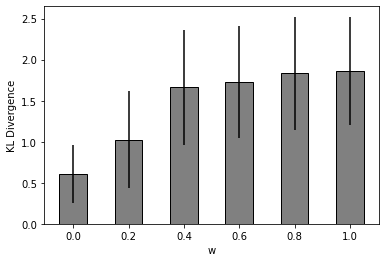

In [154]:
different_w_str = [str(round_sig(item)) for item in different_w]

plt.bar(different_w_str, np.mean(kl_w, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(kl_w, axis = 1),
         color = 'gray',edgecolor = ['k','k'])

plt.ylabel('KL Divergence')
plt.xlabel('w')

Text(0.5, 0, 'w')

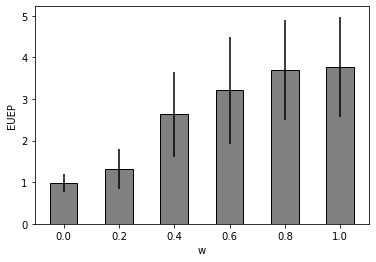

In [155]:
plt.bar(different_w_str, np.mean(EUEP, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(EUEP, axis = 1),
         color = 'gray',edgecolor = ['k','k'])
plt.ylabel('EUEP')
plt.xlabel('w')

Text(0.5, 0, 'w')

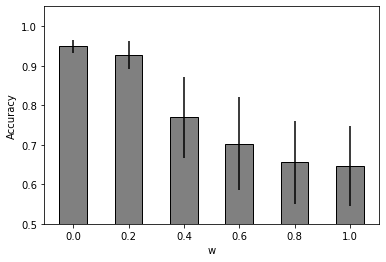

In [158]:
plt.bar(different_w_str, np.mean(accuracy_w, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(accuracy_w, axis = 1),
         color = 'gray',edgecolor = ['k','k'])

plt.ylabel('Accuracy')
plt.ylim([0.5,1.05])


plt.xlabel('w')

Text(0.5, 0, 'w')

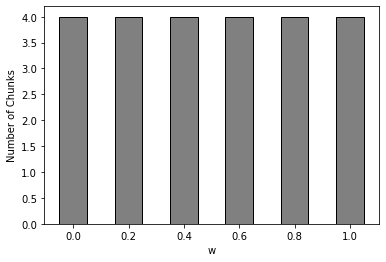

In [159]:
plt.bar(different_w_str, np.mean(number_of_chunks, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(number_of_chunks, axis = 1),
         color = 'gray',edgecolor = ['k','k'])

plt.ylabel('Number of Chunks')
plt.xlabel('w')

Text(0.5, 0, 'w')

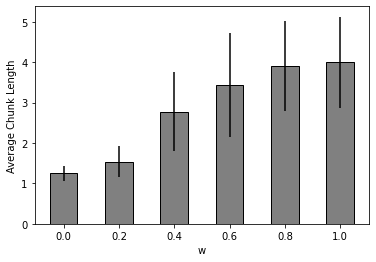

In [160]:
plt.bar(different_w_str, np.mean(average_chunk_length, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(average_chunk_length, axis = 1),
         color = 'gray',edgecolor = ['k','k'])
plt.ylabel('Average Chunk Length')
plt.xlabel('w')

Text(0.5, 0, 'w')

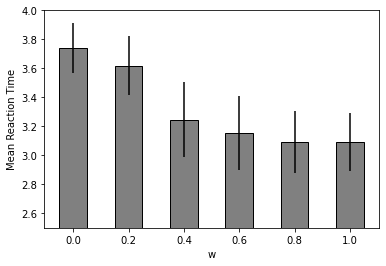

In [168]:
plt.bar(different_w_str, np.mean(mean_rt_w, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(mean_rt_w, axis = 1),
         color = 'gray',edgecolor = ['k','k'])
plt.ylabel('Mean Reaction Time')
plt.ylim([2.5,4.00])
plt.xlabel('w')

(array([0. , 0.5, 1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

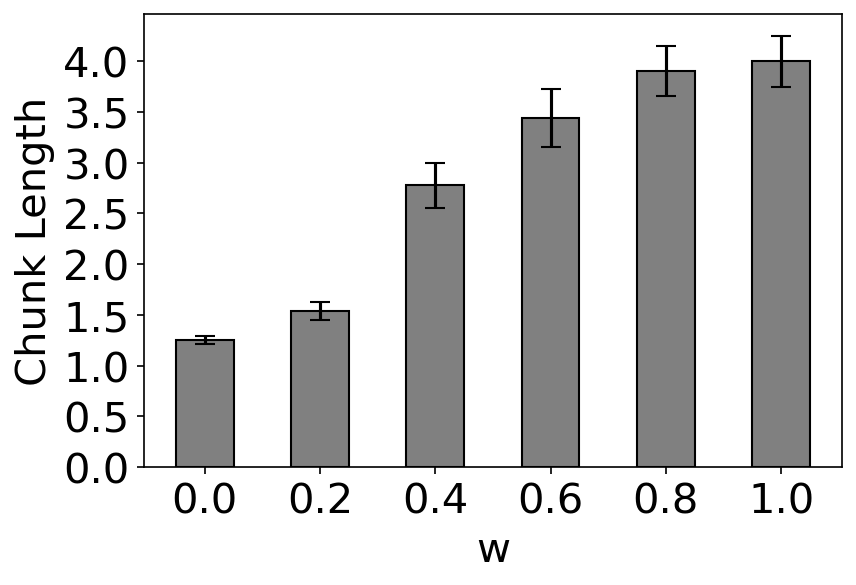

In [169]:
plt.figure(dpi=150)

plt.bar(different_w_str, np.mean(average_chunk_length, axis = 1), width=0.5, bottom=None, align='center',
        data=None, yerr = np.std(average_chunk_length, axis = 1)/np.sqrt(20), capsize = 5,
         color = 'gray',edgecolor = ['k','k'])
plt.ylabel('Chunk Length', size = 20)
plt.xlabel('w', size = 20)
plt.xticks(size = 20)
plt.yticks(size=20)

In [ ]:
# np.save('mean_rt_w.npy', mean_rt_w) # save
# np.save('average_chunk_length.npy', average_chunk_length) # save
# np.save('accuracy_w.npy', accuracy_w)
# np.save('EUEP.npy', EUEP)
# np.save('kl_w.npy', kl_w)
# np.save('different_w_str.npy', different_w_str)

mean_rt_w = np.load('mean_rt_w.npy') # save
average_chunk_length = np.load('average_chunk_length.npy') # save
accuracy_w = np.load('accuracy_w.npy')
EUEP = np.load('EUEP.npy')
kl_w = np.load('kl_w.npy')
different_w_str = np.load('different_w_str.npy')


In [152]:
def sample_exp1_sequence_from_participants(groupcond):
    # sample instruction sequence from random participants to train the chunking model
    subjectid = list(chunks_ts[groupcond]['inst'].keys())
    this_id = np.random.choice(subjectid)
    return chunks_ts[groupcond]['inst'][this_id]['training']


def n_occurrance_ck(chunk,sck):
    '''Measures the number of occurrance for sck within a chunk'''
    if len(sck)>len(chunk):
        return 0 
    else:
        i = 0
        freq = 0
        end = False
        while end == False:
            if chunk[i:min(i+len(sck),len(chunk))] == sck:
                freq = freq + 1
            i = i + 1
            if i >=len(chunk):
                end = True
    return freq

def partition_seq_hastily(this_sequence,bag_of_chunks):
    c = 1
    '''checked'''
    # find the maximal chunk that fits the sequence
    # what to do when the bag of chunks does not partition the sequence?? 

    i = 0
    end_of_sequence = False
    partitioned_sequence = []
    true_chunk = None
    while end_of_sequence == False:
        for chunk in bag_of_chunks: 
            this_chunk = json.loads(chunk)
            if this_sequence[i] == this_chunk[0]: 
                partitioned_sequence.append(list(this_chunk))
                true_chunk = this_chunk
        i = i + len(true_chunk)
        if i >= len(this_sequence):end_of_sequence = True

    print(bag_of_chunks)
    M,T = initialize_MT(bag_of_chunks)

    this_M, this_T = eval_M_T(M,T,partitioned_sequence)
    print(this_T)

    correctness = []
    reacted_press = []
    rt = []
    choice_probability = []
    prev_obs = None
    i = 0

    # first item
    item = partitioned_sequence[0]

    p_1,p_2,p_3,p_4 = eval_same_beginning_M([], this_M)
    choice_p = max([p_1,p_2,p_3,p_4])
    instruction_index = this_sequence[i]-1
    choice_rt, choice_index = DFT(p = [p_1,p_2,p_3,p_4],right_choice_index = instruction_index)
    choice = choice_index + 1 
    if choice == this_sequence[i]:correctness.append(1)
    else:correctness.append(0) 
    
    rt.append(choice_rt)
    reacted_press.append(choice)
    choice_probability.append(choice_p)
    i = i + 1

    for j in range(1, len(item)):# choice probability always 1 inside a chunk
        choice = item[j]
        choice_p = 1
        #choice_rt = -c*np.log(choice_p)    
        choice_index = choice-1
        ps = [0,0,0,0]
        ps[choice_index] = 1
        choice_p = 1
        instruction_index = this_sequence[i]-1
        choice_rt, choice_index = DFT(p = ps,right_choice_index = instruction_index)
        choice = choice_index + 1 
        if choice == this_sequence[i]:correctness.append(1)
        else:correctness.append(0)  
        rt.append(choice_rt)
        reacted_press.append(choice)
        choice_probability.append(choice_p)
        i = i + 1
        
    prev_obs = str(item)

    for item in partitioned_sequence[1:]:
        p_1,p_2,p_3,p_4 = eval_same_beginning([], this_T, prev_obs)
        #print('p 1 2 3 4 ', p_1, p_2, p_3, p_4)
        choice_p = max([p_1,p_2,p_3,p_4])
        instruction_index = this_sequence[i]-1
        choice_rt, choice_index = DFT(p = [p_1,p_2,p_3,p_4],right_choice_index = instruction_index)
        choice = choice_index + 1 
        
        if i <= len(this_sequence)-1 and choice == this_sequence[i]:correctness.append(1)
        else:correctness.append(0) 
        rt.append(choice_rt)
        reacted_press.append(choice)
        choice_probability.append(choice_p)
        i = i + 1
        for j in range(1, len(item)):# choice probability always 1 inside a chunk
            choice = item[j]
            choice_index = choice-1
            ps = [0,0,0,0]
            ps[choice_index] = 1 
            choice_p = 1
            if i <= len(this_sequence)-1:
                if choice == this_sequence[i]:
                    instruction_index = this_sequence[i]-1
                    choice_rt, choice_index = DFT(p = ps,right_choice_index = instruction_index)
                    choice = choice_index + 1 
                    correctness.append(1)
                else:correctness.append(0)  
            rt.append(choice_rt)
            reacted_press.append(choice)
            choice_probability.append(choice_p)
            i = i + 1        
        prev_obs = str(item)
    end_len = len(this_sequence)
    print('this_M ', this_M)
    print('this_T ', this_T)
    print('correctness: ', correctness)
    print('rt, ', rt)
    print('reacted press ', reacted_press)    

    return correctness[0:end_len], rt[0:end_len], choice_probability[0:end_len],reacted_press[0:end_len],this_M, this_T

def initialize_MT(cl):
    best_T = pd.DataFrame(np.zeros([4,4]))
    best_M = pd.DataFrame(np.zeros([4,1]))
    best_T.columns = best_T.index = cl
    best_M.index = cl
    best_M.columns = ['P']
    return best_M, best_T

def chunk_purposal(best_M, best_T):
        # proposing chunks
    proposed_chunk_p = {}
    for pre_chunk in best_T.index.tolist():
        for post_chunk in best_T.index.tolist():
            con_p = best_T.loc[pre_chunk][post_chunk]
            p = con_p*best_M.loc[pre_chunk]['P']
            new_chunk = json.loads(pre_chunk) + json.loads(post_chunk)
            proposed_chunk_p[str(new_chunk)] = p
            
    return {k: v for k, v in sorted(proposed_chunk_p.items(), key=lambda item: item[1])}
    
    
def learn_sequence(this_sequence, Print = False, L_threshold = 0, w = 0, nit = 4):
    # In this implementation, the marginal probability at the end of learning for each chunk is the same as 
    # the marginal probability of 1,2,3,4 at the beginning
    # reaction time is calculated as probability of 1 for that particular chunk, even when the sequence
    # instruction is different. 

    bag_of_chunks = ['[1]','[2]','[3]','[4]']
    best_M, best_T = initialize_MT(bag_of_chunks)
    delta_L = 1000

    correctness, rt, choice_probability,reacted_press,best_M, best_T = partition_seq_hastily(this_sequence,bag_of_chunks)
    
    L_old= w*np.mean(rt) + (1-w)*(1-np.mean(correctness))
    best_rt,best_correctness, best_cp, best_reacted_press = np.mean(rt), np.mean(correctness), choice_probability, reacted_press
    if Print: 
        print('mean rt ', np.mean(rt), ' mean correctness ',np.mean(correctness))
        print(L_old)

    sorted_proposal = chunk_purposal(best_M, best_T)
    # find the maximum transition probability, try chunking it
    # evaluate the reaction time, and accuracy 
    # if benefits reaction time, and accuracy, then set it to a chunk,
    # re-evaluate the transition, 
    it = 0
    while it <=nit:
        new_chunk = list(sorted_proposal.keys())[-1]
        while new_chunk in bag_of_chunks:
            sorted_proposal.pop(new_chunk)
            new_chunk = list(sorted_proposal.keys())[-1]
        
        new_bag_of_chunks = bag_of_chunks.copy()
        new_bag_of_chunks.append(new_chunk)
        pre_chunk = None
        for cc in new_bag_of_chunks:
            if json.loads(cc)[0] == json.loads(new_chunk)[0] and json.loads(cc) != json.loads(new_chunk):
                pre_chunk = cc
                new_bag_of_chunks.remove(cc)

        # try to prevent cycling around 

        correctness, rt, choice_probability,reacted_press,this_M, this_T = partition_seq_hastily(this_sequence,new_bag_of_chunks)
        L_new = w*np.mean(rt) + (1-w)*(1-np.mean(correctness))
        if Print and new_chunk == '[1, 2]':
            print('======================================')
            print('new_bag_of_chunks',new_bag_of_chunks )
            print('mean rt ', np.mean(rt), ' mean correctness ',np.mean(correctness))
            print('loss ',L_new)
            print(L_new)
            print(this_T)
        delta_L = L_old - L_new 

        if delta_L>=0:# decreasing loss
            bag_of_chunks,L_old, best_M, best_T, best_rt,best_correctness,best_cp, best_reacted_press = new_bag_of_chunks, L_new, this_M, this_T, np.mean(rt),np.mean(correctness), choice_probability, reacted_press
            sorted_proposal = chunk_purposal(best_M, best_T)
            
        it = it + 1

    return best_M, best_T,bag_of_chunks,best_rt,best_correctness,best_cp, best_reacted_press

def get_T_from_partitioned_sequence(chunk1,chunk2,partitioned_sequence):
    '''checked'''
    '''Get the estimated empirical probability of P(chunk2|chunk1),the probability of chunk2 followed by chunk1, 
    in the generated sequence
    In the case when chunk1 never occurs, output the probability of 0'''
    chunk1_count = 0
    chunk1_chunk2 = 0
    # the transition probability from chunk1 to chunk2
    # get P(chunk2|chunk1)
    not_over = True
    i = 0
    for candidate_chunk in partitioned_sequence: 
        if candidate_chunk == chunk1:
            chunk1_count +=1
            if i+1 < len(partitioned_sequence):
                candidate2 = partitioned_sequence[i+1]
                if candidate2 == chunk2:
                    chunk1_chunk2+=1
        i = i+1
    if chunk1_count>0:
        return chunk1_chunk2/chunk1_count
    else:
        return 0.0 # returns 0 if there is no occurrance for the first probabilility
    
def get_M_from_partitioned_sequence(chunk,partitioned_sequence):
    '''checked'''


    '''Get the estimated empirical probability of P(chunk),the probability of chunk2 followed by chunk1, 
    in the generated sequence
    In the case when chunk1 never occurs, output the probability of 0'''
    n_total = 0
    chunk1_count = 0
    for candidate_chunk in partitioned_sequence: 
        if candidate_chunk == chunk:
            chunk1_count +=1

    if chunk1_count>0:return chunk1_count/len(partitioned_sequence)
    else:return 0.0
    
    
# helper functions
def eval_M_T(M,T,partitioned_sequence):
    """checked"""
    bag_of_chunks = M.index.tolist()
    
    for chunk in bag_of_chunks:
        parsed_chunk = json.loads(chunk)
        M.loc[chunk,'P'] = get_M_from_partitioned_sequence(parsed_chunk,partitioned_sequence)
    for chunk1 in bag_of_chunks:
        for chunk2 in bag_of_chunks:
            parsed_chunk1 = json.loads(chunk1)
            parsed_chunk2 = json.loads(chunk2)
            T.loc[chunk1,chunk2] = get_T_from_partitioned_sequence(parsed_chunk1,parsed_chunk2,partitioned_sequence)
    return M, T


def partition_seq(this_sequence,bag_of_chunks):
    '''checked'''
    # find the maximal chunk that fits the sequence
    # what to do when the bag of chunks does not partition the sequence?? 
    i = 0
    end_of_sequence = False
    partitioned_sequence = []
    
    while end_of_sequence == False:
        max_chunk = None
        max_length = 0 
        for chunk in bag_of_chunks: 
            this_chunk = json.loads(chunk)
            if this_sequence[i:i+len(this_chunk)] == this_chunk: 
                if len(this_chunk)> max_length:
                    max_chunk = this_chunk
                    max_length = len(max_chunk)

        if max_chunk == None:
            partitioned_sequence.append([this_sequence[i]])
            i = i + 1
        else:
            partitioned_sequence.append(list(max_chunk))
            i = i + len(max_chunk)

        if i >= len(this_sequence):end_of_sequence = True
            
    return partitioned_sequence


def eval_M_T_from_original_sequence(M,T,original_sequence):
    bag_of_chunks = M.index.tolist()
    '''checked'''
    '''Get the estimated empirical probability of P(chunk2|chunk1),the probability of chunk2 followed by chunk1, 
    in the generated sequence
    In the case when chunk1 never occurs, output the probability of 0'''
    chunk1_count = 0
    chunk1_chunk2 = 0
    # the transition probability from chunk1 to chunk2
    # get P(chunk2|chunk1)
    not_over = True
    i = 0
    for candidate_chunk in partitioned_sequence: 
        if candidate_chunk == chunk1:
            chunk1_count +=1
            if i+1 < len(partitioned_sequence):
                candidate2 = partitioned_sequence[i+1]
                if candidate2 == chunk2:
                    chunk1_chunk2+=1
        i = i+1
    if chunk1_count>0:
        return chunk1_chunk2/chunk1_count
    else:
        return 0.0 # returns 0 if there is no occurrance for the first probabilility

    '''Get the estimated empirical probability of P(chunk),the probability of chunk2 followed by chunk1, 
    in the generated sequence
    In the case when chunk1 never occurs, output the probability of 0'''
    n_total = 0
    chunk1_count = 0
    for candidate_chunk in partitioned_sequence: 
        if candidate_chunk == chunk:
            chunk1_count +=1

    if chunk1_count>0:return chunk1_count/len(partitioned_sequence)
    else:return 0.0

    
def eval_same_beginning_M(head, M):
    '''head: a subpart that has been parsed within the chunks. '''
    # given the observation of head, what is the probability of 1,2,3,4 following the head, according
    # to our internal model. 
    p_1 = 0
    p_2 = 0
    p_3 = 0
    p_4 = 0
    chunk1 = head+[1]
    chunk2 = head+[2]
    chunk3 = head+[3]
    chunk4 = head+[4]
    for item in M.index.tolist():
        Chunk = json.loads(item)
        if Chunk[0:len(chunk1)] == chunk1:
            p_1+=M.loc[item]['P']
        if Chunk[0:len(chunk1)] == chunk2:
            p_2+=M.loc[item]['P']
        if Chunk[0:len(chunk1)] == chunk3:
            p_3+=M.loc[item]['P']
        if Chunk[0:len(chunk1)] == chunk4:
            p_4+=M.loc[item]['P']
    Sum = p_1+p_2+p_3+p_4
    p_1=p_1/Sum
    p_2 = p_2/Sum
    p_3 = p_3/Sum
    p_4 = p_4/Sum
    
    return p_1,p_2,p_3,p_4


# DFT
# occurs to me that maybe we would like to match the DFT distribution to roughly the participants, but am not sure how to do that
# presumably the parameters should produce a distribution similar to participants reaction times. 
def DFT(p = [0.25,0.30,0.20,0.25],right_choice_index = 1,Plot = False):
    '''right choice: the index of the correct choice, matched with the probabilities'''
    # parameters are fixedahead of the time. 
    n_step = 100 # is in ms. 
    time = np.arange(0,n_step,1)
    path = np.zeros([4,n_step])# trace of path for the drift diffusion walk. 
    winning_choice_index = None
    crossing_time = n_step
    v_instruction = 0.5 # drift rate for the instruction press
    v_internal = (1.0-v_instruction)/3.0 # drift rate for the none-instructional press
    sigma = 0.03 # another parameter
    eps = 0.01
    b = 1 # boundary, a cross indicates that a drift decision is being made. 
    
    # initialization, evidence starts from np.log(p)
    for i in range(0, len(p)):
        if p[i] <=eps:path[i,0]= np.log(eps) 
        else: path[i,0]= np.log(p[i])
            
    for i in range(0, len(p)):  
        # adapt drift rate to correct key
        if i == right_choice_index:
            v = np.random.normal(v_instruction, sigma, 1) 
        else:
            v = np.random.normal(v_internal, sigma, 1) # sample normal distribution of drift speed
        for j in range(1,n_step):
            path[i,j]=path[i,j-1] + v
            if path[i,j]>=b: 
                if j < crossing_time:
                    crossing_time = j
                    winning_choice_index = i
    # returns the first time it crosses 0
    if Plot: 
        plt.plot(time,path[0,:])
        plt.plot(time,path[1,:])
        plt.plot(time,path[2,:])
        plt.plot(time,path[3,:])
#         plt.ylim([0,-np.log(0.20)])
        plt.xlim([0,200])
        plt.legend(['1','2','3','4'])
    return crossing_time, winning_choice_index

def reproduce_sequence_df(M,T,n_sample=1000):
    sequence = []
    s_last = np.random.choice(T.index.tolist())
    sequence = sequence +json.loads(s_last)
    for i in range(0,n_sample):
        s_next = sample_df(M,T, s_last)
#         print(s_next)
        sequence += json.loads(s_next)
        s_last = s_next
    return sequence  


def sample_df(M,T, s_l):
    """When it returns [], it means there is no prediction,
        otherwise, returns the predicted sequence of certain length as a list
        s_last: a string, of last stimuli, as the key to look up in the transition probability dictionary"""
    # print('indeed sampling from distribution')
    states = T.index.tolist()
    prob =  list(T.loc[s_l])
    state, prob = sample_from_list_distribution(states,prob)
    if state == []:
        states = M.index.tolist()
        prob =  list(M['P'])
        state, prob = sample_from_list_distribution(states,prob)
    return state
def conditional_KL(M1,T1,T2):
    """compute conditional KL divergence between origial M1, T1, conditional M2, T2"""
    """ Epsilon is used here to avoid conditional code for
    checking that neither P nor Q is equal to 0. """
    eps = 0.000000001
    EPS = np.ones(list(T1.to_numpy().shape))*eps
    # return divergence
    v_T1 = T1.to_numpy()
    v_T1 = EPS + v_T1
    v_T2 = T2.to_numpy()
    v_T2 = EPS + v_T2
    v_M1 = M1.to_numpy()
    p_log_p_div_q = np.multiply(v_T1,np.log(v_T1/v_T2)) # element wise multiplication
    div = np.sum(np.matmul(v_M1.transpose(),p_log_p_div_q))
    return div

In [68]:
DFT(p = [1,0,0,0],right_choice_index = 2)

(5, 0)